In [26]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [28]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [30]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[4442, 5846, 2871, 5408, 26, 4484, 2464, 2171, 5877, 8488, 3476, 8781, 6091, 7821, 8118, 4886, 7281, 6826, 2174, 4175]
log initialized
Average similarity between family members is 0.9707276845289696 at temperature -1
Average similarity between family and home is 0.9998570179045442 at temperature -1
Average similarity between students and their classroom is 0.713840309964294 at temperature -1
Average classroom occupancy is 4.1692307692307695 and number classrooms is 65
Average similarity between workers is 0.9669143597580181 at temperature -1
Average office occupancy is 3.6810810810810812 and number offices is 185
Average friend similarity for adults: 0.8726674581739693 for kids: 0.719037062833551
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.7472666815923779
avg restaurant similarity 0.6194803896401345
avg restaurant similarity 0.7853153902835137
avg restaurant similarity 0.47578717008082627
avg restaurant similarity 0.9999438335649965
avg restaurant similarity 0.74325614483317
avg restaurant similarity 0.7010511035037569
avg restaurant similarity 0.5543305162070997
avg restaurant similarity 0.5243763464653961
avg restaurant similarity 0.74325614483317
avg restaurant similarity 0.9119197626177652
avg restaurant similarity 0.4226458171342019
avg restaurant similarity 0.6744225802066415
avg restaurant similarity 0.5226559145541373
avg restaurant similarity 0.5660557992801362
avg restaurant similarity 0.790636198306938
avg restaurant similarity 0.784424216248212
avg restaurant similarity 0.5291020473435083
avg restaurant similarity 0.8629134632698711
avg restaurant similarity 0.5327948238826941
avg restaurant similarity 0.536304049852649
avg restaurant similarity 0.6012490670009608
avg restaurant s

avg restaurant similarity 0.47571546596687186
avg restaurant similarity 0.6069384267732593
avg restaurant similarity 0.39868934138554185
avg restaurant similarity 0.9528893982458978
avg restaurant similarity 0.99967097066863
avg restaurant similarity 0.8981537545536944
avg restaurant similarity 0.6306189113454641
avg restaurant similarity 0.5055807883529188
avg restaurant similarity 0.7308563976659921
avg restaurant similarity 0.7523943556689184
avg restaurant similarity 0.48691635514209686
avg restaurant similarity 0.8261345678231552
avg restaurant similarity 0.9995554011543524
avg restaurant similarity 0.9998102361696526
avg restaurant similarity 0.4643859660547136
avg restaurant similarity 0.7384256240726002
avg restaurant similarity 0.5650469994713014
avg restaurant similarity 0.5054194601697404
avg restaurant similarity 0.5599501180976604
avg restaurant similarity 0.8585497297392498
avg restaurant similarity 0.7990697888358124
avg restaurant similarity 0.9996628095044512
avg resta

avg restaurant similarity 0.702274391854272
avg restaurant similarity 0.5174273535205688
avg restaurant similarity 0.6682537870093056
avg restaurant similarity 0.41228019494936585
avg restaurant similarity 0.4545747290022514
avg restaurant similarity 0.4022438815825581
avg restaurant similarity 0.5588573577490857
avg restaurant similarity 0.8647431464085709
avg restaurant similarity 0.999911951570108
avg restaurant similarity 0.7683279374384013
avg restaurant similarity 0.4046617331930291
avg restaurant similarity 0.9184674790939875
avg restaurant similarity 0.4509723796170359
avg restaurant similarity 0.48180067597202436
avg restaurant similarity 0.9184674790939875
avg restaurant similarity 0.7912402790097345
avg restaurant similarity 0.40365087416751266
avg restaurant similarity 0.9179058124987853
avg restaurant similarity 0.6396384917692166
avg restaurant similarity 0.45469429492399527
avg restaurant similarity 0.60325475649228
avg restaurant similarity 0.5087618166230368
avg restau

avg restaurant similarity 0.41233839770475456
avg restaurant similarity 0.40990510486178144
avg restaurant similarity 0.5547706028273758
avg restaurant similarity 0.6194590420339287
avg restaurant similarity 0.7303011911786887
avg restaurant similarity 0.4819880335069535
avg restaurant similarity 0.5456997448275364
avg restaurant similarity 0.48776202344369035
avg restaurant similarity 0.7067853416449088
avg restaurant similarity 0.4237608679009537
avg restaurant similarity 0.5938549213358557
avg restaurant similarity 0.5562088745011446
avg restaurant similarity 0.38922431155562487
avg restaurant similarity 0.5895717935534196
avg restaurant similarity 0.5902487406227466
avg restaurant similarity 0.9997189092799976
avg restaurant similarity 0.8382301808659305
avg restaurant similarity 0.5766514994963325
avg restaurant similarity 0.5196134474359952
avg restaurant similarity 0.5336329156196009
avg restaurant similarity 0.43657016924066266
avg restaurant similarity 0.5463233413001383
avg r

avg restaurant similarity 0.8885806710903801
avg restaurant similarity 0.6602332099688949
avg restaurant similarity 0.7662524687042028
avg restaurant similarity 0.9995933476422049
avg restaurant similarity 0.45290539761434184
avg restaurant similarity 0.7192186356835885
avg restaurant similarity 0.8058832565163137
avg restaurant similarity 0.635847125588398
avg restaurant similarity 0.6251917473992004
avg restaurant similarity 0.6162829756227649
avg restaurant similarity 0.8557789275118071
avg restaurant similarity 0.616523044953311
avg restaurant similarity 0.8889743413879355
avg restaurant similarity 0.6865266157098676
avg restaurant similarity 0.8061002115340725
avg restaurant similarity 0.4479573909365884
avg restaurant similarity 0.612459268676222
avg restaurant similarity 0.7765671282431446
avg restaurant similarity 0.5277223690118513
avg restaurant similarity 0.9997004624379054
avg restaurant similarity 0.7988052121881801
avg restaurant similarity 0.7902224919988611
avg restaura

avg restaurant similarity 0.9998009101766377
avg restaurant similarity 0.6942551727304972
avg restaurant similarity 0.29834929074528005
avg restaurant similarity 0.6359435078054898
avg restaurant similarity 0.4244212029589001
avg restaurant similarity 0.44120244416255894
avg restaurant similarity 0.25924564457905225
avg restaurant similarity 0.5875699650693577
avg restaurant similarity 0.34724348475742206
avg restaurant similarity 0.7720094913919169
avg restaurant similarity 0.9998855604015462
avg restaurant similarity 0.3290230633256831
avg restaurant similarity 0.5132277408061321
avg restaurant similarity 0.8770025557950515
avg restaurant similarity 0.8203013058068505
avg restaurant similarity 0.5796380886525045
avg restaurant similarity 0.66544394130111
avg restaurant similarity 0.6950397789942493
avg restaurant similarity 0.6191272959032359
avg restaurant similarity 0.29834929074528005
avg restaurant similarity 0.8772012928292856
avg restaurant similarity 0.5270329628955155
avg res

avg restaurant similarity 0.7239749932729026
avg restaurant similarity 0.5997681003979982
avg restaurant similarity 0.7581522334561155
avg restaurant similarity 0.6940698966064777
avg restaurant similarity 0.43743786937688284
avg restaurant similarity 0.9391012072387871
avg restaurant similarity 0.7938621471404393
avg restaurant similarity 0.8128814612823867
avg restaurant similarity 0.8253405198573658
avg restaurant similarity 0.6971682889969322
avg restaurant similarity 0.6255976709467046
avg restaurant similarity 0.6311413313694372
avg restaurant similarity 0.6701192549652312
avg restaurant similarity 0.6989340635895261
avg restaurant similarity 0.7384017324543467
avg restaurant similarity 0.6622291662110387
avg restaurant similarity 0.5339650958564548
avg restaurant similarity 0.8481749012729298
avg restaurant similarity 0.4399647656203086
avg restaurant similarity 0.9994918117242662
avg restaurant similarity 0.22863140895579195
avg restaurant similarity 0.7451331716278236
avg rest

avg restaurant similarity 0.8037159558692663
avg restaurant similarity 0.6415204313590334
avg restaurant similarity 0.6740269479690479
avg restaurant similarity 0.6384339659214153
avg restaurant similarity 0.5397420821477553
avg restaurant similarity 0.5866203254102589
avg restaurant similarity 0.6829542226160089
avg restaurant similarity 0.36657628407592563
avg restaurant similarity 0.4564240063665666
avg restaurant similarity 0.5866203254102589
avg restaurant similarity 0.6433489754779057
avg restaurant similarity 0.8306944774183289
avg restaurant similarity 0.8208184311265151
avg restaurant similarity 0.4113737272993577
avg restaurant similarity 0.650937641954819
avg restaurant similarity 0.6384339659214153
avg restaurant similarity 0.5430544779926694
avg restaurant similarity 0.5709287038461202
avg restaurant similarity 0.8306944774183289
avg restaurant similarity 0.38361086840406267
avg restaurant similarity 0.626536690505
avg restaurant similarity 0.6279259046469499
avg restauran

avg restaurant similarity 0.4431157718533617
avg restaurant similarity 0.9047300952293158
avg restaurant similarity 0.44525147904608825
avg restaurant similarity 0.8702595967759279
avg restaurant similarity 0.4152948111106557
avg restaurant similarity 0.6344525533507172
avg restaurant similarity 0.8569261136493745
avg restaurant similarity 0.2657297564969835
avg restaurant similarity 0.44345782174113213
avg restaurant similarity 0.856871374302161
avg restaurant similarity 0.4369067951832021
avg restaurant similarity 0.6013228968130775
avg restaurant similarity 0.6826015823573638
avg restaurant similarity 0.44385129213177626
avg restaurant similarity 0.5882994950042515
avg restaurant similarity 0.5991113745522139
avg restaurant similarity 0.8132268311169084
avg restaurant similarity 0.7423383853042639
avg restaurant similarity 0.7836738078245251
avg restaurant similarity 0.7425528428923118
avg restaurant similarity 0.9017919966564025
avg restaurant similarity 0.9998949859206311
avg rest

avg restaurant similarity 0.557904568825639
avg restaurant similarity 0.722121501490918
avg restaurant similarity 0.9064986746194541
avg restaurant similarity 0.9996767362938154
avg restaurant similarity 0.26885623520162916
avg restaurant similarity 0.48169523286031735
avg restaurant similarity 0.4841681657076864
avg restaurant similarity 0.47865664155148324
avg restaurant similarity 0.4272331902173825
avg restaurant similarity 0.8810279212937029
avg restaurant similarity 0.6034495927041504
avg restaurant similarity 0.7935343525239293
avg restaurant similarity 0.48031365777306223
avg restaurant similarity 0.8979868060221451
avg restaurant similarity 0.81353174231161
avg restaurant similarity 0.6044460369698492
avg restaurant similarity 0.5152394942333143
avg restaurant similarity 0.7501167799484567
avg restaurant similarity 0.4122870378289292
avg restaurant similarity 0.34935200353695295
avg restaurant similarity 0.5898260041081909
avg restaurant similarity 0.9996208211048514
avg resta

avg restaurant similarity 0.793966297195863
avg restaurant similarity 0.7410942046626852
avg restaurant similarity 0.8478226402551416
avg restaurant similarity 0.9996864130242438
avg restaurant similarity 0.7931066751595737
avg restaurant similarity 0.5728780599256843
avg restaurant similarity 0.5818633694563496
avg restaurant similarity 0.7931066751595737
avg restaurant similarity 0.4742129817867671
avg restaurant similarity 0.4092807122247317
avg restaurant similarity 0.9997212510614487
avg restaurant similarity 0.9998596231039909
avg restaurant similarity 0.5948317817866182
avg restaurant similarity 0.9996602085190518
avg restaurant similarity 0.9997480632011283
avg restaurant similarity 0.5841650016014093
avg restaurant similarity 0.854893895237239
avg restaurant similarity 0.6735833060669806
avg restaurant similarity 0.6065097575724523
avg restaurant similarity 0.5535080884857937
avg restaurant similarity 0.6699306508253814
avg restaurant similarity 0.9997992791710835
avg restaura

avg restaurant similarity 0.6103857122871396
avg restaurant similarity 0.548843235988757
avg restaurant similarity 0.6981478105717973
avg restaurant similarity 0.7264398431890648
avg restaurant similarity 0.7898567243190048
avg restaurant similarity 0.5215735999410835
avg restaurant similarity 0.6224839721679294
avg restaurant similarity 0.6635263386630272
avg restaurant similarity 0.7216221733252037
avg restaurant similarity 0.47440357468662486
avg restaurant similarity 0.9997002626572805
avg restaurant similarity 0.5202612780471328
avg restaurant similarity 0.45453551127868724
avg restaurant similarity 0.8544541297469737
avg restaurant similarity 0.5753636754063155
avg restaurant similarity 0.8688214987105047
avg restaurant similarity 0.3517293898044625
avg restaurant similarity 0.526643699541314
avg restaurant similarity 0.6438029889311638
avg restaurant similarity 0.6167074840560463
avg restaurant similarity 0.9996826310156267
avg restaurant similarity 0.4567275601546882
avg restau

avg restaurant similarity 0.38274090511405645
avg restaurant similarity 0.8565117119027695
avg restaurant similarity 0.4562301864921109
avg restaurant similarity 0.6336166035080563
avg restaurant similarity 0.3825755164362806
avg restaurant similarity 0.4581534034514455
avg restaurant similarity 0.8588240947314221
avg restaurant similarity 0.6712866272270304
avg restaurant similarity 0.5849167270246884
avg restaurant similarity 0.612082148622237
avg restaurant similarity 0.6313975023031614
avg restaurant similarity 0.43785223749105834
avg restaurant similarity 0.46645090079674656
avg restaurant similarity 0.816436205118134
avg restaurant similarity 0.45840124529355897
avg restaurant similarity 0.8473945861030308
avg restaurant similarity 0.6307690615719714
avg restaurant similarity 0.8043736341069345
avg restaurant similarity 0.46380450839159415
avg restaurant similarity 0.9996956235378103
avg restaurant similarity 0.3687900397254867
avg restaurant similarity 0.5511646943640884
avg res

avg restaurant similarity 0.6460394621316691
avg restaurant similarity 0.7774760338381297
avg restaurant similarity 0.6883638201438089
avg restaurant similarity 0.8975424258225393
avg restaurant similarity 0.8229006689672734
avg restaurant similarity 0.5710651855002882
avg restaurant similarity 0.8873585929648553
avg restaurant similarity 0.6107960512476582
avg restaurant similarity 0.8666791830481224
avg restaurant similarity 0.6859999282759907
avg restaurant similarity 0.5707576127815086
avg restaurant similarity 0.5492587572199983
avg restaurant similarity 0.5586668330424001
avg restaurant similarity 0.44155992954769663
avg restaurant similarity 0.7336039088270031
avg restaurant similarity 0.6693362198506154
avg restaurant similarity 0.8975424258225393
avg restaurant similarity 0.45154243845743125
avg restaurant similarity 0.5101904165774249
avg restaurant similarity 0.9998493255697181
avg restaurant similarity 0.4696378518058822
avg restaurant similarity 0.7999385441921711
avg rest

avg restaurant similarity 0.6513405157861546
avg restaurant similarity 0.6708424331193952
avg restaurant similarity 0.7072600232872637
avg restaurant similarity 0.2521852307243327
avg restaurant similarity 0.6674653746094331
avg restaurant similarity 0.7818444266827623
avg restaurant similarity 0.6203613315529989
avg restaurant similarity 0.6328882874605904
avg restaurant similarity 0.9998178464559784
avg restaurant similarity 0.6732397086192753
avg restaurant similarity 0.353995432543721
avg restaurant similarity 0.7778463304549869
avg restaurant similarity 0.6481569347872694
avg restaurant similarity 0.9078305960918112
avg restaurant similarity 0.8171967421544339
avg restaurant similarity 0.9998068309463806
avg restaurant similarity 0.710228661697967
avg restaurant similarity 0.611211750161974
avg restaurant similarity 0.5317466269527271
avg restaurant similarity 0.2571921310267191
avg restaurant similarity 0.5685834744411686
avg restaurant similarity 0.6995934247876221
avg restauran

avg restaurant similarity 0.5121567880790472
avg restaurant similarity 0.40495109120280925
avg restaurant similarity 0.362324111895129
avg restaurant similarity 0.9998432359789013
avg restaurant similarity 0.6909851480875739
avg restaurant similarity 0.352290713006947
avg restaurant similarity 0.45458548686921146
avg restaurant similarity 0.2685631663116248
avg restaurant similarity 0.6819265588975291
avg restaurant similarity 0.8304167946559318
avg restaurant similarity 0.47690575971260374
avg restaurant similarity 0.2001840310547362
avg restaurant similarity 0.40389965083294865
avg restaurant similarity 0.46025714686990565
avg restaurant similarity 0.18780480084815893
avg restaurant similarity 0.5141128370848093
avg restaurant similarity 0.4374536337852698
avg restaurant similarity 0.6875924556843325
avg restaurant similarity 0.6729885215425295
avg restaurant similarity 0.38557840240263963
avg restaurant similarity 0.5130886187299183
avg restaurant similarity 0.7978234150728335
avg r

avg restaurant similarity 0.4692748942889886
avg restaurant similarity 0.5783671486935669
avg restaurant similarity 0.6494801702994915
avg restaurant similarity 0.5450295616279621
avg restaurant similarity 0.9241619109193886
avg restaurant similarity 0.3675053309540133
avg restaurant similarity 0.9097911153329699
avg restaurant similarity 0.5193274076321474
avg restaurant similarity 0.6037664576291961
avg restaurant similarity 0.5973344415130448
avg restaurant similarity 0.41465277378055243
avg restaurant similarity 0.5019010585548609
avg restaurant similarity 0.9997710077409614
avg restaurant similarity 0.7864058632013381
avg restaurant similarity 0.47793087948733304
avg restaurant similarity 0.5924127397904715
avg restaurant similarity 0.6364796998182953
avg restaurant similarity 0.8161238592488604
avg restaurant similarity 0.4836119652905574
avg restaurant similarity 0.48297769876415636
avg restaurant similarity 0.5679482656135192
avg restaurant similarity 0.702809192596917
avg rest

avg restaurant similarity 0.6057840682456966
avg restaurant similarity 0.8172486837972717
avg restaurant similarity 0.614336324348538
avg restaurant similarity 0.8228356121130596
avg restaurant similarity 0.8528185205230463
avg restaurant similarity 0.6877178912415403
avg restaurant similarity 0.690589253460756
avg restaurant similarity 0.5481279039624747
avg restaurant similarity 0.8077239092265234
avg restaurant similarity 0.8345131109062035
avg restaurant similarity 0.5310393864332263
avg restaurant similarity 0.8493621870115731
avg restaurant similarity 0.826651217099473
avg restaurant similarity 0.9995928984904869
avg restaurant similarity 0.6405003045261143
avg restaurant similarity 0.6054221835363532
avg restaurant similarity 0.6290759393582153
avg restaurant similarity 0.5426439523491663
avg restaurant similarity 0.6871013218195008
avg restaurant similarity 0.6190760019625405
avg restaurant similarity 0.8384149788361085
avg restaurant similarity 0.5473191138111682
avg restauran

avg restaurant similarity 0.8076692744727738
avg restaurant similarity 0.5963413025456397
avg restaurant similarity 0.9997714374842153
avg restaurant similarity 0.5649739672008836
avg restaurant similarity 0.5278712250335208
Average similarity between family members is 0.9722353787288841 at temperature -1
Average similarity between family and home is 0.9998496348764586 at temperature -1
Average similarity between students and their classroom is 0.7129527889056966 at temperature -1
Average classroom occupancy is 4.476923076923077 and number classrooms is 65
Average similarity between workers is 0.9653786104746949 at temperature -1
Average office occupancy is 3.5080213903743314 and number offices is 187
Average friend similarity for adults: 0.8580559196706454 for kids: 0.7150434338146622
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this di

avg restaurant similarity 0.38351281447036883
avg restaurant similarity 0.999482504365557
avg restaurant similarity 0.4576421610213621
avg restaurant similarity 0.831487878144305
avg restaurant similarity 0.4274132419108756
avg restaurant similarity 0.5006221083495527
avg restaurant similarity 0.5136491898851142
avg restaurant similarity 0.9996500399523918
avg restaurant similarity 0.5154332514755865
avg restaurant similarity 0.42922063713468145
avg restaurant similarity 0.8069346007244459
avg restaurant similarity 0.3400001229799354
avg restaurant similarity 0.5533783711356596
avg restaurant similarity 0.5019007318573838
avg restaurant similarity 0.7157204281371563
avg restaurant similarity 0.5267766571593339
avg restaurant similarity 0.4897708891852187
avg restaurant similarity 0.3363664984796542
avg restaurant similarity 0.49361653523680565
avg restaurant similarity 0.7011788998420286
avg restaurant similarity 0.4258998749776204
avg restaurant similarity 0.40270182307205155
avg rest

avg restaurant similarity 0.6170717968019735
avg restaurant similarity 0.732128596548004
avg restaurant similarity 0.6435320045320245
avg restaurant similarity 0.5674162921055976
avg restaurant similarity 0.47747280055761054
avg restaurant similarity 0.9998696964703824
avg restaurant similarity 0.5649906718248581
avg restaurant similarity 0.6837842531702841
avg restaurant similarity 0.8312375094706256
avg restaurant similarity 0.4170086151863034
avg restaurant similarity 0.6450942670815752
avg restaurant similarity 0.8505757920099324
avg restaurant similarity 0.8392389112975007
avg restaurant similarity 0.6784807454357027
avg restaurant similarity 0.7766788467686774
avg restaurant similarity 0.9996231551021004
avg restaurant similarity 0.655994487363813
avg restaurant similarity 0.5456898633943249
avg restaurant similarity 0.7719906469015796
avg restaurant similarity 0.7784019275107873
avg restaurant similarity 0.7831235357254878
avg restaurant similarity 0.595869932035202
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

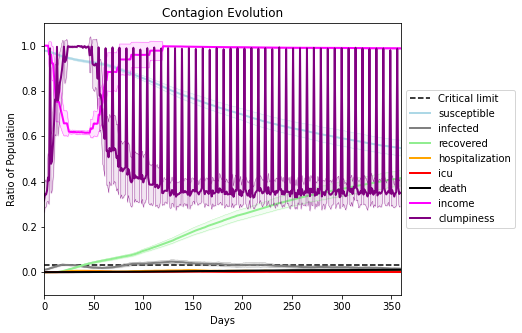

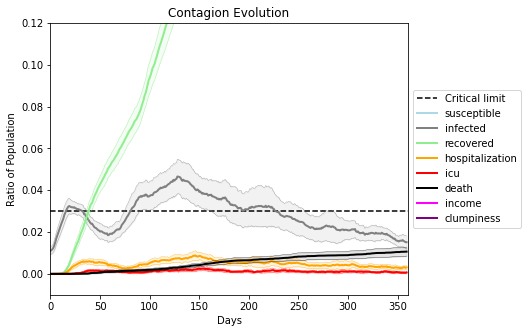

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9455, 7604, 3106, 4502, 5962, 7256, 9267, 7596, 1982, 6686, 7756, 4822, 5254, 1528, 2801, 3457, 1806, 3400, 2703, 8693]
Average similarity between family members is 0.9719698168112177 at temperature -0.999
Average similarity between family and home is 0.999842056836263 at temperature -1
Average similarity between students and their classroom is 0.7828771176610599 at temperature -0.999
Average classroom occupancy is 4.5 and number classrooms is 66
Average similarity between workers is 0.9590658962689366 at temperature -0.999
Average office occupancy is 3.579234972677596 and number offices is 183
Average friend similarity for adults: 0.8556825220173587 for kids: 0.7365150385170713
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.47374319084283545
avg restaurant similarity 0.6372485950669524
avg restaurant similarity 0.9994967712918386
avg restaurant similarity 0.5486540383923088
avg restaurant similarity 0.7132183486504586
avg restaurant similarity 0.6944104998840906
avg restaurant similarity 0.44967290104585844
avg restaurant similarity 0.7069621563261784
avg restaurant similarity 0.5185581037010714
avg restaurant similarity 0.5381380530607546
avg restaurant similarity 0.44967290104585844
avg restaurant similarity 0.7531124470963431
avg restaurant similarity 0.5834919759572212
avg restaurant similarity 0.6339835827088778
avg restaurant similarity 0.7543312801552334
avg restaurant similarity 0.7508307305340772
avg restaurant similarity 0.3539320346121648
avg restaurant similarity 0.6529395454659809
avg restaurant similarity 0.44549177994824835
avg restaurant similarity 0.44713260682547007
avg restaurant similarity 0.5606607519998181
avg restaurant similarity 0.9999406627964598
avg r

avg restaurant similarity 0.5176990843235477
avg restaurant similarity 0.510628177269921
avg restaurant similarity 0.4918059374239869
avg restaurant similarity 0.7307311044486684
avg restaurant similarity 0.5693970192407084
avg restaurant similarity 0.45797313066838063
avg restaurant similarity 0.3413579612211897
Average similarity between family members is 0.9706595988627389 at temperature -0.999
Average similarity between family and home is 0.9998509310374812 at temperature -1
Average similarity between students and their classroom is 0.7549951627706776 at temperature -0.999
Average classroom occupancy is 4.461538461538462 and number classrooms is 65
Average similarity between workers is 0.954949475087057 at temperature -0.999
Average office occupancy is 3.5489130434782608 and number offices is 184
Average friend similarity for adults: 0.8550477032871415 for kids: 0.7205571733257599
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacit

avg restaurant similarity 0.6755646628229148
avg restaurant similarity 0.9993596700926186
avg restaurant similarity 0.9997159705003392
avg restaurant similarity 0.4737487315890319
avg restaurant similarity 0.5123296859859351
avg restaurant similarity 0.4403200154091075
avg restaurant similarity 0.3554881420698095
avg restaurant similarity 0.2768014843904391
avg restaurant similarity 0.512737469610075
avg restaurant similarity 0.6706772461885364
avg restaurant similarity 0.6564174398523624
avg restaurant similarity 0.8279410378399645
avg restaurant similarity 0.7401032686628071
avg restaurant similarity 0.6131356375279944
avg restaurant similarity 0.8236506081670298
avg restaurant similarity 0.9998654682527083
avg restaurant similarity 0.9996628229436171
avg restaurant similarity 0.5459119138278508
avg restaurant similarity 0.5502533600163605
avg restaurant similarity 0.5616920813971922
avg restaurant similarity 0.82504203121169
avg restaurant similarity 0.5149703620677842
avg restauran

avg restaurant similarity 0.7678908572851483
avg restaurant similarity 0.8952050903384348
avg restaurant similarity 0.6843154627920682
avg restaurant similarity 0.7221798371927856
avg restaurant similarity 0.6854839028890104
avg restaurant similarity 0.7878834816661635
avg restaurant similarity 0.30479770625235214
avg restaurant similarity 0.5383146207376757
avg restaurant similarity 0.6864143869998005
avg restaurant similarity 0.6516863640966765
avg restaurant similarity 0.7966014059475997
avg restaurant similarity 0.4236856410530736
avg restaurant similarity 0.510295741796289
avg restaurant similarity 0.8960125660917082
avg restaurant similarity 0.7539929783609881
avg restaurant similarity 0.9997442409350108
avg restaurant similarity 0.4273632890727192
avg restaurant similarity 0.8362678258349814
avg restaurant similarity 0.6074384077810833
avg restaurant similarity 0.4973757386620151
avg restaurant similarity 0.9996293732078074
avg restaurant similarity 0.7245683412363395
avg restau

avg restaurant similarity 0.5957647119192666
avg restaurant similarity 0.44305469651833623
avg restaurant similarity 0.8932036362643209
avg restaurant similarity 0.5381777207376749
avg restaurant similarity 0.6600976335535492
avg restaurant similarity 0.3746925640941787
avg restaurant similarity 0.8314855184594621
avg restaurant similarity 0.622226893588402
avg restaurant similarity 0.8822854762728378
avg restaurant similarity 0.854877155922531
avg restaurant similarity 0.6500813257667877
avg restaurant similarity 0.6865856791260458
avg restaurant similarity 0.6458253026594833
avg restaurant similarity 0.5857930522778954
avg restaurant similarity 0.9998299574979987
avg restaurant similarity 0.9997540988544886
avg restaurant similarity 0.8456079201327561
avg restaurant similarity 0.6353638125794192
avg restaurant similarity 0.7788927776555228
avg restaurant similarity 0.6198312633205034
avg restaurant similarity 0.9998055183625851
avg restaurant similarity 0.8413578837860942
avg restaur

avg restaurant similarity 0.43815704146221535
avg restaurant similarity 0.5002276235134684
avg restaurant similarity 0.4830494013325287
avg restaurant similarity 0.5841629656069558
avg restaurant similarity 0.42197636837508967
avg restaurant similarity 0.6654534523571842
avg restaurant similarity 0.5171402904615361
avg restaurant similarity 0.5500242301300272
avg restaurant similarity 0.6028983672768026
avg restaurant similarity 0.7480836695015677
avg restaurant similarity 0.49744772725626074
avg restaurant similarity 0.5849410762850058
avg restaurant similarity 0.9997108040133381
avg restaurant similarity 0.9195816058569671
avg restaurant similarity 0.5829081697985183
avg restaurant similarity 0.6293418075474531
avg restaurant similarity 0.45979768316778885
avg restaurant similarity 0.5845749455365372
avg restaurant similarity 0.24159012328523585
avg restaurant similarity 0.47113274015604967
avg restaurant similarity 0.5510962213720576
avg restaurant similarity 0.4414790615333758
avg 

avg restaurant similarity 0.8282673612830711
avg restaurant similarity 0.7365046186125832
avg restaurant similarity 0.7286723290426385
avg restaurant similarity 0.7253717605673062
avg restaurant similarity 0.8630354367586789
avg restaurant similarity 0.8221395658728736
avg restaurant similarity 0.7266283312245398
avg restaurant similarity 0.7128044214514515
avg restaurant similarity 0.8428430189280042
avg restaurant similarity 0.7996416546690349
avg restaurant similarity 0.5400549047538571
avg restaurant similarity 0.89563229233613
avg restaurant similarity 0.658109038496557
avg restaurant similarity 0.6445040367090371
avg restaurant similarity 0.5887922614842521
avg restaurant similarity 0.9998440500005825
avg restaurant similarity 0.4843758645763252
avg restaurant similarity 0.577730317699893
avg restaurant similarity 0.7612182896585851
avg restaurant similarity 0.8423721238690485
avg restaurant similarity 0.7283064458237043
avg restaurant similarity 0.5870694362498041
avg restaurant

avg restaurant similarity 0.8488517918240774
avg restaurant similarity 0.7090207389800549
avg restaurant similarity 0.7387160663921934
avg restaurant similarity 0.4641899604604153
avg restaurant similarity 0.7433042669505661
avg restaurant similarity 0.41934935103103055
avg restaurant similarity 0.7091235847101245
avg restaurant similarity 0.786576971062749
avg restaurant similarity 0.34842066451946085
avg restaurant similarity 0.8275097596055914
avg restaurant similarity 0.7108095383859564
avg restaurant similarity 0.34845422533102016
avg restaurant similarity 0.7684618733478797
avg restaurant similarity 0.7265125054061421
avg restaurant similarity 0.9996802872977836
avg restaurant similarity 0.4641899604604153
avg restaurant similarity 0.7632850692665241
avg restaurant similarity 0.7419102189805483
avg restaurant similarity 0.9997460978020203
avg restaurant similarity 0.5599112184384492
avg restaurant similarity 0.4282312466434063
avg restaurant similarity 0.8289406044007022
avg rest

avg restaurant similarity 0.9997704548212288
avg restaurant similarity 0.3636767758750127
avg restaurant similarity 0.5353458545338803
avg restaurant similarity 0.41915858257909444
avg restaurant similarity 0.5787659773404461
avg restaurant similarity 0.6257646190350202
avg restaurant similarity 0.48841202377536436
avg restaurant similarity 0.44416464424115826
avg restaurant similarity 0.6026229390001585
avg restaurant similarity 0.5308785931203778
avg restaurant similarity 0.4800470501208347
avg restaurant similarity 0.41915858257909444
avg restaurant similarity 0.43349121315963546
avg restaurant similarity 0.38834800684689175
avg restaurant similarity 0.4316616134101263
avg restaurant similarity 0.5673187659209806
avg restaurant similarity 0.4895843459955177
avg restaurant similarity 0.48188869350226704
avg restaurant similarity 0.8228674040979183
avg restaurant similarity 0.488998184885441
avg restaurant similarity 0.5532000295718371
avg restaurant similarity 0.48188869350226704
avg

avg restaurant similarity 0.5879273837490758
avg restaurant similarity 0.5087558755479434
avg restaurant similarity 0.5508996958592881
avg restaurant similarity 0.4682698943088941
avg restaurant similarity 0.9326516602547815
avg restaurant similarity 0.6211870322149305
avg restaurant similarity 0.8658291550210977
avg restaurant similarity 0.6030470825565286
avg restaurant similarity 0.47176159895158215
avg restaurant similarity 0.45598166023243913
avg restaurant similarity 0.4996847238722199
avg restaurant similarity 0.7756951583572116
avg restaurant similarity 0.8487535888485738
avg restaurant similarity 0.3830414121832378
avg restaurant similarity 0.5110624912393309
avg restaurant similarity 0.48786253448897576
avg restaurant similarity 0.642011902249698
avg restaurant similarity 0.8663125430066807
avg restaurant similarity 0.5411762956883786
avg restaurant similarity 0.6028474254875501
avg restaurant similarity 0.9995252440824411
avg restaurant similarity 0.4631138399722152
avg rest

avg restaurant similarity 0.8017488159747518
avg restaurant similarity 0.7009356716736395
avg restaurant similarity 0.4779248505976281
avg restaurant similarity 0.6384028223081029
avg restaurant similarity 0.8536430625885907
avg restaurant similarity 0.5235723196979998
avg restaurant similarity 0.5129741827923856
avg restaurant similarity 0.8015873865884515
avg restaurant similarity 0.8920183157520829
avg restaurant similarity 0.7218289470143371
avg restaurant similarity 0.5156397409838146
avg restaurant similarity 0.6185480332382309
avg restaurant similarity 0.547113644020676
avg restaurant similarity 0.7599839601725142
avg restaurant similarity 0.5883811620131942
avg restaurant similarity 0.8199218071399172
avg restaurant similarity 0.5980002666518722
avg restaurant similarity 0.7060755536654199
avg restaurant similarity 0.7295254776539251
avg restaurant similarity 0.6054806847083689
avg restaurant similarity 0.5115603962962277
avg restaurant similarity 0.635877113242719
avg restaura

avg restaurant similarity 0.796781434154501
avg restaurant similarity 0.8919520865780627
avg restaurant similarity 0.9996298065006546
avg restaurant similarity 0.6073451624055548
avg restaurant similarity 0.5740241485410789
avg restaurant similarity 0.29840222979902936
avg restaurant similarity 0.9392376540021679
avg restaurant similarity 0.662769141906051
avg restaurant similarity 0.5667228270993576
avg restaurant similarity 0.9998166377551957
avg restaurant similarity 0.5896822515489833
avg restaurant similarity 0.28262979088215157
avg restaurant similarity 0.5427848775332841
avg restaurant similarity 0.6885061200110846
avg restaurant similarity 0.9602853022664112
avg restaurant similarity 0.49917830880943004
avg restaurant similarity 0.8039762251312988
avg restaurant similarity 0.8172358680483531
avg restaurant similarity 0.4958696081490599
avg restaurant similarity 0.5966668503812808
avg restaurant similarity 0.45399611670408485
avg restaurant similarity 0.6179511199301801
avg rest

avg restaurant similarity 0.703367935570745
avg restaurant similarity 0.8786993631492288
avg restaurant similarity 0.5133875199342667
avg restaurant similarity 0.37079087917814846
avg restaurant similarity 0.5672128525653639
avg restaurant similarity 0.4747829832785245
avg restaurant similarity 0.4690847468093813
avg restaurant similarity 0.9999138083616712
avg restaurant similarity 0.7802443042257504
avg restaurant similarity 0.7811824871828568
avg restaurant similarity 0.9998286133153218
avg restaurant similarity 0.8016637164646759
avg restaurant similarity 0.670469365340429
avg restaurant similarity 0.6389585471281486
avg restaurant similarity 0.6993823297979063
avg restaurant similarity 0.4873317764586994
avg restaurant similarity 0.45839677015381863
avg restaurant similarity 0.5079436614480739
avg restaurant similarity 0.7658035165858806
avg restaurant similarity 0.4914322938228618
avg restaurant similarity 0.29312220145953166
avg restaurant similarity 0.7802443042257504
avg resta

avg restaurant similarity 0.67514211354241
avg restaurant similarity 0.6046451068776186
avg restaurant similarity 0.6936617706216593
avg restaurant similarity 0.6046451068776186
avg restaurant similarity 0.8226098718630982
avg restaurant similarity 0.8794289244829534
avg restaurant similarity 0.5747085822934608
avg restaurant similarity 0.5445059727117517
avg restaurant similarity 0.7065670761889411
avg restaurant similarity 0.8371246474215787
avg restaurant similarity 0.4956525361728391
avg restaurant similarity 0.4541138162253223
avg restaurant similarity 0.9996228407080228
avg restaurant similarity 0.3030906922259379
avg restaurant similarity 0.9060143364914497
avg restaurant similarity 0.8046635807879073
avg restaurant similarity 0.5208810466671872
avg restaurant similarity 0.7022219370254804
avg restaurant similarity 0.8362775151345899
avg restaurant similarity 0.8526437987943456
avg restaurant similarity 0.6046451068776186
avg restaurant similarity 0.24638016993886125
avg restaur

Average similarity between workers is 0.9643312422006941 at temperature -0.999
Average office occupancy is 3.319371727748691 and number offices is 191
Average friend similarity for adults: 0.8543456999267273 for kids: 0.7374989262337888
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6074245696777012
avg restaurant similarity 0.9156478874735581
avg restaurant similarity 0.657743725473321
avg restaurant similarity 0.767472806082509
avg restaurant similarity 0.506136335110514
avg restaurant similarity 0.8868158845725855
avg restaurant similarity 0.5047541532717995
avg restaurant similarity 0.6801362364731898
avg restaurant similarity 0.6252114260150325
avg restaurant similarity 0.44975113586307913
avg restaurant similarity 0.5968888985815368
avg restaurant similarity 0.9994801263648265
avg restaurant similarity 0.5067290228861712
avg restaurant similarity 0.6074245696777012
avg restaurant similarity 0.5043724149475937
avg restaurant similarity 0.999823135023144
avg restaurant similarity 0.6214693539391918
avg restaurant similarity 0.8730285742823405
avg restaurant similarity 0.6127692500127938
avg restaurant similarity 0.9998400676080164
avg restaurant similarity 0.5987894635042619
avg restaurant similarity 0.7715917418923706
avg restauran

avg restaurant similarity 0.6414941938746325
avg restaurant similarity 0.5036375990151856
avg restaurant similarity 0.8850893416707646
avg restaurant similarity 0.9997736391272752
avg restaurant similarity 0.462658289773933
avg restaurant similarity 0.801514251625141
avg restaurant similarity 0.33795303668975707
avg restaurant similarity 0.3798261004800074
avg restaurant similarity 0.3798261004800074
avg restaurant similarity 0.42638575295200576
avg restaurant similarity 0.5554994767303449
avg restaurant similarity 0.3873903779072058
avg restaurant similarity 0.40189616457942856
avg restaurant similarity 0.48831934419941236
avg restaurant similarity 0.7954858422202893
avg restaurant similarity 0.4719414918378878
avg restaurant similarity 0.9998805397812325
avg restaurant similarity 0.8683260005856142
avg restaurant similarity 0.4029438342187279
avg restaurant similarity 0.4299021255583856
avg restaurant similarity 0.7680657748287403
avg restaurant similarity 0.8737242805379868
avg rest

avg restaurant similarity 0.9997674838105188
avg restaurant similarity 0.6219501355681393
avg restaurant similarity 0.42434657758693983
avg restaurant similarity 0.8689948194485438
avg restaurant similarity 0.7339639538973696
avg restaurant similarity 0.8118969667023079
avg restaurant similarity 0.5167371203962354
avg restaurant similarity 0.6215934587519527
avg restaurant similarity 0.7040965152170853
avg restaurant similarity 0.6012928592133031
avg restaurant similarity 0.7363745215998692
avg restaurant similarity 0.7359145027755704
avg restaurant similarity 0.5950753899628046
avg restaurant similarity 0.8665842517460443
avg restaurant similarity 0.5021070995386623
avg restaurant similarity 0.7339639538973696
avg restaurant similarity 0.600918283195254
avg restaurant similarity 0.800908050551024
avg restaurant similarity 0.4080775407629611
avg restaurant similarity 0.7438635532770901
avg restaurant similarity 0.6848141798237034
avg restaurant similarity 0.6231162769762941
avg restaur

avg restaurant similarity 0.4573019943828741
avg restaurant similarity 0.9997180740133089
avg restaurant similarity 0.6087219981378116
avg restaurant similarity 0.21926764611071006
avg restaurant similarity 0.3924056633961472
avg restaurant similarity 0.6083540702472355
avg restaurant similarity 0.5192241883166394
avg restaurant similarity 0.999847629688791
avg restaurant similarity 0.39676976835535727
avg restaurant similarity 0.2734919140990499
avg restaurant similarity 0.39613721310835054
avg restaurant similarity 0.4057807582759118
avg restaurant similarity 0.3250465553894464
avg restaurant similarity 0.27847065076316097
avg restaurant similarity 0.3368572192351011
avg restaurant similarity 0.40592192320636994
avg restaurant similarity 0.8142692801189715
avg restaurant similarity 0.4078662572687098
avg restaurant similarity 0.3975273128012736
avg restaurant similarity 0.5106832291012893
avg restaurant similarity 0.9997474118733811
avg restaurant similarity 0.5956593041535284
avg re

avg restaurant similarity 0.999904671102251
avg restaurant similarity 0.49038381699231887
avg restaurant similarity 0.2957402959159789
avg restaurant similarity 0.3632275683126064
avg restaurant similarity 0.6690735715626982
avg restaurant similarity 0.5772876022906577
avg restaurant similarity 0.4633995344056945
avg restaurant similarity 0.5708673764369389
avg restaurant similarity 0.5611858192184991
avg restaurant similarity 0.505921637401817
avg restaurant similarity 0.8207050494148762
avg restaurant similarity 0.573123938111157
avg restaurant similarity 0.6849543595203378
avg restaurant similarity 0.5482810991907455
avg restaurant similarity 0.5406691252792675
avg restaurant similarity 0.565406099718922
avg restaurant similarity 0.6829152965646482
avg restaurant similarity 0.5449641419232873
avg restaurant similarity 0.8638854732240033
avg restaurant similarity 0.4576516656405453
avg restaurant similarity 0.5449641419232873
avg restaurant similarity 0.2254537141268459
avg restauran

avg restaurant similarity 0.4956248070599882
avg restaurant similarity 0.391474279075337
avg restaurant similarity 0.4928245757228209
avg restaurant similarity 0.6955974981809803
avg restaurant similarity 0.5081695488658149
avg restaurant similarity 0.5970907047754721
avg restaurant similarity 0.5818689009787048
avg restaurant similarity 0.5180490368576778
avg restaurant similarity 0.7454036257661639
avg restaurant similarity 0.5451460824106805
avg restaurant similarity 0.39702189603950194
avg restaurant similarity 0.4888832419077779
avg restaurant similarity 0.577142906681038
avg restaurant similarity 0.5818689009787048
avg restaurant similarity 0.999966849230115
avg restaurant similarity 0.39860549831311876
avg restaurant similarity 0.7651469908505381
avg restaurant similarity 0.5081698126448437
avg restaurant similarity 0.66566160015697
avg restaurant similarity 0.8670643188455223
avg restaurant similarity 0.5798498861563034
avg restaurant similarity 0.8721998996205843
avg restauran

avg restaurant similarity 0.491360700999136
avg restaurant similarity 0.8493510900322434
avg restaurant similarity 0.8200194220994433
avg restaurant similarity 0.7302681556354753
avg restaurant similarity 0.520690839952631
avg restaurant similarity 0.8743944297312916
avg restaurant similarity 0.7176794997477507
avg restaurant similarity 0.9994237922757265
avg restaurant similarity 0.5008126925051084
avg restaurant similarity 0.8200194220994433
avg restaurant similarity 0.9295335151951747
avg restaurant similarity 0.6301605311582203
avg restaurant similarity 0.5007896343918736
avg restaurant similarity 0.8466314682137506
avg restaurant similarity 0.7176794997477507
avg restaurant similarity 0.7417745222645815
avg restaurant similarity 0.66826566997969
avg restaurant similarity 0.3133309266451867
avg restaurant similarity 0.445638856206224
avg restaurant similarity 0.6479956831693001
avg restaurant similarity 0.41982888324338097
avg restaurant similarity 0.8254741238960579
avg restaurant

avg restaurant similarity 0.5737487468593745
avg restaurant similarity 0.6648419550735489
avg restaurant similarity 0.41704222620393705
avg restaurant similarity 0.7337506197791945
avg restaurant similarity 0.41606692541526724
avg restaurant similarity 0.4468982016714841
avg restaurant similarity 0.638962570807263
avg restaurant similarity 0.7658189165255858
avg restaurant similarity 0.48387862312728747
avg restaurant similarity 0.6747042507412611
avg restaurant similarity 0.4232568183846846
avg restaurant similarity 0.23799937182763106
avg restaurant similarity 0.6668774930175516
avg restaurant similarity 0.638962570807263
avg restaurant similarity 0.23250696433640564
avg restaurant similarity 0.49765042571596474
avg restaurant similarity 0.5891681006932956
avg restaurant similarity 0.6154335539360224
avg restaurant similarity 0.40544838137057915
avg restaurant similarity 0.43171123212846774
avg restaurant similarity 0.5194269181393922
avg restaurant similarity 0.7635723593136216
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

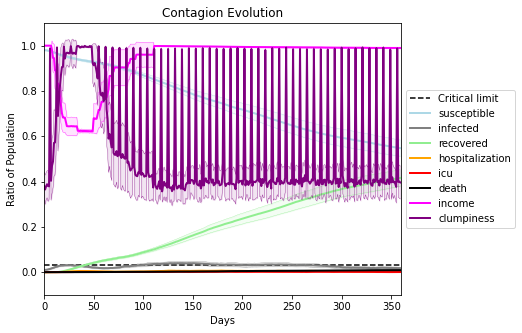

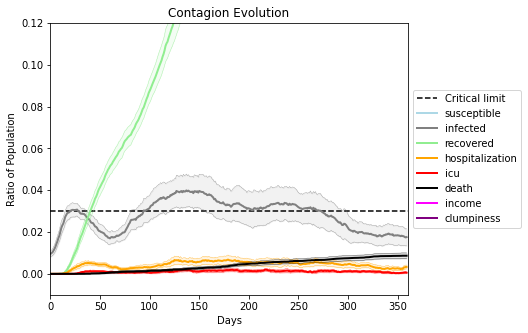

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2004, 2039, 2913, 3726, 6241, 3575, 7073, 3857, 7180, 653, 1781, 6088, 9542, 6272, 9698, 9663, 8024, 9906, 5864, 4217]
Average similarity between family members is 0.9714665058525366 at temperature -0.998
Average similarity between family and home is 0.9998301724989431 at temperature -1
Average similarity between students and their classroom is 0.7526138002556081 at temperature -0.998
Average classroom occupancy is 4.462686567164179 and number classrooms is 67
Average similarity between workers is 0.9618426463520572 at temperature -0.998
Average office occupancy is 3.518918918918919 and number offices is 185
Average friend similarity for adults: 0.8566919186582227 for kids: 0.7346105233321837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.611326933069862
avg restaurant similarity 0.8563983717228535
avg restaurant similarity 0.629366949064153
avg restaurant similarity 0.8792747478697719
avg restaurant similarity 0.9997307379211814
avg restaurant similarity 0.7450136998556673
avg restaurant similarity 0.6561519951208465
avg restaurant similarity 0.6952355497410179
avg restaurant similarity 0.9998053506230684
avg restaurant similarity 0.2540870826326685
avg restaurant similarity 0.6479801493407035
avg restaurant similarity 0.8182563718928229
avg restaurant similarity 0.643703977851086
avg restaurant similarity 0.2923407607777624
avg restaurant similarity 0.6972346705641496
avg restaurant similarity 0.48057863459167427
avg restaurant similarity 0.939343284446656
avg restaurant similarity 0.9998668327432045
avg restaurant similarity 0.41942316698210436
avg restaurant similarity 0.7727532425680232
avg restaurant similarity 0.6426563414832148
avg restaurant similarity 0.681057486262881
avg restauran

Average friend similarity for adults: 0.8653794090132257 for kids: 0.7170500814456079
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.599906226863654
avg restaurant similarity 0.8777861041753786
avg restaurant similarity 0.4917013864036083
avg restaurant similarity 0.5950425199781832
avg restaurant similarity 0.5488953887795095
avg restaurant similarity 0.6195194965686106
avg restaurant similarity 0.5005437253777826
avg restaurant similarity 0.4908281100163617
avg restaurant similarity 0.4820904260725252
avg restaurant similarity 0.8862131826884903
avg restaurant similarity 0.8869845406374
avg restaurant similarity 0.560349641997991
avg restaurant similarity 0.7781713345132395
avg restaurant similarity 0.8896266332706325
avg restaurant similarity 0.8657942033381755
avg restaurant similarity 0.8607966660244335
avg restaurant similarity 0.48678757651559357
avg restaurant similarity 0.7971778308587558
avg restaurant similarity 0.8875866818872996
avg restaurant similarity 0.9997274112580206
avg restaurant similarity 0.6833986628907592
avg restaurant similarity 0.7732802427839
avg restaurant si

avg restaurant similarity 0.5870517041869738
avg restaurant similarity 0.4874371572511868
avg restaurant similarity 0.8367898874907236
avg restaurant similarity 0.6027340222458666
avg restaurant similarity 0.35268710017944543
avg restaurant similarity 0.605295318423496
avg restaurant similarity 0.9999177823407819
avg restaurant similarity 0.9720383294194506
avg restaurant similarity 0.60234985208268
avg restaurant similarity 0.6823416119225781
avg restaurant similarity 0.5537637840887725
avg restaurant similarity 0.6808876649391846
avg restaurant similarity 0.5967120197193183
avg restaurant similarity 0.5090570918682691
avg restaurant similarity 0.48974592304820874
avg restaurant similarity 0.4219318235157714
avg restaurant similarity 0.48085306248455995
avg restaurant similarity 0.834320724832641
avg restaurant similarity 0.6070279119473685
avg restaurant similarity 0.5122147052935062
avg restaurant similarity 0.6163928383704779
avg restaurant similarity 0.5721119436075514
avg restaur

avg restaurant similarity 0.7728773223688281
avg restaurant similarity 0.6373453098299652
avg restaurant similarity 0.905698542931009
avg restaurant similarity 0.6576746856166589
avg restaurant similarity 0.5245871356333449
avg restaurant similarity 0.7591116611390895
avg restaurant similarity 0.5252334614376145
avg restaurant similarity 0.8530396753797579
avg restaurant similarity 0.611715655061053
avg restaurant similarity 0.8508843088217872
avg restaurant similarity 0.6353064630648095
avg restaurant similarity 0.8385381064972504
avg restaurant similarity 0.605597459218384
avg restaurant similarity 0.6643764605700823
avg restaurant similarity 0.8869023652740973
avg restaurant similarity 0.5744374301858635
avg restaurant similarity 0.8588524821890844
avg restaurant similarity 0.7226926558743074
avg restaurant similarity 0.8872791372075141
avg restaurant similarity 0.6316608750919728
avg restaurant similarity 0.3339163860415547
avg restaurant similarity 0.8952587251150098
avg restauran

avg restaurant similarity 0.7198810557900822
avg restaurant similarity 0.5543806799309173
avg restaurant similarity 0.5677870730433765
avg restaurant similarity 0.9991465712815123
avg restaurant similarity 0.4818724547755254
avg restaurant similarity 0.643292643875815
avg restaurant similarity 0.6689014006870033
avg restaurant similarity 0.6477451872419703
avg restaurant similarity 0.7894934632730328
avg restaurant similarity 0.635090630462749
avg restaurant similarity 0.7468542112365355
avg restaurant similarity 0.5252823295376182
avg restaurant similarity 0.4133252438730382
avg restaurant similarity 0.6331234603095022
avg restaurant similarity 0.7766493579444658
avg restaurant similarity 0.5206215500159664
avg restaurant similarity 0.7625495000546824
Average similarity between family members is 0.9669187268727166 at temperature -0.998
Average similarity between family and home is 0.9998614543764958 at temperature -1
Average similarity between students and their classroom is 0.7505531

avg restaurant similarity 0.29855227953202224
avg restaurant similarity 0.7035683306812082
avg restaurant similarity 0.7765767846538019
avg restaurant similarity 0.7026370138913829
avg restaurant similarity 0.7768542944163904
avg restaurant similarity 0.25685159303736754
avg restaurant similarity 0.6215364369934162
avg restaurant similarity 0.7205970361859277
avg restaurant similarity 0.6027749447222935
avg restaurant similarity 0.9997558203400123
avg restaurant similarity 0.9998152681150465
avg restaurant similarity 0.9006246358931784
avg restaurant similarity 0.2730541839379169
avg restaurant similarity 0.29734664752368684
avg restaurant similarity 0.7008073479867503
avg restaurant similarity 0.8039569913525022
avg restaurant similarity 0.6372370810193533
avg restaurant similarity 0.6337650985948334
avg restaurant similarity 0.9543378746757332
avg restaurant similarity 0.5607713959540883
avg restaurant similarity 0.5846832069579878
avg restaurant similarity 0.27296732406809365
avg re

avg restaurant similarity 0.7276384662595325
avg restaurant similarity 0.7053752861952252
avg restaurant similarity 0.7053752861952252
avg restaurant similarity 0.7921374570767992
avg restaurant similarity 0.7053752861952252
avg restaurant similarity 0.8473854432517951
avg restaurant similarity 0.6048894741263402
avg restaurant similarity 0.41538753394906874
avg restaurant similarity 0.8864844060376746
avg restaurant similarity 0.7741381365649167
avg restaurant similarity 0.7053752861952252
avg restaurant similarity 0.5700487858570882
avg restaurant similarity 0.7896450342994396
avg restaurant similarity 0.7261001446625581
avg restaurant similarity 0.8622077668563878
avg restaurant similarity 0.9996653596854737
avg restaurant similarity 0.9996866778482406
avg restaurant similarity 0.8242645401734059
avg restaurant similarity 0.715919444422781
avg restaurant similarity 0.9994847401880651
avg restaurant similarity 0.792314260887533
avg restaurant similarity 0.8355436921870716
avg restaur

avg restaurant similarity 0.6422377878262738
avg restaurant similarity 0.7020486758188841
avg restaurant similarity 0.45003419235650777
avg restaurant similarity 0.3224189273493522
avg restaurant similarity 0.6714783886874145
avg restaurant similarity 0.6669000744093638
avg restaurant similarity 0.7037445279692139
avg restaurant similarity 0.5708413018763371
avg restaurant similarity 0.22331443456717356
avg restaurant similarity 0.789087581599614
avg restaurant similarity 0.7593895403092059
avg restaurant similarity 0.6994398650192897
avg restaurant similarity 0.8519592721031606
avg restaurant similarity 0.6708857521237073
avg restaurant similarity 0.459248266371747
avg restaurant similarity 0.7333166488611841
avg restaurant similarity 0.5846767503466985
avg restaurant similarity 0.7025989220663873
avg restaurant similarity 0.6625641372577318
avg restaurant similarity 0.7037445279692139
avg restaurant similarity 0.5705747496385913
avg restaurant similarity 0.7037445279692139
avg restau

avg restaurant similarity 0.5425753828017226
avg restaurant similarity 0.3606771148437803
avg restaurant similarity 0.4153143768473244
avg restaurant similarity 0.5267993881767915
avg restaurant similarity 0.32094812605217
avg restaurant similarity 0.8332544921830015
avg restaurant similarity 0.7940423640861405
avg restaurant similarity 0.49461372325313313
avg restaurant similarity 0.6096952843585086
avg restaurant similarity 0.5298190241378483
avg restaurant similarity 0.9997849296490655
avg restaurant similarity 0.8587208083073905
avg restaurant similarity 0.7275719277569777
avg restaurant similarity 0.9996892229270828
avg restaurant similarity 0.5720123967071875
avg restaurant similarity 0.6561305413384413
avg restaurant similarity 0.5679544509574801
avg restaurant similarity 0.4025815717609034
avg restaurant similarity 0.8076957311072874
avg restaurant similarity 0.36419910145760703
avg restaurant similarity 0.48447584588467174
avg restaurant similarity 0.9998015475015192
avg resta

avg restaurant similarity 0.11926080845372612
avg restaurant similarity 0.7349482657107355
avg restaurant similarity 0.5330150153292909
avg restaurant similarity 0.5060257812677403
avg restaurant similarity 0.8772622460292907
avg restaurant similarity 0.4267804903268062
avg restaurant similarity 0.6438436521761609
avg restaurant similarity 0.9998109141075812
avg restaurant similarity 0.8985884011311333
avg restaurant similarity 0.46784731278217606
avg restaurant similarity 0.7353830496600469
avg restaurant similarity 0.5718635475112286
avg restaurant similarity 0.5190998223241734
avg restaurant similarity 0.895104843699577
avg restaurant similarity 0.7402016534709263
avg restaurant similarity 0.5230096628827456
avg restaurant similarity 0.8135045909711278
avg restaurant similarity 0.4069819165458972
avg restaurant similarity 0.5716908567190258
avg restaurant similarity 0.895104843699577
avg restaurant similarity 0.43070832368047607
avg restaurant similarity 0.45311430313807716
avg rest

avg restaurant similarity 0.5440724441577823
avg restaurant similarity 0.5423636297351158
avg restaurant similarity 0.3632216164667547
avg restaurant similarity 0.5916229513657834
avg restaurant similarity 0.5571575548564078
avg restaurant similarity 0.8538315694104885
avg restaurant similarity 0.55007914325792
avg restaurant similarity 0.3632216164667547
avg restaurant similarity 0.6482507208715053
avg restaurant similarity 0.28512624411172666
avg restaurant similarity 0.677526917372681
avg restaurant similarity 0.521624536528001
avg restaurant similarity 0.5076762948047389
avg restaurant similarity 0.28512624411172666
avg restaurant similarity 0.7399037631811465
avg restaurant similarity 0.7465481692073429
avg restaurant similarity 0.2444093744901935
avg restaurant similarity 0.508205025776717
avg restaurant similarity 0.558672536224747
avg restaurant similarity 0.6471601071476545
avg restaurant similarity 0.9998673363343809
avg restaurant similarity 0.5528780444330903
avg restaurant

avg restaurant similarity 0.6310490506653147
avg restaurant similarity 0.5683933359490053
avg restaurant similarity 0.864464904161439
avg restaurant similarity 0.8811334064392942
avg restaurant similarity 0.6467813127994178
avg restaurant similarity 0.6220913040629054
avg restaurant similarity 0.8347207398926341
avg restaurant similarity 0.5276098572380191
avg restaurant similarity 0.18964298418579278
avg restaurant similarity 0.1908595378173073
avg restaurant similarity 0.4978488137084651
avg restaurant similarity 0.3021869407249508
avg restaurant similarity 0.939846228313282
avg restaurant similarity 0.6668966792735389
avg restaurant similarity 0.5881256795283701
avg restaurant similarity 0.734492810681755
avg restaurant similarity 0.6525546853345043
avg restaurant similarity 0.6472724030503492
avg restaurant similarity 0.5928098461568134
avg restaurant similarity 0.5832830181669717
avg restaurant similarity 0.648228399315067
avg restaurant similarity 0.9063034775691031
avg restauran

avg restaurant similarity 0.6214234260536518
avg restaurant similarity 0.9998457472316775
avg restaurant similarity 0.9998182046567796
avg restaurant similarity 0.644838056911701
avg restaurant similarity 0.8205799080327132
avg restaurant similarity 0.6714392000495897
avg restaurant similarity 0.6428627858959381
avg restaurant similarity 0.8243997240690818
avg restaurant similarity 0.9125700731495102
avg restaurant similarity 0.5035915285854936
avg restaurant similarity 0.6724797730191484
avg restaurant similarity 0.820007889708401
avg restaurant similarity 0.857583532682848
avg restaurant similarity 0.2873887991396187
avg restaurant similarity 0.6145608623652556
avg restaurant similarity 0.5842094982370151
avg restaurant similarity 0.4352551675478553
avg restaurant similarity 0.5692800959024912
avg restaurant similarity 0.5955583398216355
avg restaurant similarity 0.7509397061041
avg restaurant similarity 0.5778758453315691
avg restaurant similarity 0.8512837866168399
avg restaurant s

avg restaurant similarity 0.7071691264270914
avg restaurant similarity 0.9001502295212009
avg restaurant similarity 0.499576607386518
avg restaurant similarity 0.7728017978916844
avg restaurant similarity 0.413920005353476
avg restaurant similarity 0.499576607386518
avg restaurant similarity 0.6521937256285013
avg restaurant similarity 0.6162223322239061
avg restaurant similarity 0.40087824943197176
avg restaurant similarity 0.6263133478975172
avg restaurant similarity 0.5649301844378257
avg restaurant similarity 0.6770802027088239
avg restaurant similarity 0.5923674210892091
avg restaurant similarity 0.7123682657196119
avg restaurant similarity 0.4331434631196936
avg restaurant similarity 0.30361773722806285
avg restaurant similarity 0.9998407001498469
avg restaurant similarity 0.6343166624133154
avg restaurant similarity 0.4493770958212778
avg restaurant similarity 0.617080103581162
avg restaurant similarity 0.5969621322857123
avg restaurant similarity 0.5868893906339894
avg restaura

avg restaurant similarity 0.7720029486891726
avg restaurant similarity 0.6113370691953226
avg restaurant similarity 0.6822206871423497
avg restaurant similarity 0.4700851906038671
avg restaurant similarity 0.8018745128750664
avg restaurant similarity 0.5842316054388262
avg restaurant similarity 0.6200728201990512
avg restaurant similarity 0.544770801101609
avg restaurant similarity 0.7376276070986207
avg restaurant similarity 0.5303811226241963
avg restaurant similarity 0.6164976994332383
avg restaurant similarity 0.4778304151444697
avg restaurant similarity 0.543526915219507
avg restaurant similarity 0.6391641058485451
avg restaurant similarity 0.7515375421863024
avg restaurant similarity 0.4375913534594207
avg restaurant similarity 0.6261166930379558
avg restaurant similarity 0.5841117523405548
avg restaurant similarity 0.607434300431176
avg restaurant similarity 0.4690627328682672
avg restaurant similarity 0.4088863951090885
avg restaurant similarity 0.5018369468613937
avg restauran

avg restaurant similarity 0.7119690340113835
avg restaurant similarity 0.3537547713737459
avg restaurant similarity 0.8223782299791605
avg restaurant similarity 0.9996245584929015
avg restaurant similarity 0.6475357515026323
avg restaurant similarity 0.764910515283596
avg restaurant similarity 0.35783708159430416
avg restaurant similarity 0.8070436353631103
avg restaurant similarity 0.8716112998662624
avg restaurant similarity 0.5750884703118233
avg restaurant similarity 0.4734320380279309
avg restaurant similarity 0.6521277275413271
avg restaurant similarity 0.7892969824429616
avg restaurant similarity 0.5776209906131946
avg restaurant similarity 0.6523758139281745
avg restaurant similarity 0.7126129994809298
avg restaurant similarity 0.6424797223096982
avg restaurant similarity 0.42790093554704545
avg restaurant similarity 0.7903712842049287
avg restaurant similarity 0.3539564596017234
avg restaurant similarity 0.6856616093218321
avg restaurant similarity 0.6386844906583962
avg resta

avg restaurant similarity 0.4497941753028335
avg restaurant similarity 0.5912027819269833
avg restaurant similarity 0.7158916974780909
avg restaurant similarity 0.6397092423392521
avg restaurant similarity 0.5830861250807025
avg restaurant similarity 0.8777951689016594
avg restaurant similarity 0.5454922210858579
avg restaurant similarity 0.6599326143177277
avg restaurant similarity 0.48893511541517587
avg restaurant similarity 0.7822576722437495
avg restaurant similarity 0.4174296819481888
avg restaurant similarity 0.5077976734096824
avg restaurant similarity 0.7437447357730023
avg restaurant similarity 0.6201134576970225
avg restaurant similarity 0.5478478880646303
avg restaurant similarity 0.9996865428463662
avg restaurant similarity 0.4806159811960481
avg restaurant similarity 0.5673614062952202
avg restaurant similarity 0.5242334404268971
avg restaurant similarity 0.6813272216574293
avg restaurant similarity 0.7676353592780687
avg restaurant similarity 0.719903981277199
avg restau

avg restaurant similarity 0.5961976911372135
avg restaurant similarity 0.9998170286305307
avg restaurant similarity 0.872713980999845
avg restaurant similarity 0.9998128991023343
avg restaurant similarity 0.576873144106089
avg restaurant similarity 0.9999614240825594
avg restaurant similarity 0.5125017519826227
avg restaurant similarity 0.45817487431209186
avg restaurant similarity 0.5411783854698552
avg restaurant similarity 0.999821918156665
avg restaurant similarity 0.999821918156665
avg restaurant similarity 0.43149118157937416
avg restaurant similarity 0.7017722375446696
avg restaurant similarity 0.9998170286305307
avg restaurant similarity 0.5965841414677413
avg restaurant similarity 0.7882286587609768
avg restaurant similarity 0.9997120577204983
avg restaurant similarity 0.8603044987634418
avg restaurant similarity 0.7050211986148459
avg restaurant similarity 0.41020595352903405
avg restaurant similarity 0.9999327607981953
avg restaurant similarity 0.6671209061088712
avg restaur

avg restaurant similarity 0.5024741348101229
avg restaurant similarity 0.6341461094917482
avg restaurant similarity 0.8265542603589532
avg restaurant similarity 0.6786294704092917
avg restaurant similarity 0.6961999149457833
avg restaurant similarity 0.6702915655085032
avg restaurant similarity 0.6963092304719597
avg restaurant similarity 0.6690418944660603
avg restaurant similarity 0.752524053352738
avg restaurant similarity 0.7149415867927025
avg restaurant similarity 0.8257453564114077
avg restaurant similarity 0.513643557961283
avg restaurant similarity 0.7170737233830508
avg restaurant similarity 0.7415547730653755
avg restaurant similarity 0.34627738149276915
avg restaurant similarity 0.40898284660354445
avg restaurant similarity 0.836788958634431
avg restaurant similarity 0.33142383423415356
avg restaurant similarity 0.8100980083688955
avg restaurant similarity 0.6490100520850868
avg restaurant similarity 0.5956649546928743
avg restaurant similarity 0.6962573609827827
avg restau

avg restaurant similarity 0.8810833433461681
avg restaurant similarity 0.7942132182304401
avg restaurant similarity 0.9382089090643679
avg restaurant similarity 0.2871084156475433
avg restaurant similarity 0.9212321055420576
avg restaurant similarity 0.3293773203708309
avg restaurant similarity 0.5793301917326813
avg restaurant similarity 0.7659733245479061
avg restaurant similarity 0.4183745991300302
avg restaurant similarity 0.843802114501589
avg restaurant similarity 0.9996122718244012
avg restaurant similarity 0.8389646519110677
avg restaurant similarity 0.539649421425595
avg restaurant similarity 0.7724783789786581
avg restaurant similarity 0.4448763557658919
avg restaurant similarity 0.5529712761687271
avg restaurant similarity 0.40013733258073975
avg restaurant similarity 0.6529560994028302
avg restaurant similarity 0.8135081480756806
avg restaurant similarity 0.9997321006098153
avg restaurant similarity 0.7552564603080812
avg restaurant similarity 0.7568814392044154
avg restaur

avg restaurant similarity 0.7058408155071567
avg restaurant similarity 0.44195844002912044
avg restaurant similarity 0.822814478840394
avg restaurant similarity 0.8572375268203567
avg restaurant similarity 0.6392622802151089
avg restaurant similarity 0.8718178426600924
avg restaurant similarity 0.6544955136405345
avg restaurant similarity 0.44085285135601493
avg restaurant similarity 0.6876993984643838
avg restaurant similarity 0.9998145839490243
avg restaurant similarity 0.9997328998921988
avg restaurant similarity 0.5755262573677269
avg restaurant similarity 0.43957613510242993
avg restaurant similarity 0.43957613510242993
avg restaurant similarity 0.5985231878496986
avg restaurant similarity 0.44195844002912044
avg restaurant similarity 0.6381182805404012
avg restaurant similarity 0.652968010921098
avg restaurant similarity 0.8152438736796814
avg restaurant similarity 0.8510769941233485
avg restaurant similarity 0.5652724926799639
avg restaurant similarity 0.8098433826024238
avg res

avg restaurant similarity 0.8688623994941875
avg restaurant similarity 0.394501218072966
avg restaurant similarity 0.9998685857551908
avg restaurant similarity 0.8812803693958885
avg restaurant similarity 0.37057089457277137
avg restaurant similarity 0.3731078204156426
avg restaurant similarity 0.37816546545575297
avg restaurant similarity 0.44346653319620977
avg restaurant similarity 0.8571822154252805
avg restaurant similarity 0.7873765169611701
avg restaurant similarity 0.7955787791649038
avg restaurant similarity 0.497689212355519
avg restaurant similarity 0.9993354284910152
avg restaurant similarity 0.46968780675600685
avg restaurant similarity 0.42285851275588643
avg restaurant similarity 0.8935826684808772
avg restaurant similarity 0.9999557648110847
avg restaurant similarity 0.5482042917486064
avg restaurant similarity 0.38702407408361206
avg restaurant similarity 0.869859072111786
avg restaurant similarity 0.4998095000235459
avg restaurant similarity 0.78728991432928
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

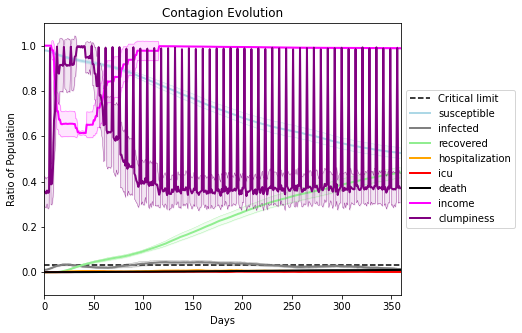

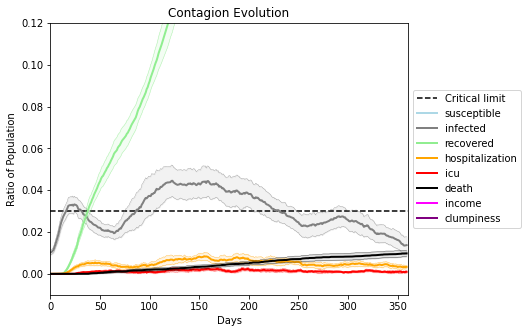

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4526, 4532, 6798, 4024, 2942, 3045, 5500, 7942, 6484, 7657, 4624, 3146, 1582, 1084, 6256, 3518, 7286, 6728, 3723, 2666]
Average similarity between family members is 0.9568762388909668 at temperature -0.9975
Average similarity between family and home is 0.9998646935816705 at temperature -1
Average similarity between students and their classroom is 0.6726475855280063 at temperature -0.9975
Average classroom occupancy is 3.9714285714285715 and number classrooms is 70
Average similarity between workers is 0.9221413705329474 at temperature -0.9975
Average office occupancy is 3.6236559139784945 and number offices is 186
Average friend similarity for adults: 0.864757715135062 for kids: 0.7045100685531427
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.637188828632881
avg restaurant similarity 0.34344004628402997
avg restaurant similarity 0.5285898723528246
avg restaurant similarity 0.3904305719292534
avg restaurant similarity 0.44023213173268794
avg restaurant similarity 0.8834070300633325
avg restaurant similarity 0.9997566843592467
avg restaurant similarity 0.8264756359304681
avg restaurant similarity 0.516224854870864
avg restaurant similarity 0.25411152087292105
avg restaurant similarity 0.5726180250524207
avg restaurant similarity 0.7906417232123538
avg restaurant similarity 0.999870842865177
avg restaurant similarity 0.6741182234396222
avg restaurant similarity 0.49115090847300624
avg restaurant similarity 0.7883224714412578
avg restaurant similarity 0.5866087980435497
avg restaurant similarity 0.2949226992889465
avg restaurant similarity 0.5726180250524207
avg restaurant similarity 0.4444310077270978
avg restaurant similarity 0.3487451223874888
avg restaurant similarity 0.9372982710097845
avg resta

avg restaurant similarity 0.7446900577833072
avg restaurant similarity 0.5890116169102884
avg restaurant similarity 0.5671351730283329
avg restaurant similarity 0.36854254207465087
avg restaurant similarity 0.4220372311649541
avg restaurant similarity 0.5746915732862674
avg restaurant similarity 0.771964724367373
avg restaurant similarity 0.47082758916100576
avg restaurant similarity 0.8189365644264676
avg restaurant similarity 0.7120243625979915
avg restaurant similarity 0.37059668907350574
avg restaurant similarity 0.7110238765831363
avg restaurant similarity 0.7110238765831363
avg restaurant similarity 0.5831509371726672
avg restaurant similarity 0.5159145625482717
avg restaurant similarity 0.5797419220197655
avg restaurant similarity 0.23843538849265197
avg restaurant similarity 0.6774521713687256
avg restaurant similarity 0.47567570955572835
avg restaurant similarity 0.6951620624459353
avg restaurant similarity 0.43802233244260524
avg restaurant similarity 0.9998790192612388
avg r

avg restaurant similarity 0.6952208999203557
avg restaurant similarity 0.681249834623466
avg restaurant similarity 0.8040508866465633
avg restaurant similarity 0.5996205028109256
avg restaurant similarity 0.8520709261747393
avg restaurant similarity 0.4802706844807545
avg restaurant similarity 0.5493647594045907
avg restaurant similarity 0.7973925372324707
avg restaurant similarity 0.8039712883851825
avg restaurant similarity 0.9007833219416802
avg restaurant similarity 0.6981834930127402
avg restaurant similarity 0.6285581663561589
avg restaurant similarity 0.36069594670859045
avg restaurant similarity 0.47789223372282486
avg restaurant similarity 0.5065579200083206
avg restaurant similarity 0.19747707447002885
avg restaurant similarity 0.9997905760615968
avg restaurant similarity 0.5818386388610665
avg restaurant similarity 0.6933958204739356
avg restaurant similarity 0.7447323063956052
avg restaurant similarity 0.5596237140895449
avg restaurant similarity 0.5839660114371938
avg rest

avg restaurant similarity 0.7313107127865761
avg restaurant similarity 0.670081053360563
avg restaurant similarity 0.4928085242983894
avg restaurant similarity 0.779818590801619
avg restaurant similarity 0.6780701965331153
avg restaurant similarity 0.3131605472850904
avg restaurant similarity 0.6590892681711699
avg restaurant similarity 0.6319109450176363
avg restaurant similarity 0.9426676552013271
avg restaurant similarity 0.8170665763159202
avg restaurant similarity 0.8841646545919488
avg restaurant similarity 0.9998122499107118
avg restaurant similarity 0.6697991305851831
avg restaurant similarity 0.6337184415282762
avg restaurant similarity 0.7059299077746374
avg restaurant similarity 0.5683054804728502
avg restaurant similarity 0.7073908308706804
avg restaurant similarity 0.5519006505325368
avg restaurant similarity 0.44907625733999823
avg restaurant similarity 0.7624458760340399
avg restaurant similarity 0.6695080170063217
avg restaurant similarity 0.7247390307297097
avg restaur

avg restaurant similarity 0.6790373673792311
avg restaurant similarity 0.6073249610631866
avg restaurant similarity 0.6551595242712248
avg restaurant similarity 0.9998552999747627
avg restaurant similarity 0.9998442719145526
avg restaurant similarity 0.4199743925287924
avg restaurant similarity 0.3461969317009683
avg restaurant similarity 0.5226829841086593
avg restaurant similarity 0.4937518533566165
avg restaurant similarity 0.6797107093689096
Average similarity between family members is 0.9616324899281619 at temperature -0.9975
Average similarity between family and home is 0.9998579095144888 at temperature -1
Average similarity between students and their classroom is 0.6549228638224786 at temperature -0.9975
Average classroom occupancy is 4.411764705882353 and number classrooms is 68
Average similarity between workers is 0.9368724995162113 at temperature -0.9975
Average office occupancy is 3.304123711340206 and number offices is 194
Average friend similarity for adults: 0.8536595421

avg restaurant similarity 0.67740993546601
avg restaurant similarity 0.6589880479338506
avg restaurant similarity 0.7258479906320987
avg restaurant similarity 0.4903500877587033
avg restaurant similarity 0.6067181533355198
avg restaurant similarity 0.5779853032092945
avg restaurant similarity 0.9995146231656515
avg restaurant similarity 0.5732933483075228
avg restaurant similarity 0.8485103496484194
avg restaurant similarity 0.8452837453577816
avg restaurant similarity 0.6795445175715558
avg restaurant similarity 0.50227947559214
avg restaurant similarity 0.6322977808810077
avg restaurant similarity 0.7247479661165319
avg restaurant similarity 0.5925274264209969
avg restaurant similarity 0.6502159562535783
avg restaurant similarity 0.4737330660867204
avg restaurant similarity 0.5437166207985766
avg restaurant similarity 0.4626041666685432
avg restaurant similarity 0.594332110823296
avg restaurant similarity 0.8099293670032124
avg restaurant similarity 0.7006419133505246
avg restaurant 

Average friend similarity for adults: 0.8615680915826144 for kids: 0.69674776045824
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.5553509925099356
avg restaurant similarity 0.5950663741816239
avg restaurant similarity 0.4659887167633185
avg restaurant similarity 0.5948496677361204
avg restaurant similarity 0.5044621076133655
avg restaurant similarity 0.7329028108111869
avg restaurant similarity 0.3443016357591254
avg restaurant similarity 0.354787378477676
avg restaurant similarity 0.3650272579864215
avg restaurant similarity 0.9998298719434016
avg restaurant similarity 0.49247578416520565
avg restaurant similarity 0.38368691373753333
avg restaurant similarity 0.9379405763029883
avg restaurant similarity 0.5298811257919666
avg restaurant similarity 0.48285777506625466
avg restaurant similarity 0.554407938227677
avg restaurant similarity 0.9058468098396095
avg restaurant similarity 0.7395123470224052
avg restaurant similarity 0.361235814717682
avg restaurant similarity 0.3620501086234056
avg restaurant similarity 0.3622154879580882
avg restaurant similarity 0.4830097414877921
avg restau

avg restaurant similarity 0.5082003771940412
avg restaurant similarity 0.9998950125475323
avg restaurant similarity 0.3897553962332525
avg restaurant similarity 0.4696382998810257
avg restaurant similarity 0.12843629731869238
avg restaurant similarity 0.589354821781787
avg restaurant similarity 0.8691291107238701
avg restaurant similarity 0.3530719940369399
avg restaurant similarity 0.542292280516773
avg restaurant similarity 0.42180544187015545
avg restaurant similarity 0.3567520417248303
avg restaurant similarity 0.7936317121526992
avg restaurant similarity 0.7700557038336392
avg restaurant similarity 0.5011268116059562
avg restaurant similarity 0.9996326238665618
avg restaurant similarity 0.4652146714770875
avg restaurant similarity 0.9998086387680803
avg restaurant similarity 0.4364863007021371
avg restaurant similarity 0.803355352029391
avg restaurant similarity 0.9361949479548488
avg restaurant similarity 0.9997956406340556
avg restaurant similarity 0.9344159907985141
avg restaur

avg restaurant similarity 0.48949089886353786
Average similarity between family members is 0.9560798713613149 at temperature -0.9975
Average similarity between family and home is 0.9998539698293573 at temperature -1
Average similarity between students and their classroom is 0.693430493668325 at temperature -0.9975
Average classroom occupancy is 4.298507462686567 and number classrooms is 67
Average similarity between workers is 0.9292262751128185 at temperature -0.9975
Average office occupancy is 3.4083769633507854 and number offices is 191
Average friend similarity for adults: 0.8623503801090459 for kids: 0.7173676811205479
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.892206806918413
avg restaurant similarity 0.7813008300270354
avg restaurant similarity 0.3752356349044293
avg restaurant similarity 0.3174125160627028
avg restaurant similarity 0.45520689272596104
avg restaurant similarity 0.5393273741545868
avg restaurant similarity 0.7100851196275789
avg restaurant similarity 0.7479729922322585
avg restaurant similarity 0.27515872028744925
avg restaurant similarity 0.5430911095353563
avg restaurant similarity 0.48247050374464995
avg restaurant similarity 0.6280665897211692
avg restaurant similarity 0.7241184341461115
avg restaurant similarity 0.7559600033262303
avg restaurant similarity 0.4860443530869405
avg restaurant similarity 0.4978112640962867
avg restaurant similarity 0.4846866599409413
avg restaurant similarity 0.6753971645048173
avg restaurant similarity 0.5251944397505379
avg restaurant similarity 0.46954561095412417
avg restaurant similarity 0.8141497984981675
avg restaurant similarity 0.5164819570201221
avg res

avg restaurant similarity 0.4851967681882782
avg restaurant similarity 0.3553143348144231
avg restaurant similarity 0.7195194557375992
avg restaurant similarity 0.5536435186280089
avg restaurant similarity 0.9996623819392232
avg restaurant similarity 0.6112952037852276
avg restaurant similarity 0.5818486096553186
avg restaurant similarity 0.6859300613402157
avg restaurant similarity 0.5767850159393418
avg restaurant similarity 0.4792550599252954
avg restaurant similarity 0.8859126106596215
avg restaurant similarity 0.5543761266096097
avg restaurant similarity 0.3553528626994687
avg restaurant similarity 0.290587582680489
avg restaurant similarity 0.6995631102062715
avg restaurant similarity 0.5561892491624145
avg restaurant similarity 0.3876352120495307
avg restaurant similarity 0.5749514197480884
avg restaurant similarity 0.4883178780165989
avg restaurant similarity 0.44661409456762613
avg restaurant similarity 0.38571726599036227
avg restaurant similarity 0.694592584574279
avg restau

avg restaurant similarity 0.5889164980707219
avg restaurant similarity 0.4073933925767772
avg restaurant similarity 0.7824134249918813
avg restaurant similarity 0.9996853711218356
avg restaurant similarity 0.8266135239470147
avg restaurant similarity 0.8023959825651945
avg restaurant similarity 0.40989804430795507
avg restaurant similarity 0.21652681526177286
avg restaurant similarity 0.4212794032313849
avg restaurant similarity 0.8285580086787508
avg restaurant similarity 0.6959774170980945
avg restaurant similarity 0.6966692920763837
avg restaurant similarity 0.8234573888267565
avg restaurant similarity 0.6351211278136037
avg restaurant similarity 0.4513146882253084
avg restaurant similarity 0.3770968872877897
avg restaurant similarity 0.5046668671101535
avg restaurant similarity 0.6051055285532511
avg restaurant similarity 0.6127973962906761
avg restaurant similarity 0.5458955522634781
avg restaurant similarity 0.44044042360262026
avg restaurant similarity 0.3836195874943768
avg res

avg restaurant similarity 0.6874323567309844
avg restaurant similarity 0.4405617690067237
avg restaurant similarity 0.42239790131254207
avg restaurant similarity 0.6241245928737792
avg restaurant similarity 0.5729997083687877
avg restaurant similarity 0.6973909203781979
avg restaurant similarity 0.5499954062560923
avg restaurant similarity 0.4528841415009506
avg restaurant similarity 0.5880418214946228
avg restaurant similarity 0.6013288979375038
avg restaurant similarity 0.5671844412079485
avg restaurant similarity 0.5621764258306859
avg restaurant similarity 0.4571826873783419
avg restaurant similarity 0.8869775153940548
avg restaurant similarity 0.9312625276853143
avg restaurant similarity 0.7109153481006832
avg restaurant similarity 0.7241065805723217
avg restaurant similarity 0.5808190873068378
avg restaurant similarity 0.5932248965936653
avg restaurant similarity 0.47547775767041933
avg restaurant similarity 0.37948103205258693
avg restaurant similarity 0.7841913625229789
avg res

avg restaurant similarity 0.6792050669870675
avg restaurant similarity 0.7285223703079904
avg restaurant similarity 0.47533158451447716
Average similarity between family members is 0.9586554664548419 at temperature -0.9975
Average similarity between family and home is 0.9998544221146776 at temperature -1
Average similarity between students and their classroom is 0.686158322295632 at temperature -0.9975
Average classroom occupancy is 4.338235294117647 and number classrooms is 68
Average similarity between workers is 0.9392246494358897 at temperature -0.9975
Average office occupancy is 3.5081081081081082 and number offices is 185
Average friend similarity for adults: 0.8632538168367093 for kids: 0.7308146431674591
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.5603356750368587
avg restaurant similarity 0.4579130139384036
avg restaurant similarity 0.4907628928618291
avg restaurant similarity 0.7560118629645063
avg restaurant similarity 0.8786918083958585
avg restaurant similarity 0.9996281175587048
avg restaurant similarity 0.5887956394096999
avg restaurant similarity 0.5433516877370876
avg restaurant similarity 0.6118071349713676
avg restaurant similarity 0.5581247807587537
avg restaurant similarity 0.7762086003371282
avg restaurant similarity 0.5565124403607555
avg restaurant similarity 0.5544502176702621
avg restaurant similarity 0.6960363055091011
avg restaurant similarity 0.4907237041854164
avg restaurant similarity 0.4720161679046816
avg restaurant similarity 0.8826429000367593
avg restaurant similarity 0.7178881840973107
avg restaurant similarity 0.7412638354178398
avg restaurant similarity 0.43224643099302495
avg restaurant similarity 0.8105190876216977
avg restaurant similarity 0.8475123240030455
avg resta

avg restaurant similarity 0.6031072602144525
avg restaurant similarity 0.398411049155703
avg restaurant similarity 0.48824424514802456
avg restaurant similarity 0.9149686889626152
avg restaurant similarity 0.5130107930123761
avg restaurant similarity 0.68649087346977
avg restaurant similarity 0.5080188973485786
avg restaurant similarity 0.547340865549071
avg restaurant similarity 0.8782454268192288
avg restaurant similarity 0.5451828218026247
avg restaurant similarity 0.5621622170861742
avg restaurant similarity 0.459741820071056
Average similarity between family members is 0.9531680386322987 at temperature -0.9975
Average similarity between family and home is 0.9998454876836789 at temperature -1
Average similarity between students and their classroom is 0.6164027329200996 at temperature -0.9975
Average classroom occupancy is 4.235294117647059 and number classrooms is 68
Average similarity between workers is 0.9357665799301527 at temperature -0.9975
Average office occupancy is 3.314432

avg restaurant similarity 0.662063845853202
avg restaurant similarity 0.5079801001060935
avg restaurant similarity 0.7844859135778696
avg restaurant similarity 0.6009288633083131
avg restaurant similarity 0.6250356736895357
avg restaurant similarity 0.445881790195061
avg restaurant similarity 0.7346555103103878
avg restaurant similarity 0.6209652815703219
avg restaurant similarity 0.41368140738851095
avg restaurant similarity 0.5173225804803794
avg restaurant similarity 0.5728534753995911
avg restaurant similarity 0.999896688354595
avg restaurant similarity 0.8075721734346887
avg restaurant similarity 0.08196356671745092
avg restaurant similarity 0.45938712064410603
avg restaurant similarity 0.49732128508362405
avg restaurant similarity 0.6123251205580821
avg restaurant similarity 0.33556700504941817
avg restaurant similarity 0.4799871819100842
avg restaurant similarity 0.5107524183713776
avg restaurant similarity 0.5334375408531353
avg restaurant similarity 0.5005489448286355
avg rest

avg restaurant similarity 0.636263231979094
avg restaurant similarity 0.6944646086568977
avg restaurant similarity 0.5655549639072699
avg restaurant similarity 0.4365196357480255
avg restaurant similarity 0.40221099771396207
avg restaurant similarity 0.5168447090537384
avg restaurant similarity 0.5024524619701669
avg restaurant similarity 0.4420288304695841
avg restaurant similarity 0.6669372164545392
avg restaurant similarity 0.5476795071537179
avg restaurant similarity 0.3968262442633244
avg restaurant similarity 0.6449825779504834
avg restaurant similarity 0.7063908206744219
avg restaurant similarity 0.6354231355097151
avg restaurant similarity 0.4550434679959323
avg restaurant similarity 0.45310034064629734
avg restaurant similarity 0.7978675649960378
avg restaurant similarity 0.5894825245791223
avg restaurant similarity 0.5503634389508654
avg restaurant similarity 0.8467006286085192
avg restaurant similarity 0.4099512268317317
avg restaurant similarity 0.5023838525620888
avg resta

avg restaurant similarity 0.560520030977076
avg restaurant similarity 0.8980338985022482
avg restaurant similarity 0.928582964999103
avg restaurant similarity 0.9522996453460119
avg restaurant similarity 0.342922729349099
avg restaurant similarity 0.9997195012992194
avg restaurant similarity 0.46802075835756984
avg restaurant similarity 0.6967967511027957
avg restaurant similarity 0.47068893453754806
avg restaurant similarity 0.5253235361094377
avg restaurant similarity 0.9426047114181912
avg restaurant similarity 0.8708534696250434
avg restaurant similarity 0.6142145615487483
avg restaurant similarity 0.9286062966611326
avg restaurant similarity 0.9997046779870802
avg restaurant similarity 0.6799391429826667
avg restaurant similarity 0.5624924078635092
avg restaurant similarity 0.5267719570667494
avg restaurant similarity 0.8599461695549584
avg restaurant similarity 0.3441348410276883
avg restaurant similarity 0.4163266089084739
avg restaurant similarity 0.7489911207392348
avg restaur

avg restaurant similarity 0.5160678423617429
avg restaurant similarity 0.7120896468914019
avg restaurant similarity 0.6881088453814372
avg restaurant similarity 0.5305795139404568
avg restaurant similarity 0.3822131410306096
avg restaurant similarity 0.5374404148576205
avg restaurant similarity 0.6247905452050377
avg restaurant similarity 0.6781054704843865
avg restaurant similarity 0.5177625621676222
avg restaurant similarity 0.7960334813136174
avg restaurant similarity 0.36480563164594293
avg restaurant similarity 0.47835849448554835
avg restaurant similarity 0.8629343860739577
avg restaurant similarity 0.646590101800794
avg restaurant similarity 0.8527306731727449
avg restaurant similarity 0.1705270967695331
avg restaurant similarity 0.35885145326237977
avg restaurant similarity 0.6625402334943982
avg restaurant similarity 0.7820751273128754
avg restaurant similarity 0.8484154851898231
avg restaurant similarity 0.5720863195402405
avg restaurant similarity 0.5462347994180883
avg rest

avg restaurant similarity 0.5901524212707279
avg restaurant similarity 0.5749271161827937
avg restaurant similarity 0.5502656891438292
avg restaurant similarity 0.9454378666905223
avg restaurant similarity 0.47382335555714084
avg restaurant similarity 0.5641499202214783
avg restaurant similarity 0.852070468605343
avg restaurant similarity 0.9422236970137525
avg restaurant similarity 0.5642755557978989
avg restaurant similarity 0.9996573327390312
avg restaurant similarity 0.8212305382027417
avg restaurant similarity 0.5553705012182789
avg restaurant similarity 0.8847394187968007
avg restaurant similarity 0.6748227126878579
avg restaurant similarity 0.7074627156632323
avg restaurant similarity 0.5965365846265257
avg restaurant similarity 0.8091275820503461
avg restaurant similarity 0.7692192285863289
avg restaurant similarity 0.703888872835855
avg restaurant similarity 0.3279212824577461
avg restaurant similarity 0.6121665251776658
avg restaurant similarity 0.899320109565022
avg restaura

avg restaurant similarity 0.5481364172452567
avg restaurant similarity 0.8479807291141372
avg restaurant similarity 0.5329067185344141
avg restaurant similarity 0.7595218853735402
avg restaurant similarity 0.6287150120775602
avg restaurant similarity 0.550074558770508
avg restaurant similarity 0.9997900129030381
avg restaurant similarity 0.8966938184055777
avg restaurant similarity 0.7353907031977042
avg restaurant similarity 0.4971228048405445
avg restaurant similarity 0.535370968429782
avg restaurant similarity 0.5102057894038194
avg restaurant similarity 0.8631401839435964
avg restaurant similarity 0.6365379060761487
avg restaurant similarity 0.8879783076186294
avg restaurant similarity 0.5002240393987489
avg restaurant similarity 0.44845507836620946
avg restaurant similarity 0.8790337407281572
avg restaurant similarity 0.6123084010329579
avg restaurant similarity 0.8970837912414924
avg restaurant similarity 0.5330183946243638
avg restaurant similarity 0.8879783076186294
avg restaur

avg restaurant similarity 0.5826001092588007
avg restaurant similarity 0.27895154838507014
avg restaurant similarity 0.42405090087735287
avg restaurant similarity 0.6285033815084926
avg restaurant similarity 0.675969942804044
avg restaurant similarity 0.2831234751223106
avg restaurant similarity 0.6013543836519633
avg restaurant similarity 0.5257713495327765
avg restaurant similarity 0.4624500535482487
avg restaurant similarity 0.5165788137220158
avg restaurant similarity 0.49932272669862343
avg restaurant similarity 0.48767209130138733
avg restaurant similarity 0.5959031412829217
avg restaurant similarity 0.4653846103334948
avg restaurant similarity 0.5961331033531962
avg restaurant similarity 0.659047194212378
avg restaurant similarity 0.857803698154891
avg restaurant similarity 0.46125362126814123
avg restaurant similarity 0.8226092284262384
avg restaurant similarity 0.46876319924309834
avg restaurant similarity 0.5281850140998228
avg restaurant similarity 0.29067615021221965
avg re

avg restaurant similarity 0.5561200231879186
avg restaurant similarity 0.9997670425852794
avg restaurant similarity 0.6964993729857346
avg restaurant similarity 0.7280717391624852
avg restaurant similarity 0.4196794225277565
avg restaurant similarity 0.46928186229815594
avg restaurant similarity 0.5226591163615235
avg restaurant similarity 0.44755575373246476
avg restaurant similarity 0.5861936559314643
avg restaurant similarity 0.4191117603991811
avg restaurant similarity 0.45722707508084265
avg restaurant similarity 0.43790750247896254
avg restaurant similarity 0.588346086929311
avg restaurant similarity 0.999617650405112
avg restaurant similarity 0.9238847793057419
avg restaurant similarity 0.9245219506328336
avg restaurant similarity 0.895206749914779
avg restaurant similarity 0.5896861988952098
avg restaurant similarity 0.5220510115245766
avg restaurant similarity 0.5635668057018521
avg restaurant similarity 0.7166004815173739
avg restaurant similarity 0.9239686675915132
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

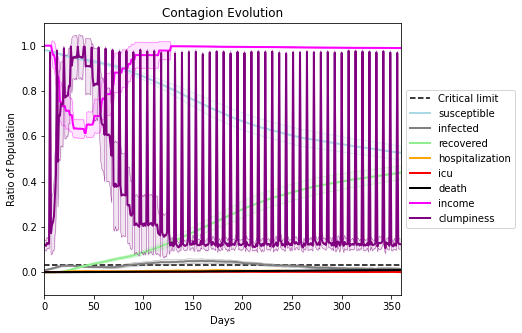

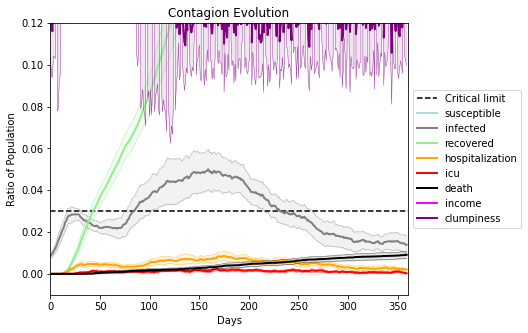

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6916, 1138, 1506, 4464, 862, 559, 3654, 6422, 8693, 3853, 4316, 8789, 4288, 528, 9642, 8152, 5800, 8154, 3671, 9823]
Average similarity between family members is 0.9571619334327596 at temperature -0.997
Average similarity between family and home is 0.9998582029345868 at temperature -1
Average similarity between students and their classroom is 0.6765156442160852 at temperature -0.997
Average classroom occupancy is 4.057971014492754 and number classrooms is 69
Average similarity between workers is 0.9166304954414435 at temperature -0.997
Average office occupancy is 3.5157894736842104 and number offices is 190
Average friend similarity for adults: 0.8491805337088125 for kids: 0.6994473214479081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.9996840956086204
avg restaurant similarity 0.5014505851020965
avg restaurant similarity 0.4945967496594274
avg restaurant similarity 0.5239610556972669
avg restaurant similarity 0.6037136541296847
avg restaurant similarity 0.6447960233707345
avg restaurant similarity 0.39081693583885435
avg restaurant similarity 0.7072623680334575
avg restaurant similarity 0.46564434068363647
avg restaurant similarity 0.6602125432970977
avg restaurant similarity 0.3857144827605756
avg restaurant similarity 0.6101512770720638
avg restaurant similarity 0.6335887608895592
avg restaurant similarity 0.7364673550971678
avg restaurant similarity 0.6870691753881668
avg restaurant similarity 0.47581319629705976
avg restaurant similarity 0.4427835112308579
avg restaurant similarity 0.41222214362679893
avg restaurant similarity 0.7926283252201588
avg restaurant similarity 0.9998375658299778
avg restaurant similarity 0.34418251993601606
avg restaurant similarity 0.29450309148462034
avg 

avg restaurant similarity 0.5921327776015006
avg restaurant similarity 0.9998724458919299
avg restaurant similarity 0.6038811992901356
avg restaurant similarity 0.8802947593513711
avg restaurant similarity 0.6819363264952525
avg restaurant similarity 0.42607012783520326
avg restaurant similarity 0.4095213047215179
avg restaurant similarity 0.5451852262457859
avg restaurant similarity 0.755974714552936
avg restaurant similarity 0.8276171739185283
avg restaurant similarity 0.5955534448942632
avg restaurant similarity 0.9998055082299608
avg restaurant similarity 0.6015357480102126
avg restaurant similarity 0.39350068949292705
avg restaurant similarity 0.6289433136446254
avg restaurant similarity 0.9029027825997593
avg restaurant similarity 0.3409774553339723
avg restaurant similarity 0.8083252975460234
avg restaurant similarity 0.6819363264952525
avg restaurant similarity 0.3097600603843552
avg restaurant similarity 0.7700937415834491
avg restaurant similarity 0.45737131514765417
avg rest

avg restaurant similarity 0.7750126399943461
avg restaurant similarity 0.8630299414794043
avg restaurant similarity 0.6022613575296587
avg restaurant similarity 0.9386152002072161
avg restaurant similarity 0.6583574891601727
avg restaurant similarity 0.3980866222561922
avg restaurant similarity 0.43380883756625765
avg restaurant similarity 0.9407164707555961
avg restaurant similarity 0.9998236113144621
avg restaurant similarity 0.5583347838609968
avg restaurant similarity 0.6196876453496585
avg restaurant similarity 0.5919512842529848
avg restaurant similarity 0.3451388727618699
avg restaurant similarity 0.4327828673651794
avg restaurant similarity 0.8425171423003646
avg restaurant similarity 0.7249955613365662
avg restaurant similarity 0.7236938232662906
avg restaurant similarity 0.7455446822507751
avg restaurant similarity 0.39201121539149064
avg restaurant similarity 0.5426834865348089
avg restaurant similarity 0.7344678724318966
avg restaurant similarity 0.7259152204248736
avg rest

avg restaurant similarity 0.7007562386231184
avg restaurant similarity 0.4712276964378721
avg restaurant similarity 0.4734120436272691
avg restaurant similarity 0.3958403021012866
avg restaurant similarity 0.622329958920904
avg restaurant similarity 0.6239590849252702
avg restaurant similarity 0.41775589177908623
avg restaurant similarity 0.6096384743700287
avg restaurant similarity 0.39789724045060837
avg restaurant similarity 0.6427443410783767
avg restaurant similarity 0.4727069502276775
avg restaurant similarity 0.4734120436272691
avg restaurant similarity 0.6706545800813044
avg restaurant similarity 0.4126390362840888
avg restaurant similarity 0.5774349447427003
avg restaurant similarity 0.3192722901412604
avg restaurant similarity 0.9058688700299352
avg restaurant similarity 0.5064704108301459
avg restaurant similarity 0.38482606403406033
avg restaurant similarity 0.6052956127345863
avg restaurant similarity 0.807726007475589
avg restaurant similarity 0.43602777159293027
avg rest

avg restaurant similarity 0.5469261746797043
avg restaurant similarity 0.6052165877086039
avg restaurant similarity 0.36800386341535896
avg restaurant similarity 0.6883807610372312
avg restaurant similarity 0.5190221009886962
avg restaurant similarity 0.7000865075455831
avg restaurant similarity 0.7546042023949948
avg restaurant similarity 0.6075146576321808
avg restaurant similarity 0.7144753211992043
avg restaurant similarity 0.5117068278067146
avg restaurant similarity 0.07542703304677445
avg restaurant similarity 0.5390118793854104
avg restaurant similarity 0.46144542206720424
avg restaurant similarity 0.5658138668312538
avg restaurant similarity 0.7000865075455831
avg restaurant similarity 0.6746458765751747
avg restaurant similarity 0.5761318885302184
avg restaurant similarity 0.7131622597622729
avg restaurant similarity 0.6510980747888411
avg restaurant similarity 0.6897414277286557
avg restaurant similarity 0.6546232878289966
avg restaurant similarity 0.5798811098314836
avg res

avg restaurant similarity 0.47998900774203485
avg restaurant similarity 0.45434213542381896
avg restaurant similarity 0.7527681916675862
avg restaurant similarity 0.6119096963832824
avg restaurant similarity 0.6191813620980877
avg restaurant similarity 0.5049523159104043
avg restaurant similarity 0.7119594939380367
avg restaurant similarity 0.7804227745305266
avg restaurant similarity 0.4816688391207001
Average similarity between family members is 0.9577305839637706 at temperature -0.997
Average similarity between family and home is 0.9998601450648787 at temperature -1
Average similarity between students and their classroom is 0.6738377424446795 at temperature -0.997
Average classroom occupancy is 4.318840579710145 and number classrooms is 69
Average similarity between workers is 0.9325323807524369 at temperature -0.997
Average office occupancy is 3.4041450777202074 and number offices is 193
Average friend similarity for adults: 0.8623772004020753 for kids: 0.7065426079085124
home_dist

avg restaurant similarity 0.4626058483752974
avg restaurant similarity 0.5660780408002681
avg restaurant similarity 0.5020621672852321
avg restaurant similarity 0.3707586789226352
avg restaurant similarity 0.448579409277294
avg restaurant similarity 0.8430273677626768
avg restaurant similarity 0.8431557851884816
avg restaurant similarity 0.5109302636325448
avg restaurant similarity 0.5437471657112914
avg restaurant similarity 0.3692407710162275
avg restaurant similarity 0.577557194044891
avg restaurant similarity 0.5655230482689326
avg restaurant similarity 0.999708379565585
avg restaurant similarity 0.5883489992696395
avg restaurant similarity 0.547025888907821
avg restaurant similarity 0.3847894983139449
avg restaurant similarity 0.6013435706326001
avg restaurant similarity 0.5866469784703712
avg restaurant similarity 0.4807058445860444
avg restaurant similarity 0.5901603972138411
avg restaurant similarity 0.999708379565585
avg restaurant similarity 0.5154115544642026
avg restaurant 

avg restaurant similarity 0.5852539822306545
avg restaurant similarity 0.6180573827312362
avg restaurant similarity 0.8927280232726352
avg restaurant similarity 0.6566997148361963
avg restaurant similarity 0.2926505855295302
avg restaurant similarity 0.6162477450516544
avg restaurant similarity 0.4653570770535272
avg restaurant similarity 0.6566997148361963
avg restaurant similarity 0.312222093712609
avg restaurant similarity 0.5363801998957003
avg restaurant similarity 0.6604841114322242
avg restaurant similarity 0.6649961677896972
avg restaurant similarity 0.7225813215469477
avg restaurant similarity 0.6604841114322242
avg restaurant similarity 0.31497158524269586
avg restaurant similarity 0.44072150922086495
avg restaurant similarity 0.6333255471613142
avg restaurant similarity 0.5753275481368149
avg restaurant similarity 0.17411078084707887
avg restaurant similarity 0.5912058158431773
avg restaurant similarity 0.4487220124333847
avg restaurant similarity 0.27629299012723757
avg res

avg restaurant similarity 0.6804777551361296
avg restaurant similarity 0.48745367601715617
avg restaurant similarity 0.47609834115431926
avg restaurant similarity 0.5972502901645323
avg restaurant similarity 0.3946821080280394
avg restaurant similarity 0.6988809379813352
avg restaurant similarity 0.99968053597579
avg restaurant similarity 0.44140936839667655
avg restaurant similarity 0.8399241720127586
avg restaurant similarity 0.4815731441385883
avg restaurant similarity 0.424125249606336
avg restaurant similarity 0.6650843598976053
avg restaurant similarity 0.5985084810180135
avg restaurant similarity 0.5778352522457542
avg restaurant similarity 0.37028314713801525
avg restaurant similarity 0.44920252670888283
avg restaurant similarity 0.44360258630501204
avg restaurant similarity 0.5581617378672037
avg restaurant similarity 0.4870721364145069
avg restaurant similarity 0.9997475885804328
avg restaurant similarity 0.6363668869143916
avg restaurant similarity 0.4881232605088335
avg res

avg restaurant similarity 0.33244875108695565
avg restaurant similarity 0.6062912195468755
avg restaurant similarity 0.46495597632890195
avg restaurant similarity 0.5959795507331983
avg restaurant similarity 0.6845272550947361
avg restaurant similarity 0.46796820316270393
avg restaurant similarity 0.5136842869371399
avg restaurant similarity 0.6057449940333297
avg restaurant similarity 0.21845141189565087
avg restaurant similarity 0.6656154780847507
avg restaurant similarity 0.8716052020816354
avg restaurant similarity 0.3466089712848049
avg restaurant similarity 0.6213069691588912
avg restaurant similarity 0.6076295021535817
avg restaurant similarity 0.5902883289999203
avg restaurant similarity 0.5600107614174117
avg restaurant similarity 0.572241698862898
avg restaurant similarity 0.4855385955763699
avg restaurant similarity 0.48717789012404306
avg restaurant similarity 0.7692330481902225
avg restaurant similarity 0.5123875472923354
avg restaurant similarity 0.6272613173516722
avg re

avg restaurant similarity 0.7265020546347603
avg restaurant similarity 0.6574989417109791
avg restaurant similarity 0.8211731774919612
avg restaurant similarity 0.7944502288204517
avg restaurant similarity 0.4734259113501226
avg restaurant similarity 0.5070628689056099
avg restaurant similarity 0.6043096368740836
avg restaurant similarity 0.8409971809091935
avg restaurant similarity 0.8735378921966803
avg restaurant similarity 0.6624536865395373
avg restaurant similarity 0.642238996738319
avg restaurant similarity 0.839709647031359
avg restaurant similarity 0.8599122694484252
avg restaurant similarity 0.6088173137350219
avg restaurant similarity 0.7364085417398546
avg restaurant similarity 0.6187407755768917
avg restaurant similarity 0.24819896895291804
avg restaurant similarity 0.49311869685937343
avg restaurant similarity 0.48041055775586355
avg restaurant similarity 0.7522313918507837
avg restaurant similarity 0.6042166955784859
avg restaurant similarity 0.707775470201147
avg restau

avg restaurant similarity 0.49818597875037296
avg restaurant similarity 0.6034614140283835
avg restaurant similarity 0.9223033025775342
avg restaurant similarity 0.4970548190460633
avg restaurant similarity 0.6242295427691973
avg restaurant similarity 0.7501766496267153
avg restaurant similarity 0.46676621237813276
avg restaurant similarity 0.5786826680243261
avg restaurant similarity 0.6990163984951256
avg restaurant similarity 0.8008497826161229
avg restaurant similarity 0.7183713405418833
avg restaurant similarity 0.4963437763520936
avg restaurant similarity 0.7098132666615495
avg restaurant similarity 0.62248573826854
avg restaurant similarity 0.607294248950592
avg restaurant similarity 0.49305851692693625
avg restaurant similarity 0.7184787014859326
avg restaurant similarity 0.688155303448058
avg restaurant similarity 0.7577260590602409
avg restaurant similarity 0.9997324929386385
avg restaurant similarity 0.6581561690910637
avg restaurant similarity 0.8505321874129874
avg restaur

avg restaurant similarity 0.5179931822061341
avg restaurant similarity 0.9999368885195538
avg restaurant similarity 0.8362200054236792
avg restaurant similarity 0.49498364694684294
avg restaurant similarity 0.4874978478377522
avg restaurant similarity 0.9994254027792067
avg restaurant similarity 0.4967440259249586
avg restaurant similarity 0.514291069480155
avg restaurant similarity 0.4583483037055549
avg restaurant similarity 0.25952119503135707
avg restaurant similarity 0.9999061571487614
avg restaurant similarity 0.827921967432361
avg restaurant similarity 0.9992495845918861
avg restaurant similarity 0.7990340998270724
avg restaurant similarity 0.9997892365549104
avg restaurant similarity 0.4462446443969916
avg restaurant similarity 0.41155906935522024
avg restaurant similarity 0.6902452839508637
avg restaurant similarity 0.6003460561943545
avg restaurant similarity 0.7577115238377545
avg restaurant similarity 0.7974409687700109
avg restaurant similarity 0.6355248359600516
avg resta

avg restaurant similarity 0.6853785025719692
avg restaurant similarity 0.47356872232216185
avg restaurant similarity 0.41580705992046496
avg restaurant similarity 0.6612096673478871
avg restaurant similarity 0.30259838350469553
avg restaurant similarity 0.9998359424597879
avg restaurant similarity 0.441480455996499
avg restaurant similarity 0.629574019369208
avg restaurant similarity 0.5119582289379051
avg restaurant similarity 0.6289361420299463
avg restaurant similarity 0.4192983582426426
avg restaurant similarity 0.8717629367059007
avg restaurant similarity 0.706112744372025
avg restaurant similarity 0.6282905828082399
avg restaurant similarity 0.6276178935921826
avg restaurant similarity 0.4587029999922197
avg restaurant similarity 0.46739743409170403
avg restaurant similarity 0.653261884349561
avg restaurant similarity 0.8075140211611248
avg restaurant similarity 0.8426002103299866
avg restaurant similarity 0.8666188271586337
avg restaurant similarity 0.7125179509869541
avg restau

avg restaurant similarity 0.5246438515224181
Average similarity between family members is 0.9553799027233737 at temperature -0.997
Average similarity between family and home is 0.9998500276948753 at temperature -1
Average similarity between students and their classroom is 0.6562845217645602 at temperature -0.997
Average classroom occupancy is 4.144927536231884 and number classrooms is 69
Average similarity between workers is 0.9285192998468021 at temperature -0.997
Average office occupancy is 3.3989637305699483 and number offices is 193
Average friend similarity for adults: 0.8458412189763433 for kids: 0.6998488977813945
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.4504853815371912
avg restaurant similarity 0.8366688635263391
avg restaurant similarity 0.4030331006008263
avg restaurant similarity 0.4990285237240318
avg restaurant similarity 0.5079516674347091
avg restaurant similarity 0.4093639063915919
avg restaurant similarity 0.4446909723265826
avg restaurant similarity 0.5388196397543165
avg restaurant similarity 0.3881834978408267
avg restaurant similarity 0.5022004334979564
avg restaurant similarity 0.8366584930315011
avg restaurant similarity 0.8063500972890715
avg restaurant similarity 0.3314046922060628
avg restaurant similarity 0.8358605763246025
avg restaurant similarity 0.4553750514597863
avg restaurant similarity 0.7838117219205549
avg restaurant similarity 0.2759992896673311
avg restaurant similarity 0.3538416709317443
avg restaurant similarity 0.6442163767184227
avg restaurant similarity 0.570191863994278
avg restaurant similarity 0.6717165167592398
avg restaurant similarity 0.5071149044749763
avg restaur

avg restaurant similarity 0.6040211368862999
avg restaurant similarity 0.6523317799867729
avg restaurant similarity 0.6471396588424514
avg restaurant similarity 0.5370291774737891
avg restaurant similarity 0.8430687734067166
avg restaurant similarity 0.4520938409246754
avg restaurant similarity 0.7021474155119822
avg restaurant similarity 0.49345438334725145
avg restaurant similarity 0.4537090067060602
avg restaurant similarity 0.4537090067060602
avg restaurant similarity 0.34714291780144624
avg restaurant similarity 0.42562687922835085
avg restaurant similarity 0.7104131473282227
avg restaurant similarity 0.6654521866376388
avg restaurant similarity 0.3261369245358974
avg restaurant similarity 0.4740128833168611
avg restaurant similarity 0.977430050345351
avg restaurant similarity 0.5024906874113767
avg restaurant similarity 0.515527701028164
avg restaurant similarity 0.5505623051097674
avg restaurant similarity 0.40561781386823625
avg restaurant similarity 0.8559152076579509
avg rest

avg restaurant similarity 0.6437551680551853
avg restaurant similarity 0.4742276544574645
avg restaurant similarity 0.5111077236966857
avg restaurant similarity 0.3472784408190762
avg restaurant similarity 0.7040271886925773
avg restaurant similarity 0.7578238469848206
avg restaurant similarity 0.6714913304073207
avg restaurant similarity 0.6102900786637797
avg restaurant similarity 0.5067808746298761
avg restaurant similarity 0.514987188136524
avg restaurant similarity 0.3877168951051054
avg restaurant similarity 0.5027388915618641
avg restaurant similarity 0.46827212609674396
avg restaurant similarity 0.4794460477448984
avg restaurant similarity 0.2509579161575564
avg restaurant similarity 0.47095548506200513
avg restaurant similarity 0.3348776754360779
avg restaurant similarity 0.7352241534460323
avg restaurant similarity 0.5742439198357274
avg restaurant similarity 0.4794460477448984
avg restaurant similarity 0.41559313867618475
avg restaurant similarity 0.6721364732573859
avg rest

avg restaurant similarity 0.583464456247783
avg restaurant similarity 0.36809862094399326
avg restaurant similarity 0.6803250008220634
avg restaurant similarity 0.4523493669182127
avg restaurant similarity 0.4706529874837651
avg restaurant similarity 0.5666215126347212
avg restaurant similarity 0.6809079170701342
avg restaurant similarity 0.9997738354923227
avg restaurant similarity 0.5814917672912673
avg restaurant similarity 0.7566776531162902
avg restaurant similarity 0.8006966564209465
avg restaurant similarity 0.9998379496513232
avg restaurant similarity 0.422872694963736
avg restaurant similarity 0.47102436993920443
avg restaurant similarity 0.4492336630465746
avg restaurant similarity 0.5814917672912673
avg restaurant similarity 0.7932985638346938
avg restaurant similarity 0.7237764420289323
avg restaurant similarity 0.6066024497865469
avg restaurant similarity 0.9491403959884616
avg restaurant similarity 0.7404709241029589
avg restaurant similarity 0.6768052064889031
avg restau

Average similarity between workers is 0.9270248861234488 at temperature -0.997
Average office occupancy is 3.5445026178010473 and number offices is 191
Average friend similarity for adults: 0.8643000285227435 for kids: 0.696728014022922
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5795878652859143
avg restaurant similarity 0.649038265599496
avg restaurant similarity 0.7451771343581789
avg restaurant similarity 0.8970264557580017
avg restaurant similarity 0.568110845262528
avg restaurant similarity 0.6223961672950759
avg restaurant similarity 0.5839665549435251
avg restaurant similarity 0.5081627971648343
avg restaurant similarity 0.9997419698085039
avg restaurant similarity 0.5239221978145925
avg restaurant similarity 0.7503342701441147
avg restaurant similarity 0.9048302493440731
avg restaurant similarity 0.592826684645146
avg restaurant similarity 0.3608783937393573
avg restaurant similarity 0.6330165794927448
avg restaurant similarity 0.711235372042719
avg restaurant similarity 0.3672421803815234
avg restaurant similarity 0.4400054469881716
avg restaurant similarity 0.999571703846621
avg restaurant similarity 0.5527375326258825
avg restaurant similarity 0.6368390456988396
avg restaurant similarity 0.43303658584223453
avg restaurant

avg restaurant similarity 0.45324914485243417
avg restaurant similarity 0.414287133016172
avg restaurant similarity 0.5452227366370942
avg restaurant similarity 0.85987707361694
avg restaurant similarity 0.566943850460669
avg restaurant similarity 0.46025475517752595
avg restaurant similarity 0.3727978459011269
avg restaurant similarity 0.4248011391445147
avg restaurant similarity 0.424824993084948
avg restaurant similarity 0.7054174563405975
avg restaurant similarity 0.7055657279470706
avg restaurant similarity 0.4965073451205412
avg restaurant similarity 0.5892622296311694
avg restaurant similarity 0.27280573663088004
avg restaurant similarity 0.6472190708920726
avg restaurant similarity 0.4528259527565844
avg restaurant similarity 0.8966889538287737
avg restaurant similarity 0.6422953621545224
avg restaurant similarity 0.8956807457867482
avg restaurant similarity 0.5285947431059654
avg restaurant similarity 0.6730019983773483
avg restaurant similarity 0.5377054766332116
avg restaura

avg restaurant similarity 0.7856271651444333
avg restaurant similarity 0.5547499599396521
avg restaurant similarity 0.7407558471085922
avg restaurant similarity 0.32435621587833163
avg restaurant similarity 0.47789498565213573
avg restaurant similarity 0.6570362741308843
avg restaurant similarity 0.6802813765694914
avg restaurant similarity 0.8422718858438218
avg restaurant similarity 0.5899323628160363
avg restaurant similarity 0.4577806252099076
avg restaurant similarity 0.5483634726036815
avg restaurant similarity 0.5393890168520203
avg restaurant similarity 0.7162080461634754
avg restaurant similarity 0.5001211398877567
avg restaurant similarity 0.8216750419930825
avg restaurant similarity 0.8224755851145246
avg restaurant similarity 0.7790757485768685
avg restaurant similarity 0.44163937338224013
avg restaurant similarity 0.375269746230852
avg restaurant similarity 0.5401102093719108
avg restaurant similarity 0.577975235954364
avg restaurant similarity 0.8341168251089126
avg resta

avg restaurant similarity 0.9997920023705698
avg restaurant similarity 0.999777282355824
avg restaurant similarity 0.9997498784281782
avg restaurant similarity 0.6385489815930607
avg restaurant similarity 0.5691742115051459
avg restaurant similarity 0.9997920023705698
avg restaurant similarity 0.6557148649147704
avg restaurant similarity 0.999774807024157
avg restaurant similarity 0.3841645434671494
avg restaurant similarity 0.6141971792147313
avg restaurant similarity 0.5544720763967899
avg restaurant similarity 0.9998908755509051
avg restaurant similarity 0.8460781176250061
avg restaurant similarity 0.9996062390353915
avg restaurant similarity 0.6728664922581389
avg restaurant similarity 0.8648146730405118
avg restaurant similarity 0.20640217510280967
avg restaurant similarity 0.43654693065017103
avg restaurant similarity 0.9998690334306963
avg restaurant similarity 0.5455447549818129
avg restaurant similarity 0.9998182267469944
avg restaurant similarity 0.2108646864431737
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

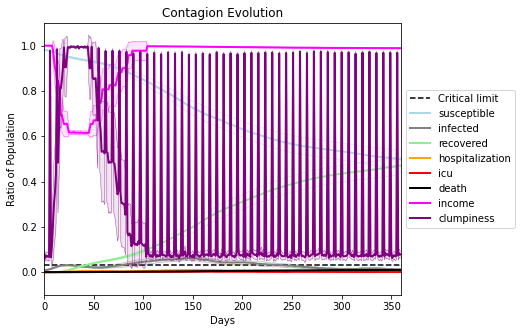

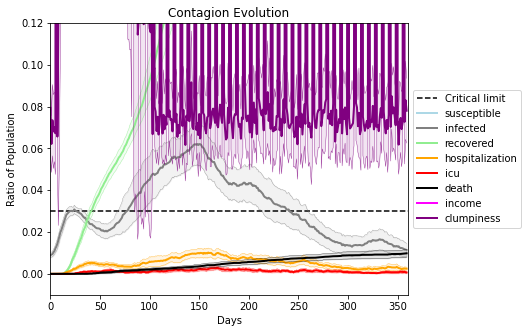

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7701, 904, 7469, 1668, 8996, 1409, 3168, 7152, 5155, 8451, 4047, 6767, 1869, 9800, 7381, 7372, 9170, 569, 8544, 1244]
Average similarity between family members is 0.9588801964749529 at temperature -0.996
Average similarity between family and home is 0.9998533571789321 at temperature -1
Average similarity between students and their classroom is 0.6462661877601883 at temperature -0.996
Average classroom occupancy is 4.23943661971831 and number classrooms is 71
Average similarity between workers is 0.9117019695165713 at temperature -0.996
Average office occupancy is 3.4 and number offices is 190
Average friend similarity for adults: 0.8568345504242875 for kids: 0.7100434754943504
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.47739531445324207
avg restaurant similarity 0.5938319641552466
avg restaurant similarity 0.64772669194081
avg restaurant similarity 0.4562046052436683
avg restaurant similarity 0.3840573225104711
avg restaurant similarity 0.564976016369802
avg restaurant similarity 0.49157132123555836
avg restaurant similarity 0.5937949823259862
avg restaurant similarity 0.6630397152877877
avg restaurant similarity 0.45472237418893113
avg restaurant similarity 0.6432557409371513
avg restaurant similarity 0.5656037752553696
avg restaurant similarity 0.6366526159218902
avg restaurant similarity 0.4408958445924026
avg restaurant similarity 0.8256970492634595
avg restaurant similarity 0.5380636518626065
avg restaurant similarity 0.5534213075195481
avg restaurant similarity 0.5382604955456639
avg restaurant similarity 0.6568301316046373
avg restaurant similarity 0.5024365463852519
avg restaurant similarity 0.7016245831900726
avg restaurant similarity 0.9995841103437113
avg restau

avg restaurant similarity 0.3793694349421069
avg restaurant similarity 0.6726458701736487
avg restaurant similarity 0.4823763356425178
avg restaurant similarity 0.5736989599262018
avg restaurant similarity 0.49968925911095147
avg restaurant similarity 0.4284514698194559
avg restaurant similarity 0.5580157367715084
avg restaurant similarity 0.4502375711167382
avg restaurant similarity 0.8529363079821989
avg restaurant similarity 0.8462712576734723
avg restaurant similarity 0.6231394069655234
avg restaurant similarity 0.6020015894607906
avg restaurant similarity 0.7906012542366821
avg restaurant similarity 0.8755688784378071
avg restaurant similarity 0.2807202732654066
avg restaurant similarity 0.2808016456115146
avg restaurant similarity 0.7916326269446148
avg restaurant similarity 0.9045749743599187
avg restaurant similarity 0.9998664710626077
avg restaurant similarity 0.8519309353749216
avg restaurant similarity 0.7495488060138307
avg restaurant similarity 0.5299281423842811
avg resta

avg restaurant similarity 0.928225417137035
avg restaurant similarity 0.8560660473456555
avg restaurant similarity 0.5318534308355503
avg restaurant similarity 0.4488446079738251
avg restaurant similarity 0.8210130384820513
avg restaurant similarity 0.6563611430502705
avg restaurant similarity 0.8290755924155047
avg restaurant similarity 0.5315200657189743
avg restaurant similarity 0.8000888926823947
avg restaurant similarity 0.5689009888314169
avg restaurant similarity 0.34892072640916655
avg restaurant similarity 0.999578458537732
avg restaurant similarity 0.7352017080227694
avg restaurant similarity 0.8007196917455737
avg restaurant similarity 0.4471899025303997
avg restaurant similarity 0.8635744058250833
avg restaurant similarity 0.43911560278000994
avg restaurant similarity 0.5164026568421495
avg restaurant similarity 0.7210303482252789
avg restaurant similarity 0.3932291912424852
avg restaurant similarity 0.5507148171022985
avg restaurant similarity 0.23171299312336455
avg resta

avg restaurant similarity 0.7068088854108565
avg restaurant similarity 0.5787990532668539
avg restaurant similarity 0.5782769208512368
avg restaurant similarity 0.7039739781008019
avg restaurant similarity 0.8356178191755453
avg restaurant similarity 0.6113966633019
avg restaurant similarity 0.529270298257728
avg restaurant similarity 0.26037888557997463
avg restaurant similarity 0.5091941426583468
avg restaurant similarity 0.5254140788581991
avg restaurant similarity 0.7710560041833909
avg restaurant similarity 0.5267018323926066
avg restaurant similarity 0.430651132508717
avg restaurant similarity 0.6722280825671507
avg restaurant similarity 0.6875364980163333
avg restaurant similarity 0.5370241198434431
avg restaurant similarity 0.3634770119856475
avg restaurant similarity 0.6359280003418109
avg restaurant similarity 0.8311306703093913
avg restaurant similarity 0.5387059366265673
avg restaurant similarity 0.5704931957794179
avg restaurant similarity 0.46218545985392967
avg restauran

avg restaurant similarity 0.47709273794565893
avg restaurant similarity 0.5308795838602023
avg restaurant similarity 0.4681279154045161
avg restaurant similarity 0.422338709224418
avg restaurant similarity 0.5591384341157121
avg restaurant similarity 0.5015501615523418
avg restaurant similarity 0.5317563158227517
avg restaurant similarity 0.5079925508318511
avg restaurant similarity 0.5747593294650205
avg restaurant similarity 0.6129395811631538
avg restaurant similarity 0.5268461424730936
avg restaurant similarity 0.41782486279520314
Average similarity between family members is 0.9524201414644056 at temperature -0.996
Average similarity between family and home is 0.9998474561335171 at temperature -1
Average similarity between students and their classroom is 0.6422328149168568 at temperature -0.996
Average classroom occupancy is 4.450704225352113 and number classrooms is 71
Average similarity between workers is 0.9348932205805635 at temperature -0.996
Average office occupancy is 3.4021

avg restaurant similarity 0.6180700622339941
avg restaurant similarity 0.5372293059953003
avg restaurant similarity 0.7094331935685336
avg restaurant similarity 0.5831830003402603
avg restaurant similarity 0.7052819731429426
avg restaurant similarity 0.5386121523288924
avg restaurant similarity 0.7409127875655406
avg restaurant similarity 0.5461441430977676
avg restaurant similarity 0.4809724673267384
avg restaurant similarity 0.5684565945581883
avg restaurant similarity 0.6947789116811716
avg restaurant similarity 0.5773429832217702
avg restaurant similarity 0.8479976495201211
avg restaurant similarity 0.6898885164153998
avg restaurant similarity 0.39955398473416415
avg restaurant similarity 0.7094331935685336
avg restaurant similarity 0.5595619060298038
avg restaurant similarity 0.5660897527208215
avg restaurant similarity 0.688253123487025
avg restaurant similarity 0.5571601627635109
avg restaurant similarity 0.8479976495201211
avg restaurant similarity 0.6345794009738054
avg restau

avg restaurant similarity 0.7509443759595746
avg restaurant similarity 0.6221777679250861
avg restaurant similarity 0.44254308601297887
avg restaurant similarity 0.394870022251705
avg restaurant similarity 0.5323891233221126
avg restaurant similarity 0.8040852743212106
avg restaurant similarity 0.4647082546960399
avg restaurant similarity 0.9312220500915431
avg restaurant similarity 0.617104046606952
avg restaurant similarity 0.6706937240109216
avg restaurant similarity 0.6803775297106892
avg restaurant similarity 0.5448571255312684
avg restaurant similarity 0.8581018557859735
avg restaurant similarity 0.568714311440491
avg restaurant similarity 0.6765241759331314
avg restaurant similarity 0.7815388265052474
avg restaurant similarity 0.8982082899232885
avg restaurant similarity 0.7082409810611017
avg restaurant similarity 0.5636038977328405
avg restaurant similarity 0.7897953902889522
avg restaurant similarity 0.6196973651453554
avg restaurant similarity 0.21085773801975324
avg restaur

avg restaurant similarity 0.5663065109363156
avg restaurant similarity 0.8577416152109052
avg restaurant similarity 0.5173836704042178
avg restaurant similarity 0.5027826607250712
avg restaurant similarity 0.22541614107900307
avg restaurant similarity 0.6630811513878969
avg restaurant similarity 0.5010256574007559
avg restaurant similarity 0.3497618636728188
avg restaurant similarity 0.6764815517113383
avg restaurant similarity 0.6326273936931632
avg restaurant similarity 0.5855993885233792
avg restaurant similarity 0.3686254767988898
avg restaurant similarity 0.7578981113036409
avg restaurant similarity 0.6157312632720732
avg restaurant similarity 0.8129944509514078
avg restaurant similarity 0.38800687790189714
avg restaurant similarity 0.6716951870799261
avg restaurant similarity 0.6913536603069973
avg restaurant similarity 0.5770372204158633
avg restaurant similarity 0.5855993885233792
avg restaurant similarity 0.2745685747447599
avg restaurant similarity 0.6190265386269407
avg rest

avg restaurant similarity 0.5541251211507298
avg restaurant similarity 0.760612074310103
avg restaurant similarity 0.5271342918108395
avg restaurant similarity 0.32741040987411096
avg restaurant similarity 0.9998572911051598
avg restaurant similarity 0.99967243177237
avg restaurant similarity 0.4510312516028353
avg restaurant similarity 0.32592508126086356
avg restaurant similarity 0.49942634324100954
avg restaurant similarity 0.9997179331032299
avg restaurant similarity 0.3216338660582939
avg restaurant similarity 0.45858914398946193
avg restaurant similarity 0.41460935545017835
avg restaurant similarity 0.4017252234971172
avg restaurant similarity 0.5244792581242655
avg restaurant similarity 0.34705120412525786
avg restaurant similarity 0.45755561774322634
avg restaurant similarity 0.9997081550955124
avg restaurant similarity 0.4320385102806654
avg restaurant similarity 0.8697449274583708
avg restaurant similarity 0.5515455298089049
avg restaurant similarity 0.9996770174012866
avg re

avg restaurant similarity 0.8802044065218724
avg restaurant similarity 0.4850197561339741
avg restaurant similarity 0.8403938903008891
avg restaurant similarity 0.9998133426813867
avg restaurant similarity 0.6695997672061813
avg restaurant similarity 0.9998784392276552
avg restaurant similarity 0.6424044759984011
avg restaurant similarity 0.6204604949921837
avg restaurant similarity 0.8321061159391318
avg restaurant similarity 0.321367722853549
avg restaurant similarity 0.5621142577382836
avg restaurant similarity 0.6256625265432344
avg restaurant similarity 0.3177289140813466
avg restaurant similarity 0.9998784392276552
avg restaurant similarity 0.64550031464009
avg restaurant similarity 0.3208306171485521
avg restaurant similarity 0.9998341809202095
avg restaurant similarity 0.5951980367423884
avg restaurant similarity 0.9998320555326559
avg restaurant similarity 0.9998243336007853
avg restaurant similarity 0.536235309360176
avg restaurant similarity 0.5210373514575983
avg restaurant

avg restaurant similarity 0.5514425081532885
avg restaurant similarity 0.7181373865135564
avg restaurant similarity 0.6336061350353028
avg restaurant similarity 0.5899580916979416
avg restaurant similarity 0.5494644572258353
avg restaurant similarity 0.49126283585917585
avg restaurant similarity 0.44077990123051813
avg restaurant similarity 0.7404472317744271
avg restaurant similarity 0.4651839335438433
avg restaurant similarity 0.7352370682431808
avg restaurant similarity 0.3641467106513958
avg restaurant similarity 0.4926013585841651
avg restaurant similarity 0.37230607657831394
avg restaurant similarity 0.46536822904055064
avg restaurant similarity 0.5571183894044074
avg restaurant similarity 0.2519088066861778
avg restaurant similarity 0.32352509977396277
avg restaurant similarity 0.4113859676243727
avg restaurant similarity 0.5494644572258353
avg restaurant similarity 0.7352747183896312
avg restaurant similarity 0.46361336808956516
avg restaurant similarity 0.5860191857686297
avg 

avg restaurant similarity 0.578087428548857
avg restaurant similarity 0.7616322651449683
avg restaurant similarity 0.7609087885489529
avg restaurant similarity 0.4596649873919906
avg restaurant similarity 0.9023792565109272
avg restaurant similarity 0.5438671783204355
avg restaurant similarity 0.5134844580471204
avg restaurant similarity 0.2833572876716933
avg restaurant similarity 0.7405367530949624
avg restaurant similarity 0.3301256029173681
avg restaurant similarity 0.5573826786907573
avg restaurant similarity 0.7606819633419435
avg restaurant similarity 0.6500046888686082
avg restaurant similarity 0.8402007857112572
avg restaurant similarity 0.5788188135537774
avg restaurant similarity 0.5395466482656861
avg restaurant similarity 0.762160193215866
avg restaurant similarity 0.7254287835512341
avg restaurant similarity 0.5488058998610663
avg restaurant similarity 0.6850566524625571
avg restaurant similarity 0.7378941904833778
avg restaurant similarity 0.27345579493803274
avg restaur

avg restaurant similarity 0.5051119285916293
avg restaurant similarity 0.58334176303143
avg restaurant similarity 0.5980289770701989
avg restaurant similarity 0.4771991485307615
avg restaurant similarity 0.4799030021016356
avg restaurant similarity 0.8518215319112685
avg restaurant similarity 0.7055582368219517
avg restaurant similarity 0.8038507150672305
avg restaurant similarity 0.45875645995684305
avg restaurant similarity 0.5082655126936506
avg restaurant similarity 0.7095932742823392
avg restaurant similarity 0.5513827793668029
avg restaurant similarity 0.8528909982626967
avg restaurant similarity 0.5821575118468326
avg restaurant similarity 0.6632785659671003
avg restaurant similarity 0.43812532900104656
avg restaurant similarity 0.6119062963037769
avg restaurant similarity 0.8528909982626967
avg restaurant similarity 0.7194248074299957
avg restaurant similarity 0.6630273318837921
avg restaurant similarity 0.5630698391215028
avg restaurant similarity 0.866764413891415
avg restaur

avg restaurant similarity 0.8267869652882367
avg restaurant similarity 0.519625821688929
avg restaurant similarity 0.4643938028015722
avg restaurant similarity 0.45794767608227066
avg restaurant similarity 0.6223067880388962
avg restaurant similarity 0.5302096472495859
avg restaurant similarity 0.3799512148654003
avg restaurant similarity 0.5885364063596592
avg restaurant similarity 0.5675575645997311
avg restaurant similarity 0.6549250053960756
avg restaurant similarity 0.5132668664092486
avg restaurant similarity 0.7087106956395093
avg restaurant similarity 0.5731600942387707
avg restaurant similarity 0.9999079784754
avg restaurant similarity 0.9134499593788425
avg restaurant similarity 0.6604811910153858
avg restaurant similarity 0.47667735935917777
avg restaurant similarity 0.46580210744204165
avg restaurant similarity 0.4000988356134041
avg restaurant similarity 0.4656139430748236
avg restaurant similarity 0.5752320854107433
avg restaurant similarity 0.3772419811336216
avg restaur

avg restaurant similarity 0.7036689900821357
avg restaurant similarity 0.560045933410909
avg restaurant similarity 0.29131380852531547
avg restaurant similarity 0.4378261606982599
avg restaurant similarity 0.5106075460273696
avg restaurant similarity 0.8127863566529565
avg restaurant similarity 0.9994862087397574
avg restaurant similarity 0.9998098502060166
avg restaurant similarity 0.4459140674475156
avg restaurant similarity 0.667110328965126
avg restaurant similarity 0.5629610021844962
avg restaurant similarity 0.4599257800490521
avg restaurant similarity 0.6177300729013183
avg restaurant similarity 0.6476585215377616
avg restaurant similarity 0.5038055545065485
avg restaurant similarity 0.9994862087397574
avg restaurant similarity 0.2243308641249109
avg restaurant similarity 0.9996311085122964
avg restaurant similarity 0.5952685031730983
avg restaurant similarity 0.5427117505090857
avg restaurant similarity 0.6723161411309682
avg restaurant similarity 0.49518948990869327
avg restau

Average similarity between family members is 0.9569908915399877 at temperature -0.996
Average similarity between family and home is 0.9998546663947677 at temperature -1
Average similarity between students and their classroom is 0.6353605953086728 at temperature -0.996
Average classroom occupancy is 4.358208955223881 and number classrooms is 67
Average similarity between workers is 0.925575103550199 at temperature -0.996
Average office occupancy is 3.3697916666666665 and number offices is 192
Average friend similarity for adults: 0.8556008769632615 for kids: 0.7067123374437692
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (

avg restaurant similarity 0.787960071428137
avg restaurant similarity 0.26794790228592147
avg restaurant similarity 0.47254130949416023
avg restaurant similarity 0.4765140812879439
avg restaurant similarity 0.3559081968973491
avg restaurant similarity 0.6797420622429451
avg restaurant similarity 0.6865249186755832
avg restaurant similarity 0.4833732470162709
avg restaurant similarity 0.6805374019852759
avg restaurant similarity 0.33094525985972423
avg restaurant similarity 0.5723043785459161
avg restaurant similarity 0.8336959263587126
avg restaurant similarity 0.9997110699602123
avg restaurant similarity 0.5553131723492706
avg restaurant similarity 0.5732296766378602
avg restaurant similarity 0.8268255112459935
avg restaurant similarity 0.734106320855537
avg restaurant similarity 0.5373978563488568
avg restaurant similarity 0.7615120228803614
avg restaurant similarity 0.9333314610678071
avg restaurant similarity 0.464077969927558
avg restaurant similarity 0.41290487853744207
avg resta

avg restaurant similarity 0.6291804515412055
avg restaurant similarity 0.5626944409915264
avg restaurant similarity 0.515933249100488
avg restaurant similarity 0.39041298981379735
avg restaurant similarity 0.5430042859285846
avg restaurant similarity 0.5084934731470586
avg restaurant similarity 0.9612024212380825
avg restaurant similarity 0.8441712491845883
avg restaurant similarity 0.6817533444061505
avg restaurant similarity 0.6832408006104121
avg restaurant similarity 0.6041430158466693
avg restaurant similarity 0.2627083628313902
avg restaurant similarity 0.5470346353978478
avg restaurant similarity 0.5337717548330164
avg restaurant similarity 0.6100145731124209
avg restaurant similarity 0.5477277003514878
avg restaurant similarity 0.6041430158466693
avg restaurant similarity 0.6650641348332369
avg restaurant similarity 0.5595506544108678
avg restaurant similarity 0.6337035554083652
avg restaurant similarity 0.54164732944749
avg restaurant similarity 0.9997686487494932
avg restaura

avg restaurant similarity 0.7457581357654466
avg restaurant similarity 0.48510239226256024
avg restaurant similarity 0.5318711838199982
avg restaurant similarity 0.6254467476959028
avg restaurant similarity 0.5399157156561125
avg restaurant similarity 0.5122205752926385
avg restaurant similarity 0.49994864573645026
avg restaurant similarity 0.2099738893297232
avg restaurant similarity 0.8618628164394118
avg restaurant similarity 0.7571886297502055
avg restaurant similarity 0.5303394221160229
avg restaurant similarity 0.567447015895086
avg restaurant similarity 0.8363688618958462
avg restaurant similarity 0.8698279084309516
avg restaurant similarity 0.3654252311387953
avg restaurant similarity 0.5286212231625947
avg restaurant similarity 0.746585691724064
avg restaurant similarity 0.9241661187985384
avg restaurant similarity 0.8266891181264936
avg restaurant similarity 0.4979519912621711
avg restaurant similarity 0.49581311170975473
avg restaurant similarity 0.8777158260551325
avg resta

avg restaurant similarity 0.785041004437119
avg restaurant similarity 0.4033560672006941
avg restaurant similarity 0.6497227604172185
avg restaurant similarity 0.41642719989326055
avg restaurant similarity 0.554953521606005
avg restaurant similarity 0.5370511728396477
avg restaurant similarity 0.31961350849166903
avg restaurant similarity 0.5429544601452392
avg restaurant similarity 0.5356208174970484
avg restaurant similarity 0.6610972688626784
avg restaurant similarity 0.9996488858003801
avg restaurant similarity 0.7761402367545173
avg restaurant similarity 0.7266173007198428
avg restaurant similarity 0.9993585988834257
avg restaurant similarity 0.8249881048366217
avg restaurant similarity 0.2784341077621608
avg restaurant similarity 0.6599031602405202
avg restaurant similarity 0.5364570441080616
avg restaurant similarity 0.5356208174970484
avg restaurant similarity 0.5865055086348336
avg restaurant similarity 0.36951347583381033
avg restaurant similarity 0.7162261229267951
avg resta

avg restaurant similarity 0.7336495361977305
avg restaurant similarity 0.42991514124699337
avg restaurant similarity 0.5437044226001488
avg restaurant similarity 0.649968535125023
avg restaurant similarity 0.7554350801209819
avg restaurant similarity 0.616293576788941
avg restaurant similarity 0.40041064817309135
avg restaurant similarity 0.43768762052196597
avg restaurant similarity 0.8020728845238375
avg restaurant similarity 0.5130924552532964
avg restaurant similarity 0.577610108984446
avg restaurant similarity 0.6240068079528115
avg restaurant similarity 0.6588325601508924
avg restaurant similarity 0.6152706220495849
avg restaurant similarity 0.8039852221992565
avg restaurant similarity 0.8589752247633697
avg restaurant similarity 0.590869148349959
avg restaurant similarity 0.6271945770848779
avg restaurant similarity 0.23704305177079543
avg restaurant similarity 0.5499078105431109
avg restaurant similarity 0.9099231185035326
avg restaurant similarity 0.5499078105431109
avg restau

avg restaurant similarity 0.7179399781598322
avg restaurant similarity 0.4207383305930956
avg restaurant similarity 0.4984025672252774
avg restaurant similarity 0.909862703293971
avg restaurant similarity 0.4436242081488439
avg restaurant similarity 0.8686627722822592
avg restaurant similarity 0.9998342031349754
avg restaurant similarity 0.9998044888769846
avg restaurant similarity 0.7634956799589494
avg restaurant similarity 0.2948927510853973
avg restaurant similarity 0.5020006270940922
avg restaurant similarity 0.6666459486355301
avg restaurant similarity 0.8979734678216038
avg restaurant similarity 0.707897270835382
avg restaurant similarity 0.7602040268890115
avg restaurant similarity 0.5153889702644197
avg restaurant similarity 0.17331376704554516
avg restaurant similarity 0.6770516982248282
avg restaurant similarity 0.6684777886982433
avg restaurant similarity 0.5885114548163721
avg restaurant similarity 0.5404643377068729
Average similarity between family members is 0.947443391

avg restaurant similarity 0.6697170937713809
avg restaurant similarity 0.80478916077215
avg restaurant similarity 0.579466752987803
avg restaurant similarity 0.4534809635896646
avg restaurant similarity 0.5818824277248711
avg restaurant similarity 0.8451530112011616
avg restaurant similarity 0.7994720515260052
avg restaurant similarity 0.5897921379152593
avg restaurant similarity 0.4860180082444851
avg restaurant similarity 0.7897848773741747
avg restaurant similarity 0.7432038945969673
avg restaurant similarity 0.5102436808589464
avg restaurant similarity 0.7203802641828335
avg restaurant similarity 0.5450915187683243
avg restaurant similarity 0.8650232818229462
avg restaurant similarity 0.6594719744266839
avg restaurant similarity 0.5377823906869545
avg restaurant similarity 0.8621012811350114
avg restaurant similarity 0.4000920331912422
avg restaurant similarity 0.5941734018452189
avg restaurant similarity 0.8624802074794325
avg restaurant similarity 0.5897921379152593
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

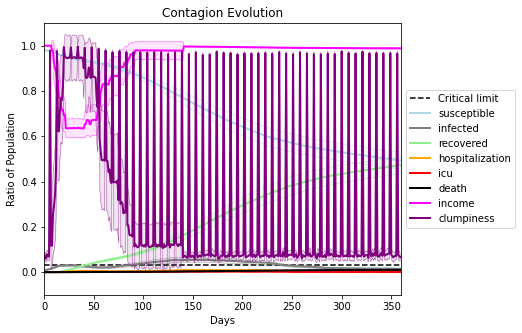

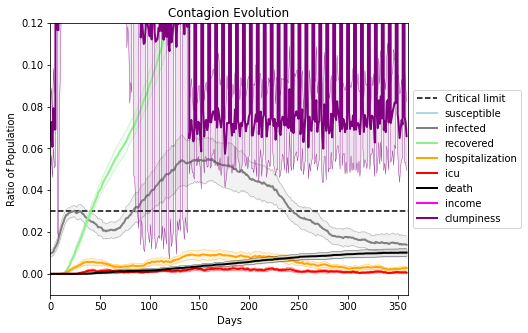

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4838, 6589, 3765, 6331, 6540, 9157, 8929, 8116, 5640, 6548, 3594, 6985, 9210, 4738, 833, 616, 4148, 5770, 4347, 5683]
Average similarity between family members is 0.9393665331233103 at temperature -0.995
Average similarity between family and home is 0.9998560621306082 at temperature -1
Average similarity between students and their classroom is 0.5989257721874882 at temperature -0.995
Average classroom occupancy is 3.6901408450704225 and number classrooms is 71
Average similarity between workers is 0.8907387215642577 at temperature -0.995
Average office occupancy is 3.5445026178010473 and number offices is 191
Average friend similarity for adults: 0.8516185147480608 for kids: 0.6768642575940902
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.4995089186814464
avg restaurant similarity 0.5106045428161475
avg restaurant similarity 0.4735274774813748
avg restaurant similarity 0.44592588344877704
avg restaurant similarity 0.721199498139718
avg restaurant similarity 0.44815322584822215
avg restaurant similarity 0.584934274967034
avg restaurant similarity 0.48669826925496545
avg restaurant similarity 0.4738876198284845
avg restaurant similarity 0.6125950600208097
avg restaurant similarity 0.6199159590084347
avg restaurant similarity 0.7120512520154934
avg restaurant similarity 0.6557960400611234
avg restaurant similarity 0.4719933717879966
avg restaurant similarity 0.9998664959270106
avg restaurant similarity 0.5118172075825881
avg restaurant similarity 0.496305993516744
avg restaurant similarity 0.3551921791068116
avg restaurant similarity 0.817051288523797
avg restaurant similarity 0.6619656486078492
avg restaurant similarity 0.44815322584822215
avg restaurant similarity 0.8569514835609005
avg restau

avg restaurant similarity 0.7536542372526838
avg restaurant similarity 0.683681896131109
avg restaurant similarity 0.7031461728505974
avg restaurant similarity 0.8264601647888683
avg restaurant similarity 0.5586357301937005
avg restaurant similarity 0.405480637416852
avg restaurant similarity 0.39852090927868045
avg restaurant similarity 0.5137644974963378
avg restaurant similarity 0.7072259252203832
avg restaurant similarity 0.537267461897218
avg restaurant similarity 0.43841791504160726
avg restaurant similarity 0.5849847486672115
avg restaurant similarity 0.6421719996220955
avg restaurant similarity 0.852746895480549
avg restaurant similarity 0.758648270917028
avg restaurant similarity 0.6702552739620444
avg restaurant similarity 0.999779720739152
avg restaurant similarity 0.21236560897874746
avg restaurant similarity 0.468426856722481
avg restaurant similarity 0.5838970110262636
avg restaurant similarity 0.6013667123026094
avg restaurant similarity 0.39852090927868045
avg restauran

avg restaurant similarity 0.5209290249538768
avg restaurant similarity 0.6679428413290965
avg restaurant similarity 0.4866254168838067
avg restaurant similarity 0.8752115438544916
avg restaurant similarity 0.4061274087904837
avg restaurant similarity 0.7514019209989672
avg restaurant similarity 0.6676960247637145
avg restaurant similarity 0.4433336643239964
avg restaurant similarity 0.38688323759519627
avg restaurant similarity 0.8356642574592532
avg restaurant similarity 0.6742219704522591
avg restaurant similarity 0.8071150976179483
avg restaurant similarity 0.8290858669805448
avg restaurant similarity 0.6105619463620627
avg restaurant similarity 0.5965322760183562
avg restaurant similarity 0.6138031470240213
avg restaurant similarity 0.8719242931815758
avg restaurant similarity 0.27231784714602775
avg restaurant similarity 0.6226863619968174
avg restaurant similarity 0.5342693490111916
avg restaurant similarity 0.6709908337312591
avg restaurant similarity 0.874269968438284
avg resta

avg restaurant similarity 0.747862643329761
avg restaurant similarity 0.4671426855282851
avg restaurant similarity 0.8440417807707271
avg restaurant similarity 0.5326092132773356
avg restaurant similarity 0.6240777307144044
avg restaurant similarity 0.6228115667422045
avg restaurant similarity 0.40240236895109993
avg restaurant similarity 0.516981999384154
avg restaurant similarity 0.4490821274206569
avg restaurant similarity 0.7043414522973679
avg restaurant similarity 0.6041967409225002
avg restaurant similarity 0.6245636415071594
avg restaurant similarity 0.7288470807635582
avg restaurant similarity 0.3682691293671189
avg restaurant similarity 0.6488654164625121
avg restaurant similarity 0.593706723201
avg restaurant similarity 0.6073700409407212
avg restaurant similarity 0.40894062935789244
avg restaurant similarity 0.3929124604305061
avg restaurant similarity 0.5780552837619579
avg restaurant similarity 0.4706113712876462
avg restaurant similarity 0.5902367945894298
avg restaurant

avg restaurant similarity 0.5638389658796589
avg restaurant similarity 0.2938982142831962
avg restaurant similarity 0.594320575085654
avg restaurant similarity 0.5968667961419523
avg restaurant similarity 0.5280714504643196
avg restaurant similarity 0.29754782127991397
avg restaurant similarity 0.5971547791674037
avg restaurant similarity 0.572325935956027
avg restaurant similarity 0.43513947010764853
avg restaurant similarity 0.6940652190092674
avg restaurant similarity 0.8206039523333695
avg restaurant similarity 0.6220545301587159
avg restaurant similarity 0.4399293980491894
avg restaurant similarity 0.47373240380104087
avg restaurant similarity 0.8206039523333695
avg restaurant similarity 0.42631264793851725
avg restaurant similarity 0.549181179209626
avg restaurant similarity 0.5382403985151007
avg restaurant similarity 0.6421608013218425
avg restaurant similarity 0.5164339162312344
avg restaurant similarity 0.5248062624094831
avg restaurant similarity 0.8206176778738186
avg resta

avg restaurant similarity 0.6150052232972258
avg restaurant similarity 0.587315083092119
avg restaurant similarity 0.4517504460932197
avg restaurant similarity 0.508273296448789
avg restaurant similarity 0.6670520076548804
avg restaurant similarity 0.5051104896898002
avg restaurant similarity 0.4310359507301837
avg restaurant similarity 0.43220964969704034
avg restaurant similarity 0.6184534700650565
avg restaurant similarity 0.3315946536422854
avg restaurant similarity 0.5051871208091674
avg restaurant similarity 0.3925309669721229
avg restaurant similarity 0.4247994883516648
avg restaurant similarity 0.6245608072864703
avg restaurant similarity 0.38421304087157243
avg restaurant similarity 0.6410408241776755
avg restaurant similarity 0.2555602396057154
avg restaurant similarity 0.8650918429092231
avg restaurant similarity 0.8969292361635828
avg restaurant similarity 0.6311629788996376
avg restaurant similarity 0.8650397051041185
avg restaurant similarity 0.4900854925391538
avg restau

avg restaurant similarity 0.6249991727906755
avg restaurant similarity 0.68896190520719
avg restaurant similarity 0.834591334251934
avg restaurant similarity 0.6746277464642347
avg restaurant similarity 0.6806926220726693
avg restaurant similarity 0.4116063238237464
avg restaurant similarity 0.8432994036926278
avg restaurant similarity 0.6707315168499927
avg restaurant similarity 0.5550257464596362
avg restaurant similarity 0.8260954360223447
avg restaurant similarity 0.6707315168499927
avg restaurant similarity 0.3986789881954339
avg restaurant similarity 0.5427197716839657
avg restaurant similarity 0.6760842931413258
avg restaurant similarity 0.8352697290722755
avg restaurant similarity 0.27582577115389273
avg restaurant similarity 0.5321480740482776
avg restaurant similarity 0.545684311640023
avg restaurant similarity 0.4781296573779425
avg restaurant similarity 0.5316656068627641
avg restaurant similarity 0.4944576611769219
avg restaurant similarity 0.6741169204247723
avg restauran

avg restaurant similarity 0.7845554141842307
avg restaurant similarity 0.2782719876493299
avg restaurant similarity 0.5166619531459514
avg restaurant similarity 0.8415336087625587
avg restaurant similarity 0.42498391733806584
avg restaurant similarity 0.5687545672608063
avg restaurant similarity 0.4414317741181991
avg restaurant similarity 0.4386976043644427
avg restaurant similarity 0.43566310306869704
avg restaurant similarity 0.43621340127638436
avg restaurant similarity 0.6200369220836692
avg restaurant similarity 0.6445131639400994
avg restaurant similarity 0.445129746451192
avg restaurant similarity 0.49095542917506896
avg restaurant similarity 0.5384925890795187
avg restaurant similarity 0.5736670111135959
avg restaurant similarity 0.25649360038988006
avg restaurant similarity 0.5323740558580818
avg restaurant similarity 0.5536235781701625
avg restaurant similarity 0.320665141416145
avg restaurant similarity 0.43798801357958084
avg restaurant similarity 0.6427234653139341
avg re

avg restaurant similarity 0.43206522233477496
avg restaurant similarity 0.5159880703698683
avg restaurant similarity 0.717191832256499
avg restaurant similarity 0.6120688050988712
avg restaurant similarity 0.36848024259692935
avg restaurant similarity 0.6348790675976477
avg restaurant similarity 0.7081312692598293
avg restaurant similarity 0.9998391975339971
avg restaurant similarity 0.1375810281820816
avg restaurant similarity 0.7408971896068396
avg restaurant similarity 0.9997745375236982
avg restaurant similarity 0.6269648297145555
avg restaurant similarity 0.35807736010084423
avg restaurant similarity 0.40432143789132785
avg restaurant similarity 0.2066203329992904
avg restaurant similarity 0.37386422898714844
avg restaurant similarity 0.35265039450663416
avg restaurant similarity 0.5889567227731093
avg restaurant similarity 0.6800066346945884
avg restaurant similarity 0.572069996704546
avg restaurant similarity 0.29050846945718267
avg restaurant similarity 0.6922139010173459
avg r

avg restaurant similarity 0.6477298795738238
avg restaurant similarity 0.5107438519069719
avg restaurant similarity 0.7337330550916814
avg restaurant similarity 0.3208503196495225
avg restaurant similarity 0.42795449184121326
avg restaurant similarity 0.5407830837132116
avg restaurant similarity 0.4422418186191759
avg restaurant similarity 0.43351335274847885
avg restaurant similarity 0.5960140657287839
avg restaurant similarity 0.9333871786440386
avg restaurant similarity 0.5896750478220119
avg restaurant similarity 0.6419386911208831
avg restaurant similarity 0.5963731181107683
avg restaurant similarity 0.5131847818533264
avg restaurant similarity 0.6626104563737685
avg restaurant similarity 0.7181174343490657
avg restaurant similarity 0.5426731374054402
avg restaurant similarity 0.5436817730894039
avg restaurant similarity 0.801125357220089
avg restaurant similarity 0.6027915077088363
avg restaurant similarity 0.8627675609190182
avg restaurant similarity 0.6362308445325685
avg resta

avg restaurant similarity 0.5324725416675029
avg restaurant similarity 0.5019827868643633
avg restaurant similarity 0.9997775471804476
avg restaurant similarity 0.4660312444740268
avg restaurant similarity 0.6058348661584696
avg restaurant similarity 0.4239638723695568
avg restaurant similarity 0.8632904098080156
avg restaurant similarity 0.2933076516644176
avg restaurant similarity 0.5755306024673029
avg restaurant similarity 0.6722508973977732
avg restaurant similarity 0.9998475935827983
avg restaurant similarity 0.8935834015974088
avg restaurant similarity 0.4887639201646349
avg restaurant similarity 0.999756915428772
avg restaurant similarity 0.42035660293927246
avg restaurant similarity 0.737514631747894
avg restaurant similarity 0.8935834015974088
avg restaurant similarity 0.8119240832000869
avg restaurant similarity 0.5466160639217731
avg restaurant similarity 0.8939762170666905
avg restaurant similarity 0.8940249331831785
avg restaurant similarity 0.9997775471804476
avg restaur

avg restaurant similarity 0.7330896873397559
avg restaurant similarity 0.5106203569311346
avg restaurant similarity 0.6924738316736069
avg restaurant similarity 0.40664620272505725
avg restaurant similarity 0.42883338028714096
avg restaurant similarity 0.581648339950813
avg restaurant similarity 0.4053005341409527
avg restaurant similarity 0.7340070354976967
avg restaurant similarity 0.5049138953519522
avg restaurant similarity 0.7330896873397559
avg restaurant similarity 0.33250319574938914
avg restaurant similarity 0.553871552709361
avg restaurant similarity 0.45872416706379626
avg restaurant similarity 0.3691709147389999
avg restaurant similarity 0.2479871127247697
avg restaurant similarity 0.547190192072414
avg restaurant similarity 0.7417611450141355
avg restaurant similarity 0.5454033147059021
avg restaurant similarity 0.7330896873397559
avg restaurant similarity 0.42513554252289576
avg restaurant similarity 0.8662037785996608
avg restaurant similarity 0.6356355120613699
avg rest

avg restaurant similarity 0.6575198588485328
avg restaurant similarity 0.7037129103549572
avg restaurant similarity 0.8758541576143641
avg restaurant similarity 0.5716173090352201
avg restaurant similarity 0.653910021230534
avg restaurant similarity 0.26319545019319496
avg restaurant similarity 0.875735120640704
avg restaurant similarity 0.9998392535045866
avg restaurant similarity 0.7223303802857598
avg restaurant similarity 0.40486989173621174
avg restaurant similarity 0.41975870188335607
avg restaurant similarity 0.7847741942761619
avg restaurant similarity 0.5385222866263972
avg restaurant similarity 0.880947846163217
avg restaurant similarity 0.5759937818934562
avg restaurant similarity 0.6950755971363108
avg restaurant similarity 0.6950755971363108
avg restaurant similarity 0.9999252886570765
avg restaurant similarity 0.5933726353647056
avg restaurant similarity 0.5496915119017334
avg restaurant similarity 0.6097176329781084
avg restaurant similarity 0.6523966150572096
avg restau

avg restaurant similarity 0.3844894872339316
avg restaurant similarity 0.277337303200436
avg restaurant similarity 0.38413149141772723
avg restaurant similarity -0.009012824305571737
avg restaurant similarity 0.5104396606666822
avg restaurant similarity 0.8836562340983302
avg restaurant similarity 0.46178048420795215
avg restaurant similarity 0.2939854173326658
avg restaurant similarity 0.5894486717880164
avg restaurant similarity 0.5321879859063423
avg restaurant similarity 0.4943308727626102
avg restaurant similarity 0.7139887779634031
avg restaurant similarity 0.30903533962433977
avg restaurant similarity 0.44621501337040115
avg restaurant similarity 0.6848387427945267
avg restaurant similarity 0.41829659611032693
avg restaurant similarity 0.48153197723485064
avg restaurant similarity 0.5895552311134091
avg restaurant similarity 0.8338508034357146
avg restaurant similarity 0.7634115388572178
avg restaurant similarity 0.9442684773257466
avg restaurant similarity 0.49476879613477076
a

avg restaurant similarity 0.5742907780671841
avg restaurant similarity 0.8704337934809502
avg restaurant similarity 0.6499515750787402
avg restaurant similarity 0.3374304411142651
avg restaurant similarity 0.9997665940903264
avg restaurant similarity 0.34990125373668624
avg restaurant similarity 0.25448843767039636
avg restaurant similarity 0.22557304169535053
avg restaurant similarity 0.5874218506820397
avg restaurant similarity 0.4617088991776746
avg restaurant similarity 0.45459803497567963
avg restaurant similarity 0.46918797988710004
avg restaurant similarity 0.6137947656070489
avg restaurant similarity 0.6635401280294585
avg restaurant similarity 0.4072189489527165
avg restaurant similarity 0.4505932261559955
avg restaurant similarity 0.3302619939938562
avg restaurant similarity 0.6705956335354089
avg restaurant similarity 0.1876838329464709
avg restaurant similarity 0.7051044242657778
avg restaurant similarity 0.2529779057247258
avg restaurant similarity 0.5559403615592983
avg r

avg restaurant similarity 0.7752377352031776
Average similarity between family members is 0.945436914984949 at temperature -0.995
Average similarity between family and home is 0.9998424937613336 at temperature -1
Average similarity between students and their classroom is 0.5755882462751643 at temperature -0.995
Average classroom occupancy is 4.352941176470588 and number classrooms is 68
Average similarity between workers is 0.8973540556770082 at temperature -0.995
Average office occupancy is 3.4574468085106385 and number offices is 188
Average friend similarity for adults: 0.8471149077859148 for kids: 0.6954853445598232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5467326388542495
avg restaurant similarity 0.4497060704424839
avg restaurant similarity 0.5620636671451988
avg restaurant similarity 0.5310709490309965
avg restaurant similarity 0.6585983047755156
avg restaurant similarity 0.4497060704424839
avg restaurant similarity 0.8496645518426642
avg restaurant similarity 0.44197141445377885
avg restaurant similarity 0.47235304253930155
avg restaurant similarity 0.863394207501136
avg restaurant similarity 0.8061748315418268
avg restaurant similarity 0.6458871078548273
avg restaurant similarity 0.38464347834684076
avg restaurant similarity 0.3256854054384765
avg restaurant similarity 0.7329901294547561
avg restaurant similarity 0.5848701527146303
avg restaurant similarity 0.48380586034309125
avg restaurant similarity 0.6458871078548273
avg restaurant similarity 0.9028733603875736
avg restaurant similarity 0.44816455214086937
avg restaurant similarity 0.5098923016130057
avg restaurant similarity 0.6206363750630427
avg re

avg restaurant similarity 0.5067388667095412
avg restaurant similarity 0.3145116089585653
avg restaurant similarity 0.5526191771063137
avg restaurant similarity 0.7300925230413389
avg restaurant similarity 0.507599207620367
avg restaurant similarity 0.5177179007243274
avg restaurant similarity 0.5860760472363948
avg restaurant similarity 0.46869074274434847
avg restaurant similarity 0.5889060048207874
avg restaurant similarity 0.5047533892639178
avg restaurant similarity 0.5011435071287345
avg restaurant similarity 0.6271789982605791
avg restaurant similarity 0.4297421424536098
avg restaurant similarity 0.58446037597557
avg restaurant similarity 0.458249608984311
avg restaurant similarity 0.9422857623507812
avg restaurant similarity 0.3930135385752275
avg restaurant similarity 0.4349250665594744
avg restaurant similarity 0.5488045470107071
avg restaurant similarity 0.30521348327795433
avg restaurant similarity 0.6770166501641003
avg restaurant similarity 0.43386688857022326
avg restaur

Average similarity between family and home is 0.9998435006737573 at temperature -1
Average similarity between students and their classroom is 0.5772441445009238 at temperature -0.995
Average classroom occupancy is 4.333333333333333 and number classrooms is 69
Average similarity between workers is 0.9056621964034773 at temperature -0.995
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.844948491112354 for kids: 0.6903368081551117
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allo

avg restaurant similarity 0.5180414192346773
avg restaurant similarity 0.30240320185477565
avg restaurant similarity 0.5779645867260218
avg restaurant similarity 0.5805624300881189
avg restaurant similarity 0.484311187188539
avg restaurant similarity 0.5187440177917716
avg restaurant similarity 0.18531076597332538
avg restaurant similarity 0.5202726023891351
avg restaurant similarity 0.5220815852357563
avg restaurant similarity 0.55878363198959
avg restaurant similarity 0.6100914341076088
avg restaurant similarity 0.6821454727566784
avg restaurant similarity 0.55878363198959
avg restaurant similarity 0.4302153733002575
avg restaurant similarity 0.8526818410111239
avg restaurant similarity 0.4664263112693659
avg restaurant similarity 0.9231280993832948
avg restaurant similarity 0.5666332784708732
avg restaurant similarity 0.6911921749961937
avg restaurant similarity 0.5876098114496033
avg restaurant similarity 0.5666332784708732
avg restaurant similarity 0.47923630339443807
avg restaura

avg restaurant similarity 0.6387782358932881
avg restaurant similarity 0.8121945495480343
avg restaurant similarity 0.48313398161042853
avg restaurant similarity 0.5217614825205408
avg restaurant similarity 0.2822331019077337
avg restaurant similarity 0.575985348538488
Average similarity between family members is 0.9450356870246843 at temperature -0.995
Average similarity between family and home is 0.9998623522392186 at temperature -1
Average similarity between students and their classroom is 0.5906759490375116 at temperature -0.995
Average classroom occupancy is 4.3 and number classrooms is 70
Average similarity between workers is 0.8900494381551879 at temperature -0.995
Average office occupancy is 3.304123711340206 and number offices is 194
Average friend similarity for adults: 0.8401537096091904 for kids: 0.680441210642077
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people

avg restaurant similarity 0.45097716574268754
avg restaurant similarity 0.603960584035464
avg restaurant similarity 0.6012985009239092
avg restaurant similarity 0.647441305962982
avg restaurant similarity 0.5166520775203933
avg restaurant similarity 0.6583610923998131
avg restaurant similarity 0.5008555909510142
avg restaurant similarity 0.4723138718894505
avg restaurant similarity 0.5200257591705737
avg restaurant similarity 0.5469634337090228
avg restaurant similarity 0.47344942372486587
avg restaurant similarity 0.5396059073180622
avg restaurant similarity 0.5963353188558365
avg restaurant similarity 0.606569606141845
avg restaurant similarity 0.5634782594931794
avg restaurant similarity 0.5893794733448989
avg restaurant similarity 0.4319319095553792
avg restaurant similarity 0.45931500362717226
avg restaurant similarity 0.4968187999700439
avg restaurant similarity 0.5635828096918374
avg restaurant similarity 0.3922340342848377
avg restaurant similarity 0.5498350638460658
avg restau

avg restaurant similarity 0.359869464240078
avg restaurant similarity 0.3996512349057989
avg restaurant similarity 0.44421509173731843
avg restaurant similarity 0.4054357649173915
avg restaurant similarity 0.50423512110368
avg restaurant similarity 0.40254509548602746
avg restaurant similarity 0.51677357001605
avg restaurant similarity 0.576782595969171
avg restaurant similarity 0.5915414388161194
avg restaurant similarity 0.5851251257467394
avg restaurant similarity 0.5828115857561014
avg restaurant similarity 0.6904964075364523
avg restaurant similarity 0.5990679455364757
avg restaurant similarity 0.436411000353398
avg restaurant similarity 0.45238532258497577
avg restaurant similarity 0.864756531815391
avg restaurant similarity 0.5087285227245903
avg restaurant similarity 0.4444148885976883
avg restaurant similarity 0.5720447494343562
avg restaurant similarity 0.5926620893436734
avg restaurant similarity 0.5191420521837296
avg restaurant similarity 0.4875733997161108
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

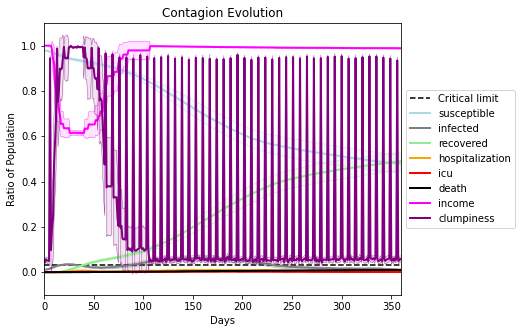

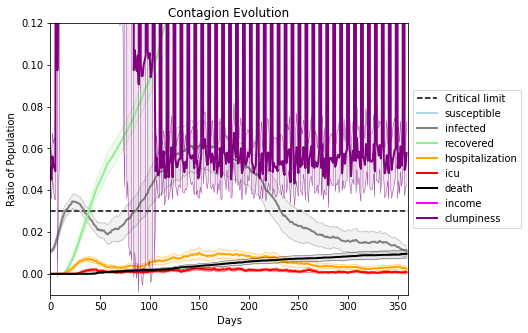

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4536, 4772, 6143, 6029, 6781, 9082, 3965, 4183, 5444, 7206, 4203, 6150, 1316, 9809, 8600, 9888, 3592, 4761, 3953, 7535]
Average similarity between family members is 0.9396109608803725 at temperature -0.994
Average similarity between family and home is 0.9998573586405307 at temperature -1
Average similarity between students and their classroom is 0.5541960760666051 at temperature -0.994
Average classroom occupancy is 4.1940298507462686 and number classrooms is 67
Average similarity between workers is 0.8869849436070801 at temperature -0.994
Average office occupancy is 3.4427083333333335 and number offices is 192
Average friend similarity for adults: 0.8513267872132507 for kids: 0.6682887512602868
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.9998600308339364
avg restaurant similarity 0.6145761150951939
avg restaurant similarity 0.6430769936753968
avg restaurant similarity 0.40382469190558135
avg restaurant similarity 0.5210277857235608
avg restaurant similarity 0.20696426784410177
avg restaurant similarity 0.7728242617392573
avg restaurant similarity 0.9998624451274823
avg restaurant similarity 0.5243798967680209
avg restaurant similarity 0.9995812812806366
avg restaurant similarity 0.6430769936753968
avg restaurant similarity 0.6134040162877922
avg restaurant similarity 0.5137501933927976
avg restaurant similarity 0.7391777294947469
avg restaurant similarity 0.5612330165993102
avg restaurant similarity 0.5612330165993102
avg restaurant similarity 0.8046461334727244
avg restaurant similarity 0.5658836614164966
avg restaurant similarity 0.46924981939680643
avg restaurant similarity 0.683423244532088
avg restaurant similarity 0.616317435539331
avg restaurant similarity 0.453615513105771
avg restau

avg restaurant similarity 0.5952488849563747
avg restaurant similarity 0.526754565944803
avg restaurant similarity 0.44790695008579307
avg restaurant similarity 0.2817862784868464
avg restaurant similarity 0.4606081573889469
avg restaurant similarity 0.6034668632857558
avg restaurant similarity 0.5924498402807166
avg restaurant similarity 0.5374768650491407
avg restaurant similarity 0.8116518109119861
avg restaurant similarity 0.572112814133886
avg restaurant similarity 0.6085679650301782
avg restaurant similarity 0.5246794235519621
avg restaurant similarity 0.4489487553635985
avg restaurant similarity 0.6257457086029663
avg restaurant similarity 0.6248870379397472
avg restaurant similarity 0.5813536597973982
avg restaurant similarity 0.343701911472094
avg restaurant similarity 0.5250618093187894
avg restaurant similarity 0.8242279498227667
avg restaurant similarity 0.5277851167295156
avg restaurant similarity 0.5906238244242814
avg restaurant similarity 0.811728691575401
avg restauran

avg restaurant similarity 0.9420700139465902
avg restaurant similarity 0.670916248322822
avg restaurant similarity 0.8275964589880175
avg restaurant similarity 0.8282888418623853
avg restaurant similarity 0.8765918690755621
avg restaurant similarity 0.4249615839600362
avg restaurant similarity 0.3238197187760482
avg restaurant similarity 0.9144129477355204
avg restaurant similarity 0.4832036146212906
avg restaurant similarity 0.8279429363602457
avg restaurant similarity 0.643131166310764
avg restaurant similarity 0.35313278986700847
avg restaurant similarity 0.3946235470171562
avg restaurant similarity 0.44097659990624277
avg restaurant similarity 0.4503440595974054
avg restaurant similarity 0.49446673247878997
avg restaurant similarity 0.9139093597928766
avg restaurant similarity 0.7410623657127005
avg restaurant similarity 0.4777759445250125
avg restaurant similarity 0.40767273986777486
avg restaurant similarity 0.2303668218619369
avg restaurant similarity 0.5286326041104794
avg rest

avg restaurant similarity 0.582602242808721
avg restaurant similarity 0.9369235649499619
avg restaurant similarity 0.5643634339808956
avg restaurant similarity 0.5899902514642845
avg restaurant similarity 0.6943115147356045
avg restaurant similarity 0.26547433424112726
avg restaurant similarity 0.34059751922777237
avg restaurant similarity 0.4470307633595958
avg restaurant similarity 0.8036199652479787
avg restaurant similarity 0.9315551621253336
avg restaurant similarity 0.6648921971000281
avg restaurant similarity 0.5936400926250431
avg restaurant similarity 0.6052931447050233
avg restaurant similarity 0.40415934951878474
avg restaurant similarity 0.4648878588579517
avg restaurant similarity 0.4903516310722109
avg restaurant similarity 0.30950230681925095
avg restaurant similarity 0.5085800889827362
avg restaurant similarity 0.4518663646685391
avg restaurant similarity 0.42026895738997155
avg restaurant similarity 0.5023735989681208
avg restaurant similarity 0.3587406773086822
avg re

avg restaurant similarity 0.5721046719014647
avg restaurant similarity 0.7296733021189328
avg restaurant similarity 0.7987592874689884
avg restaurant similarity 0.4725150465631185
avg restaurant similarity 0.4365436564317094
avg restaurant similarity 0.5855049888149148
avg restaurant similarity 0.4921706758475404
avg restaurant similarity 0.8144090151405317
avg restaurant similarity 0.5491398242201548
avg restaurant similarity 0.5040613616468625
avg restaurant similarity 0.4921706758475404
avg restaurant similarity 0.4985983288304512
avg restaurant similarity 0.4134509145340197
avg restaurant similarity 0.5527070137866521
avg restaurant similarity 0.8177320902039695
avg restaurant similarity 0.42904769792527275
avg restaurant similarity 0.6562153778017769
avg restaurant similarity 0.8352215539830434
avg restaurant similarity 0.6145763243725749
avg restaurant similarity 0.6814754767370322
avg restaurant similarity 0.9998451154723098
avg restaurant similarity 0.5585891902460589
avg resta

avg restaurant similarity 0.506351713189454
avg restaurant similarity 0.5723983698652327
avg restaurant similarity 0.6757878670634934
avg restaurant similarity 0.6203936812521342
avg restaurant similarity 0.9026300621770182
avg restaurant similarity 0.6253227871680719
avg restaurant similarity 0.4586681969819519
avg restaurant similarity 0.6275644928564189
avg restaurant similarity 0.5757183710625585
avg restaurant similarity 0.5091596420400432
avg restaurant similarity 0.5738632571020501
avg restaurant similarity 0.6217909369058083
avg restaurant similarity 0.5288180505655683
avg restaurant similarity 0.641868541561482
avg restaurant similarity 0.5300641526048447
avg restaurant similarity 0.42149619575359976
avg restaurant similarity 0.9996622186215238
avg restaurant similarity 0.5512915641049226
avg restaurant similarity 0.5870686292746913
avg restaurant similarity 0.6485037238258096
avg restaurant similarity 0.726581863163652
avg restaurant similarity 0.5205551464417062
avg restaura

avg restaurant similarity 0.4433740102126087
avg restaurant similarity 0.8795584010901406
avg restaurant similarity 0.6624311879716531
avg restaurant similarity 0.3235209278562315
avg restaurant similarity 0.33547916229255437
avg restaurant similarity 0.468872939662975
avg restaurant similarity 0.8273080397528592
avg restaurant similarity 0.28314378147052605
avg restaurant similarity 0.8646840222696925
avg restaurant similarity 0.6661358425577121
avg restaurant similarity 0.8417085738809381
avg restaurant similarity 0.8378506105689195
avg restaurant similarity 0.7029727464452546
avg restaurant similarity 0.4854515641526632
Average similarity between family members is 0.93291164336357 at temperature -0.994
Average similarity between family and home is 0.9998435031227139 at temperature -1
Average similarity between students and their classroom is 0.5891432246988146 at temperature -0.994
Average classroom occupancy is 3.91044776119403 and number classrooms is 67
Average similarity between

avg restaurant similarity 0.8334682283510673
avg restaurant similarity 0.7285870484553053
avg restaurant similarity 0.608597866253882
avg restaurant similarity 0.3667880966184043
avg restaurant similarity 0.36787013022579584
avg restaurant similarity 0.645222176578492
avg restaurant similarity 0.9998919438129799
avg restaurant similarity 0.3188801515656652
avg restaurant similarity 0.6616570098616844
avg restaurant similarity 0.5976026366908804
avg restaurant similarity 0.5964303289020452
avg restaurant similarity 0.9494480078833076
avg restaurant similarity 0.9998402154540216
avg restaurant similarity 0.5209275538662037
avg restaurant similarity 0.628526837872873
avg restaurant similarity 0.5736749535836939
avg restaurant similarity 0.27113144445910664
avg restaurant similarity 0.39108435108646517
avg restaurant similarity 0.45180835390222884
avg restaurant similarity 0.3786887312490549
avg restaurant similarity 0.7979947477390199
avg restaurant similarity 0.6430828357513244
avg resta

avg restaurant similarity 0.5819350186554304
avg restaurant similarity 0.9998324268572358
avg restaurant similarity 0.440502778766667
avg restaurant similarity 0.8213089507640099
avg restaurant similarity 0.450621887310262
avg restaurant similarity 0.47068844874237414
avg restaurant similarity 0.4780732483707617
avg restaurant similarity 0.45514119689893423
avg restaurant similarity 0.4762956837691064
avg restaurant similarity 0.5973773993285092
avg restaurant similarity 0.4110291481070657
avg restaurant similarity 0.6887336860122897
avg restaurant similarity 0.7435306699774801
avg restaurant similarity 0.49733296023227114
avg restaurant similarity 0.6958226032331418
avg restaurant similarity 0.6327846244620661
avg restaurant similarity 0.5874376914611446
avg restaurant similarity 0.5389779073835643
avg restaurant similarity 0.33844445804052337
avg restaurant similarity 0.7920631370302218
avg restaurant similarity 0.5896910052014361
avg restaurant similarity 0.6958226032331418
avg rest

avg restaurant similarity 0.422897127683642
avg restaurant similarity 0.6250755090635506
avg restaurant similarity 0.5949058440808377
avg restaurant similarity 0.4281127501627079
avg restaurant similarity 0.5098849066623361
avg restaurant similarity 0.7960707906606541
avg restaurant similarity 0.7439530180667643
avg restaurant similarity 0.5696748770504496
avg restaurant similarity 0.6315521718620084
avg restaurant similarity 0.7980561756803146
avg restaurant similarity 0.6758813000731236
avg restaurant similarity 0.32982180972362807
avg restaurant similarity 0.6726971095476665
avg restaurant similarity 0.2754810542307121
avg restaurant similarity 0.45787894779405613
avg restaurant similarity 0.638712253112872
avg restaurant similarity 0.6828979952433811
avg restaurant similarity 0.5462506525154447
avg restaurant similarity 0.5030040244471635
avg restaurant similarity 0.5432755393819777
avg restaurant similarity 0.4930770485581869
avg restaurant similarity 0.5703491919760657
avg restau

avg restaurant similarity 0.4387343697802654
avg restaurant similarity 0.5533822710314948
avg restaurant similarity 0.5332102961784038
avg restaurant similarity 0.579642515015321
avg restaurant similarity 0.630157869674671
avg restaurant similarity 0.2953609510063727
avg restaurant similarity 0.6872798257062332
avg restaurant similarity 0.8338916445636124
avg restaurant similarity 0.4737298761022598
avg restaurant similarity 0.8338226680422494
avg restaurant similarity 0.492337900449058
avg restaurant similarity 0.6698778318549468
avg restaurant similarity 0.6166620150885793
avg restaurant similarity 0.45506887130444196
avg restaurant similarity 0.4032006276053563
avg restaurant similarity 0.8338916445636124
avg restaurant similarity 0.9995918498387182
avg restaurant similarity 0.43274980644776406
avg restaurant similarity 0.8453749530461183
avg restaurant similarity 0.45873507894086185
avg restaurant similarity 0.6693645814929148
avg restaurant similarity 0.5255849572512765
avg restau

avg restaurant similarity 0.5710281387463548
avg restaurant similarity 0.4102060749313604
avg restaurant similarity 0.29079431923913873
avg restaurant similarity 0.5389037433362636
avg restaurant similarity 0.4841122730521028
avg restaurant similarity 0.33901219096094176
avg restaurant similarity 0.5622186501666182
avg restaurant similarity 0.40842809092154053
avg restaurant similarity 0.6916862270721087
avg restaurant similarity 0.7331024885317219
avg restaurant similarity 0.6260472974509204
avg restaurant similarity 0.2035670015181465
avg restaurant similarity 0.5261947833796261
avg restaurant similarity 0.4112225805461749
avg restaurant similarity 0.42341680831997497
avg restaurant similarity 0.3529365157491188
avg restaurant similarity 0.4869346604316267
avg restaurant similarity 0.1959939084256275
avg restaurant similarity 0.5596638819645114
avg restaurant similarity 0.8906338145219341
avg restaurant similarity 0.5441503026972059
avg restaurant similarity 0.7313213926882641
avg re

avg restaurant similarity 0.6058327455497134
avg restaurant similarity 0.9997679126065383
avg restaurant similarity 0.7901296120444355
avg restaurant similarity 0.45925149954074546
avg restaurant similarity 0.4090512418292263
avg restaurant similarity 0.5877464311331998
avg restaurant similarity 0.4035541623847194
avg restaurant similarity 0.6813344830846666
avg restaurant similarity 0.6789520584694755
avg restaurant similarity 0.4282565504329965
avg restaurant similarity 0.8403005155391517
avg restaurant similarity 0.49750708468523425
avg restaurant similarity 0.5529672577026236
avg restaurant similarity 0.45735481485774493
avg restaurant similarity 0.49100022971191837
avg restaurant similarity 0.6050315263991385
avg restaurant similarity 0.49750708468523425
avg restaurant similarity 0.13960913859626417
avg restaurant similarity 0.4626705838239811
avg restaurant similarity 0.7531647937188299
avg restaurant similarity 0.730954290040847
avg restaurant similarity 0.4478115557150515
avg r

avg restaurant similarity 0.6495100237258289
avg restaurant similarity 0.6045542291151598
avg restaurant similarity 0.2860976892395177
avg restaurant similarity 0.511126841792553
avg restaurant similarity 0.23246992687586782
avg restaurant similarity 0.5521007317988287
avg restaurant similarity 0.3733960547021752
avg restaurant similarity 0.8223450632077058
avg restaurant similarity 0.7377004550458061
avg restaurant similarity 0.661299193067299
avg restaurant similarity 0.4469505465872123
avg restaurant similarity 0.5758242472457228
avg restaurant similarity 0.39377480525597325
avg restaurant similarity 0.46811417856519705
avg restaurant similarity 0.6132342001258736
avg restaurant similarity 0.3805782270929135
avg restaurant similarity 0.6256030515202509
avg restaurant similarity 0.6940382516842188
avg restaurant similarity 0.44726698901356854
avg restaurant similarity 0.2714297631639668
avg restaurant similarity 0.6336377998903195
avg restaurant similarity 0.3044139589432683
avg rest

avg restaurant similarity 0.6811388658938383
avg restaurant similarity 0.32596167775845586
avg restaurant similarity 0.6534588037269328
avg restaurant similarity 0.5430038269801292
avg restaurant similarity 0.5470987445686419
avg restaurant similarity 0.7932547300521202
avg restaurant similarity 0.4176892236071622
avg restaurant similarity 0.7453957074173815
avg restaurant similarity 0.3527871439962911
avg restaurant similarity 0.750819899741116
avg restaurant similarity 0.6142666705422275
avg restaurant similarity 0.54091003864178
avg restaurant similarity 0.5464310868861186
avg restaurant similarity 0.39676759416067964
avg restaurant similarity 0.5589691862031717
avg restaurant similarity 0.5889964936341838
avg restaurant similarity 0.48930072774090794
avg restaurant similarity 0.2793166867484344
avg restaurant similarity 0.7950122863788702
avg restaurant similarity 0.3012699607834791
avg restaurant similarity 0.39242564852267414
avg restaurant similarity 0.5072900186329204
avg resta

avg restaurant similarity 0.4955992442387648
avg restaurant similarity 0.7075027451287752
avg restaurant similarity 0.49946061185249047
avg restaurant similarity 0.41512650181321786
avg restaurant similarity 0.5603563922823444
avg restaurant similarity 0.5533391644554663
avg restaurant similarity 0.5555297199388769
avg restaurant similarity 0.47112765599984646
avg restaurant similarity 0.368159258111899
avg restaurant similarity 0.6557716708928707
avg restaurant similarity 0.25199985906099154
avg restaurant similarity 0.6011229470379245
avg restaurant similarity 0.3574027040118801
avg restaurant similarity 0.5605848658351595
avg restaurant similarity 0.5371851310209127
avg restaurant similarity 0.5132168244157432
avg restaurant similarity 0.287343385915412
avg restaurant similarity 0.3916304258830656
avg restaurant similarity 0.9135137844550092
avg restaurant similarity 0.7577869591022143
avg restaurant similarity 0.5359326325876275
avg restaurant similarity 0.5116997308858486
avg rest

avg restaurant similarity 0.5814075193780449
avg restaurant similarity 0.6869745259293376
avg restaurant similarity 0.6033506537901635
avg restaurant similarity 0.9161118869286371
avg restaurant similarity 0.6180337708060839
avg restaurant similarity 0.2907662061704406
avg restaurant similarity 0.5901890056183319
avg restaurant similarity 0.6873609482774471
avg restaurant similarity 0.5163436784309936
avg restaurant similarity 0.32288410997564604
avg restaurant similarity 0.6186850637617716
avg restaurant similarity 0.4126676149452861
avg restaurant similarity 0.6841774256274278
avg restaurant similarity 0.6890967442284102
avg restaurant similarity 0.3901863359368629
avg restaurant similarity 0.5844075697461502
avg restaurant similarity 0.3815085225900203
avg restaurant similarity 0.615993595589915
avg restaurant similarity 0.45483027812389565
avg restaurant similarity 0.9205263452616436
avg restaurant similarity 0.5809021347096093
avg restaurant similarity 0.7555659299068561
avg resta

avg restaurant similarity 0.9113398566818
avg restaurant similarity 0.418790620879012
avg restaurant similarity 0.682766830911484
avg restaurant similarity 0.7504070816846478
avg restaurant similarity 0.48310328036097167
avg restaurant similarity 0.5816306306955822
avg restaurant similarity 0.44584058921371317
avg restaurant similarity 0.8737749672180977
avg restaurant similarity 0.7110873758692591
avg restaurant similarity 0.73683163782609
avg restaurant similarity 0.466717821857466
avg restaurant similarity 0.5169856966590708
avg restaurant similarity 0.819224337019556
avg restaurant similarity 0.3761781642355362
avg restaurant similarity 0.999058101066189
avg restaurant similarity 0.41808091609924736
avg restaurant similarity 0.44627524005102714
avg restaurant similarity 0.6253018119519491
avg restaurant similarity 0.5488388704577749
avg restaurant similarity 0.5105601703850635
avg restaurant similarity 0.7046824725844932
avg restaurant similarity 0.45067801074172087
avg restaurant 

avg restaurant similarity 0.40291207293024756
avg restaurant similarity 0.3908692459847393
avg restaurant similarity 0.5366399290454636
avg restaurant similarity 0.24776862404507072
avg restaurant similarity 0.8299002899128656
avg restaurant similarity 0.4681225614389128
avg restaurant similarity 0.35887612104952754
avg restaurant similarity 0.4495098132552691
avg restaurant similarity 0.4408810755757233
avg restaurant similarity 0.6854525860871749
avg restaurant similarity 0.9997481298610773
avg restaurant similarity 0.8457800860424836
avg restaurant similarity 0.4598787607664172
avg restaurant similarity 0.4827271328091174
avg restaurant similarity 0.33034909324858835
avg restaurant similarity 0.5013847975007228
avg restaurant similarity 0.37719761575537736
avg restaurant similarity 0.4456720530873859
avg restaurant similarity 0.6817008129292912
avg restaurant similarity 0.631957030089978
avg restaurant similarity 0.8519623767650363
avg restaurant similarity 0.42285718368626773
avg r

avg restaurant similarity 0.6559531551737308
avg restaurant similarity 0.36665140758840603
avg restaurant similarity 0.584493766916315
avg restaurant similarity 0.6071348586323602
avg restaurant similarity 0.6049155293186574
avg restaurant similarity 0.999369628239714
avg restaurant similarity 0.423765726294812
avg restaurant similarity 0.4365873256902932
avg restaurant similarity 0.9997555640432534
avg restaurant similarity 0.6087528226324749
avg restaurant similarity 0.9996658426583531
avg restaurant similarity 0.2774461107248437
avg restaurant similarity 0.5048767883762765
avg restaurant similarity 0.5823615003233588
avg restaurant similarity 0.6769176292532979
avg restaurant similarity 0.9996059072772316
avg restaurant similarity 0.5041771781480613
avg restaurant similarity 0.5853713788278723
avg restaurant similarity 0.5836274223849567
avg restaurant similarity 0.6090179424565342
avg restaurant similarity 0.16503735149882257
avg restaurant similarity 0.38068480769447016
avg restau

avg restaurant similarity 0.2324442909194736
avg restaurant similarity 0.6151341544854978
avg restaurant similarity 0.662920651217022
avg restaurant similarity 0.5540911193082538
avg restaurant similarity 0.48948472198089465
avg restaurant similarity 0.46599061452416585
avg restaurant similarity 0.5819716133768184
avg restaurant similarity 0.4011803415671592
avg restaurant similarity 0.4005508325551256
avg restaurant similarity 0.9996497023713978
avg restaurant similarity 0.9997322567485214
avg restaurant similarity 0.4011803415671592
avg restaurant similarity 0.3184224397671179
avg restaurant similarity 0.9997322567485214
avg restaurant similarity 0.4796470925110392
avg restaurant similarity 0.5921528988530056
avg restaurant similarity 0.4166700388303404
avg restaurant similarity 0.40179760844167217
avg restaurant similarity 0.5157940289233299
avg restaurant similarity 0.5645113115800569
avg restaurant similarity 0.4524609137631395
avg restaurant similarity 0.3199924988662851
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

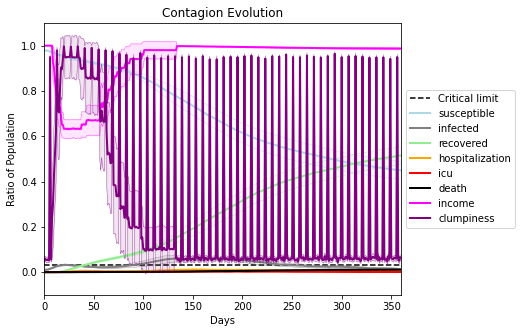

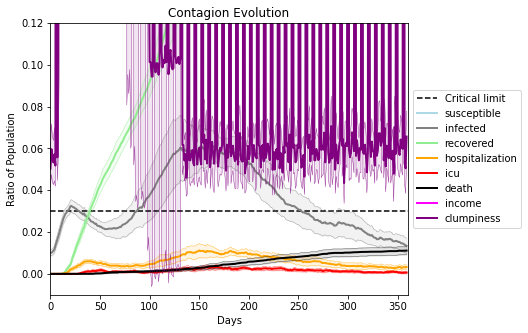

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7394, 331, 4790, 1759, 1266, 7381, 494, 1897, 7062, 7575, 2445, 9689, 9012, 6574, 2241, 8349, 847, 7332, 7519, 8940]
Average similarity between family members is 0.9351127227755119 at temperature -0.993
Average similarity between family and home is 0.9998393078472212 at temperature -1
Average similarity between students and their classroom is 0.5588623152448217 at temperature -0.993
Average classroom occupancy is 4.056338028169014 and number classrooms is 71
Average similarity between workers is 0.8620246129111706 at temperature -0.993
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8431936382820775 for kids: 0.6752825545446316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5571986796063797
avg restaurant similarity 0.5460668827110498
avg restaurant similarity 0.4295165902622313
avg restaurant similarity 0.449913213356554
avg restaurant similarity 0.6744501748537134
avg restaurant similarity 0.3971667980764896
avg restaurant similarity 0.45328969091838367
avg restaurant similarity 0.3756464231307749
avg restaurant similarity 0.8195719964343506
avg restaurant similarity 0.849783119030521
avg restaurant similarity 0.20605704667330016
avg restaurant similarity 0.4965436683889731
avg restaurant similarity 0.3745753453583387
avg restaurant similarity 0.3301003538966684
avg restaurant similarity 0.8218281039750915
avg restaurant similarity 0.5580143715928025
avg restaurant similarity 0.5753708969907835
avg restaurant similarity 0.9997164942232433
avg restaurant similarity 0.4389113397265276
avg restaurant similarity 0.15743355946874812
avg restaurant similarity 0.7711369620786628
avg restaurant similarity 0.28653990647733774
avg rest

avg restaurant similarity 0.5690056952029512
avg restaurant similarity 0.8315012661838868
avg restaurant similarity 0.6999950695491549
avg restaurant similarity 0.23097721056400622
avg restaurant similarity 0.30157138653802285
avg restaurant similarity 0.5852689952652579
avg restaurant similarity 0.33178839162692497
avg restaurant similarity 0.5127741725526826
avg restaurant similarity 0.6149606714054484
avg restaurant similarity 0.5379228678000874
avg restaurant similarity 0.7254693136356329
avg restaurant similarity 0.6033833106393884
avg restaurant similarity 0.7272272552925951
avg restaurant similarity 0.6162592065143816
avg restaurant similarity 0.6173872952354322
avg restaurant similarity 0.6510386998191444
avg restaurant similarity 0.3476562159613645
avg restaurant similarity 0.4939598168266286
avg restaurant similarity 0.5150534808389038
avg restaurant similarity 0.5809485791711247
avg restaurant similarity 0.41010318934528545
avg restaurant similarity 0.4200824903835758
avg re

avg restaurant similarity 0.4174587016069259
avg restaurant similarity 0.26218874528902325
avg restaurant similarity 0.525801031519861
avg restaurant similarity 0.5393667088959004
avg restaurant similarity 0.529084642125041
avg restaurant similarity 0.3452720728123994
avg restaurant similarity 0.6830414285434903
avg restaurant similarity 0.8419823549204183
avg restaurant similarity 0.4510783064374449
avg restaurant similarity 0.6521029764341971
avg restaurant similarity 0.6684456162839166
avg restaurant similarity 0.999663053274983
avg restaurant similarity 0.3009639196702505
avg restaurant similarity 0.09198271456187049
avg restaurant similarity 0.5730838118853087
avg restaurant similarity 0.6539091406830462
avg restaurant similarity 0.4975813322727912
avg restaurant similarity 0.8417202876266037
avg restaurant similarity 0.5584901390932501
avg restaurant similarity 0.6645210799452141
avg restaurant similarity 0.49087192181473444
avg restaurant similarity 0.6514325718003797
avg restau

avg restaurant similarity 0.6804981722835745
avg restaurant similarity 0.5030270717003718
avg restaurant similarity 0.6729781355302209
avg restaurant similarity 0.5506657223205036
avg restaurant similarity 0.5912948450574519
avg restaurant similarity 0.6621205167592539
avg restaurant similarity 0.7656823766199596
avg restaurant similarity 0.7688857253348373
avg restaurant similarity 0.4167945978967197
avg restaurant similarity 0.8024088907054132
avg restaurant similarity 0.5877160520554457
avg restaurant similarity 0.41415198375412743
avg restaurant similarity 0.39615659288860217
avg restaurant similarity 0.38043372674132436
avg restaurant similarity 0.46770908889152096
avg restaurant similarity 0.8302666976733508
avg restaurant similarity 0.5791163366150116
avg restaurant similarity 0.7678683829752025
avg restaurant similarity 0.8385967179652623
avg restaurant similarity 0.3852937000307286
avg restaurant similarity 0.47628536407723665
avg restaurant similarity 0.8567849515025712
avg r

avg restaurant similarity 0.5153502571959303
avg restaurant similarity 0.49624034758954305
avg restaurant similarity 0.5716940503091981
avg restaurant similarity 0.5352136506238472
avg restaurant similarity 0.5367822397229912
avg restaurant similarity 0.4443384851965464
avg restaurant similarity 0.5047210750693564
avg restaurant similarity 0.41456170552610455
avg restaurant similarity 0.5348221135809301
avg restaurant similarity 0.44995244586587146
avg restaurant similarity 0.45754201660755667
avg restaurant similarity 0.46330418869354917
avg restaurant similarity 0.48918285066393247
avg restaurant similarity 0.3692541307632434
avg restaurant similarity 0.5531427446588079
Average similarity between family members is 0.9221374245318938 at temperature -0.993
Average similarity between family and home is 0.9998500408648432 at temperature -1
Average similarity between students and their classroom is 0.5560997611595832 at temperature -0.993
Average classroom occupancy is 3.8285714285714287 

avg restaurant similarity 0.5390727716574089
avg restaurant similarity 0.419341253056725
avg restaurant similarity 0.5733309758310412
avg restaurant similarity 0.5547083399909297
avg restaurant similarity 0.6758081581920488
avg restaurant similarity 0.5496344705969223
avg restaurant similarity 0.11282876064376049
avg restaurant similarity 0.7136880955886797
avg restaurant similarity 0.5316077816895528
avg restaurant similarity 0.4184363069120033
avg restaurant similarity 0.5187588717162361
avg restaurant similarity 0.6144527128591493
avg restaurant similarity 0.575567068292923
avg restaurant similarity 0.6414582251135867
avg restaurant similarity 0.44117234057347104
avg restaurant similarity 0.6720669945435778
avg restaurant similarity 0.5688134524887429
avg restaurant similarity 0.3687729597989754
avg restaurant similarity 0.6298661762590826
avg restaurant similarity 0.9998029160714115
avg restaurant similarity 0.6995060083219549
avg restaurant similarity 0.4586023125099048
avg restau

avg restaurant similarity 0.5142937349494097
avg restaurant similarity 0.670669097563505
avg restaurant similarity 0.4217260929947198
avg restaurant similarity 0.8001753263041
avg restaurant similarity 0.3583961749663034
avg restaurant similarity 0.48265378514278573
avg restaurant similarity 0.29215703657458736
avg restaurant similarity 0.6904029803869678
avg restaurant similarity 0.4069296248730426
avg restaurant similarity 0.5484445664407053
avg restaurant similarity 0.3689180678338024
avg restaurant similarity 0.09064663837689771
avg restaurant similarity 0.35565716230536176
avg restaurant similarity 0.5010155112784487
avg restaurant similarity 0.229242360152246
avg restaurant similarity 0.3931795810233808
avg restaurant similarity 0.29215703657458736
avg restaurant similarity 0.644432286171422
avg restaurant similarity 0.7418022788708443
avg restaurant similarity 0.3771076939674214
avg restaurant similarity 0.39564426742645437
avg restaurant similarity 0.42886763628994284
avg resta

avg restaurant similarity 0.5614667782778094
avg restaurant similarity 0.5113628857988497
avg restaurant similarity 0.3987437118715639
avg restaurant similarity 0.3687342471823647
avg restaurant similarity 0.2649361004327516
avg restaurant similarity 0.4070495355296368
avg restaurant similarity 0.3948730663123894
avg restaurant similarity 0.8635099710904783
avg restaurant similarity 0.31978571027078173
avg restaurant similarity 0.7037364006997893
avg restaurant similarity 0.18218589852313688
avg restaurant similarity 0.4525930882219948
avg restaurant similarity 0.3685376794481156
avg restaurant similarity 0.37428463643851606
avg restaurant similarity 0.413950889789102
avg restaurant similarity 0.7907335748073613
avg restaurant similarity 0.6525209220580245
avg restaurant similarity 0.4054175130079375
avg restaurant similarity 0.6559110245965845
avg restaurant similarity 0.7326327404554682
avg restaurant similarity 0.23961390103546465
avg restaurant similarity 0.10293176810306565
avg re

avg restaurant similarity 0.36602420918477185
avg restaurant similarity 0.37089570419074425
avg restaurant similarity 0.3430241848220572
avg restaurant similarity 0.3089944405966826
avg restaurant similarity 0.5061744732963928
avg restaurant similarity 0.8680602129253358
avg restaurant similarity 0.5983920494784911
avg restaurant similarity 0.3696171922406848
avg restaurant similarity 0.7050747361648302
avg restaurant similarity 0.6845627008552688
avg restaurant similarity 0.36422046269949077
avg restaurant similarity 0.6070252456095572
avg restaurant similarity 0.9997415016561632
avg restaurant similarity 0.25267607829565597
avg restaurant similarity 0.5842720104119736
avg restaurant similarity 0.2602202916142634
avg restaurant similarity 0.6482554855560697
avg restaurant similarity 0.27210930459482535
avg restaurant similarity 0.5154068464661233
avg restaurant similarity 0.5359858024773988
avg restaurant similarity 0.36983615400853953
avg restaurant similarity 0.2997491432745587
avg 

avg restaurant similarity 0.6389893000102272
avg restaurant similarity 0.9997582334030608
avg restaurant similarity 0.41624622101140735
avg restaurant similarity 0.37958826347246166
avg restaurant similarity 0.5964175898356894
avg restaurant similarity 0.63800128542467
avg restaurant similarity 0.4611329238051075
avg restaurant similarity 0.2537125123385021
avg restaurant similarity 0.6736992148029228
avg restaurant similarity 0.5127837264881538
avg restaurant similarity 0.8372880256021359
avg restaurant similarity 0.5525939899431147
avg restaurant similarity 0.553354153946033
avg restaurant similarity 0.4508334513564184
avg restaurant similarity 0.6544630371549137
avg restaurant similarity 0.9112561247988158
avg restaurant similarity 0.322602031964222
avg restaurant similarity 0.45772244513855764
avg restaurant similarity 0.5198772338877671
avg restaurant similarity 0.4454644855923265
avg restaurant similarity 0.26665497161038826
avg restaurant similarity 0.4642099433416912
avg restau

avg restaurant similarity 0.6832809631136675
avg restaurant similarity 0.5461862497229251
avg restaurant similarity 0.43111953517605917
avg restaurant similarity 0.4118777086363618
avg restaurant similarity 0.44795304523091106
avg restaurant similarity 0.5183835659945685
avg restaurant similarity 0.3641944441674451
avg restaurant similarity 0.527746407884011
avg restaurant similarity 0.5040924073524069
avg restaurant similarity 0.4903487188901247
avg restaurant similarity 0.31677864368226416
avg restaurant similarity 0.8566138550689599
avg restaurant similarity 0.3317977983758903
avg restaurant similarity 0.5215583933962417
avg restaurant similarity 0.5618580823380087
avg restaurant similarity 0.44282625054737385
avg restaurant similarity 0.37723582058908345
avg restaurant similarity 0.4888126442412879
avg restaurant similarity 0.4941863012676435
avg restaurant similarity 0.5332037084324757
avg restaurant similarity 0.6488543221866458
avg restaurant similarity 0.8173934642908299
avg re

avg restaurant similarity 0.34397246004945115
avg restaurant similarity 0.7319305873818456
avg restaurant similarity 0.5635702895372474
avg restaurant similarity 0.5059081374810788
avg restaurant similarity 0.5792703280657804
avg restaurant similarity 0.5226971627687116
avg restaurant similarity 0.7589651955380075
avg restaurant similarity 0.40244992017582876
avg restaurant similarity 0.3856506758963731
avg restaurant similarity 0.37995777092940597
avg restaurant similarity 0.5542836305084817
avg restaurant similarity 0.7329902421335192
avg restaurant similarity 0.5000059179579721
avg restaurant similarity 0.24753145187089914
avg restaurant similarity 0.24822927062008482
avg restaurant similarity 0.44068916485738147
avg restaurant similarity 0.7583919152016858
avg restaurant similarity 0.5462542099539727
avg restaurant similarity 0.3843277949921128
avg restaurant similarity 0.6271554595438347
avg restaurant similarity 0.5039683882514546
avg restaurant similarity 0.5165048481572616
avg 

avg restaurant similarity 0.4618794189038873
avg restaurant similarity 0.5324760187301694
avg restaurant similarity 0.6165714420277175
avg restaurant similarity 0.6185435365916876
avg restaurant similarity 0.5443889562258604
avg restaurant similarity 0.25043124519822635
avg restaurant similarity 0.6114234819704729
avg restaurant similarity 0.5504198822224431
avg restaurant similarity 0.3874278862027558
avg restaurant similarity 0.39679974372141846
avg restaurant similarity 0.4361106665310585
avg restaurant similarity 0.5116081048612601
avg restaurant similarity 0.3736310565276223
avg restaurant similarity 0.8307847514764335
avg restaurant similarity 0.507424447028524
avg restaurant similarity 0.47151567568478675
avg restaurant similarity 0.4790349829325717
avg restaurant similarity 0.3803078526680039
avg restaurant similarity 0.43883496525753696
avg restaurant similarity 0.5110833295176117
avg restaurant similarity 0.507424447028524
avg restaurant similarity 0.5451763229085629
avg rest

Average similarity between workers is 0.8830260029325131 at temperature -0.993
Average office occupancy is 3.2653061224489797 and number offices is 196
Average friend similarity for adults: 0.8437904710033065 for kids: 0.6702159937129247
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6159679648585433
avg restaurant similarity 0.40763648402423625
avg restaurant similarity 0.4929921616077408
avg restaurant similarity 0.5543730495493302
avg restaurant similarity 0.9231455690805139
avg restaurant similarity 0.5153172281208585
avg restaurant similarity 0.8149728608716993
avg restaurant similarity 0.2906344898101901
avg restaurant similarity 0.41497232199059664
avg restaurant similarity 0.32422929360224856
avg restaurant similarity 0.5301850989559751
avg restaurant similarity 0.5388936602512144
avg restaurant similarity 0.4929921616077408
avg restaurant similarity 0.4620603203872472
avg restaurant similarity 0.24103249022292816
avg restaurant similarity 0.3772317384706677
avg restaurant similarity 0.48154642675576
avg restaurant similarity 0.4951933381539103
avg restaurant similarity 0.6797383280520096
avg restaurant similarity 0.44244298733563087
avg restaurant similarity 0.6257784859934435
avg restaurant similarity 0.8748540892837922
avg res

avg restaurant similarity 0.6653722464923364
avg restaurant similarity 0.6664673574108719
avg restaurant similarity 0.7844596006166115
avg restaurant similarity 0.6916376457587297
avg restaurant similarity 0.7731551928076743
avg restaurant similarity 0.6679972706297903
avg restaurant similarity 0.41854355265096055
avg restaurant similarity 0.6939948024363297
avg restaurant similarity 0.448285180338509
avg restaurant similarity 0.693893660310194
avg restaurant similarity 0.4634807235406665
avg restaurant similarity 0.43676256447590084
avg restaurant similarity 0.6608825058167445
avg restaurant similarity 0.5143774830863344
avg restaurant similarity 0.07302426476971322
avg restaurant similarity 0.5319169787632922
avg restaurant similarity 0.6880348225303049
avg restaurant similarity 0.5252913154151907
avg restaurant similarity 0.4205767714858788
avg restaurant similarity 0.5176254857644952
avg restaurant similarity 0.5909696581881059
avg restaurant similarity 0.8442289743647944
avg resta

avg restaurant similarity 0.6492213635895914
avg restaurant similarity 0.43182859071684654
avg restaurant similarity 0.672577766763178
avg restaurant similarity 0.3182306997076819
avg restaurant similarity 0.67100809590106
avg restaurant similarity 0.4645044261043218
avg restaurant similarity 0.35849878311449185
avg restaurant similarity 0.5280233952591785
avg restaurant similarity 0.9269293875497622
avg restaurant similarity 0.47764056872603877
avg restaurant similarity 0.5439944309406668
avg restaurant similarity 0.6641878050522538
avg restaurant similarity 0.4635278370868444
avg restaurant similarity 0.34596108968020334
avg restaurant similarity 0.4804412800926472
avg restaurant similarity 0.2545743804029958
avg restaurant similarity 0.1912206276820131
avg restaurant similarity 0.5080467905989041
avg restaurant similarity 0.5645407436499998
avg restaurant similarity 0.5150318994186697
avg restaurant similarity 0.2612087821818808
avg restaurant similarity 0.564995821693739
avg restau

avg restaurant similarity 0.8115905095429472
avg restaurant similarity 0.6624784517267023
avg restaurant similarity 0.5179363617462402
avg restaurant similarity 0.5234562230916706
avg restaurant similarity 0.6792578371842188
avg restaurant similarity 0.41199785297861913
avg restaurant similarity 0.4863610070751917
avg restaurant similarity 0.6692045029831949
avg restaurant similarity 0.8545223783073367
avg restaurant similarity 0.33969204659564356
avg restaurant similarity 0.567409708863134
avg restaurant similarity 0.6406501550567173
avg restaurant similarity 0.542436805856289
avg restaurant similarity 0.8453727436747904
avg restaurant similarity 0.3554137806168666
avg restaurant similarity 0.6122394140750592
avg restaurant similarity 0.9267483991982854
avg restaurant similarity 0.6778267108928157
avg restaurant similarity 0.8237621232051728
avg restaurant similarity 0.29609348713102673
avg restaurant similarity 0.6811829664364681
avg restaurant similarity 0.5192828076310192
avg resta

avg restaurant similarity 0.5922447012884536
avg restaurant similarity 0.5595044856255317
avg restaurant similarity 0.38023920985179016
avg restaurant similarity 0.5435915337287991
avg restaurant similarity 0.7325669577522547
avg restaurant similarity 0.43447135621758765
avg restaurant similarity 0.7962195110863424
avg restaurant similarity 0.4451817178897635
avg restaurant similarity 0.9996972025040842
avg restaurant similarity 0.2719616071610339
avg restaurant similarity 0.6586181945090095
avg restaurant similarity 0.6706581938665487
avg restaurant similarity 0.7857289356113379
avg restaurant similarity 0.49039056726360164
avg restaurant similarity 0.4438245138783956
avg restaurant similarity 0.604680118723061
avg restaurant similarity 0.37934284018926095
avg restaurant similarity 0.5190366276934831
avg restaurant similarity 0.23572518457322314
avg restaurant similarity 0.666814612357939
avg restaurant similarity 0.8197026359211773
avg restaurant similarity 0.8797752431468137
avg res

avg restaurant similarity 0.5856868695861085
avg restaurant similarity 0.7921111951267019
avg restaurant similarity 0.6405784309470222
avg restaurant similarity 0.5290037017247436
avg restaurant similarity 0.6187569973664523
avg restaurant similarity 0.6912615243078124
avg restaurant similarity 0.6178614517588217
avg restaurant similarity 0.17122524082225118
avg restaurant similarity 0.3597864857423394
avg restaurant similarity 0.5852139353821204
avg restaurant similarity 0.30804869043135896
avg restaurant similarity 0.9041584214676428
avg restaurant similarity 0.8287313881927946
avg restaurant similarity 0.6178614517588217
avg restaurant similarity 0.5711250937355554
avg restaurant similarity 0.9041584214676428
avg restaurant similarity 0.9995644459559596
avg restaurant similarity 0.6369017397002896
avg restaurant similarity 0.4546219712044729
avg restaurant similarity 0.6054160255284654
avg restaurant similarity 0.41032086133201906
avg restaurant similarity 0.9999335729839808
avg res

Average similarity between family members is 0.9250076775800515 at temperature -0.993
Average similarity between family and home is 0.9998576642794551 at temperature -1
Average similarity between students and their classroom is 0.5443765126650805 at temperature -0.993
Average classroom occupancy is 3.9420289855072466 and number classrooms is 69
Average similarity between workers is 0.8716395210626962 at temperature -0.993
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.8428375030483333 for kids: 0.6541883382878693
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (

avg restaurant similarity 0.38350916506985844
avg restaurant similarity 0.9998472549115164
avg restaurant similarity 0.3764061752810502
avg restaurant similarity 0.6675575646440053
avg restaurant similarity 0.3978417959827906
avg restaurant similarity 0.603395911099307
avg restaurant similarity 0.7268719662981546
avg restaurant similarity 0.45534273089512367
avg restaurant similarity 0.578301394439859
avg restaurant similarity 0.5834171522394374
avg restaurant similarity 0.8462622985239676
avg restaurant similarity 0.858790170110293
avg restaurant similarity 0.7686446507447473
avg restaurant similarity 0.37366501370678196
avg restaurant similarity 0.9997352150226658
avg restaurant similarity 0.9996889200018854
avg restaurant similarity 0.525779232324227
avg restaurant similarity 0.5106044176792999
avg restaurant similarity 0.3727851189701098
avg restaurant similarity 0.7866022754851676
avg restaurant similarity 0.675741435754453
avg restaurant similarity 0.5679887896541191
avg restaura

avg restaurant similarity 0.4745534499234504
avg restaurant similarity 0.3026591779479804
avg restaurant similarity 0.5393813969819244
avg restaurant similarity 0.48931689334121337
avg restaurant similarity 0.4259825361350133
avg restaurant similarity 0.8846651470412052
avg restaurant similarity 0.7364329972027935
avg restaurant similarity 0.4380985860811904
avg restaurant similarity 0.6402345616228797
avg restaurant similarity 0.5266434225601173
avg restaurant similarity 0.4912831536911447
avg restaurant similarity 0.39501066220212744
avg restaurant similarity 0.22786477154033152
avg restaurant similarity 0.6811925339801409
avg restaurant similarity 0.8899434412504534
avg restaurant similarity 0.999514200088089
avg restaurant similarity 0.4881185625256869
avg restaurant similarity 0.855922607351
avg restaurant similarity 0.7140200368069186
avg restaurant similarity 0.33692017124661144
avg restaurant similarity 0.6693060815445313
avg restaurant similarity 0.8028803901318475
avg restaur

avg restaurant similarity 0.5021386829461981
avg restaurant similarity 0.7229824892337013
avg restaurant similarity 0.47724252498574765
avg restaurant similarity 0.9996002063828586
avg restaurant similarity 0.6818395820932424
avg restaurant similarity 0.2339780883342898
avg restaurant similarity 0.7512754902313777
avg restaurant similarity 0.40745625493656423
avg restaurant similarity 0.7038415436192507
avg restaurant similarity 0.4368300691105586
avg restaurant similarity 0.2883408797927841
avg restaurant similarity 0.5013224182128034
avg restaurant similarity 0.5062632700199958
avg restaurant similarity 0.2158725517945734
avg restaurant similarity 0.9998063954424103
avg restaurant similarity 0.39587307593086085
avg restaurant similarity 0.6328176429700919
avg restaurant similarity 0.20967217302510277
avg restaurant similarity 0.498011265478585
avg restaurant similarity 0.8463034237995208
avg restaurant similarity 0.9996002063828586
avg restaurant similarity 0.4190462645395625
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

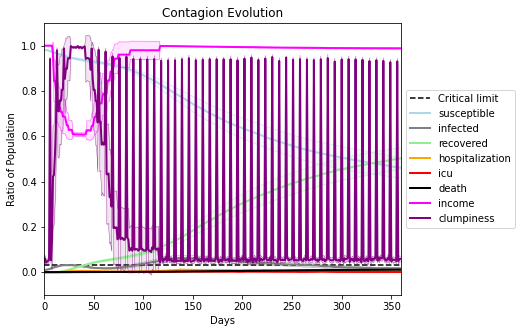

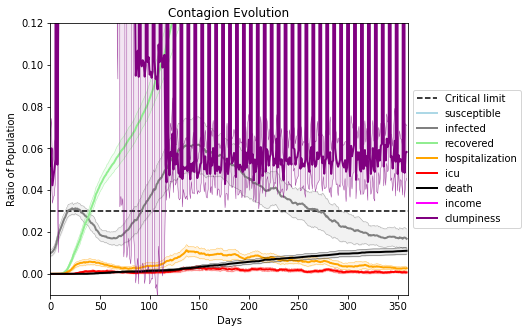

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6490, 8561, 5952, 2242, 2262, 2137, 3926, 6354, 1204, 2623, 1144, 143, 8701, 7149, 2527, 2014, 8293, 7216, 4261, 5755]
Average similarity between family members is 0.914677040474715 at temperature -0.992
Average similarity between family and home is 0.9998578622499614 at temperature -1
Average similarity between students and their classroom is 0.5124965306573926 at temperature -0.992
Average classroom occupancy is 4.098591549295775 and number classrooms is 71
Average similarity between workers is 0.8403732660847486 at temperature -0.992
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8369728201164699 for kids: 0.6595686772517151
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5414533287149239
avg restaurant similarity 0.8110455195571298
avg restaurant similarity 0.3818786724409357
avg restaurant similarity 0.4796576870784282
avg restaurant similarity 0.4878819287661307
avg restaurant similarity 0.6368487841060139
avg restaurant similarity 0.5262093395588873
avg restaurant similarity 0.5535987783792979
avg restaurant similarity 0.5167102412997686
avg restaurant similarity 0.19675956096260738
avg restaurant similarity 0.5627512689191779
avg restaurant similarity 0.4264391739506347
avg restaurant similarity 0.8104302739362557
avg restaurant similarity 0.9996640134555288
avg restaurant similarity 0.4878183869964357
avg restaurant similarity 0.4092938548826414
avg restaurant similarity 0.6062696589476224
avg restaurant similarity 0.44149108949486987
avg restaurant similarity 0.9997557541851382
avg restaurant similarity 0.9998601979427282
avg restaurant similarity 0.4761366462245077
avg restaurant similarity 0.40960415091047997
avg res

avg restaurant similarity 0.46591263333568234
avg restaurant similarity 0.21295383315258742
avg restaurant similarity 0.43647002924474815
avg restaurant similarity 0.4856471728150642
avg restaurant similarity 0.35003697720156746
avg restaurant similarity 0.46380719870360987
avg restaurant similarity 0.4688481201725282
avg restaurant similarity 0.4861305591080426
avg restaurant similarity 0.4829719710950383
avg restaurant similarity 0.4688481201725282
avg restaurant similarity 0.49672810889799096
avg restaurant similarity 0.42248224530709133
avg restaurant similarity 0.4688565808071221
avg restaurant similarity 0.4598909321943872
avg restaurant similarity 0.9997671734920011
avg restaurant similarity 0.7879724971661604
avg restaurant similarity 0.4515099667951633
avg restaurant similarity 0.5211051719936233
avg restaurant similarity 0.5796692607427434
avg restaurant similarity 0.8609824727980563
avg restaurant similarity 0.5092840397058108
avg restaurant similarity 0.7632364695795966
avg

avg restaurant similarity 0.5839267807146903
avg restaurant similarity 0.3421353899523297
avg restaurant similarity 0.5586851888574023
avg restaurant similarity 0.4800983961460381
avg restaurant similarity 0.5829098178199125
avg restaurant similarity 0.6394580307495457
avg restaurant similarity 0.9998979889529884
avg restaurant similarity 0.9048238303000172
avg restaurant similarity 0.44296615759402236
avg restaurant similarity 0.522164295888472
avg restaurant similarity 0.6505097709645209
avg restaurant similarity 0.46910701363410356
avg restaurant similarity 0.6385163565440506
avg restaurant similarity 0.6398256105405555
avg restaurant similarity 0.38157273692688465
avg restaurant similarity 0.8098693214177255
avg restaurant similarity 0.423250128193307
avg restaurant similarity 0.4249067173304233
avg restaurant similarity 0.359134937893294
avg restaurant similarity 0.401630790993201
avg restaurant similarity 0.4273677376567343
avg restaurant similarity 0.7934129372556937
avg restaur

avg restaurant similarity 0.6268407039449474
avg restaurant similarity 0.7144316893732989
avg restaurant similarity 0.6664815007122395
avg restaurant similarity 0.4685085242909184
avg restaurant similarity 0.681246965755945
avg restaurant similarity 0.6638544828019441
avg restaurant similarity 0.7932960522381546
avg restaurant similarity 0.6767226625994753
avg restaurant similarity 0.4159106303598859
avg restaurant similarity 0.4636363448996136
Average similarity between family members is 0.9247039873663391 at temperature -0.992
Average similarity between family and home is 0.9998494003618825 at temperature -1
Average similarity between students and their classroom is 0.5323213114919796 at temperature -0.992
Average classroom occupancy is 4.072463768115942 and number classrooms is 69
Average similarity between workers is 0.8545597545746455 at temperature -0.992
Average office occupancy is 3.455026455026455 and number offices is 189
Average friend similarity for adults: 0.84101161267193

avg restaurant similarity 0.5037995604211268
avg restaurant similarity 0.6692026554894159
avg restaurant similarity 0.7328786826330151
avg restaurant similarity 0.755653008047879
avg restaurant similarity 0.3435606295866773
avg restaurant similarity 0.5033532248019044
avg restaurant similarity 0.6313741249361731
avg restaurant similarity 0.6996166377816074
avg restaurant similarity 0.1841932938452323
avg restaurant similarity 0.7339517316068607
avg restaurant similarity 0.629092841981856
avg restaurant similarity 0.4966995890736425
avg restaurant similarity 0.5456324321165847
avg restaurant similarity 0.8335857520755283
avg restaurant similarity 0.5885448669034627
avg restaurant similarity 0.3481841787624085
avg restaurant similarity 0.806542878611987
avg restaurant similarity 0.6228186409409159
avg restaurant similarity 0.5610108829819764
avg restaurant similarity 0.673858267025434
avg restaurant similarity 0.5888623888873543
avg restaurant similarity 0.5614114634115662
avg restaurant

avg restaurant similarity 0.2693000110907558
avg restaurant similarity 0.8048466104610646
avg restaurant similarity 0.3842424060360896
avg restaurant similarity 0.40916605364420033
avg restaurant similarity 0.45056224937383343
avg restaurant similarity 0.33852006775654353
avg restaurant similarity 0.5882611062461149
avg restaurant similarity 0.3742223656085815
avg restaurant similarity 0.31650490879321924
avg restaurant similarity 0.4964892019136069
avg restaurant similarity 0.4345918111592477
avg restaurant similarity 0.6208299674684444
avg restaurant similarity 0.4323520763113979
avg restaurant similarity 0.24575443307425804
avg restaurant similarity 0.6398748125971117
avg restaurant similarity 0.4367196769298738
avg restaurant similarity 0.6206049341360325
avg restaurant similarity 0.6398748125971117
avg restaurant similarity 0.4931380707383226
avg restaurant similarity 0.45989811414163284
avg restaurant similarity 0.646001833663312
avg restaurant similarity 0.47402005050741003
avg 

avg restaurant similarity 0.5250598114561088
avg restaurant similarity 0.386158218948636
avg restaurant similarity 0.541902915283503
avg restaurant similarity 0.6462380876224152
avg restaurant similarity 0.5967413974998749
avg restaurant similarity 0.2828105729813215
avg restaurant similarity 0.3463465501420774
avg restaurant similarity 0.4516497199911109
avg restaurant similarity 0.5848391171177372
avg restaurant similarity 0.8600595770391296
avg restaurant similarity 0.7864704957445973
avg restaurant similarity 0.19003780616243646
avg restaurant similarity 0.5087027012263752
avg restaurant similarity 0.6171583623341506
avg restaurant similarity 0.3999198921112872
avg restaurant similarity 0.44692634417877125
avg restaurant similarity 0.6789226761566878
avg restaurant similarity 0.4340592558573967
avg restaurant similarity 0.7076052354959043
avg restaurant similarity 0.4391341811195339
avg restaurant similarity 0.5019155960922711
avg restaurant similarity 0.46317700334751927
avg resta

avg restaurant similarity 0.4290061413702851
avg restaurant similarity 0.4855869921767499
avg restaurant similarity 0.36001124707277865
avg restaurant similarity 0.704109221850791
avg restaurant similarity 0.3785611738675591
avg restaurant similarity 0.4021090195280572
avg restaurant similarity 0.18738622719756587
avg restaurant similarity 0.7238918522165734
avg restaurant similarity 0.6470714176891847
avg restaurant similarity 0.017971297110932344
avg restaurant similarity 0.380394804248914
avg restaurant similarity 0.352407226455277
avg restaurant similarity 0.38630244843135564
avg restaurant similarity 0.8642075990575273
avg restaurant similarity 0.6560731135487732
avg restaurant similarity 0.8476978507939401
avg restaurant similarity 0.3412247269470819
avg restaurant similarity 0.4036702640003122
avg restaurant similarity 0.7445889063114073
avg restaurant similarity 0.4806635226615319
avg restaurant similarity 0.6444048513489127
avg restaurant similarity 0.4954840311222688
avg rest

avg restaurant similarity 0.5548120908139879
avg restaurant similarity 0.6260728011992125
avg restaurant similarity 0.9288109571578849
avg restaurant similarity 0.9201602744848971
avg restaurant similarity 0.39242685788999343
avg restaurant similarity 0.5813935711342306
avg restaurant similarity 0.4905156349842351
avg restaurant similarity 0.5837660438443137
avg restaurant similarity 0.4327624245827111
avg restaurant similarity 0.6661498421699459
avg restaurant similarity 0.4557764150159721
avg restaurant similarity 0.5804532161621816
avg restaurant similarity 0.4395441181814118
avg restaurant similarity 0.9997576509415047
avg restaurant similarity 0.5195155753560124
avg restaurant similarity 0.45610326255837874
avg restaurant similarity 0.5820769208683548
avg restaurant similarity 0.5425674449595509
avg restaurant similarity 0.672396805307777
avg restaurant similarity 0.9998324149370197
avg restaurant similarity 0.24829332726397488
avg restaurant similarity 0.593627359291786
avg resta

avg restaurant similarity 0.6352774954039467
avg restaurant similarity 0.6609157295748904
avg restaurant similarity 0.6032068834991071
avg restaurant similarity 0.34150221820729576
avg restaurant similarity 0.5333196409481238
avg restaurant similarity 0.45986008435255693
avg restaurant similarity 0.5107579522768478
avg restaurant similarity 0.35558176744620473
avg restaurant similarity 0.5664597332157698
avg restaurant similarity 0.48675750724997086
avg restaurant similarity 0.5856060779932476
avg restaurant similarity 0.5719722629304679
avg restaurant similarity 0.47694799433449786
avg restaurant similarity 0.4382054775782192
avg restaurant similarity 0.29250969725046677
avg restaurant similarity 0.5012364384874657
avg restaurant similarity 0.2159043963356781
avg restaurant similarity 0.41469553938682735
avg restaurant similarity 0.48700083029414437
avg restaurant similarity 0.5796243883361512
avg restaurant similarity 0.5333196409481238
avg restaurant similarity 0.6430558110160021
av

Average similarity between workers is 0.8354356937801374 at temperature -0.992
Average office occupancy is 3.404255319148936 and number offices is 188
Average friend similarity for adults: 0.8371336452847431 for kids: 0.6521969916337553
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.32541317582997575
avg restaurant similarity 0.434069860136754
avg restaurant similarity 0.39607527878902316
avg restaurant similarity 0.3979150799675299
avg restaurant similarity 0.5820570426851737
avg restaurant similarity 0.6729475635693367
avg restaurant similarity 0.40290297072624626
avg restaurant similarity 0.3604732518804647
avg restaurant similarity 0.38167301570661805
avg restaurant similarity 0.5778982409477957
avg restaurant similarity 0.07449012199693132
avg restaurant similarity 0.9486246996652844
avg restaurant similarity 0.8038186612095389
avg restaurant similarity 0.3865099794875227
avg restaurant similarity 0.52756470059314
avg restaurant similarity 0.45380291128218697
avg restaurant similarity 0.45949943807515925
avg restaurant similarity 0.8925247880494633
avg restaurant similarity 0.9995933742721613
avg restaurant similarity 0.3308013081793537
avg restaurant similarity 0.9995844021336359
avg restaurant similarity 0.9995933742721613
avg re

avg restaurant similarity 0.508225385801108
avg restaurant similarity 0.8821871794036151
avg restaurant similarity 0.3982655627110456
avg restaurant similarity 0.4983684858316033
avg restaurant similarity 0.49826310564117
avg restaurant similarity 0.5400468343722296
avg restaurant similarity 0.6626173178615127
avg restaurant similarity 0.4870243190838613
avg restaurant similarity 0.4001688752469543
avg restaurant similarity 0.5720665786508483
avg restaurant similarity 0.5000943081555445
avg restaurant similarity 0.5377323583660963
avg restaurant similarity 0.7038113550151557
avg restaurant similarity 0.5418421036163398
avg restaurant similarity 0.41595554146416963
avg restaurant similarity 0.6214134347213244
avg restaurant similarity 0.38769803028866606
avg restaurant similarity 0.5103574790564522
avg restaurant similarity 0.428892735760928
avg restaurant similarity 0.28138693404324344
avg restaurant similarity 0.47872684514810415
avg restaurant similarity 0.37249633837289414
avg resta

avg restaurant similarity 0.45723324280234023
avg restaurant similarity 0.48013076510246516
avg restaurant similarity 0.5167017280368075
avg restaurant similarity 0.2249714313479377
avg restaurant similarity 0.4616498409891918
avg restaurant similarity 0.756502551938673
avg restaurant similarity 0.5588608070632635
avg restaurant similarity 0.6758590792444379
avg restaurant similarity 0.5864384105867511
avg restaurant similarity 0.9996541674779
avg restaurant similarity 0.501999171449261
avg restaurant similarity 0.5973474171245705
avg restaurant similarity 0.4038600692961494
avg restaurant similarity 0.46110388265400787
avg restaurant similarity 0.4365839134710112
avg restaurant similarity 0.4639973675320628
avg restaurant similarity 0.6792639377073517
avg restaurant similarity 0.3780002174913648
avg restaurant similarity 0.9996289536863214
avg restaurant similarity 0.6765239962498099
avg restaurant similarity 0.2223535756498329
avg restaurant similarity 0.3993771246258595
avg restaura

avg restaurant similarity 0.37400948589346916
avg restaurant similarity 0.4793452601536208
avg restaurant similarity 0.40033915934176345
avg restaurant similarity 0.7020300874548878
avg restaurant similarity 0.9998524598817656
avg restaurant similarity 0.4780313716218269
avg restaurant similarity 0.19665082160954883
avg restaurant similarity 0.887389856342197
avg restaurant similarity -0.001834198260219827
avg restaurant similarity 0.4051974093805635
avg restaurant similarity 0.298971643277615
avg restaurant similarity 0.2836508423668165
avg restaurant similarity 0.7458142799353921
avg restaurant similarity 0.4745593998645668
avg restaurant similarity 0.4427519823635291
avg restaurant similarity 0.6171146508292541
avg restaurant similarity 0.42308460516232627
avg restaurant similarity 0.887389856342197
avg restaurant similarity 0.7489089138835865
avg restaurant similarity 0.885843973297175
avg restaurant similarity 0.5230601353955291
avg restaurant similarity 0.624071610610399
avg rest

avg restaurant similarity 0.7448255034403672
avg restaurant similarity 0.7547516683609613
avg restaurant similarity 0.5544279283438518
avg restaurant similarity 0.5749778041118946
avg restaurant similarity 0.7127279592614254
avg restaurant similarity 0.46088626827601836
avg restaurant similarity 0.8025206077595727
avg restaurant similarity 0.4031277540947258
avg restaurant similarity 0.43423050309130923
avg restaurant similarity 0.5445842173160952
avg restaurant similarity 0.5522283744761004
avg restaurant similarity 0.5414341648518541
avg restaurant similarity 0.7091979916626108
avg restaurant similarity 0.4241765843524723
avg restaurant similarity 0.5436711055092078
avg restaurant similarity 0.5905461501801523
avg restaurant similarity 0.4607679401559331
avg restaurant similarity 0.3947272822038581
avg restaurant similarity 0.6748248506950942
avg restaurant similarity 0.9994999435915881
avg restaurant similarity 0.44715907497552665
avg restaurant similarity 0.550215961367016
avg rest

Average friend similarity for adults: 0.8394778212115932 for kids: 0.6684208679764121
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.5882872552051882
avg restaurant similarity 0.5061297381946339
avg restaurant similarity 0.3756958877154809
avg restaurant similarity 0.5456399873850295
avg restaurant similarity 0.3789370680959627
avg restaurant similarity 0.6598064787310378
avg restaurant similarity 0.8583270247521755
avg restaurant similarity 0.5295157239747168
avg restaurant similarity 0.3655143822038535
avg restaurant similarity 0.636862571195056
avg restaurant similarity 0.17810806629369183
avg restaurant similarity 0.6494434786751333
avg restaurant similarity 0.6643713659114598
avg restaurant similarity 0.636862571195056
avg restaurant similarity 0.5767947423782159
avg restaurant similarity 0.29812649126242974
avg restaurant similarity 0.4172006367785801
avg restaurant similarity 0.9998182622897884
avg restaurant similarity 0.9995227159919411
avg restaurant similarity 0.5985282814186591
avg restaurant similarity 0.49683057185846957
avg restaurant similarity 0.2835856997047024
avg resta

avg restaurant similarity 0.49683057185846957
avg restaurant similarity 0.44306895519070666
avg restaurant similarity 0.5810528049161433
avg restaurant similarity 0.26034725326626507
avg restaurant similarity 0.5893833371655001
avg restaurant similarity 0.2906159250328201
avg restaurant similarity 0.7162882330379491
avg restaurant similarity 0.5185341798079118
avg restaurant similarity 0.4576355495343977
avg restaurant similarity 0.28550618766549
avg restaurant similarity 0.5024165303745883
avg restaurant similarity 0.706487766153014
avg restaurant similarity 0.44986517831100253
avg restaurant similarity 0.6595193502908341
avg restaurant similarity 0.4221430020444243
avg restaurant similarity 0.5414704392366242
avg restaurant similarity 0.7414481076578818
avg restaurant similarity 0.551576304572032
avg restaurant similarity 0.41290614986326335
avg restaurant similarity 0.7049085841278556
avg restaurant similarity 0.7796356734078098
avg restaurant similarity 0.5456399873850295
Average s

avg restaurant similarity 0.5843894591052616
avg restaurant similarity 0.270523953619373
avg restaurant similarity 0.6384166122210554
avg restaurant similarity 0.6488649490429731
avg restaurant similarity 0.42715672848008474
avg restaurant similarity 0.5287066830077054
avg restaurant similarity 0.49819367243055124
avg restaurant similarity 0.35545070390713585
avg restaurant similarity 0.58453112544125
avg restaurant similarity 0.5325548866944481
avg restaurant similarity 0.42856660628175147
avg restaurant similarity -0.014293894801327423
avg restaurant similarity 0.7719637641189259
avg restaurant similarity 0.5088515777465206
avg restaurant similarity 0.4292973856647159
avg restaurant similarity 0.515927485724902
avg restaurant similarity 0.6373932856392422
avg restaurant similarity 0.7262452005358335
avg restaurant similarity -0.014293894801327423
avg restaurant similarity 0.5069446766666179
avg restaurant similarity 0.4065298275408368
avg restaurant similarity 0.14192043430324208
avg

avg restaurant similarity 0.42533194326944473
avg restaurant similarity 0.5760379598740277
avg restaurant similarity 0.7668035964761236
avg restaurant similarity 0.7053470175445393
avg restaurant similarity 0.47291214434466855
avg restaurant similarity 0.7781658446345552
avg restaurant similarity 0.19343815180593177
avg restaurant similarity 0.14741568196086463
avg restaurant similarity 0.36418014570487584
avg restaurant similarity 0.29990107454726733
avg restaurant similarity 0.2571383061150704
avg restaurant similarity 0.29783812540526533
avg restaurant similarity 0.4178016137786158
avg restaurant similarity 0.6602509566030734
avg restaurant similarity 0.5569843323847536
avg restaurant similarity 0.1654269993551862
avg restaurant similarity 0.21992523342635284
avg restaurant similarity 0.35937146981566886
avg restaurant similarity 0.5630434747607606
avg restaurant similarity 0.6720861550422181
avg restaurant similarity 0.5725413648780491
avg restaurant similarity 0.33777541078469386


avg restaurant similarity 0.36912097505602537
avg restaurant similarity 0.27531740621390005
avg restaurant similarity 0.6231538054204132
avg restaurant similarity 0.33098627667658154
avg restaurant similarity 0.5766614224778779
avg restaurant similarity 0.32999909024276136
avg restaurant similarity 0.34243881240463964
avg restaurant similarity 0.6437141959888455
Average similarity between family members is 0.9254813335563337 at temperature -0.992
Average similarity between family and home is 0.9998571509731918 at temperature -1
Average similarity between students and their classroom is 0.5514759207478758 at temperature -0.992
Average classroom occupancy is 3.9130434782608696 and number classrooms is 69
Average similarity between workers is 0.8465061524118219 at temperature -0.992
Average office occupancy is 3.472081218274112 and number offices is 197
Average friend similarity for adults: 0.8424426182967059 for kids: 0.6589664168871399
home_districts
[
Home (0,0) district with 1 Buildin

avg restaurant similarity 0.39661242905304367
avg restaurant similarity 0.5912802977928655
avg restaurant similarity 0.11647099984097456
avg restaurant similarity 0.46808002695211204
avg restaurant similarity 0.3925069501086928
avg restaurant similarity 0.4330109153111429
avg restaurant similarity 0.39309844095375385
avg restaurant similarity 0.39537581479414485
avg restaurant similarity 0.4810801828295701
avg restaurant similarity 0.3286748626750892
avg restaurant similarity 0.7148125748740795
avg restaurant similarity 0.924798471864016
avg restaurant similarity 0.7013362088262914
avg restaurant similarity 0.3987710759679319
avg restaurant similarity 0.3096420569943767
avg restaurant similarity 0.3934699149628241
avg restaurant similarity 0.5790362155866182
avg restaurant similarity 0.9269944860838708
avg restaurant similarity 0.5017243932114344
avg restaurant similarity 0.5997238231776435
avg restaurant similarity 0.4362031280864128
avg restaurant similarity 0.5883070104447556
avg re

avg restaurant similarity 0.37720769853362485
avg restaurant similarity 0.5520373787213172
avg restaurant similarity 0.38897654282881056
avg restaurant similarity 0.7846326238056336
avg restaurant similarity 0.6293934144410104
avg restaurant similarity 0.41616070859994664
avg restaurant similarity 0.3112216875083247
avg restaurant similarity 0.6131195415428238
avg restaurant similarity 0.4379193995580209
avg restaurant similarity 0.5288628697958048
avg restaurant similarity 0.4885393971360131
avg restaurant similarity 0.39671942564729157
avg restaurant similarity 0.4557238607597715
avg restaurant similarity 0.5085957617559443
avg restaurant similarity 0.449586316546565
avg restaurant similarity 0.4485756241431136
avg restaurant similarity 0.6028466857358086
avg restaurant similarity 0.592563826406513
avg restaurant similarity 0.7938140591313589
avg restaurant similarity 0.4058952910305413
avg restaurant similarity 0.41616070859994664
avg restaurant similarity 0.43593172150410076
avg re

avg restaurant similarity 0.440446452093354
avg restaurant similarity 0.46015049861869667
avg restaurant similarity 0.5434131729519203
avg restaurant similarity 0.3554656704688407
avg restaurant similarity 0.8273488962996046
avg restaurant similarity 0.4932579573442548
avg restaurant similarity 0.6624106885361377
avg restaurant similarity 0.41849418920530895
avg restaurant similarity 0.5071169324816096
avg restaurant similarity 0.5742559008020603
avg restaurant similarity 0.512229120805004
avg restaurant similarity 0.5500383162619712
avg restaurant similarity 0.41933615640319444
avg restaurant similarity 0.44600738552109187
avg restaurant similarity 0.5325834720899888
avg restaurant similarity 0.37079036720959246
avg restaurant similarity 0.5072547564809542
avg restaurant similarity 0.5465437770710402
avg restaurant similarity 0.5950534194577861
Average similarity between family members is 0.9242601984199407 at temperature -0.992
Average similarity between family and home is 0.99985363

avg restaurant similarity 0.5126353628433988
avg restaurant similarity 0.5072048308109307
avg restaurant similarity 0.32169608396498617
avg restaurant similarity 0.4110261241535624
avg restaurant similarity 0.3035216375246308
avg restaurant similarity 0.5760354973955066
avg restaurant similarity 0.325749414438465
avg restaurant similarity 0.1045209351912418
avg restaurant similarity 0.4408123665119205
avg restaurant similarity 0.4018651542213216
avg restaurant similarity 0.44243201097317025
avg restaurant similarity 0.42254611955584476
avg restaurant similarity 0.8632005132456484
avg restaurant similarity 0.4770501487491723
avg restaurant similarity 0.46718246475037295
avg restaurant similarity 0.9997254689686425
avg restaurant similarity 0.13217929475584544
avg restaurant similarity 0.4736793242479587
avg restaurant similarity 0.39536366124238254
avg restaurant similarity 0.403833319753635
avg restaurant similarity 0.29740059902186144
avg restaurant similarity 0.8432177543362995
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

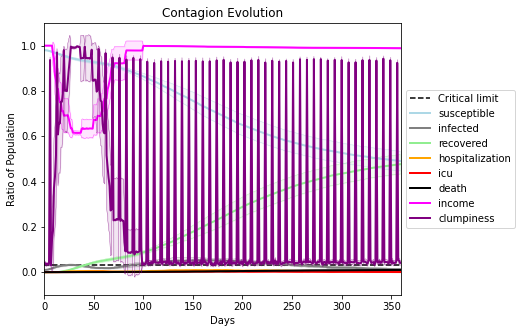

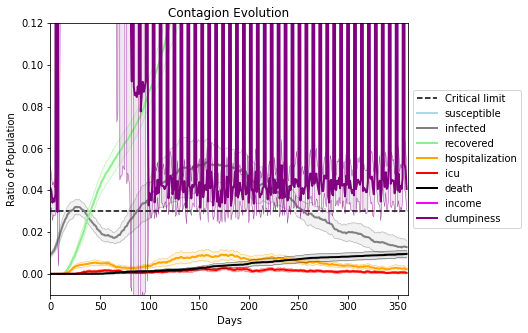

In [32]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[792, 8917, 706, 2757, 7773, 1103, 8203, 4196, 4958, 4859, 5764, 670, 4535, 5726, 9404, 4563, 3628, 7235, 813, 8174]
Average similarity between family members is 0.9110142812489194 at temperature -0.991
Average similarity between family and home is 0.9998506994150684 at temperature -1
Average similarity between students and their classroom is 0.5125712703791272 at temperature -0.991
Average classroom occupancy is 4.492753623188406 and number classrooms is 69
Average similarity between workers is 0.8374947275476418 at temperature -0.991
Average office occupancy is 3.238578680203046 and number offices is 197
Average friend similarity for adults: 0.8257956960795416 for kids: 0.658968529393184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.6567799178133715
avg restaurant similarity 0.11507585431985634
avg restaurant similarity 0.5313605086897801
avg restaurant similarity 0.5997873356750958
avg restaurant similarity 0.4950509895992272
avg restaurant similarity 0.3836543402587078
avg restaurant similarity 0.481762042185485
avg restaurant similarity 0.4496609697001253
avg restaurant similarity 0.4988794778446148
avg restaurant similarity 0.5800273742675467
avg restaurant similarity 0.49075513879784494
avg restaurant similarity 0.25575107764246363
avg restaurant similarity 0.5330557577488892
avg restaurant similarity 0.4958351065078822
avg restaurant similarity 0.4518745193111142
avg restaurant similarity 0.5742697084752854
avg restaurant similarity 0.37916093865183176
avg restaurant similarity 0.6565946431383446
avg restaurant similarity 0.4003223798184013
avg restaurant similarity 0.2694115474053103
avg restaurant similarity 0.4361827933843128
avg restaurant similarity 0.4489214258595486
avg res

avg restaurant similarity 0.5273943843150263
avg restaurant similarity 0.36654596688808316
avg restaurant similarity 0.1518040549655716
avg restaurant similarity 0.4641481398977555
avg restaurant similarity 0.35818755409178316
avg restaurant similarity 0.33872465586222045
avg restaurant similarity 0.5188214723711165
avg restaurant similarity 0.4515875786705392
avg restaurant similarity 0.4375616973391857
avg restaurant similarity 0.6057112632198911
avg restaurant similarity 0.09969559629008468
avg restaurant similarity 0.3566409758631481
avg restaurant similarity 0.6141052440287198
avg restaurant similarity 0.8247938318512323
avg restaurant similarity 0.8568009523167885
avg restaurant similarity 0.5896351082869808
avg restaurant similarity 0.5820464535786518
avg restaurant similarity 0.482328403056833
avg restaurant similarity 0.49469630306129353
avg restaurant similarity 0.5671721293306252
avg restaurant similarity 0.391439997935408
avg restaurant similarity 0.6594432873168183
avg res

avg restaurant similarity 0.3248323805898194
avg restaurant similarity 0.5195929300467299
avg restaurant similarity 0.6796735733461265
avg restaurant similarity 0.3877420805074271
avg restaurant similarity 0.37353484365739265
avg restaurant similarity 0.5419790243244581
avg restaurant similarity 0.3905841489919666
avg restaurant similarity 0.4996268490968493
avg restaurant similarity 0.24533564512384534
avg restaurant similarity 0.7383604966677733
avg restaurant similarity 0.33652603359383626
avg restaurant similarity 0.3790564611657937
avg restaurant similarity 0.1719554824609747
avg restaurant similarity 0.8392397756542844
avg restaurant similarity 0.3092659594233996
avg restaurant similarity 0.8704096248204419
avg restaurant similarity 0.7106862641471641
avg restaurant similarity 0.19926358889541593
avg restaurant similarity 0.7563875261349365
avg restaurant similarity 0.3660972539530902
avg restaurant similarity 0.521538751857899
avg restaurant similarity 0.5090370040693221
avg res

avg restaurant similarity 0.5471489670860167
avg restaurant similarity 0.4934072523017233
avg restaurant similarity 0.7603904273886746
avg restaurant similarity 0.48422039935543854
avg restaurant similarity 0.05993333526199954
avg restaurant similarity 0.43809566659854815
avg restaurant similarity 0.46059951426811285
avg restaurant similarity 0.39309865610761957
avg restaurant similarity 0.2564977204866735
avg restaurant similarity 0.46981667652205916
avg restaurant similarity 0.583028389498785
avg restaurant similarity 0.4901355756684814
avg restaurant similarity 0.3172046950525186
avg restaurant similarity 0.8792362768564048
avg restaurant similarity 0.5732690072819828
avg restaurant similarity 0.8347928602480699
avg restaurant similarity 0.4717265985618685
avg restaurant similarity 0.7131437250331301
avg restaurant similarity 0.17022163197806436
avg restaurant similarity 0.17022163197806436
avg restaurant similarity 0.5658616506331118
avg restaurant similarity 0.4300129642332542
avg

avg restaurant similarity 0.4016246785413147
avg restaurant similarity 0.41094143566770436
Average similarity between family members is 0.9205256035634164 at temperature -0.991
Average similarity between family and home is 0.999857233335827 at temperature -1
Average similarity between students and their classroom is 0.5093094944262515 at temperature -0.991
Average classroom occupancy is 4.056338028169014 and number classrooms is 71
Average similarity between workers is 0.8400776152334691 at temperature -0.991
Average office occupancy is 3.5 and number offices is 188
Average friend similarity for adults: 0.8486671703420303 for kids: 0.6678342883930124
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a to

avg restaurant similarity 0.5605494620459749
avg restaurant similarity 0.5671813517022833
avg restaurant similarity 0.7099188057853737
avg restaurant similarity 0.8143469510586355
avg restaurant similarity 0.4301183150441945
avg restaurant similarity 0.433439314120132
avg restaurant similarity 0.47746654783047116
avg restaurant similarity 0.5472923881722493
avg restaurant similarity 0.45015932412718573
avg restaurant similarity 0.2679475558961916
avg restaurant similarity 0.6210440741562746
avg restaurant similarity 0.5967191802877747
avg restaurant similarity 0.5508420700137123
avg restaurant similarity 0.9994408811060995
avg restaurant similarity 0.31268062398212004
avg restaurant similarity 0.3163297236096673
avg restaurant similarity 0.999308352532368
avg restaurant similarity 0.3380860393944526
avg restaurant similarity 0.3341005747054818
avg restaurant similarity 0.5645058257198989
avg restaurant similarity 0.7115062708568436
avg restaurant similarity 0.738071110776581
avg restau

avg restaurant similarity 0.06401046472737967
avg restaurant similarity 0.678943519228243
avg restaurant similarity 0.49822200099224556
avg restaurant similarity 0.5608078214109278
avg restaurant similarity 0.6567862784274396
avg restaurant similarity 0.6330394223490986
avg restaurant similarity 0.39377036479905336
avg restaurant similarity 0.37981337270966214
avg restaurant similarity 0.45282212548665696
avg restaurant similarity 0.34708000188663224
avg restaurant similarity 0.9993929723770392
avg restaurant similarity 0.340189317887731
avg restaurant similarity 0.34350804614203384
avg restaurant similarity 0.4494933581397443
avg restaurant similarity 0.2611845276295847
avg restaurant similarity 0.6459884007723103
avg restaurant similarity 0.4213614535833077
avg restaurant similarity 0.5153191602830461
avg restaurant similarity 0.49828195731154856
avg restaurant similarity 0.926814073315186
avg restaurant similarity 0.42972084619329465
avg restaurant similarity 0.46760674348769615
avg

avg restaurant similarity 0.7684304228000246
avg restaurant similarity 0.43501186996999436
avg restaurant similarity 0.38284826998533794
avg restaurant similarity 0.3781331981143566
avg restaurant similarity 0.2238833127941978
avg restaurant similarity 0.5743457856300959
avg restaurant similarity 0.4820470572636902
avg restaurant similarity 0.7760202790883751
avg restaurant similarity 0.5985220275421893
avg restaurant similarity 0.6063838992174613
avg restaurant similarity 0.5448581543961328
avg restaurant similarity 0.437924422426994
avg restaurant similarity 0.22637517769119975
avg restaurant similarity 0.5246743324124441
avg restaurant similarity 0.4583242789507955
avg restaurant similarity 0.4587718226566545
avg restaurant similarity 0.5414686316207815
avg restaurant similarity 0.42672100502540805
avg restaurant similarity 0.379855398354658
avg restaurant similarity 0.7721881662936443
avg restaurant similarity 0.6300644338545369
avg restaurant similarity 0.5459983993096335
avg rest

avg restaurant similarity 0.36620104063171105
avg restaurant similarity 0.5927120028358999
avg restaurant similarity 0.3958232515777701
avg restaurant similarity 0.4761803341873654
avg restaurant similarity 0.45082931076261257
avg restaurant similarity 0.260503584609424
avg restaurant similarity 0.21937952918244696
avg restaurant similarity 0.34856345843836123
avg restaurant similarity 0.5672801049664253
avg restaurant similarity 0.6625491697880768
avg restaurant similarity 0.5009121459784193
avg restaurant similarity 0.6055964026629106
avg restaurant similarity 0.4268763550636299
avg restaurant similarity 0.4437842652783074
avg restaurant similarity 0.570799093452788
avg restaurant similarity 0.48799149171129397
avg restaurant similarity 0.2205331031277021
avg restaurant similarity 0.5700197771672927
avg restaurant similarity 0.9994296141420256
avg restaurant similarity 0.734921503639422
avg restaurant similarity 0.4242880316798736
avg restaurant similarity 0.6088960583760687
avg rest

avg restaurant similarity 0.8057005680053377
avg restaurant similarity 0.5417374250995662
avg restaurant similarity 0.5039072187492701
avg restaurant similarity 0.41708336420048353
avg restaurant similarity 0.3854570187902765
avg restaurant similarity 0.7110355147842491
avg restaurant similarity 0.9994925672534707
avg restaurant similarity 0.9997196100646488
avg restaurant similarity 0.38268170236490257
avg restaurant similarity 0.5964825784866759
avg restaurant similarity 0.9998777890013111
avg restaurant similarity 0.46583760439428057
avg restaurant similarity 0.3735064291790696
avg restaurant similarity 0.6464344339259998
avg restaurant similarity 0.42376432274505854
avg restaurant similarity 0.36987531333451473
avg restaurant similarity 0.4411665048423816
avg restaurant similarity 0.8556797435730878
avg restaurant similarity 0.3568526009990583
avg restaurant similarity 0.7063382913334898
avg restaurant similarity 0.9494149237863477
avg restaurant similarity 0.3457753017408847
avg r

avg restaurant similarity 0.6062053817748957
avg restaurant similarity 0.6765744230714386
avg restaurant similarity 0.3519059675711228
avg restaurant similarity 0.36292795433096114
avg restaurant similarity 0.3406794909549762
avg restaurant similarity 0.9998796311297975
avg restaurant similarity 0.5459116733407862
avg restaurant similarity 0.6646055536248426
avg restaurant similarity 0.557766069596216
avg restaurant similarity 0.5002817901751199
avg restaurant similarity 0.6847720238431398
avg restaurant similarity 0.3349510587021104
avg restaurant similarity 0.49588442380498465
avg restaurant similarity 0.9998603064734046
avg restaurant similarity 0.7196804474259897
avg restaurant similarity 0.7528479628308447
avg restaurant similarity 0.5865460281381212
avg restaurant similarity 0.5544419814841306
avg restaurant similarity 0.6940125139551092
avg restaurant similarity 0.3419187716382349
avg restaurant similarity 0.4283182886456068
avg restaurant similarity 0.4691627466517768
avg resta

avg restaurant similarity 0.4209832072007438
avg restaurant similarity 0.9996223098084883
avg restaurant similarity 0.9998503208061027
avg restaurant similarity 0.5257147561227452
avg restaurant similarity 0.4852081141023772
avg restaurant similarity 0.5828984330318806
avg restaurant similarity 0.3496887594574998
avg restaurant similarity 0.5500077711941144
avg restaurant similarity 0.8600913028215861
avg restaurant similarity 0.5873222323724097
avg restaurant similarity 0.41719471611883213
avg restaurant similarity 0.32880871996102784
avg restaurant similarity 0.3959872344361379
avg restaurant similarity 0.5125869425195066
avg restaurant similarity 0.39965006752073495
avg restaurant similarity 0.7832059741170497
avg restaurant similarity 0.8511298698337839
avg restaurant similarity 0.26838205922854214
avg restaurant similarity 0.690762900678108
avg restaurant similarity 0.3131247258294178
avg restaurant similarity 0.48736180935229395
avg restaurant similarity 0.3633004776327717
Averag

avg restaurant similarity 0.6404766652471797
avg restaurant similarity 0.510667947333
avg restaurant similarity 0.1761000068331663
avg restaurant similarity 0.2879735817367587
avg restaurant similarity 0.6873164835526663
avg restaurant similarity 0.5932801008710415
avg restaurant similarity 0.36073846953425115
avg restaurant similarity 0.43308285175215916
avg restaurant similarity 0.3941789051897655
avg restaurant similarity 0.2661979317944609
avg restaurant similarity 0.8314246888183532
avg restaurant similarity 0.5253459021218363
avg restaurant similarity 0.3243621220815393
avg restaurant similarity 0.3692315115133164
avg restaurant similarity 0.32945526027423994
avg restaurant similarity 0.7626043060038035
avg restaurant similarity 0.5224491175536052
avg restaurant similarity 0.5245076806392943
avg restaurant similarity 0.3773569000699454
avg restaurant similarity 0.2897895883866314
avg restaurant similarity 0.3001573080070523
avg restaurant similarity 0.5480183595357355
avg restaur

avg restaurant similarity 0.9995318753520082
avg restaurant similarity 0.89326657019918
avg restaurant similarity 0.4702569349881074
avg restaurant similarity 0.8741659230555611
avg restaurant similarity 0.46355057720163007
avg restaurant similarity 0.4720429809511386
avg restaurant similarity 0.3733334293734799
avg restaurant similarity 0.375971915810514
avg restaurant similarity 0.4928316378856259
avg restaurant similarity 0.2369291831900525
avg restaurant similarity 0.6718262544327679
avg restaurant similarity 0.45338959434136616
avg restaurant similarity 0.5121925019541766
avg restaurant similarity 0.4813027304383031
avg restaurant similarity 0.44817102908391904
avg restaurant similarity 0.48370062851262835
avg restaurant similarity 0.40718251929608956
avg restaurant similarity 0.5609077252079215
avg restaurant similarity 0.49777962609786125
avg restaurant similarity 0.4846697476817846
avg restaurant similarity 0.7638094787363738
avg restaurant similarity 0.6768530746648589
avg res

avg restaurant similarity 0.6271950911943376
avg restaurant similarity 0.43940703498858286
avg restaurant similarity 0.6077783765152525
avg restaurant similarity 0.491910433716856
avg restaurant similarity 0.3870519130780869
avg restaurant similarity 0.8480901786279973
avg restaurant similarity 0.5236511383032676
avg restaurant similarity 0.44012860618844757
avg restaurant similarity 0.4134718261165908
avg restaurant similarity 0.41248051464641383
avg restaurant similarity 0.26036991636911605
avg restaurant similarity 0.5236511383032676
avg restaurant similarity 0.5800655299538386
avg restaurant similarity 0.8941951157544583
avg restaurant similarity 0.35358498490892265
avg restaurant similarity 0.32547572986090684
avg restaurant similarity 0.45956533254598314
avg restaurant similarity 0.6370173798391643
avg restaurant similarity 0.4479054348304278
avg restaurant similarity 0.34441810220371155
avg restaurant similarity 0.47549595841741027
avg restaurant similarity 0.7272521209142924
av

Average similarity between workers is 0.8339903152310973 at temperature -0.991
Average office occupancy is 3.4607329842931938 and number offices is 191
Average friend similarity for adults: 0.8379522233808682 for kids: 0.6644785438641764
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5692853180919322
avg restaurant similarity 0.5938977590892531
avg restaurant similarity 0.44705798878418634
avg restaurant similarity 0.6144445544012328
avg restaurant similarity 0.27042132540901354
avg restaurant similarity 0.6879305458936801
avg restaurant similarity 0.6952091015557524
avg restaurant similarity 0.46736660894875615
avg restaurant similarity 0.3317169274526529
avg restaurant similarity 0.5124812248206893
avg restaurant similarity 0.6382623276725137
avg restaurant similarity 0.2879048255514613
avg restaurant similarity 0.5769324227881909
avg restaurant similarity 0.24567324170146013
avg restaurant similarity 0.5133142091475031
avg restaurant similarity 0.8885172019484106
avg restaurant similarity 0.34308124372372567
avg restaurant similarity 0.4722835619341277
avg restaurant similarity 0.7647643624385942
avg restaurant similarity 0.1897579080372126
avg restaurant similarity 0.518044556579824
avg restaurant similarity 0.7492064991626233
avg re

avg restaurant similarity 0.3710216516778064
avg restaurant similarity 0.6097932940453407
avg restaurant similarity 0.5880083618818678
avg restaurant similarity 0.5433097024227787
avg restaurant similarity 0.5995368493957461
avg restaurant similarity 0.48576366805471144
avg restaurant similarity 0.3893630469036956
avg restaurant similarity 0.2677675787495765
avg restaurant similarity 0.4968700586469338
avg restaurant similarity 0.41318452010591994
avg restaurant similarity 0.7216542436929718
avg restaurant similarity 0.33139959222317106
Average similarity between family members is 0.9187351942150119 at temperature -0.991
Average similarity between family and home is 0.9998558874311319 at temperature -1
Average similarity between students and their classroom is 0.5251061773390531 at temperature -0.991
Average classroom occupancy is 4.1 and number classrooms is 70
Average similarity between workers is 0.8386740391908777 at temperature -0.991
Average office occupancy is 3.364102564102564 

avg restaurant similarity 0.5214805410317951
avg restaurant similarity 0.39468820486250544
avg restaurant similarity 0.34681722820467353
avg restaurant similarity 0.6406708053847421
avg restaurant similarity 0.999830959518917
avg restaurant similarity 0.5186552689030807
avg restaurant similarity 0.5225825115672251
avg restaurant similarity 0.5977044452149447
avg restaurant similarity 0.45687007312155553
avg restaurant similarity 0.6055126798385927
avg restaurant similarity 0.4549690329113135
avg restaurant similarity 0.9999100924896457
avg restaurant similarity 0.5099454975071164
avg restaurant similarity 0.7152549007964801
avg restaurant similarity 0.44984646938829953
avg restaurant similarity 0.40519855803474875
avg restaurant similarity 0.4663995781274294
avg restaurant similarity 0.3872840240259396
avg restaurant similarity 0.3745569654528773
avg restaurant similarity 0.5364410950216011
avg restaurant similarity 0.2455865022898044
avg restaurant similarity 0.7772155900162032
avg re

avg restaurant similarity 0.5126417612319305
avg restaurant similarity 0.5917680305325246
avg restaurant similarity 0.5053871449391163
avg restaurant similarity 0.5127324107545436
avg restaurant similarity 0.4695375021317335
avg restaurant similarity 0.47806730569101696
avg restaurant similarity 0.7548558893525837
avg restaurant similarity 0.4539825153510915
avg restaurant similarity 0.46278115254829794
avg restaurant similarity 0.564621889981989
avg restaurant similarity 0.5375342875905591
avg restaurant similarity 0.5917680305325246
avg restaurant similarity 0.5297056317907256
avg restaurant similarity 0.5769209150834602
avg restaurant similarity 0.35190028743714447
avg restaurant similarity 0.42265546874483684
avg restaurant similarity 0.6165181826434507
avg restaurant similarity 0.5259887274322824
avg restaurant similarity 0.47806730569101696
avg restaurant similarity 0.40777155367223206
avg restaurant similarity 0.4279357160607786
avg restaurant similarity 0.5042617234883786
avg r

avg restaurant similarity 0.7008658134538763
avg restaurant similarity 0.4992666229144155
avg restaurant similarity 0.4995396735753872
avg restaurant similarity 0.47277374411431916
avg restaurant similarity 0.28915381912779203
avg restaurant similarity 0.9999372207114244
avg restaurant similarity 0.5060688843485066
avg restaurant similarity 0.7071202444441269
avg restaurant similarity 0.68722717216011
avg restaurant similarity 0.7553287590184424
avg restaurant similarity 0.3525942406159353
avg restaurant similarity 0.45181867623334715
avg restaurant similarity 0.5545272005966311
avg restaurant similarity 0.9996583907018922
avg restaurant similarity 0.5229454426497302
avg restaurant similarity 0.4359332508186951
avg restaurant similarity 0.8199702936861568
avg restaurant similarity 0.5303269252879745
avg restaurant similarity 0.21014586878522637
avg restaurant similarity 0.39454693391242346
avg restaurant similarity 0.38890359275839664
avg restaurant similarity 0.9998568526335195
avg re

avg restaurant similarity 0.4118633865072805
avg restaurant similarity 0.8832963806776003
avg restaurant similarity 0.8460410960493696
avg restaurant similarity 0.4869282817555419
avg restaurant similarity 0.5006345632293017
avg restaurant similarity 0.5649777923204042
avg restaurant similarity 0.4659152381548982
avg restaurant similarity 0.7568691126112241
avg restaurant similarity 0.6145120601036425
avg restaurant similarity 0.6396351180139238
avg restaurant similarity 0.31132767338559164
avg restaurant similarity 0.6336610139470255
avg restaurant similarity 0.41749366774524854
avg restaurant similarity 0.643438253725584
avg restaurant similarity 0.6691916237379184
avg restaurant similarity 0.715891106707081
avg restaurant similarity 0.9996565188678139
avg restaurant similarity 0.5095881004339382
avg restaurant similarity 0.8463836197862817
avg restaurant similarity 0.4657961630424051
avg restaurant similarity 0.6981815014873782
avg restaurant similarity 0.4611872947834707
avg restau

avg restaurant similarity 0.5127348720235448
avg restaurant similarity 0.503023488390741
avg restaurant similarity 0.6884554279576356
avg restaurant similarity 0.5446340565290658
avg restaurant similarity 0.3771861162048878
avg restaurant similarity 0.38010527716946124
avg restaurant similarity 0.7854557541012993
avg restaurant similarity 0.6807715605570764
avg restaurant similarity 0.7070599432213251
avg restaurant similarity 0.6454584298371681
avg restaurant similarity 0.40331448698957373
avg restaurant similarity 0.2889528150548523
avg restaurant similarity 0.47178854409964815
avg restaurant similarity 0.8871847118374674
avg restaurant similarity 0.6189045478524381
avg restaurant similarity 0.9998990769612381
avg restaurant similarity 0.6501497676471283
avg restaurant similarity 0.29808986955116457
avg restaurant similarity 0.434397713050648
avg restaurant similarity 0.5692037824908189
avg restaurant similarity 0.6707215437935137
avg restaurant similarity 0.7065009077290203
avg rest

Average similarity between workers is 0.8374529579705213 at temperature -0.991
Average office occupancy is 3.247422680412371 and number offices is 194
Average friend similarity for adults: 0.831314440331953 for kids: 0.6529003151878471
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.5277907442655823
avg restaurant similarity 0.440966289388415
avg restaurant similarity 0.5409504358085155
avg restaurant similarity 0.6439486189528308
avg restaurant similarity 0.5603689955356651
avg restaurant similarity 0.5442387592875009
avg restaurant similarity 0.34990834789480063
avg restaurant similarity 0.4212303838470186
avg restaurant similarity 0.39248578794343697
avg restaurant similarity 0.6200925539812441
avg restaurant similarity 0.39248578794343697
avg restaurant similarity 0.47000999510786273
avg restaurant similarity 0.5701763122550533
avg restaurant similarity 0.354125426827006
avg restaurant similarity 0.39074838334926754
avg restaurant similarity 0.392344538070089
avg restaurant similarity 0.48079146111009774
avg restaurant similarity 0.4319969215917043
avg restaurant similarity 0.5255669045911905
avg restaurant similarity 0.6439486189528308
avg restaurant similarity 0.8217681091192075
avg restaurant similarity 0.5352693236265663
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

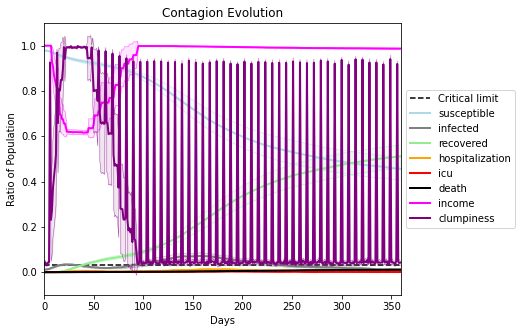

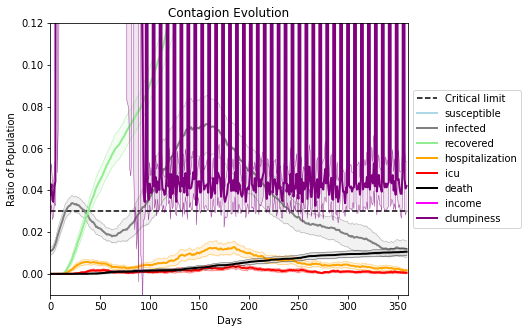

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4547, 2703, 903, 2883, 718, 5840, 2424, 6505, 4815, 8278, 8179, 3615, 1717, 5618, 7277, 9780, 5558, 3268, 1710, 2705]
Average similarity between family members is 0.9022981727464932 at temperature -0.99
Average similarity between family and home is 0.9998523569598476 at temperature -1
Average similarity between students and their classroom is 0.4800562151390914 at temperature -0.99
Average classroom occupancy is 4.3768115942028984 and number classrooms is 69
Average similarity between workers is 0.8264307808836632 at temperature -0.99
Average office occupancy is 3.288659793814433 and number offices is 194
Average friend similarity for adults: 0.8315049868712571 for kids: 0.6551734901660218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.39316739670012246
avg restaurant similarity 0.5388764419634764
avg restaurant similarity 0.5544157408213555
avg restaurant similarity 0.5029013476042699
avg restaurant similarity 0.450057624779983
avg restaurant similarity 0.6130366050405778
avg restaurant similarity 0.34843889259773186
avg restaurant similarity 0.6432769154098914
avg restaurant similarity 0.450057624779983
avg restaurant similarity 0.41568545858322764
avg restaurant similarity 0.4653006842450776
avg restaurant similarity 0.9995520963383846
avg restaurant similarity 0.9997233343940672
avg restaurant similarity 0.44027743886145215
avg restaurant similarity 0.19040074972076795
avg restaurant similarity 0.5226611457926521
avg restaurant similarity 0.44494696286920515
avg restaurant similarity 0.41710998577277725
avg restaurant similarity 0.30782149343286097
avg restaurant similarity 0.2884601729544411
avg restaurant similarity 0.450057624779983
avg restaurant similarity 0.8659519953186368
avg r

avg restaurant similarity 0.42812138626433266
avg restaurant similarity 0.6483466788015003
avg restaurant similarity 0.8877791606245988
avg restaurant similarity 0.5822413995950384
avg restaurant similarity 0.5158015584457107
avg restaurant similarity 0.5130588297981663
avg restaurant similarity 0.42431791562196997
avg restaurant similarity 0.6257055492157388
avg restaurant similarity 0.3597061219343252
avg restaurant similarity 0.42431791562196997
avg restaurant similarity 0.6869448373583394
avg restaurant similarity 0.9221072333390197
avg restaurant similarity 0.6933560845646545
avg restaurant similarity 0.6910028846516993
avg restaurant similarity 0.6844702949228363
avg restaurant similarity 0.4488678426702617
avg restaurant similarity 0.9267623882642384
avg restaurant similarity 0.8412081551948603
avg restaurant similarity 0.3762852903600611
avg restaurant similarity 0.40174899351195165
avg restaurant similarity 0.7595629364251513
avg restaurant similarity 0.32482254698824203
avg r

avg restaurant similarity 0.3506037528378375
avg restaurant similarity 0.7926318349320681
avg restaurant similarity 0.6035566079867688
avg restaurant similarity 0.53512979334522
avg restaurant similarity 0.47579126717643866
avg restaurant similarity 0.45056365635738327
avg restaurant similarity 0.4061591598310441
avg restaurant similarity 0.8149825490470819
avg restaurant similarity 0.4021878630397542
avg restaurant similarity 0.17446392463626265
avg restaurant similarity 0.11801683872888635
avg restaurant similarity 0.47356285125000286
avg restaurant similarity 0.5913795393482701
avg restaurant similarity 0.2903278105070449
avg restaurant similarity 0.6149520810534906
avg restaurant similarity 0.3825610393783775
avg restaurant similarity 0.41647436372760716
avg restaurant similarity 0.5740944847684033
avg restaurant similarity 0.35927131559085657
avg restaurant similarity 0.28979809321503874
avg restaurant similarity 0.6303373504591375
avg restaurant similarity 0.6183307229989493
avg 

avg restaurant similarity 0.8038268991120984
avg restaurant similarity 0.7286939214003904
avg restaurant similarity 0.3696942644216874
Average similarity between family members is 0.9063953767226791 at temperature -0.99
Average similarity between family and home is 0.9998725681551209 at temperature -1
Average similarity between students and their classroom is 0.4823081202438709 at temperature -0.99
Average classroom occupancy is 3.985294117647059 and number classrooms is 68
Average similarity between workers is 0.8241330708738563 at temperature -0.99
Average office occupancy is 3.5025641025641026 and number offices is 195
Average friend similarity for adults: 0.8368857159591833 for kids: 0.6429217111765723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.49585215256155635
avg restaurant similarity 0.5019396095605578
avg restaurant similarity 0.450964467300466
avg restaurant similarity 0.9370347333256578
avg restaurant similarity 0.26410705859796346
avg restaurant similarity 0.8105271184092152
avg restaurant similarity 0.5424365975388463
avg restaurant similarity 0.5448528120836458
avg restaurant similarity 0.4034688153347194
avg restaurant similarity 0.6261810233158913
avg restaurant similarity 0.4555142718072015
avg restaurant similarity 0.3928144886310094
avg restaurant similarity 0.5017867781205515
avg restaurant similarity 0.24009486689783766
avg restaurant similarity 0.5215387655845632
avg restaurant similarity 0.5390394493056765
avg restaurant similarity 0.3911684391908148
avg restaurant similarity 0.4750416846004281
avg restaurant similarity 0.34645374766262216
avg restaurant similarity 0.3208442388836025
avg restaurant similarity 0.2414680171130381
avg restaurant similarity 0.44723780332603313
avg re

avg restaurant similarity 0.4360805002618289
avg restaurant similarity 0.35056614548607873
avg restaurant similarity 0.513264798448926
avg restaurant similarity 0.6581179949585948
avg restaurant similarity 0.5271961209442739
avg restaurant similarity 0.8662985105083827
avg restaurant similarity 0.32883701892984213
avg restaurant similarity 0.43657575043832914
avg restaurant similarity 0.31803481006546497
avg restaurant similarity 0.25400838704794965
avg restaurant similarity 0.3863279653719246
avg restaurant similarity 0.6467579047920253
avg restaurant similarity 0.6808836013812205
avg restaurant similarity 0.5369229620052167
avg restaurant similarity 0.2870106885270636
avg restaurant similarity 0.3585753715725181
avg restaurant similarity 0.6173654611163589
avg restaurant similarity 0.46543878155845453
avg restaurant similarity 0.583564239510378
avg restaurant similarity 0.4217991631459692
avg restaurant similarity 0.4533520661486864
avg restaurant similarity 0.4736895786150106
avg re

avg restaurant similarity 0.3967120384466632
avg restaurant similarity 0.47930613331017446
avg restaurant similarity 0.6354315633754976
avg restaurant similarity 0.49886307355610277
avg restaurant similarity 0.4072541755966449
avg restaurant similarity 0.7633486287265621
avg restaurant similarity 0.3237493782888875
avg restaurant similarity 0.6220975967287927
avg restaurant similarity 0.11989267479370103
avg restaurant similarity 0.3196097034108823
avg restaurant similarity 0.5090907967206431
avg restaurant similarity 0.48538859210109325
avg restaurant similarity 0.3237493782888875
avg restaurant similarity 0.37174508906614523
avg restaurant similarity 0.6386077403390169
avg restaurant similarity 0.5518455179180598
avg restaurant similarity 0.3683063603037974
avg restaurant similarity 0.4919640725423857
avg restaurant similarity 0.40200959869828773
avg restaurant similarity 0.7517635982556568
avg restaurant similarity 0.46614986648120266
avg restaurant similarity 0.6428583776080076
avg

Average friend similarity for adults: 0.8362755563490154 for kids: 0.6555522787214996
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.5557849648254315
avg restaurant similarity 0.44989688267651784
avg restaurant similarity 0.3334677991372439
avg restaurant similarity 0.4734096231145326
avg restaurant similarity 0.2286377249513233
avg restaurant similarity 0.2549865735583998
avg restaurant similarity 0.4855132418090083
avg restaurant similarity 0.2878317659430293
avg restaurant similarity 0.5295809436684203
avg restaurant similarity 0.34827867543933877
avg restaurant similarity 0.23351493247776578
avg restaurant similarity 0.3185038234393106
avg restaurant similarity 0.39349839319767416
avg restaurant similarity 0.35194699203069413
avg restaurant similarity 0.32287704812929396
avg restaurant similarity 0.3815452680450193
avg restaurant similarity 0.4855132418090083
avg restaurant similarity 0.34905605200603634
avg restaurant similarity 0.5794412773006101
avg restaurant similarity 0.6502953655154503
avg restaurant similarity 0.5748890279970313
avg restaurant similarity 0.32747971600124426
av

avg restaurant similarity 0.5208009654763277
avg restaurant similarity 0.7825458605038944
avg restaurant similarity 0.999923711532843
avg restaurant similarity 0.2279133973246934
avg restaurant similarity 0.44724040436269763
avg restaurant similarity 0.32568760299587024
avg restaurant similarity 0.3631222586945822
avg restaurant similarity 0.1557806129001761
avg restaurant similarity 0.3469664450170365
avg restaurant similarity 0.46901441168762703
avg restaurant similarity 0.39042714600014206
avg restaurant similarity 0.3095741243581094
avg restaurant similarity 0.7546697878208624
avg restaurant similarity 0.6288092741857682
avg restaurant similarity 0.8789228357109893
avg restaurant similarity 0.4504584360801819
avg restaurant similarity 0.8788611342279835
avg restaurant similarity 0.514986743118657
avg restaurant similarity 0.9999235675850934
avg restaurant similarity 0.18710586717196137
avg restaurant similarity 0.264074538146712
avg restaurant similarity 0.31008928916475853
avg res

avg restaurant similarity 0.5049695624787711
avg restaurant similarity 0.2505715665468369
avg restaurant similarity 0.22714284871392873
avg restaurant similarity 0.3668426343372804
avg restaurant similarity 0.3284885732191789
avg restaurant similarity 0.37522520594230296
avg restaurant similarity 0.22084572518494547
avg restaurant similarity 0.2816780749304053
avg restaurant similarity 0.42400805174876366
avg restaurant similarity 0.09567462946473965
avg restaurant similarity 0.3008476297956125
avg restaurant similarity 0.36791963378338366
avg restaurant similarity 0.718939270624432
avg restaurant similarity 0.2421303182776216
avg restaurant similarity 0.35041244226699486
avg restaurant similarity 0.2816780749304053
avg restaurant similarity 0.30946011181092986
avg restaurant similarity 0.6428093748535056
avg restaurant similarity 0.368319623285572
avg restaurant similarity 0.3116166639114493
avg restaurant similarity 0.36293040600899495
avg restaurant similarity 0.5560502677970883
avg

avg restaurant similarity 0.7053788770127316
avg restaurant similarity 0.25453376097372227
avg restaurant similarity 0.4946530982948433
avg restaurant similarity 0.39237252237107567
avg restaurant similarity 0.5170812056102292
avg restaurant similarity 0.4326594916070672
avg restaurant similarity 0.31492143554714824
avg restaurant similarity 0.3841353544723504
avg restaurant similarity 0.33291953645422157
avg restaurant similarity 0.455809943564003
avg restaurant similarity 0.43700152506062256
avg restaurant similarity 0.4365955246667411
avg restaurant similarity 0.3262946270220064
avg restaurant similarity 0.44772619720128454
avg restaurant similarity 0.31680757987889036
avg restaurant similarity 0.6144283791280903
avg restaurant similarity 0.39880107488277516
avg restaurant similarity 0.4490550120604715
avg restaurant similarity 0.5334527008397555
avg restaurant similarity 0.3811256953201393
avg restaurant similarity 0.4907621889935026
avg restaurant similarity 0.31755132635858874
av

avg restaurant similarity 0.7869491297873868
avg restaurant similarity 0.7697336831404737
avg restaurant similarity 0.6497779635085955
avg restaurant similarity 0.6749356839294761
avg restaurant similarity 0.35647836670742344
avg restaurant similarity 0.13112819016729055
avg restaurant similarity 0.2814920994247756
avg restaurant similarity 0.5136407638839243
avg restaurant similarity 0.5055623317032043
avg restaurant similarity 0.8282456281798143
avg restaurant similarity 0.5621863719286767
avg restaurant similarity 0.47915702013431627
avg restaurant similarity 0.38466280119319296
avg restaurant similarity 0.49017667741800414
avg restaurant similarity 0.47951714918707633
avg restaurant similarity 0.31422970562341557
avg restaurant similarity 0.6109913771455384
avg restaurant similarity 0.18089468872568265
avg restaurant similarity 0.5861206535000507
avg restaurant similarity 0.8778635323204578
avg restaurant similarity 0.5431578690428731
avg restaurant similarity 0.5136407638839243
av

avg restaurant similarity 0.5100218629836332
avg restaurant similarity 0.6350208223809384
avg restaurant similarity 0.5046526490280748
avg restaurant similarity 0.6099076929687256
avg restaurant similarity 0.399019925831989
avg restaurant similarity 0.3036152174301476
avg restaurant similarity 0.4114433570455517
avg restaurant similarity 0.5604133357194321
avg restaurant similarity 0.7940200928615346
avg restaurant similarity 0.6680409960863911
avg restaurant similarity 0.566185829521356
avg restaurant similarity 0.6332669572746019
avg restaurant similarity 0.999725260533441
avg restaurant similarity 0.43846928267963053
avg restaurant similarity 0.566185829521356
avg restaurant similarity 0.43131323206043193
avg restaurant similarity 0.45605253272635987
avg restaurant similarity 0.4097172299834432
avg restaurant similarity 0.28783184970004855
avg restaurant similarity 0.5553561999357157
avg restaurant similarity 0.5126584641839127
avg restaurant similarity 0.5752924998261226
avg restau

avg restaurant similarity 0.49683293268216977
avg restaurant similarity 0.999725260533441
avg restaurant similarity 0.795676126774566
avg restaurant similarity 0.4650996155689045
avg restaurant similarity 0.43613728573810606
avg restaurant similarity 0.5242031877798898
Average similarity between family members is 0.9024652111939252 at temperature -0.99
Average similarity between family and home is 0.9998489713471651 at temperature -1
Average similarity between students and their classroom is 0.49214214630247916 at temperature -0.99
Average classroom occupancy is 4.0588235294117645 and number classrooms is 68
Average similarity between workers is 0.8237920205505933 at temperature -0.99
Average office occupancy is 3.4278350515463916 and number offices is 194
Average friend similarity for adults: 0.8293350905511528 for kids: 0.6481597247232356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a tot

avg restaurant similarity 0.8276558123651403
avg restaurant similarity 0.8276558123651403
avg restaurant similarity 0.552125408343291
avg restaurant similarity 0.35480405685263955
avg restaurant similarity 0.6417095475051793
avg restaurant similarity 0.3680710012487483
avg restaurant similarity 0.3643907644142804
avg restaurant similarity 0.6202468998013047
avg restaurant similarity 0.47548916971892013
avg restaurant similarity 0.3474168529309375
avg restaurant similarity 0.42165136177389273
avg restaurant similarity 0.44597482456926185
avg restaurant similarity 0.2055631248962812
avg restaurant similarity 0.8276558123651403
avg restaurant similarity 0.540397055083975
avg restaurant similarity 0.26076436628382427
avg restaurant similarity 0.6671699753355114
avg restaurant similarity 0.766614920001581
avg restaurant similarity 0.8386044172293853
avg restaurant similarity 0.48328849877901847
avg restaurant similarity 0.44680138220897947
avg restaurant similarity 0.3032576308330695
avg re

avg restaurant similarity 0.5170534011346423
avg restaurant similarity 0.4819978149735422
avg restaurant similarity 0.28693150617769153
avg restaurant similarity 0.34860554521307024
avg restaurant similarity 0.4945746661772617
avg restaurant similarity 0.3761475164212299
avg restaurant similarity 0.28758760284807905
avg restaurant similarity 0.4990123881196614
avg restaurant similarity 0.37504066594583596
avg restaurant similarity 0.3681460915147281
avg restaurant similarity 0.38731158464794835
avg restaurant similarity 0.4279155919281303
avg restaurant similarity 0.38179462111121404
avg restaurant similarity 0.22125907753843727
avg restaurant similarity 0.6571367472198419
avg restaurant similarity 0.4144072425037174
avg restaurant similarity 0.6437879413530807
avg restaurant similarity 0.6416244930563081
avg restaurant similarity 0.7071236016160958
avg restaurant similarity 0.34181774054872904
avg restaurant similarity 0.34715465591945177
avg restaurant similarity 0.291402691916682
av

Average similarity between workers is 0.8234226306965347 at temperature -0.99
Average office occupancy is 3.5104166666666665 and number offices is 192
Average friend similarity for adults: 0.8399811420913836 for kids: 0.6577076365285089
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.5347093829924693
avg restaurant similarity 0.35165180497407467
avg restaurant similarity 0.5219197490792465
avg restaurant similarity 0.9998104796151384
avg restaurant similarity 0.29823431569852854
avg restaurant similarity 0.6218053905488271
avg restaurant similarity 0.34404824921871296
avg restaurant similarity 0.12586080009554956
avg restaurant similarity 0.5348314263902613
avg restaurant similarity 0.606057486884651
avg restaurant similarity 0.45257541329263207
avg restaurant similarity 0.4198808014717391
avg restaurant similarity 0.35790412975007435
avg restaurant similarity 0.12781266494354032
avg restaurant similarity 0.7456386138708364
avg restaurant similarity 0.5863499561531835
avg restaurant similarity 0.467828398165002
avg restaurant similarity 0.3892878960656028
avg restaurant similarity 0.5809676882376542
avg restaurant similarity 0.5868331676433673
avg restaurant similarity 0.467828398165002
avg restaurant similarity 0.41638224993513606
avg r

avg restaurant similarity 0.4539548702852926
avg restaurant similarity 0.4223467769971003
Average similarity between family members is 0.9029108140500564 at temperature -0.99
Average similarity between family and home is 0.9998546641798352 at temperature -1
Average similarity between students and their classroom is 0.4838143432543789 at temperature -0.99
Average classroom occupancy is 4.462686567164179 and number classrooms is 67
Average similarity between workers is 0.8179945783560033 at temperature -0.99
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8263386570867842 for kids: 0.6389122791109321
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.6425031439792854
avg restaurant similarity 0.39481821022357116
avg restaurant similarity 0.4378168664877622
avg restaurant similarity 0.3878707304354269
avg restaurant similarity 0.5187390596296708
avg restaurant similarity 0.7959824628022033
avg restaurant similarity 0.23795481774473082
avg restaurant similarity 0.8127376142491423
avg restaurant similarity 0.6585860842916849
avg restaurant similarity 0.4011425762322133
avg restaurant similarity 0.46547927485929885
avg restaurant similarity 0.3546548112743315
avg restaurant similarity 0.6566841626709261
avg restaurant similarity 0.5269637094526679
avg restaurant similarity 0.7237893857222868
avg restaurant similarity 0.3427957135789775
avg restaurant similarity 0.49140767137956937
avg restaurant similarity 0.7961728136351719
avg restaurant similarity 0.5992146400600203
avg restaurant similarity 0.4931480958707272
avg restaurant similarity 0.2785300229403002
avg restaurant similarity 0.49140767137956937
avg r

avg restaurant similarity 0.47024867513936974
avg restaurant similarity 0.8965770248458695
avg restaurant similarity 0.20176689864914527
avg restaurant similarity 0.30190427169381656
avg restaurant similarity 0.6888855917719519
avg restaurant similarity 0.4067434253064338
avg restaurant similarity 0.29872925460983857
avg restaurant similarity 0.41948870441685615
avg restaurant similarity 0.20176689864914527
avg restaurant similarity 0.4232137396097536
avg restaurant similarity 0.7421648222458869
avg restaurant similarity 0.26190316573034345
avg restaurant similarity 0.9998328906181526
avg restaurant similarity 0.71873398864848
avg restaurant similarity 0.49040814325086735
avg restaurant similarity 0.3342367881280439
avg restaurant similarity 0.5575325888335391
avg restaurant similarity 0.32274658513041
avg restaurant similarity 0.11780631633363059
avg restaurant similarity 0.4174791198584554
avg restaurant similarity 0.3458214748487987
avg restaurant similarity 0.5585068772624096
avg r

avg restaurant similarity 0.6007769667465526
avg restaurant similarity 0.5831521069410784
avg restaurant similarity 0.7787748055049446
avg restaurant similarity 0.4270396571319849
avg restaurant similarity 0.4162073018457987
avg restaurant similarity 0.7910279065273516
avg restaurant similarity 0.5701297265586833
avg restaurant similarity 0.7917657030330875
avg restaurant similarity 0.44422210378055194
avg restaurant similarity 0.361399413303817
avg restaurant similarity 0.514133240150549
avg restaurant similarity 0.3683189117591147
avg restaurant similarity 0.23240317212035105
avg restaurant similarity 0.5800314896699583
avg restaurant similarity 0.4980301966216263
avg restaurant similarity 0.7381108484877373
avg restaurant similarity 0.46734178042051167
avg restaurant similarity 0.3564732122788539
avg restaurant similarity 0.636664405437297
avg restaurant similarity 0.3700767954346717
avg restaurant similarity 0.3983554777261784
avg restaurant similarity 0.42001390860538007
avg resta

avg restaurant similarity 0.9998073152554774
avg restaurant similarity 0.30779502214134397
avg restaurant similarity 0.9198923421292062
avg restaurant similarity 0.426258384039388
avg restaurant similarity 0.49743426028090554
avg restaurant similarity 0.38830332424293
avg restaurant similarity 0.594633591457239
avg restaurant similarity 0.7592602035602389
avg restaurant similarity 0.5575517366503827
avg restaurant similarity 0.7993651011181784
avg restaurant similarity 0.48652549071635576
avg restaurant similarity 0.5333092035971587
avg restaurant similarity 0.6406776768241766
avg restaurant similarity 0.6470319353136188
avg restaurant similarity 0.6097512714979509
avg restaurant similarity 0.6604760393895382
avg restaurant similarity 0.6736958541984608
avg restaurant similarity 0.5100962038695183
avg restaurant similarity 0.542633578252432
avg restaurant similarity 0.5623361441966264
avg restaurant similarity 0.3587264608006251
avg restaurant similarity 0.36839192840498247
avg restaur

avg restaurant similarity 0.6097512714979509
avg restaurant similarity 0.5833306149766101
avg restaurant similarity 0.4774139942048166
Average similarity between family members is 0.9102642425670088 at temperature -0.99
Average similarity between family and home is 0.9998629471411543 at temperature -1
Average similarity between students and their classroom is 0.49119704181884183 at temperature -0.99
Average classroom occupancy is 4.085714285714285 and number classrooms is 70
Average similarity between workers is 0.8144653495352716 at temperature -0.99
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.8258241525866359 for kids: 0.6457273151191587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.36820800080601906
avg restaurant similarity 0.7341968094568805
avg restaurant similarity 0.497627122166204
avg restaurant similarity 0.374632096526468
avg restaurant similarity 0.7142128404089897
avg restaurant similarity 0.4263490134117284
avg restaurant similarity 0.5023616301827665
avg restaurant similarity 0.44301632900685994
avg restaurant similarity 0.42431296747894215
avg restaurant similarity 0.38113484671109
avg restaurant similarity 0.48363260641258976
avg restaurant similarity 0.9343382135481941
avg restaurant similarity 0.37787056974942534
avg restaurant similarity 0.37587555802285577
avg restaurant similarity 0.4700361444099975
avg restaurant similarity 0.5087693338162447
avg restaurant similarity 0.33787733543321863
avg restaurant similarity 0.5924442821712774
avg restaurant similarity 0.5713651553477362
avg restaurant similarity 0.5897851453053129
avg restaurant similarity 0.5278828064921928
avg restaurant similarity 0.48207724287322773
avg re

(<function dict.items>, <function dict.items>, <function dict.items>)

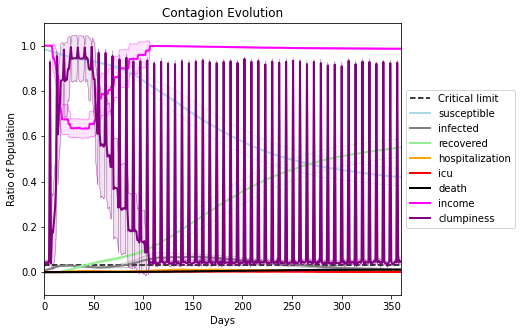

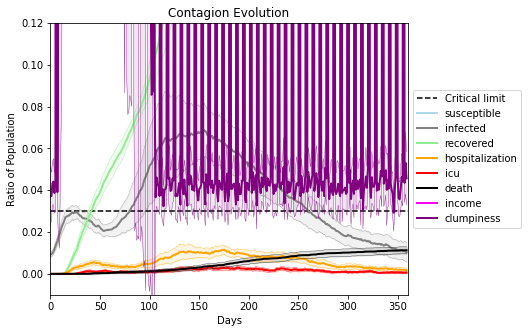

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[4742, 6608, 5780, 1070, 3985, 1520, 4789, 5755, 2451, 4394, 1316, 6286, 3055, 8953, 4226, 4686, 3969, 4769, 4839, 9784]
Average similarity between family members is 0.5520315464318107 at temperature -0.9
Average similarity between family and home is 0.9998739095204997 at temperature -1
Average similarity between students and their classroom is 0.18887991014960603 at temperature -0.9
Average classroom occupancy is 4.140845070422535 and number classrooms is 71
Average similarity between workers is 0.4673467251494478 at temperature -0.9
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.603868040970912 for kids: 0.45784489777962484
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.21516497743046142
avg restaurant similarity 0.532397105969667
avg restaurant similarity 0.0014670828081326803
avg restaurant similarity 0.09339984020636558
avg restaurant similarity -0.07694921757763044
avg restaurant similarity -0.15181764016690658
avg restaurant similarity 0.2368001773201746
avg restaurant similarity 0.09339984020636558
avg restaurant similarity 0.12645084962778794
avg restaurant similarity -0.16762520995160698
avg restaurant similarity 0.11711021234233093
avg restaurant similarity 0.3945071379415243
avg restaurant similarity 0.21280816026582539
avg restaurant similarity -0.06631736603483383
avg restaurant similarity -0.027820069718522557
avg restaurant similarity 0.14581245086713102
avg restaurant similarity 0.5159210961974535
avg restaurant similarity 0.4592849544844784
avg restaurant similarity 0.6121934137978557
avg restaurant similarity -0.0002443064656671434
avg restaurant similarity 0.42338282757501194
avg restaurant similarity -0.2

avg restaurant similarity -0.2508930031603466
avg restaurant similarity -0.49308755969738294
avg restaurant similarity -0.10157081282881178
avg restaurant similarity -0.14876875758913607
avg restaurant similarity 0.017831968831659977
avg restaurant similarity 0.3507225567857997
avg restaurant similarity 0.18300051870660175
avg restaurant similarity -0.06564993165139771
Average similarity between family members is 0.5457017441470915 at temperature -0.9
Average similarity between family and home is 0.9998597059408986 at temperature -1
Average similarity between students and their classroom is 0.17255785517561262 at temperature -0.9
Average classroom occupancy is 4.169014084507042 and number classrooms is 71
Average similarity between workers is 0.45176273691496044 at temperature -0.9
Average office occupancy is 3.321608040201005 and number offices is 199
Average friend similarity for adults: 0.6027664703265964 for kids: 0.46135140788859963
home_districts
[
Home (0,0) district with 1 Buil

avg restaurant similarity 0.44965271633134685
avg restaurant similarity 0.25750295399092515
avg restaurant similarity 0.20952557518215903
avg restaurant similarity 0.0962588196286499
avg restaurant similarity 0.1667764576353625
avg restaurant similarity 0.20168275250555542
avg restaurant similarity 0.39398435283181843
avg restaurant similarity 0.2584208155610389
avg restaurant similarity 0.043859067639302945
avg restaurant similarity 0.09690028776164746
avg restaurant similarity 0.3276119674069797
avg restaurant similarity -0.11941908774399967
avg restaurant similarity 0.05830316885616987
avg restaurant similarity 0.4143534195666665
avg restaurant similarity 0.338565732984187
avg restaurant similarity 0.12820366494549293
avg restaurant similarity 0.4390813797595968
avg restaurant similarity 0.028429630528493205
avg restaurant similarity -0.14826291909779576
avg restaurant similarity 0.19050086472911681
avg restaurant similarity 0.4539765168699561
avg restaurant similarity -0.1655480410

avg restaurant similarity -0.10388030097078524
avg restaurant similarity 0.25544244909520014
avg restaurant similarity -0.023170829771023194
avg restaurant similarity 0.35578211510189395
avg restaurant similarity 0.2700017601394042
avg restaurant similarity 0.4673593520266839
avg restaurant similarity 0.30559379544509263
avg restaurant similarity -0.05992201419739343
avg restaurant similarity 0.262156167718548
avg restaurant similarity 0.026622544536144453
avg restaurant similarity 0.17877545050755733
avg restaurant similarity 0.19619151356357978
avg restaurant similarity 0.4870006738739308
avg restaurant similarity -0.06103705165254131
avg restaurant similarity 0.4676600350826823
avg restaurant similarity 0.1523569581834569
avg restaurant similarity 0.42017459246515826
avg restaurant similarity -0.4747371471447447
avg restaurant similarity 0.223359524835995
avg restaurant similarity -0.14189681222925005
avg restaurant similarity 0.34114453962129065
avg restaurant similarity 0.29823125

avg restaurant similarity -0.15149640207452333
avg restaurant similarity 0.3114678070681285
Average similarity between family members is 0.553799948464641 at temperature -0.9
Average similarity between family and home is 0.9998567700095433 at temperature -1
Average similarity between students and their classroom is 0.19283757351456274 at temperature -0.9
Average classroom occupancy is 4.277777777777778 and number classrooms is 72
Average similarity between workers is 0.438408049769324 at temperature -0.9
Average office occupancy is 3.3072916666666665 and number offices is 192
Average friend similarity for adults: 0.5815288679581407 for kids: 0.4504704193734769
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated uni

avg restaurant similarity 0.2762608866036535
avg restaurant similarity 0.2660186489973789
avg restaurant similarity 0.23440687777343355
avg restaurant similarity 0.23137379596584878
avg restaurant similarity -0.014148734241229116
avg restaurant similarity 0.19507270382757969
avg restaurant similarity 0.7194503152940565
avg restaurant similarity -0.04523029489033989
avg restaurant similarity -0.31983486991592475
avg restaurant similarity 0.1711485946498546
avg restaurant similarity -0.07262820490209962
avg restaurant similarity 0.30342394353431645
avg restaurant similarity 0.3413920838271681
avg restaurant similarity 0.13701616973463077
avg restaurant similarity 0.20803188272516177
avg restaurant similarity 0.23440687777343355
avg restaurant similarity -0.07624661851031364
avg restaurant similarity 0.13516674443960303
avg restaurant similarity 0.15954709875153128
avg restaurant similarity 0.554234880106746
avg restaurant similarity 0.47143494341720105
avg restaurant similarity 0.2758907

avg restaurant similarity 0.2660186489973789
avg restaurant similarity 0.024770344332043906
avg restaurant similarity 0.11539786931610842
avg restaurant similarity -0.07224739147148862
avg restaurant similarity 0.12251749982319683
avg restaurant similarity 0.13722827220124753
avg restaurant similarity 0.14431670539901684
avg restaurant similarity 0.20428107127406472
avg restaurant similarity 0.1820263352023177
avg restaurant similarity 0.06686963203485176
avg restaurant similarity 0.32371991435314573
Average similarity between family members is 0.5687619890684178 at temperature -0.9
Average similarity between family and home is 0.9998671332255943 at temperature -1
Average similarity between students and their classroom is 0.17873176320997317 at temperature -0.9
Average classroom occupancy is 3.9285714285714284 and number classrooms is 70
Average similarity between workers is 0.446038609833617 at temperature -0.9
Average office occupancy is 3.371859296482412 and number offices is 199
Av

avg restaurant similarity -0.13249367643506235
avg restaurant similarity 0.016125274190401998
avg restaurant similarity 0.5912143672053858
avg restaurant similarity -0.38971927734753553
avg restaurant similarity -0.18886209126522327
avg restaurant similarity 0.29153046639905844
avg restaurant similarity 0.1979579338716019
avg restaurant similarity 0.3208335507461151
avg restaurant similarity 0.11443759040354012
avg restaurant similarity -0.04104294965765515
avg restaurant similarity 0.03633670399565844
avg restaurant similarity -0.11350987526897983
avg restaurant similarity 0.14235937259510517
avg restaurant similarity 0.030686973781472948
avg restaurant similarity 0.1400333080379876
avg restaurant similarity 0.33907252101979807
avg restaurant similarity 0.1997120250730119
avg restaurant similarity 0.3928262457235119
avg restaurant similarity -0.11965090542272182
avg restaurant similarity 0.05679109169013475
avg restaurant similarity 0.02318695930624685
avg restaurant similarity 0.3402

avg restaurant similarity 0.11030069381625018
avg restaurant similarity -0.04512555949086492
avg restaurant similarity -0.3033842606463045
avg restaurant similarity 0.03288484185480365
avg restaurant similarity -0.06647310784621066
avg restaurant similarity -0.04609892778520516
avg restaurant similarity 0.22781912646773445
avg restaurant similarity 0.21210894644798858
avg restaurant similarity 0.23226914415213848
avg restaurant similarity 0.4252647514580169
avg restaurant similarity 0.15753702097051253
avg restaurant similarity -0.12645567777284505
avg restaurant similarity 0.018794862980205468
avg restaurant similarity -0.20470483565921718
avg restaurant similarity 0.3414996246248063
avg restaurant similarity -0.1497237196375243
avg restaurant similarity -0.04609892778520516
avg restaurant similarity -0.07182933126832265
avg restaurant similarity -0.13730994968589608
avg restaurant similarity -0.03908751850112423
avg restaurant similarity -0.3033842606463045
avg restaurant similarity 

avg restaurant similarity 0.19610674974368897
avg restaurant similarity 0.11607602420805066
avg restaurant similarity 0.3180798125159088
avg restaurant similarity 0.4095879667161718
avg restaurant similarity -0.010915145227137574
avg restaurant similarity 0.1940832122981762
avg restaurant similarity 0.20015299953571264
avg restaurant similarity 0.4475485794772299
avg restaurant similarity -0.09715549308494431
avg restaurant similarity 0.16077745764405663
avg restaurant similarity -0.26086373390774575
avg restaurant similarity 0.12290762822773406
avg restaurant similarity 0.1940832122981762
avg restaurant similarity 0.26234282815396426
avg restaurant similarity 0.2829173945203662
avg restaurant similarity 0.01066792401649751
avg restaurant similarity 0.0739811565885504
avg restaurant similarity -0.6979401725383647
avg restaurant similarity -0.6979401725383647
avg restaurant similarity 0.25179083854746487
avg restaurant similarity -0.6816373706421512
avg restaurant similarity 0.193584862

avg restaurant similarity 0.5503585063659535
avg restaurant similarity -0.043673427877224724
avg restaurant similarity 0.4542895385040506
avg restaurant similarity 0.1809965558397303
avg restaurant similarity 0.28759928824013414
avg restaurant similarity 0.18533976096460697
avg restaurant similarity 0.18204374223523256
avg restaurant similarity -0.13573117716761204
avg restaurant similarity 0.25630457079717156
avg restaurant similarity 0.17124432203033732
avg restaurant similarity 0.22739288574203464
avg restaurant similarity -0.08931042719743344
avg restaurant similarity 0.16230377112799446
avg restaurant similarity 0.22739288574203464
avg restaurant similarity 0.32687078390736035
avg restaurant similarity -0.07721456306707497
avg restaurant similarity 0.8153589124892162
avg restaurant similarity 0.30734621737103873
avg restaurant similarity -0.045520869197604695
avg restaurant similarity 0.3562410523153764
avg restaurant similarity 0.34470798938094727
avg restaurant similarity 0.2178

avg restaurant similarity -0.14917993924503514
avg restaurant similarity 0.35928917697933316
avg restaurant similarity 0.14451605367767006
avg restaurant similarity -0.09296327294170664
avg restaurant similarity -0.290224627746224
avg restaurant similarity 0.06941055653931152
avg restaurant similarity 0.4413310090171979
avg restaurant similarity 0.17169998783542512
avg restaurant similarity -0.10962062447755792
avg restaurant similarity 0.05137435260705866
avg restaurant similarity -0.11257058742837647
avg restaurant similarity 0.32314166336538586
avg restaurant similarity -0.225056821139562
avg restaurant similarity 0.1168335374248496
avg restaurant similarity 0.14707785722074151
avg restaurant similarity -0.17803446572309212
avg restaurant similarity 0.5030384276887939
avg restaurant similarity 0.2179572215391414
avg restaurant similarity 0.3942671066372684
avg restaurant similarity 0.8201331146564574
avg restaurant similarity -0.019413295688737675
avg restaurant similarity 0.3026297

avg restaurant similarity 0.3684057186553726
avg restaurant similarity -0.10015877434897281
avg restaurant similarity 0.2732079061059262
avg restaurant similarity 0.9998581383548548
avg restaurant similarity 0.20749085437270953
avg restaurant similarity 0.028068798246165268
avg restaurant similarity -0.15428943536664946
avg restaurant similarity 0.16670375077026106
avg restaurant similarity 0.16437011942946955
avg restaurant similarity 0.2979617434153038
avg restaurant similarity 0.20749085437270953
avg restaurant similarity 0.1060592625894101
avg restaurant similarity -0.28343310810189914
avg restaurant similarity -0.17818573412220412
avg restaurant similarity 0.16670375077026106
avg restaurant similarity 0.44326543274394564
avg restaurant similarity 0.07090739600191011
avg restaurant similarity 0.0033743762801150823
avg restaurant similarity -0.05541799518295125
avg restaurant similarity 0.07426849976423272
avg restaurant similarity 0.4467720368276318
avg restaurant similarity 0.3589

avg restaurant similarity 0.18892221124489725
avg restaurant similarity -0.25317908347428225
avg restaurant similarity 0.1389691442433703
avg restaurant similarity 0.232720187276076
avg restaurant similarity -0.24555606732161894
avg restaurant similarity -0.3033226029190904
avg restaurant similarity 0.31092047731526007
avg restaurant similarity 0.5458129354166068
avg restaurant similarity 0.560835690819806
avg restaurant similarity -0.06064578403116936
avg restaurant similarity 0.563342975483377
avg restaurant similarity -0.01865926423771071
avg restaurant similarity 0.5987982263912696
avg restaurant similarity -0.06533393167481018
avg restaurant similarity -0.173934434732432
avg restaurant similarity -0.3033226029190904
avg restaurant similarity 0.15510755519593955
avg restaurant similarity 0.5276652135484293
avg restaurant similarity 0.3815076124856589
avg restaurant similarity 0.25888732087179955
avg restaurant similarity -0.12938612117392892
avg restaurant similarity 0.118650647394

avg restaurant similarity -0.02248093293037637
avg restaurant similarity 0.20716763880517225
avg restaurant similarity -0.2283959756897741
avg restaurant similarity 0.15896362608569037
avg restaurant similarity 0.00129914051239656
avg restaurant similarity 0.1536611982709996
avg restaurant similarity 0.16056153658047564
avg restaurant similarity -0.31869689383150135
avg restaurant similarity 0.09616950669780437
avg restaurant similarity -0.13814210298493473
avg restaurant similarity 0.1259879533364968
avg restaurant similarity 0.4123062996576915
avg restaurant similarity 0.31803670662169137
avg restaurant similarity -0.05657177355876267
avg restaurant similarity 0.04762641517719826
avg restaurant similarity -0.09975518091146454
avg restaurant similarity -0.2600493585874398
avg restaurant similarity 0.32094251286904235
avg restaurant similarity -0.06064578403116936
avg restaurant similarity 0.32892838331633906
avg restaurant similarity 0.4024146582944881
avg restaurant similarity -0.245

avg restaurant similarity -0.039490779435661004
avg restaurant similarity 0.02492712097675837
avg restaurant similarity 0.3140575946120961
avg restaurant similarity 0.5756175410463988
avg restaurant similarity -0.05581052798526301
avg restaurant similarity -0.13373561833911313
avg restaurant similarity 0.01370770402149818
avg restaurant similarity 0.6942259492656466
avg restaurant similarity 0.2830477011188318
avg restaurant similarity -0.1940750270823288
avg restaurant similarity -0.03922187829435719
avg restaurant similarity -0.24620533900598968
avg restaurant similarity 0.47534605323489154
avg restaurant similarity 0.28806251000032096
avg restaurant similarity 0.05950378505942156
avg restaurant similarity 0.18197541966452918
avg restaurant similarity -0.03922187829435719
avg restaurant similarity 0.3184782076802243
avg restaurant similarity -0.2571145688952422
avg restaurant similarity 0.24147862917525154
avg restaurant similarity 0.17743304797800058
avg restaurant similarity 0.4272

avg restaurant similarity 0.5450364406055636
avg restaurant similarity 0.3109564804432521
avg restaurant similarity -0.43509464808333365
avg restaurant similarity -0.24972603543703756
avg restaurant similarity -0.2600063241819355
avg restaurant similarity -0.2934042474177153
avg restaurant similarity -0.48711290200238766
avg restaurant similarity -0.25944187521922324
avg restaurant similarity 0.12654064915032284
avg restaurant similarity 0.09838804795005053
avg restaurant similarity -0.16286460776069375
avg restaurant similarity 0.22500701685642377
avg restaurant similarity 0.4688213657090845
avg restaurant similarity -0.39771019012739817
avg restaurant similarity -0.1349983777535108
avg restaurant similarity -0.4449119601556687
avg restaurant similarity 0.42952489665134874
avg restaurant similarity -0.22399871133258956
avg restaurant similarity -0.11783638847476098
avg restaurant similarity 0.0699474033657943
avg restaurant similarity 0.07473726290495888
avg restaurant similarity 0.43

avg restaurant similarity -0.0834542874847183
avg restaurant similarity 0.5212636025184054
avg restaurant similarity -0.03477930628615125
avg restaurant similarity 0.03329667504667518
avg restaurant similarity 0.15964409508704944
avg restaurant similarity 0.10112467506387623
avg restaurant similarity 0.11866698241388358
avg restaurant similarity 0.6215839263539555
avg restaurant similarity 0.422163217671224
avg restaurant similarity 0.18260624702328257
avg restaurant similarity -0.024311298457467698
avg restaurant similarity -0.01800134284901342
avg restaurant similarity 0.27314392571812585
avg restaurant similarity 0.17189376137691637
avg restaurant similarity 0.05432887291402659
avg restaurant similarity 0.447417086815022
avg restaurant similarity 0.22492156373691846
avg restaurant similarity -0.3723606715651033
avg restaurant similarity 0.04992116317682142
avg restaurant similarity -0.0751257896362599
avg restaurant similarity 0.7368737983088078
avg restaurant similarity 0.242560259

avg restaurant similarity 0.17793959301697412
avg restaurant similarity 0.2337967537251732
avg restaurant similarity 0.03998023285997695
avg restaurant similarity -0.027052396334037596
avg restaurant similarity -0.11487437961053613
avg restaurant similarity 0.0770061074518324
avg restaurant similarity 0.8028373556710438
avg restaurant similarity 0.14294362066925492
avg restaurant similarity 0.6009184242556925
avg restaurant similarity 0.3620261029369012
avg restaurant similarity 0.2637278725929637
avg restaurant similarity -0.2825079360199265
avg restaurant similarity 0.3811891202829004
avg restaurant similarity 0.38876371935874604
avg restaurant similarity 0.10466843507796328
avg restaurant similarity 0.29263883648156297
avg restaurant similarity 0.1669605367947396
avg restaurant similarity -0.03986784437203688
avg restaurant similarity 0.7368821944327362
avg restaurant similarity 0.14294362066925492
Average similarity between family members is 0.5441756561743233 at temperature -0.9
A

avg restaurant similarity -0.19985358216163085
avg restaurant similarity 0.10914546890691844
avg restaurant similarity 0.2216399874185755
avg restaurant similarity 0.40670536833116744
avg restaurant similarity 0.33355076188021515
avg restaurant similarity 0.08669899930992798
avg restaurant similarity 0.30510865282460176
avg restaurant similarity 0.8089872800129565
avg restaurant similarity 0.0511095219799278
avg restaurant similarity 0.1534878425631136
avg restaurant similarity 0.19922772369022074
avg restaurant similarity -0.14543568118399008
avg restaurant similarity 0.25102297059006934
avg restaurant similarity -0.17805778489072893
avg restaurant similarity 0.26182092626994047
avg restaurant similarity 0.27445276139771635
avg restaurant similarity 0.34339404525180056
avg restaurant similarity 0.22598047113232417
avg restaurant similarity 0.03146643779771671
avg restaurant similarity 0.43545533654126795
avg restaurant similarity -0.05369369792826799
avg restaurant similarity 0.167155

avg restaurant similarity 0.2554474120987635
avg restaurant similarity 0.07027253472579661
avg restaurant similarity 0.0056442724116181064
avg restaurant similarity 0.191676281604927
avg restaurant similarity 0.40042032772401265
avg restaurant similarity 0.5491059648316363
avg restaurant similarity -0.19881409491277177
avg restaurant similarity 0.04482047529291459
avg restaurant similarity 0.012973129093966118
avg restaurant similarity 0.49855780808982636
avg restaurant similarity -0.1549296337786975
avg restaurant similarity 0.47499486995849893
avg restaurant similarity 0.14400266387300487
avg restaurant similarity 0.3606465923611806
avg restaurant similarity 0.4920347793972527
avg restaurant similarity 0.22042944602811687
avg restaurant similarity 0.27278170205417995
avg restaurant similarity -0.022742436544847214
avg restaurant similarity -0.1549296337786975
avg restaurant similarity 0.7084920251078844
avg restaurant similarity 0.03620082887702114
avg restaurant similarity 0.1888640

avg restaurant similarity -0.04524686084031469
avg restaurant similarity -0.12227546140147487
avg restaurant similarity -0.03275828745247701
avg restaurant similarity 0.0814999460516804
avg restaurant similarity 0.088931383372642
avg restaurant similarity 0.1160050572947181
avg restaurant similarity -0.07818980907527612
avg restaurant similarity 0.013444091799475422
avg restaurant similarity 0.29645126376385833
avg restaurant similarity 0.3564422528954416
avg restaurant similarity 0.05134747671897979
avg restaurant similarity -0.09674301323446256
avg restaurant similarity -0.08392046450893131
avg restaurant similarity 0.07539081577837785
avg restaurant similarity -0.00443897810302514
avg restaurant similarity 0.2311897842614104
avg restaurant similarity 0.1851712159979646
avg restaurant similarity -0.09135619548372176
avg restaurant similarity 0.1851764406742198
avg restaurant similarity -0.13598684149099527
avg restaurant similarity 0.0004963732448740269
avg restaurant similarity -0.1

avg restaurant similarity 0.06756926061505542
avg restaurant similarity 0.15440717348082192
avg restaurant similarity -0.00436975817968871
avg restaurant similarity -0.20429029866956855
avg restaurant similarity -0.258337283681854
avg restaurant similarity 0.2496590502875496
avg restaurant similarity 0.26101496809837027
avg restaurant similarity -0.08730611582534556
avg restaurant similarity -0.0865427225594682
avg restaurant similarity -0.015339180385262649
avg restaurant similarity -0.13741642398326917
avg restaurant similarity 0.46686818563425614
avg restaurant similarity 0.33468897977663714
avg restaurant similarity 0.2729840591727696
avg restaurant similarity 0.22065808585751384
avg restaurant similarity -0.010905945282742052
avg restaurant similarity 0.34087478320372666
avg restaurant similarity -0.10634887863560531
avg restaurant similarity 0.3768350694950565
avg restaurant similarity 0.04226179541439978
avg restaurant similarity 0.15002229025734082
avg restaurant similarity -0.

avg restaurant similarity 0.7633822890574856
avg restaurant similarity 0.10131593973678577
avg restaurant similarity -0.04786786969219462
Average similarity between family members is 0.5659188474569332 at temperature -0.9
Average similarity between family and home is 0.9998580479598782 at temperature -1
Average similarity between students and their classroom is 0.1511512095436539 at temperature -0.9
Average classroom occupancy is 3.9285714285714284 and number classrooms is 70
Average similarity between workers is 0.4553299778402125 at temperature -0.9
Average office occupancy is 3.3186274509803924 and number offices is 204
Average friend similarity for adults: 0.6083227586985758 for kids: 0.4480350282335598
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity -0.04562610806688651
avg restaurant similarity 0.09410263107882696
avg restaurant similarity -0.11948754390408661
avg restaurant similarity 0.6294678471272043
avg restaurant similarity 0.16157181882692226
avg restaurant similarity 0.3313660412900605
avg restaurant similarity -0.0872103687048523
avg restaurant similarity 0.14628760256033574
avg restaurant similarity 0.28337551059212945
avg restaurant similarity 0.001755774457668621
avg restaurant similarity -0.09167392479267064
avg restaurant similarity -0.4836203378981143
avg restaurant similarity -0.0006322613039894306
avg restaurant similarity -0.3843530346204386
avg restaurant similarity -0.0999519000314941
avg restaurant similarity 0.2005543857776075
avg restaurant similarity -0.2379417979181898
avg restaurant similarity 0.09250560466376723
avg restaurant similarity 0.5009011943187308
avg restaurant similarity -0.20101962094188275
avg restaurant similarity -0.2028692248929331
avg restaurant similarity 0.08

avg restaurant similarity -0.24111168084207774
avg restaurant similarity 0.49308390362764876
avg restaurant similarity 0.10402063974445101
avg restaurant similarity 0.1055797917191913
avg restaurant similarity -0.07068108393820606
avg restaurant similarity 0.28337551059212945
avg restaurant similarity -0.14354566164343835
avg restaurant similarity -0.038806069634837334
avg restaurant similarity -0.18045035912394783
avg restaurant similarity 0.11409407600544476
Average similarity between family members is 0.5366650551362552 at temperature -0.9
Average similarity between family and home is 0.9998493569715244 at temperature -1
Average similarity between students and their classroom is 0.14465920381923567 at temperature -0.9
Average classroom occupancy is 4.472222222222222 and number classrooms is 72
Average similarity between workers is 0.444058462229435 at temperature -0.9
Average office occupancy is 3.1527093596059115 and number offices is 203
Average friend similarity for adults: 0.597

avg restaurant similarity 0.09219045005208194
avg restaurant similarity -0.05133937493158167
avg restaurant similarity -0.09490541005753743
avg restaurant similarity -0.33631117637143465
avg restaurant similarity 0.07624502911995015
avg restaurant similarity 0.29511829598301775
avg restaurant similarity 0.08304189307595843
avg restaurant similarity 0.07679577562356567
avg restaurant similarity -0.2621831181052143
avg restaurant similarity 0.27020900341948595
avg restaurant similarity 0.28846470192346596
avg restaurant similarity 0.27541696093931467
avg restaurant similarity -0.35786819637758394
avg restaurant similarity 0.22719101051813115
avg restaurant similarity 0.8610150030549416
avg restaurant similarity 0.23340945384262293
avg restaurant similarity 0.28846470192346596
avg restaurant similarity -0.09824433453311879
avg restaurant similarity 0.8610150030549416
avg restaurant similarity -0.10748073169775237
avg restaurant similarity -0.028227896915544445
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

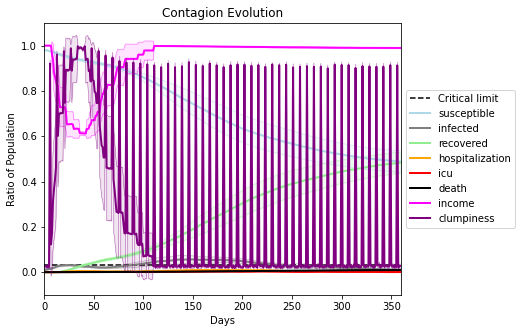

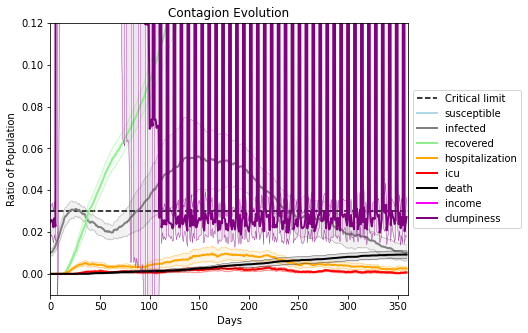

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9190, 5368, 6658, 2437, 2370, 3494, 2413, 4163, 6686, 2038, 5186, 5073, 9796, 4856, 1024, 1973, 7759, 1055, 4067, 6994]
Average similarity between family members is 0.43168213291440005 at temperature -0.8
Average similarity between family and home is 0.9998464318744122 at temperature -1
Average similarity between students and their classroom is 0.17939259721937084 at temperature -0.8
Average classroom occupancy is 4.25 and number classrooms is 72
Average similarity between workers is 0.2876091039305465 at temperature -0.8
Average office occupancy is 3.175 and number offices is 200
Average friend similarity for adults: 0.4937214129440259 for kids: 0.36172495499361695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 

avg restaurant similarity 0.21913870269239333
avg restaurant similarity 0.14889264123563412
avg restaurant similarity 0.1104964388187136
avg restaurant similarity -0.2695870430527676
avg restaurant similarity 0.040145976780027987
avg restaurant similarity 0.07331327869992887
avg restaurant similarity 0.37341354962392226
avg restaurant similarity -0.20230929479403909
avg restaurant similarity -0.444367298582923
avg restaurant similarity 0.03254472292535848
avg restaurant similarity -0.014861012774061468
avg restaurant similarity 0.11823694279395887
avg restaurant similarity 0.4422305215325736
avg restaurant similarity 0.1478601346376822
avg restaurant similarity 0.30056520877234205
avg restaurant similarity 0.044136514213055034
avg restaurant similarity -0.21680220421471996
avg restaurant similarity 0.1680048365204534
avg restaurant similarity 0.3136540137444363
avg restaurant similarity 0.2146702920581187
avg restaurant similarity 0.01698983433413792
avg restaurant similarity 0.1419129

avg restaurant similarity 0.21048523578497375
avg restaurant similarity 0.41521490440373476
avg restaurant similarity 0.6488608113507608
avg restaurant similarity 0.1041509572652203
avg restaurant similarity 0.16764333222838163
avg restaurant similarity 0.33481153752721854
avg restaurant similarity 0.5695886763276639
avg restaurant similarity 0.15990037545332025
avg restaurant similarity -0.08932239804240871
avg restaurant similarity 0.5209965365142074
avg restaurant similarity 0.1512408315780036
avg restaurant similarity 0.3103484437679509
avg restaurant similarity 0.1119043671402533
avg restaurant similarity 0.5473835667663454
avg restaurant similarity 0.08176454641464592
avg restaurant similarity 0.1483215472136301
avg restaurant similarity -0.1711885184719455
avg restaurant similarity -0.48211778195791494
avg restaurant similarity 0.09335669571681458
avg restaurant similarity 0.4598749684425125
avg restaurant similarity 0.12478829700790939
avg restaurant similarity -0.3005401414139

avg restaurant similarity 0.36697691792161935
avg restaurant similarity 0.42021102782025466
avg restaurant similarity 0.4320175910740702
avg restaurant similarity 0.5846715674520471
avg restaurant similarity 0.48035042152761653
avg restaurant similarity 0.8188774127782104
avg restaurant similarity -0.0665007931472636
avg restaurant similarity 0.3141000625667975
avg restaurant similarity 0.5363533569277902
avg restaurant similarity -0.1820191417729815
avg restaurant similarity 0.19246392070538096
avg restaurant similarity -0.30053986822278106
avg restaurant similarity 0.10114549472185655
avg restaurant similarity -0.37473855085369157
avg restaurant similarity 0.5211384271233459
avg restaurant similarity 0.31063187305272333
avg restaurant similarity -0.07759699544807783
avg restaurant similarity 0.05575269372846278
avg restaurant similarity -0.013204037271514611
avg restaurant similarity -0.08646453954482121
avg restaurant similarity 0.19956180399420237
avg restaurant similarity -0.06611

avg restaurant similarity 0.2355867032205241
avg restaurant similarity 0.1602455628708642
avg restaurant similarity 0.5110211267449823
avg restaurant similarity -0.13976169622468787
avg restaurant similarity 0.24997533207736522
avg restaurant similarity 0.34854489411217904
avg restaurant similarity 0.18209622066889575
avg restaurant similarity -0.06498604103735237
avg restaurant similarity 0.3397615794261324
avg restaurant similarity -0.008166365219737973
avg restaurant similarity 0.09400654169191847
avg restaurant similarity 0.23622772407321077
avg restaurant similarity -0.4118168662856572
avg restaurant similarity 0.1163400968277527
avg restaurant similarity 0.24997533207736522
avg restaurant similarity 0.3164055942247106
avg restaurant similarity -0.0803839284364834
avg restaurant similarity 0.4479713439013463
avg restaurant similarity 0.04227133061809278
avg restaurant similarity 0.3427956339028062
avg restaurant similarity 0.23295587053879602
avg restaurant similarity 0.2748402143

avg restaurant similarity 0.04338439239451528
avg restaurant similarity 0.40855178574069784
avg restaurant similarity 0.23354214873473367
avg restaurant similarity -0.07868885541726606
avg restaurant similarity 0.3081816105958768
avg restaurant similarity 0.03322154299426024
avg restaurant similarity 0.0677471248402465
avg restaurant similarity 0.15571217593172257
avg restaurant similarity 0.05626031752924864
avg restaurant similarity -0.17443222474307882
avg restaurant similarity 0.15738882832052412
avg restaurant similarity 0.16206875128568107
avg restaurant similarity 0.3938276871172258
avg restaurant similarity 0.018430618145455588
avg restaurant similarity 0.07407477430636841
avg restaurant similarity 0.062365129217736126
avg restaurant similarity -0.007054401437127378
avg restaurant similarity -0.10089145215013058
avg restaurant similarity -0.140587488755002
avg restaurant similarity 0.1770651134541528
avg restaurant similarity -0.058774963358269296
avg restaurant similarity 0.14

Average similarity between workers is 0.2862502230172719 at temperature -0.8
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.5002726211747844 for kids: 0.341104826416976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 pe

avg restaurant similarity 0.23038229121591378
avg restaurant similarity -0.16436171665594917
avg restaurant similarity 0.0894867145077718
avg restaurant similarity 0.1472342938073229
avg restaurant similarity 0.692655180557999
avg restaurant similarity -0.25600616667191567
avg restaurant similarity 0.16063515943887088
avg restaurant similarity -0.25505782889277984
avg restaurant similarity 0.25136136124011954
avg restaurant similarity -0.5158265185429762
avg restaurant similarity -0.25505782889277984
avg restaurant similarity 0.7360511469702571
avg restaurant similarity 0.027497606610235197
avg restaurant similarity 0.035337547492995613
avg restaurant similarity -0.02359335860118518
avg restaurant similarity -0.08370788168299208
avg restaurant similarity -0.277746334574122
avg restaurant similarity -0.0297788190300259
avg restaurant similarity -0.01210768707133792
avg restaurant similarity 0.009218276611823149
avg restaurant similarity 0.14445378995819877
avg restaurant similarity -0.1

Average friend similarity for adults: 0.49116050423171914 for kids: 0.3535033164866733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated 

avg restaurant similarity -0.02764723318624108
avg restaurant similarity 0.2113362983832826
avg restaurant similarity -0.0064853636107274695
avg restaurant similarity -0.2566191554861462
avg restaurant similarity 0.07049235023515402
avg restaurant similarity 0.2792491277006148
avg restaurant similarity 0.0496885129458817
avg restaurant similarity 0.31486544610125583
avg restaurant similarity 0.10713882930092307
avg restaurant similarity 0.34626846920917037
avg restaurant similarity 0.25671964555543775
avg restaurant similarity 0.335210361746814
avg restaurant similarity 0.13241347492128383
avg restaurant similarity -0.11040990806902005
avg restaurant similarity 0.3211885445497237
avg restaurant similarity -0.2690738249693768
avg restaurant similarity -0.1761781044112033
avg restaurant similarity -0.12743810434187242
avg restaurant similarity 0.3741213974321244
avg restaurant similarity 0.3741213974321244
avg restaurant similarity -0.2522360907744272
avg restaurant similarity 0.03226526

avg restaurant similarity -0.10435222906406175
avg restaurant similarity 0.328922046870448
avg restaurant similarity 0.17174592337859898
avg restaurant similarity 0.6528167469846459
avg restaurant similarity 0.15920616012665073
avg restaurant similarity 0.08947670304941598
avg restaurant similarity 0.3880239071977243
avg restaurant similarity 0.10238616855122748
avg restaurant similarity -0.041399156782646086
avg restaurant similarity 0.2613264334096026
avg restaurant similarity 0.017471802910787197
avg restaurant similarity 0.15796085323749362
avg restaurant similarity 0.3640619812463762
avg restaurant similarity 0.42030775782771435
avg restaurant similarity 0.06124304199504355
avg restaurant similarity 0.12947399690431372
avg restaurant similarity 0.37772171125643955
avg restaurant similarity -0.15615522340161342
avg restaurant similarity 0.3249943788693957
avg restaurant similarity 0.019239838878088843
avg restaurant similarity 0.11576570537155106
avg restaurant similarity -0.021719

avg restaurant similarity 0.08689146206837575
Average similarity between family members is 0.42047388250047046 at temperature -0.8
Average similarity between family and home is 0.9998562653031584 at temperature -1
Average similarity between students and their classroom is 0.13997243330756387 at temperature -0.8
Average classroom occupancy is 4.042857142857143 and number classrooms is 70
Average similarity between workers is 0.31381448779687454 at temperature -0.8
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.49690102704654054 for kids: 0.34988790076784354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 

avg restaurant similarity 0.012447928318143758
avg restaurant similarity 0.727812423902997
avg restaurant similarity 0.04314087122666921
avg restaurant similarity 0.04289455961533623
avg restaurant similarity 0.07271281343396417
avg restaurant similarity -0.2722143292382936
avg restaurant similarity 0.192488695730733
avg restaurant similarity 0.13331086270929574
avg restaurant similarity 0.2634246163420717
avg restaurant similarity -0.0012033099291535523
avg restaurant similarity -0.10026339548882272
avg restaurant similarity -0.24577032104946517
avg restaurant similarity 0.03434709948165393
avg restaurant similarity 0.06444035858550487
avg restaurant similarity 0.336480604532859
avg restaurant similarity -0.18557824975657244
avg restaurant similarity 0.3124187035791682
avg restaurant similarity -0.1608765749958686
avg restaurant similarity 0.3066566220800302
avg restaurant similarity 0.10119403643973376
avg restaurant similarity -0.2014338369474511
avg restaurant similarity -0.5540665

Average similarity between workers is 0.2861114381385374 at temperature -0.8
Average office occupancy is 3.371859296482412 and number offices is 199
Average friend similarity for adults: 0.5014497306644434 for kids: 0.354632576439268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity -0.3407941480500146
avg restaurant similarity -0.034142782433294244
avg restaurant similarity 0.6945846000477928
avg restaurant similarity 0.16737304857408708
avg restaurant similarity 0.37735499364815694
avg restaurant similarity -0.006895207917976535
avg restaurant similarity -0.24591249518775182
avg restaurant similarity 0.07364666764222758
avg restaurant similarity 0.22744203342071204
avg restaurant similarity -0.3277654073037132
avg restaurant similarity 0.29628333610394386
avg restaurant similarity 0.12000837900465341
avg restaurant similarity 0.2974374641836119
avg restaurant similarity 0.23509140711461912
avg restaurant similarity 0.23312270673950558
avg restaurant similarity -0.02554543426656477
avg restaurant similarity 0.11936593939342569
avg restaurant similarity 0.4254573058781624
avg restaurant similarity 0.4463187508006004
avg restaurant similarity -0.2416526439788641
avg restaurant similarity -0.37255129207068644
avg restaurant similarity -0.46

Average friend similarity for adults: 0.5094604127790312 for kids: 0.35911565822208363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.11160155898763498
avg restaurant similarity 0.031114900457388014
avg restaurant similarity 0.07180981975155355
avg restaurant similarity -0.22658015243342408
avg restaurant similarity 0.11409866581502155
avg restaurant similarity -0.1596221507575177
avg restaurant similarity 0.029510911956510504
avg restaurant similarity -0.1596221507575177
avg restaurant similarity 0.0020245237630653525
avg restaurant similarity 0.19441325594059272
avg restaurant similarity 0.10878669380534232
avg restaurant similarity 0.10410574301281422
avg restaurant similarity 0.0020042328979614707
avg restaurant similarity -0.024772091791448562
avg restaurant similarity -0.012134435534923368
avg restaurant similarity -0.006684098447862358
avg restaurant similarity 0.3271876995480133
avg restaurant similarity -0.031016059065772567
avg restaurant similarity 0.09666653931551608
avg restaurant similarity -0.040693402916791965
avg restaurant similarity 0.3682756140136685
avg restaurant simi

avg restaurant similarity -0.05522841339955991
avg restaurant similarity 0.185384006097182
avg restaurant similarity -0.024772091791448562
avg restaurant similarity -0.32234375108981916
avg restaurant similarity 0.14921294819251035
avg restaurant similarity 0.36336526922696166
avg restaurant similarity -0.021274955595324507
avg restaurant similarity 0.07568355445874042
avg restaurant similarity -0.012931966487963876
avg restaurant similarity 0.3177965528693442
avg restaurant similarity 0.999852203133357
avg restaurant similarity 0.20731767954779223
avg restaurant similarity 0.048535716815076985
avg restaurant similarity 0.10762622434885424
avg restaurant similarity 0.1862536388000502
avg restaurant similarity -0.013038042371738917
avg restaurant similarity -0.06156527119443846
Average similarity between family members is 0.42437322334836863 at temperature -0.8
Average similarity between family and home is 0.9998486691035572 at temperature -1
Average similarity between students and thei

avg restaurant similarity 0.12942546049136577
avg restaurant similarity 0.17583947930890464
avg restaurant similarity 0.05262492020530846
avg restaurant similarity -0.15356317879670162
avg restaurant similarity 0.010119692321679438
avg restaurant similarity 0.05262492020530846
avg restaurant similarity -0.005172071440078085
avg restaurant similarity 0.2961593541419685
avg restaurant similarity 0.1683024555600504
avg restaurant similarity 0.7895534213732158
avg restaurant similarity 0.38059668585029327
avg restaurant similarity -0.08872518644082432
avg restaurant similarity -0.17943697434793143
avg restaurant similarity -0.005172071440078085
avg restaurant similarity 0.17864891046245246
avg restaurant similarity 0.21615557754318998
avg restaurant similarity 0.30195541353296784
avg restaurant similarity -0.08872518644082432
avg restaurant similarity 0.1548374730449058
avg restaurant similarity 0.10511128817828447
avg restaurant similarity 0.2152992206436527
avg restaurant similarity -0.0

avg restaurant similarity 0.41112372265253666
avg restaurant similarity 0.13390057834413552
avg restaurant similarity 0.3225287907512835
avg restaurant similarity 0.05598307161270001
avg restaurant similarity -0.004627762363276389
avg restaurant similarity -0.0752937772721681
avg restaurant similarity 0.08049057677855848
avg restaurant similarity 0.01693520868583248
avg restaurant similarity -0.1752067996507811
avg restaurant similarity 0.7438034713834049
avg restaurant similarity 0.03929467689427557
avg restaurant similarity 0.12986306106433476
avg restaurant similarity 0.03474115192823908
avg restaurant similarity 0.23264896232253895
avg restaurant similarity -0.03286051556481165
avg restaurant similarity 0.381566495105958
avg restaurant similarity 0.15361402239448277
avg restaurant similarity -0.11176855389413495
avg restaurant similarity 0.37995021821538044
avg restaurant similarity 0.17686050847505308
avg restaurant similarity 0.04712728060767155
avg restaurant similarity 0.147522

avg restaurant similarity 0.11651947645745717
avg restaurant similarity 0.19577936440149055
avg restaurant similarity -0.10633725214414504
avg restaurant similarity 0.08371752288856776
avg restaurant similarity 0.05232558897319564
avg restaurant similarity 0.0866128156150728
avg restaurant similarity 0.13367715234838676
avg restaurant similarity -0.07148592696475105
avg restaurant similarity 0.1452448741903541
avg restaurant similarity 0.23373961070623334
avg restaurant similarity 0.0004892132950977124
avg restaurant similarity 0.23589809809625728
avg restaurant similarity 0.27287858225008554
avg restaurant similarity 0.005752131975502211
avg restaurant similarity -0.10030739467283717
avg restaurant similarity 0.025021873471997993
avg restaurant similarity -0.0864523294499361
avg restaurant similarity -0.1010116003911932
avg restaurant similarity 0.1552715803860444
avg restaurant similarity 0.14226834296918398
avg restaurant similarity -0.3628925871666765
avg restaurant similarity -0.0

avg restaurant similarity 0.1569333631227619
avg restaurant similarity 0.008842839238634837
avg restaurant similarity -0.11663615916103275
avg restaurant similarity -0.06596978719285512
avg restaurant similarity 0.1028597773884995
avg restaurant similarity 0.4919061970391816
avg restaurant similarity 0.08749169546890799
avg restaurant similarity 0.29785404551575007
avg restaurant similarity 0.07016338145874343
avg restaurant similarity -0.1255886563142406
avg restaurant similarity 0.18409799618499362
Average similarity between family members is 0.42529386994114615 at temperature -0.8
Average similarity between family and home is 0.9998478234416969 at temperature -1
Average similarity between students and their classroom is 0.18352064200288368 at temperature -0.8
Average classroom occupancy is 4.257142857142857 and number classrooms is 70
Average similarity between workers is 0.2989044136707603 at temperature -0.8
Average office occupancy is 3.2388059701492535 and number offices is 201


avg restaurant similarity 0.020421211805168153
avg restaurant similarity 0.12359024985400864
avg restaurant similarity -0.09078070667198486
avg restaurant similarity 0.22060997020675893
avg restaurant similarity -0.2203954772847055
avg restaurant similarity 0.10007318934175541
avg restaurant similarity -0.09870735741350571
avg restaurant similarity -0.18961041364755188
avg restaurant similarity 0.38304206678645886
avg restaurant similarity -0.019360085196111862
avg restaurant similarity 0.2056004176280303
avg restaurant similarity 0.1430369486660862
avg restaurant similarity 0.277601568521821
avg restaurant similarity 0.490058858986177
avg restaurant similarity 0.41449900016651253
avg restaurant similarity 0.33706327518055634
avg restaurant similarity 0.4857793844407112
avg restaurant similarity 0.0921392943825248
avg restaurant similarity 0.1489721205049522
avg restaurant similarity 0.09207743388374136
avg restaurant similarity 0.30161190904890867
avg restaurant similarity 0.113075186

avg restaurant similarity 0.327536472151332
avg restaurant similarity 0.0798152254027413
avg restaurant similarity 0.22415082074856027
avg restaurant similarity 0.21661722924216545
avg restaurant similarity 0.16814667674083772
avg restaurant similarity -0.18322804599353132
avg restaurant similarity 0.385428420497288
avg restaurant similarity 0.08863793236360164
avg restaurant similarity -0.12040500493996224
avg restaurant similarity -0.05071959574444064
avg restaurant similarity -0.24112590331421846
avg restaurant similarity 0.06526544445899106
avg restaurant similarity 0.4674522757502347
avg restaurant similarity 0.6957231558776592
avg restaurant similarity -0.0009656837907667526
avg restaurant similarity 0.2178087113644092
avg restaurant similarity 0.3323183783392147
avg restaurant similarity 0.10626570482140635
avg restaurant similarity 0.13927267391307055
avg restaurant similarity 0.3178588291714954
avg restaurant similarity 0.16917557776235975
avg restaurant similarity 0.218087527

avg restaurant similarity 0.2276051745406245
avg restaurant similarity 0.1021282649846738
avg restaurant similarity -0.28618345870516476
avg restaurant similarity 0.31319956325374926
avg restaurant similarity 0.3718064279917512
avg restaurant similarity 0.1505281497306875
avg restaurant similarity 0.28157221584555225
avg restaurant similarity 0.1622111200592013
avg restaurant similarity -0.017623010844060503
avg restaurant similarity 0.07543409257025864
avg restaurant similarity -0.24112590331421846
avg restaurant similarity 0.02530203874832898
avg restaurant similarity 0.09973424621713814
avg restaurant similarity 0.3048982315778623
avg restaurant similarity -0.10213797510724393
avg restaurant similarity 0.09833818049810297
avg restaurant similarity 0.21003625244242813
avg restaurant similarity 0.3040659016276946
Average similarity between family members is 0.42984281058473495 at temperature -0.8
Average similarity between family and home is 0.9998522329499319 at temperature -1
Averag

avg restaurant similarity 0.00405022791511647
avg restaurant similarity 0.04300279901612279
avg restaurant similarity 0.2540248982541525
avg restaurant similarity 0.18244898344600646
avg restaurant similarity 0.1613288398781853
avg restaurant similarity 0.019199502017910937
avg restaurant similarity 0.4687764122012097
avg restaurant similarity 0.29091948611549034
avg restaurant similarity -0.020891705896968107
avg restaurant similarity 0.13744230157435683
avg restaurant similarity -0.09193716388960436
avg restaurant similarity 0.11721178163410328
avg restaurant similarity 0.3958686748448219
avg restaurant similarity 0.3715027775634052
avg restaurant similarity -0.0309501771583406
avg restaurant similarity -0.3743562623541542
avg restaurant similarity 0.20496826860483947
avg restaurant similarity -0.31226735048531273
avg restaurant similarity 0.17919253406325591
avg restaurant similarity 0.02102351725623189
avg restaurant similarity 0.07461165080559773
avg restaurant similarity 0.011928

avg restaurant similarity 0.009505566672106891
avg restaurant similarity -0.16519723249846965
avg restaurant similarity 0.02998790888583096
Average similarity between family members is 0.4277996467117387 at temperature -0.8
Average similarity between family and home is 0.9998504017460018 at temperature -1
Average similarity between students and their classroom is 0.15846752284957094 at temperature -0.8
Average classroom occupancy is 4.159420289855072 and number classrooms is 69
Average similarity between workers is 0.2899444066277919 at temperature -0.8
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.49969475161419347 for kids: 0.3516044629717056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.05982528582455287
avg restaurant similarity 0.07845622882129556
avg restaurant similarity 0.1483179211273326
avg restaurant similarity -0.02064364807725305
avg restaurant similarity 0.2331447632331255
avg restaurant similarity -0.08168883300547729
avg restaurant similarity -0.06880829805246652
avg restaurant similarity 0.38042864253100395
avg restaurant similarity -0.04475562262405417
avg restaurant similarity 0.2299251112727414
avg restaurant similarity -0.3761799362617479
avg restaurant similarity -0.03371278594304354
avg restaurant similarity 0.3087769364040908
avg restaurant similarity 0.011598747212402715
avg restaurant similarity 0.34496911459144236
avg restaurant similarity -0.24594244962419654
avg restaurant similarity -0.06331419338770218
avg restaurant similarity -0.2522228178611969
avg restaurant similarity 0.1942045121946095
avg restaurant similarity 0.2126367953813615
avg restaurant similarity 0.05110323650282251
avg restaurant similarity -0.055

avg restaurant similarity 0.4092468592251844
avg restaurant similarity 0.12141015134672642
avg restaurant similarity -0.19456746482054735
avg restaurant similarity -0.3652626770333117
avg restaurant similarity 0.3829161922125935
avg restaurant similarity 0.4245398644883882
avg restaurant similarity -0.10535315000501154
avg restaurant similarity -0.06845707227743897
avg restaurant similarity -0.09671848835406238
avg restaurant similarity -0.35718165833892856
avg restaurant similarity 0.05408121360628909
avg restaurant similarity -0.08944223614838229
avg restaurant similarity -0.23473648544757136
avg restaurant similarity 0.03852753393596159
avg restaurant similarity 0.280453515114851
avg restaurant similarity 0.4141853357917297
avg restaurant similarity 0.6188294052684065
avg restaurant similarity 0.5460354455326006
avg restaurant similarity -0.18274347251630801
avg restaurant similarity -0.19264854008277044
avg restaurant similarity 0.10443636478427157
avg restaurant similarity 0.72382

avg restaurant similarity -0.011080768136282365
avg restaurant similarity -0.6720004544629309
avg restaurant similarity 0.039275633059621395
avg restaurant similarity 0.025737297968468312
avg restaurant similarity 0.2442541202987336
avg restaurant similarity 0.1671705722876426
avg restaurant similarity -0.36276511479100254
avg restaurant similarity 0.09927116004658834
avg restaurant similarity 0.21568264489092676
avg restaurant similarity 0.08365151241965518
avg restaurant similarity -0.10482857840237156
avg restaurant similarity -0.18553930263110857
avg restaurant similarity -0.16212382610330867
avg restaurant similarity -0.07876574761519066
avg restaurant similarity 0.18692649935548036
avg restaurant similarity 0.21141394891226792
avg restaurant similarity 0.021933416189786364
avg restaurant similarity -0.27173182690536296
avg restaurant similarity -0.13375738256619285
avg restaurant similarity 0.324868139695062
avg restaurant similarity 0.7590027170069212
avg restaurant similarity -

(<function dict.items>, <function dict.items>, <function dict.items>)

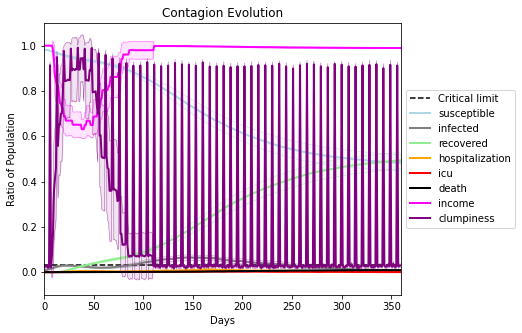

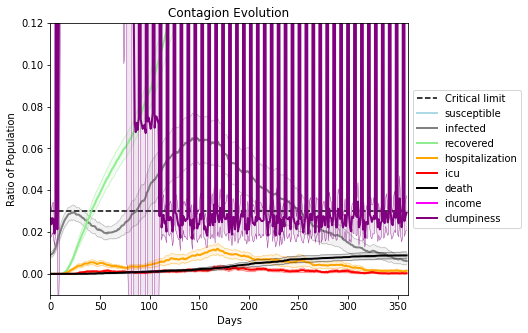

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9121, 6477, 9666, 9035, 144, 6880, 9047, 7425, 5744, 8717, 678, 2662, 8770, 1335, 7146, 7328, 8669, 517, 3622, 4682]
Average similarity between family members is 0.327650861423749 at temperature -0.7
Average similarity between family and home is 0.9998622349779044 at temperature -1
Average similarity between students and their classroom is 0.15195749172244452 at temperature -0.7
Average classroom occupancy is 4.223880597014926 and number classrooms is 67
Average similarity between workers is 0.1690928715380619 at temperature -0.7
Average office occupancy is 3.3681592039800994 and number offices is 201
Average friend similarity for adults: 0.42663964624748624 for kids: 0.26485066716525485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.12915785937215207
avg restaurant similarity -0.07407480848576221
avg restaurant similarity -0.04491910221590349
avg restaurant similarity 0.33518919310157863
avg restaurant similarity 0.22325109505214052
avg restaurant similarity -0.038409830555467324
avg restaurant similarity 0.024514764426614877
avg restaurant similarity 0.11554576353004951
avg restaurant similarity 0.25125687149256465
avg restaurant similarity 0.021282956201097443
avg restaurant similarity 0.2059339078629189
avg restaurant similarity 0.6626815662783064
avg restaurant similarity -0.07061539013664064
avg restaurant similarity 0.2073590659129723
avg restaurant similarity 0.0024542505375522027
avg restaurant similarity 0.10544828329867609
avg restaurant similarity 0.19302377915052604
avg restaurant similarity -0.1276633349538317
avg restaurant similarity 0.04478951722923601
avg restaurant similarity 0.4429541841563692
avg restaurant similarity 0.11554576353004951
avg restaurant similarity 0.3

Average similarity between family members is 0.3592929937843083 at temperature -0.7
Average similarity between family and home is 0.9998497266225219 at temperature -1
Average similarity between students and their classroom is 0.18375805991950606 at temperature -0.7
Average classroom occupancy is 4.180555555555555 and number classrooms is 72
Average similarity between workers is 0.16067138457947572 at temperature -0.7
Average office occupancy is 3.1323529411764706 and number offices is 204
Average friend similarity for adults: 0.4270654523040185 for kids: 0.2875588082088133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) di

avg restaurant similarity -0.22996298721192393
avg restaurant similarity -0.047385154391750714
avg restaurant similarity -0.004363954443215065
avg restaurant similarity 0.15795476102678607
avg restaurant similarity 0.18213447388949078
avg restaurant similarity -0.2912009055871643
avg restaurant similarity -0.2545336854677588
avg restaurant similarity 0.32963792627387356
avg restaurant similarity 0.07656807902923969
avg restaurant similarity 0.16598244777801874
avg restaurant similarity 0.2031537935074604
avg restaurant similarity -0.21021829583631185
avg restaurant similarity 0.6826030235613961
avg restaurant similarity -0.2750893020976407
avg restaurant similarity -0.22996298721192393
avg restaurant similarity 0.20069414259438567
avg restaurant similarity -0.22996298721192393
avg restaurant similarity -0.04842133132222678
avg restaurant similarity 0.010239621343566943
avg restaurant similarity 0.09701105642655529
avg restaurant similarity 0.15140966355296132
avg restaurant similarity 

avg restaurant similarity 0.03382728458319953
avg restaurant similarity 0.7074695517248543
avg restaurant similarity -0.13129055770112374
avg restaurant similarity -0.0916346305720315
avg restaurant similarity 0.10963506997679096
avg restaurant similarity 0.17174796654134974
avg restaurant similarity 0.02684678082257437
avg restaurant similarity -0.34342094086407493
avg restaurant similarity 0.274299979735886
avg restaurant similarity 0.13021659041674905
avg restaurant similarity -0.1692789302250614
avg restaurant similarity 0.10963506997679096
avg restaurant similarity 0.37428241603159856
avg restaurant similarity -0.03870099928752001
avg restaurant similarity 0.4793484927224403
avg restaurant similarity 0.08763226560139648
avg restaurant similarity -0.0161789208718899
avg restaurant similarity -0.1995657301199179
avg restaurant similarity 0.3393758391379444
avg restaurant similarity 0.536722296105894
avg restaurant similarity 0.18958728278494902
avg restaurant similarity -0.579452676

avg restaurant similarity 0.2615829982717726
avg restaurant similarity 0.08679334632963157
avg restaurant similarity 0.061117124017424626
avg restaurant similarity 0.1364903718352482
avg restaurant similarity 0.33013365619448176
avg restaurant similarity 0.012727186242852323
avg restaurant similarity -0.0780722918489278
avg restaurant similarity 0.08889508594703652
avg restaurant similarity -0.15951699996391003
avg restaurant similarity 0.4020235571400791
avg restaurant similarity -0.15387390082276997
avg restaurant similarity 0.609675192397842
avg restaurant similarity 0.37695503065569763
avg restaurant similarity -0.050760712085115366
avg restaurant similarity 0.011991722451915689
avg restaurant similarity 0.3679854472934374
avg restaurant similarity 0.204717273613823
avg restaurant similarity 0.28735096242723956
avg restaurant similarity -0.07022617093747653
avg restaurant similarity -0.2571350028110795
avg restaurant similarity 0.21767427939851475
avg restaurant similarity -0.07844

avg restaurant similarity 0.4019681931117909
avg restaurant similarity 0.2750542187668496
avg restaurant similarity -0.20950705705180786
avg restaurant similarity -0.12317462258730119
avg restaurant similarity 0.10875285775558037
avg restaurant similarity 0.18369953620879773
avg restaurant similarity 0.15007264943600396
avg restaurant similarity 0.008304040277669806
avg restaurant similarity 0.4171098460836118
avg restaurant similarity 0.01319287299384346
avg restaurant similarity 0.321970187786567
avg restaurant similarity 0.12158156692674002
avg restaurant similarity -0.19295420134234198
avg restaurant similarity 0.046535133970605685
avg restaurant similarity 0.22550237274260634
avg restaurant similarity -0.06182163013839287
avg restaurant similarity 0.4367311977359513
avg restaurant similarity 0.07411869275101822
avg restaurant similarity -0.023142518473257705
avg restaurant similarity 0.18959904667017913
avg restaurant similarity 0.14532749099620118
avg restaurant similarity 0.2481

avg restaurant similarity 0.027117832794905886
avg restaurant similarity 0.3144027840902385
avg restaurant similarity 0.23291269762117284
avg restaurant similarity 0.11116897119226446
avg restaurant similarity 0.6664572883707669
avg restaurant similarity -0.07528873881998693
avg restaurant similarity 0.32355517859755634
avg restaurant similarity 0.4372990962973241
avg restaurant similarity 0.2911725909167922
avg restaurant similarity -0.1573843556961063
avg restaurant similarity 0.3735666742347713
avg restaurant similarity 0.6731433532471366
avg restaurant similarity -0.006692080975828916
avg restaurant similarity 0.2727708829077522
avg restaurant similarity 0.12577129745321078
avg restaurant similarity 0.26739903932687076
avg restaurant similarity -0.08802523774797144
avg restaurant similarity -0.0870378429608661
avg restaurant similarity 0.23938906836850773
avg restaurant similarity 0.1473135100061149
avg restaurant similarity 0.08930262522240617
avg restaurant similarity -0.10182678

avg restaurant similarity -0.11217518831736532
avg restaurant similarity -0.0091040168415794
avg restaurant similarity -0.1790986152535885
avg restaurant similarity 0.03719675898888594
avg restaurant similarity 0.16245082610855371
avg restaurant similarity 0.2300382920011107
avg restaurant similarity 0.11581490997443088
avg restaurant similarity 0.1536488550985204
avg restaurant similarity -0.09607223014821777
avg restaurant similarity -0.13306223122463745
avg restaurant similarity 0.0625106658266786
avg restaurant similarity 0.16767805967488805
avg restaurant similarity 0.08189907390926118
avg restaurant similarity 0.23455782297349792
avg restaurant similarity 0.22416625274895743
avg restaurant similarity 0.3564741953306107
avg restaurant similarity -0.3010638770729679
avg restaurant similarity 0.5344124980984988
avg restaurant similarity 0.06363166809256154
avg restaurant similarity -0.07902785470985033
avg restaurant similarity 0.04798654001786362
avg restaurant similarity 0.2639493

avg restaurant similarity -0.1412917065778399
avg restaurant similarity 0.010849666848209344
avg restaurant similarity 0.21556206884646775
avg restaurant similarity 0.2638697959992442
avg restaurant similarity -0.011225546499646286
avg restaurant similarity 0.42266792099442824
avg restaurant similarity -0.26875203972356726
avg restaurant similarity 0.3397886461551842
avg restaurant similarity -0.030003204710384798
avg restaurant similarity 0.6971249472969041
avg restaurant similarity -0.3903560693175668
avg restaurant similarity -0.0980829220613303
avg restaurant similarity -0.17178197678642004
avg restaurant similarity -0.08564168273307071
avg restaurant similarity -0.10512250854260671
avg restaurant similarity 0.2551060306806434
avg restaurant similarity -0.2614694658211171
avg restaurant similarity 0.24635003021750584
avg restaurant similarity 0.09272262035546569
avg restaurant similarity 0.3640178751207549
avg restaurant similarity 0.049377989418945306
avg restaurant similarity 0.1

avg restaurant similarity -0.223341075202587
avg restaurant similarity -0.16359718793309602
avg restaurant similarity 0.3604716263415013
avg restaurant similarity 0.07646475864453608
avg restaurant similarity 0.11916244215931955
avg restaurant similarity -0.04077600649391982
avg restaurant similarity 0.2217446716869128
avg restaurant similarity -0.10609168485760434
avg restaurant similarity 0.08566700993637648
avg restaurant similarity 0.5219370584999993
avg restaurant similarity 0.3685303842808995
avg restaurant similarity 0.07319823476610043
avg restaurant similarity -0.05864235815369469
avg restaurant similarity 0.3168198684362756
avg restaurant similarity 0.12766306994156895
avg restaurant similarity -0.27149582636481795
avg restaurant similarity 0.319016504110723
avg restaurant similarity 0.23965964359446817
avg restaurant similarity -0.07708901994530039
avg restaurant similarity -0.04116860767645688
avg restaurant similarity 0.1635604528833921
avg restaurant similarity 0.16898680

avg restaurant similarity -0.18176791575792603
avg restaurant similarity -0.1241498160411646
avg restaurant similarity 0.3410815077136811
avg restaurant similarity 0.5713010555796527
avg restaurant similarity 0.0066903563800201765
avg restaurant similarity -0.18746558940840172
avg restaurant similarity -0.3038369773314434
avg restaurant similarity 0.6277667252414917
avg restaurant similarity 0.05791686267545129
avg restaurant similarity 0.12333474533029198
avg restaurant similarity 0.09310147009369565
avg restaurant similarity 0.06880487120817641
avg restaurant similarity 0.04390507244958182
avg restaurant similarity -0.013993807210885742
avg restaurant similarity 0.041095505347389524
avg restaurant similarity 0.004174244417612013
avg restaurant similarity 0.14129950410050537
avg restaurant similarity 0.019460708655687192
avg restaurant similarity -0.2434228228066734
avg restaurant similarity -0.017359262077883658
avg restaurant similarity 0.4033048829006184
avg restaurant similarity -

avg restaurant similarity -0.2120456166463877
avg restaurant similarity 0.04962272690313659
avg restaurant similarity 0.058863852843473806
avg restaurant similarity 0.08101458040486603
avg restaurant similarity 0.04005107122517683
avg restaurant similarity -0.0842780730990081
avg restaurant similarity 0.08128510867425656
avg restaurant similarity 0.14839996258475058
avg restaurant similarity -0.04032979354665817
avg restaurant similarity 0.1836331650023243
avg restaurant similarity 0.8531650741567836
avg restaurant similarity -0.0905818881455924
avg restaurant similarity -0.031082026428484098
avg restaurant similarity 0.2134687457986439
avg restaurant similarity 0.09849707003330455
avg restaurant similarity 0.02860391203955964
avg restaurant similarity -0.2863778496678149
avg restaurant similarity 0.3773067839760601
avg restaurant similarity 0.4454477346377303
Average similarity between family members is 0.36164004724173954 at temperature -0.7
Average similarity between family and home

avg restaurant similarity 0.2561563762890227
avg restaurant similarity 0.2875668306162683
avg restaurant similarity 0.0171516336043608
avg restaurant similarity 0.05609651509354323
avg restaurant similarity 0.13080465558985305
avg restaurant similarity 0.17178035352882925
avg restaurant similarity 0.3853037597635657
avg restaurant similarity 0.13110700778609308
avg restaurant similarity 0.043274599636387384
avg restaurant similarity 0.30778364931137003
avg restaurant similarity -0.11240399856369361
avg restaurant similarity -0.124778966911576
avg restaurant similarity 0.2926785537547909
avg restaurant similarity 0.12955380439692696
avg restaurant similarity 0.643517443425244
avg restaurant similarity 0.25858031221270983
avg restaurant similarity 0.10461010477198063
avg restaurant similarity 0.24146840362441027
avg restaurant similarity 0.4291039509644641
avg restaurant similarity 0.3853037597635657
avg restaurant similarity 0.01796741661494075
avg restaurant similarity -0.1078971956210

avg restaurant similarity 0.007955126528224082
avg restaurant similarity 0.10956918866852679
avg restaurant similarity 0.3392727167809476
avg restaurant similarity 0.3799177355981864
avg restaurant similarity 0.19467905818698933
avg restaurant similarity -0.16417317692677152
Average similarity between family members is 0.3537747852280991 at temperature -0.7
Average similarity between family and home is 0.9998527877159133 at temperature -1
Average similarity between students and their classroom is 0.15705604256642422 at temperature -0.7
Average classroom occupancy is 4.450704225352113 and number classrooms is 71
Average similarity between workers is 0.19152049139564867 at temperature -0.7
Average office occupancy is 3.1492537313432836 and number offices is 201
Average friend similarity for adults: 0.42682677187923507 for kids: 0.2843075194892982
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a

avg restaurant similarity -0.09944467193925328
avg restaurant similarity 0.29260650142960737
avg restaurant similarity 0.2576322452540555
avg restaurant similarity 0.18720102018952303
avg restaurant similarity 0.46350860303128494
avg restaurant similarity 0.3471204002058758
avg restaurant similarity 0.12646325969296185
avg restaurant similarity 0.09141828911644853
avg restaurant similarity -0.36768958530797907
avg restaurant similarity 0.217446023548141
avg restaurant similarity 0.13222657736192625
avg restaurant similarity 0.06254895623300126
avg restaurant similarity -0.05294860354300283
avg restaurant similarity 0.3605381489965621
avg restaurant similarity -0.13424379037416564
avg restaurant similarity 0.0036167109173398937
avg restaurant similarity 0.1698370813787733
avg restaurant similarity 0.17499849415018587
avg restaurant similarity 0.03520386639010292
avg restaurant similarity -0.10786289836539986
avg restaurant similarity 0.4385818397759806
avg restaurant similarity 0.438581

avg restaurant similarity 0.14427409002557398
avg restaurant similarity 0.21249745256508046
avg restaurant similarity -0.1479268623478887
avg restaurant similarity 0.09125953608008665
avg restaurant similarity 0.3783508650437163
avg restaurant similarity 0.2974612981129925
avg restaurant similarity 0.18713084183414125
avg restaurant similarity 0.2974612981129925
avg restaurant similarity 0.3422568145458706
avg restaurant similarity -0.31158617849500936
avg restaurant similarity -0.3897471668515001
avg restaurant similarity -0.3897471668515001
avg restaurant similarity 0.06578613935837131
avg restaurant similarity 0.15146338472873255
avg restaurant similarity -0.4208332869916992
avg restaurant similarity 0.08501724308082283
avg restaurant similarity -0.13758076690877924
avg restaurant similarity -0.18957857018999744
avg restaurant similarity 0.10152607611566264
avg restaurant similarity 0.08427077242805886
avg restaurant similarity 0.4244521428325558
avg restaurant similarity -0.2093728

avg restaurant similarity -0.13631431478890277
avg restaurant similarity 0.09799821976846058
avg restaurant similarity 0.2805229401552359
avg restaurant similarity 0.20687350249629213
avg restaurant similarity -0.06730756842470778
avg restaurant similarity 0.4065372112418213
avg restaurant similarity 0.00559871370729044
avg restaurant similarity 0.21254621651456346
avg restaurant similarity 0.3458746027186113
avg restaurant similarity 0.026216464067803064
avg restaurant similarity 0.08213439823073773
avg restaurant similarity 0.6219731478233104
avg restaurant similarity 0.025097057551760532
avg restaurant similarity 0.3324685804770762
avg restaurant similarity 0.31692674038809737
avg restaurant similarity 0.03963012314181237
avg restaurant similarity -0.30900594299932316
avg restaurant similarity 0.43802276413648966
avg restaurant similarity 0.0828943303067063
avg restaurant similarity 0.003443574400733923
avg restaurant similarity 0.5024617182065485
avg restaurant similarity -0.136641

Average friend similarity for adults: 0.42537374332616207 for kids: 0.28526262943086883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.048831763719212995
avg restaurant similarity -0.19532192331693643
avg restaurant similarity -0.043148448319962264
avg restaurant similarity 0.5999070927193099
avg restaurant similarity -0.2864942178025145
avg restaurant similarity -0.07922926225214988
avg restaurant similarity -0.13376540984782312
avg restaurant similarity -0.4630243138514336
avg restaurant similarity 0.33413890844461575
avg restaurant similarity 0.0757229282411362
avg restaurant similarity -0.1694963393359764
avg restaurant similarity -0.41518294402786676
avg restaurant similarity 0.09861660246681794
avg restaurant similarity 0.28284574164239357
avg restaurant similarity 0.07606514941402803
avg restaurant similarity -0.026487831738102624
avg restaurant similarity 0.22217091629646174
avg restaurant similarity -0.10339523393750982
avg restaurant similarity 0.10083237519937904
avg restaurant similarity -0.3610128397910381
avg restaurant similarity -0.30638157310612707
avg restaurant similarity

avg restaurant similarity -0.23455768746400246
avg restaurant similarity -0.029701487800096987
avg restaurant similarity 0.45021822575671333
avg restaurant similarity -0.07644717198479173
avg restaurant similarity 0.6092558921379223
avg restaurant similarity 0.20360483541187638
avg restaurant similarity 0.4561628033712213
avg restaurant similarity 0.2118352005890908
avg restaurant similarity -0.14992193159201328
avg restaurant similarity 0.013930103638788924
avg restaurant similarity 0.23057054797761084
avg restaurant similarity 0.19170465972264872
avg restaurant similarity 0.07382629753217192
avg restaurant similarity 0.04879483844226831
avg restaurant similarity -0.3016923316254117
avg restaurant similarity 0.4673158940902211
avg restaurant similarity -0.06856761339625062
avg restaurant similarity 0.013154254507163586
avg restaurant similarity 0.09084665884764553
avg restaurant similarity -0.29037362713774956
avg restaurant similarity 0.12801231964886478
avg restaurant similarity 0.0

avg restaurant similarity -0.0510082827076388
avg restaurant similarity 0.36447745886310157
avg restaurant similarity -0.06459597583173975
avg restaurant similarity -0.1579613716740748
avg restaurant similarity 0.6551817702252134
avg restaurant similarity -0.14906321483118606
avg restaurant similarity -0.011586804394416792
avg restaurant similarity 0.22194656797201706
avg restaurant similarity 0.17714317097894466
avg restaurant similarity 0.06111476111336661
avg restaurant similarity 0.1455824011345848
avg restaurant similarity 0.0367747945108904
avg restaurant similarity -0.35825918943906665
avg restaurant similarity 0.0025268472308816944
avg restaurant similarity 0.0054311571037787346
avg restaurant similarity -0.3402944028285037
avg restaurant similarity -0.08261838733210805
avg restaurant similarity -0.16712255527106346
avg restaurant similarity 0.06757829745097306
avg restaurant similarity -0.45586967850680005
avg restaurant similarity 0.08767571656114262
avg restaurant similarity

avg restaurant similarity -0.0104632621057455
avg restaurant similarity 0.14219875120530273
avg restaurant similarity 0.021233952392624364
avg restaurant similarity -0.11083030490166171
avg restaurant similarity -0.28201615479903896
avg restaurant similarity -0.19763880433524472
avg restaurant similarity -0.28201615479903896
avg restaurant similarity 0.003165838643571492
avg restaurant similarity 0.09105810467887065
avg restaurant similarity -0.18758324556170866
avg restaurant similarity 0.3280239043447191
avg restaurant similarity 0.13544223171322461
avg restaurant similarity 0.18647058834284377
avg restaurant similarity 0.032834485076025086
avg restaurant similarity 0.015091782747601742
avg restaurant similarity -0.06619360955610779
avg restaurant similarity 0.062426325098028035
avg restaurant similarity 0.09641751838394301
avg restaurant similarity 0.12255686044963437
avg restaurant similarity 0.2790767185700058
avg restaurant similarity 0.23637835266876658
avg restaurant similarity

Average similarity between workers is 0.18404559560048525 at temperature -0.7
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.4306324904813196 for kids: 0.2782213585548307
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity -0.2486036619127593
avg restaurant similarity -0.05071193167421095
avg restaurant similarity -0.0638760858541663
avg restaurant similarity 0.48388059117737214
avg restaurant similarity 0.10406262843262036
avg restaurant similarity 0.7092762897390144
avg restaurant similarity 0.4656168358094689
avg restaurant similarity -0.04964455139929643
avg restaurant similarity -0.1294450263577305
avg restaurant similarity 0.21656868903806228
avg restaurant similarity -0.12913953329043742
avg restaurant similarity 0.25387968870207483
avg restaurant similarity 0.14669276923272756
avg restaurant similarity 0.0977556714999238
avg restaurant similarity -0.227034896446302
avg restaurant similarity 0.46206354054775967
avg restaurant similarity 0.44505042866613653
avg restaurant similarity 0.08131100589882762
avg restaurant similarity 0.18086986652717757
avg restaurant similarity 0.3883651799895669
avg restaurant similarity -0.020213731411099556
avg restaurant similarity 0.552556

avg restaurant similarity 0.3748111879296216
avg restaurant similarity 0.09279699806941749
avg restaurant similarity -0.0459127009563769
avg restaurant similarity 0.37813876072381236
avg restaurant similarity -0.1589291424175831
avg restaurant similarity 0.05964184006904016
avg restaurant similarity 0.43090128813555006
avg restaurant similarity -0.1792949669087284
avg restaurant similarity -0.048710277110840916
avg restaurant similarity 0.42609972170498056
avg restaurant similarity 0.048108985327358855
avg restaurant similarity 0.1470194476350759
avg restaurant similarity 0.1622809130486924
avg restaurant similarity 0.022427805857209077
avg restaurant similarity 0.10603114705099631
avg restaurant similarity 0.07049616357176994
avg restaurant similarity -0.18709990580509622
avg restaurant similarity 0.3494767547982133
avg restaurant similarity -0.1454043487401009
avg restaurant similarity -0.20505426215736466
avg restaurant similarity 0.12578036834507705
avg restaurant similarity 0.1476

(<function dict.items>, <function dict.items>, <function dict.items>)

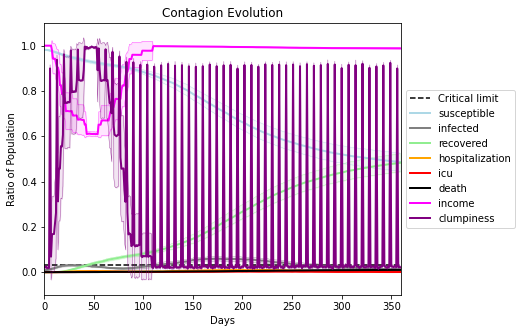

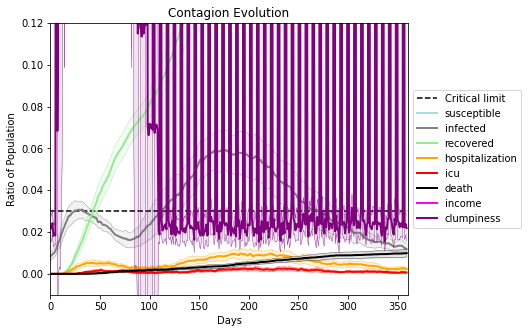

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[6344, 4362, 5761, 6234, 6355, 4561, 7522, 4513, 6889, 3559, 6171, 9539, 837, 333, 16, 5346, 6362, 6904, 8114, 9013]
Average similarity between family members is 0.33447082941260914 at temperature -0.6
Average similarity between family and home is 0.9998552892012043 at temperature -1
Average similarity between students and their classroom is 0.14817671832818605 at temperature -0.6
Average classroom occupancy is 4.28169014084507 and number classrooms is 71
Average similarity between workers is 0.15326951845795003 at temperature -0.6
Average office occupancy is 3.230392156862745 and number offices is 204
Average friend similarity for adults: 0.3855522413374158 for kids: 0.2153783367055976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.03097316296899265
avg restaurant similarity 0.36511171315483437
avg restaurant similarity 0.08050464851745356
avg restaurant similarity 0.318788318299139
avg restaurant similarity -0.3239828662220669
avg restaurant similarity -0.04615902467221274
avg restaurant similarity 0.046353888654732806
avg restaurant similarity -0.10279927592684374
avg restaurant similarity 0.042239171427452316
avg restaurant similarity 0.20291729846147538
avg restaurant similarity 0.2967246889769779
avg restaurant similarity 0.19106754636778317
avg restaurant similarity 0.5171373633458942
avg restaurant similarity -0.007012095476967531
avg restaurant similarity 0.18087617646587706
avg restaurant similarity -0.08025991510473576
avg restaurant similarity -0.13961798586238347
avg restaurant similarity 0.41266269692480145
avg restaurant similarity 0.2626264938501453
avg restaurant similarity 0.17796639624440605
avg restaurant similarity 0.243425966875414
avg restaurant similarity 0.49614

avg restaurant similarity 0.3895450062880995
avg restaurant similarity 0.12312693304464817
avg restaurant similarity 0.07407779939587189
avg restaurant similarity 0.10465662673314083
avg restaurant similarity -0.17108731666369864
avg restaurant similarity -0.038950849841327455
avg restaurant similarity 0.0839156569189409
avg restaurant similarity -0.1942382660885506
avg restaurant similarity 0.10497440760505664
avg restaurant similarity -0.17152272939069538
avg restaurant similarity 0.10821292079354783
avg restaurant similarity 0.3952994283882673
avg restaurant similarity 0.22598777380139148
avg restaurant similarity 0.6489730488231389
avg restaurant similarity 0.28316599219698946
avg restaurant similarity -0.1192020007568941
avg restaurant similarity 0.02049837840401121
avg restaurant similarity -0.11188912698356654
avg restaurant similarity 0.289548888942991
avg restaurant similarity -0.01372614420011041
avg restaurant similarity -0.20457844353007348
avg restaurant similarity 0.10816

avg restaurant similarity 0.01193631934442862
avg restaurant similarity 0.27117670629163537
avg restaurant similarity 0.052264708931852276
avg restaurant similarity 0.278967926889403
avg restaurant similarity 0.20592067746007325
avg restaurant similarity 0.008033621530161822
avg restaurant similarity 0.37425330408030566
avg restaurant similarity 0.14095503107521673
avg restaurant similarity -0.28903946807788244
avg restaurant similarity -0.27994914102554047
avg restaurant similarity 0.17412791535021727
avg restaurant similarity -0.045461764467760166
avg restaurant similarity 0.08730220930832468
avg restaurant similarity 0.030429123733534406
avg restaurant similarity -0.32729146154142624
avg restaurant similarity 0.02269122699498259
avg restaurant similarity 0.08429350598414696
avg restaurant similarity 0.28332329056978783
avg restaurant similarity 0.2142832941671159
avg restaurant similarity 0.26892086833119083
avg restaurant similarity 0.05766937342354826
avg restaurant similarity -0.

avg restaurant similarity 0.3594819685857809
avg restaurant similarity 0.35300298624854737
avg restaurant similarity -0.09643809923717883
avg restaurant similarity -0.13876863555239266
avg restaurant similarity -0.12014407476871358
avg restaurant similarity -0.17218120107061669
avg restaurant similarity 0.07285608249493558
avg restaurant similarity 0.4137340475445326
avg restaurant similarity 0.08051102833016005
avg restaurant similarity -0.2737325763330065
avg restaurant similarity 0.15559086750379222
avg restaurant similarity -0.18901856541709183
avg restaurant similarity -0.007928634998859659
avg restaurant similarity 0.1147241784324341
avg restaurant similarity -0.013478669662003874
avg restaurant similarity -0.12655996335240752
avg restaurant similarity 0.20440233511390185
avg restaurant similarity -0.0025506214140392502
avg restaurant similarity 0.22401532441669292
avg restaurant similarity -0.01695473901773932
avg restaurant similarity 0.20098542284737236
avg restaurant similari

avg restaurant similarity 0.32400503904922606
avg restaurant similarity -0.004440912361029184
avg restaurant similarity -0.18900973796694542
avg restaurant similarity 0.19347916195864806
avg restaurant similarity 0.2746838843758474
avg restaurant similarity -0.06374332013473474
avg restaurant similarity 0.33935610409581496
avg restaurant similarity 0.20611045125036986
avg restaurant similarity 0.12079463538235112
avg restaurant similarity 0.20129771518986572
avg restaurant similarity -0.06825078198873331
avg restaurant similarity 0.34356706578223206
avg restaurant similarity 0.026965733661122464
avg restaurant similarity 0.08034639839341581
avg restaurant similarity 0.3813979372848702
avg restaurant similarity 0.016364287822272987
avg restaurant similarity -0.1650079288820883
avg restaurant similarity 0.00021827179098971028
avg restaurant similarity 0.5500537190658076
avg restaurant similarity 0.11619783170923173
avg restaurant similarity 0.4092986253603623
avg restaurant similarity 0.

avg restaurant similarity 0.23543888142930947
avg restaurant similarity 0.48108903209511183
avg restaurant similarity 0.15366282760111805
avg restaurant similarity -0.0379979826082007
avg restaurant similarity -0.10298181629314082
avg restaurant similarity 0.062076806426655334
avg restaurant similarity 0.07696856991641852
avg restaurant similarity 0.24643085158500289
avg restaurant similarity 0.15699733578629874
avg restaurant similarity 0.1242124822199451
avg restaurant similarity 0.15278952903050316
avg restaurant similarity 0.17388288934712462
avg restaurant similarity 0.39283871289411665
avg restaurant similarity 0.248751960630042
avg restaurant similarity 0.08645834805135194
avg restaurant similarity -0.017933426103676986
avg restaurant similarity -0.07830218382067816
avg restaurant similarity -0.05509261838981554
avg restaurant similarity 0.40289016852430726
avg restaurant similarity 0.20394226580622865
avg restaurant similarity 0.5837395837957937
avg restaurant similarity 0.1483

avg restaurant similarity -0.04534255266099271
avg restaurant similarity 0.13146744790402776
avg restaurant similarity 0.14277736092233562
avg restaurant similarity 0.8269916858975757
avg restaurant similarity -0.25236655338730163
avg restaurant similarity -0.21237261291243476
avg restaurant similarity 0.14618674647953386
avg restaurant similarity 0.24613212521490802
avg restaurant similarity -0.2403463472271311
avg restaurant similarity 0.26055475540293216
avg restaurant similarity 0.4420575637698801
avg restaurant similarity 0.21863697208033833
avg restaurant similarity 0.11313185381710551
avg restaurant similarity 0.15141103824730023
avg restaurant similarity 0.5102314126176128
avg restaurant similarity -0.25903474830141465
avg restaurant similarity -0.035034361804458444
avg restaurant similarity 0.04685753216140533
avg restaurant similarity 0.8028003777489938
avg restaurant similarity 0.1726171631094945
avg restaurant similarity 0.2771534160578525
avg restaurant similarity 0.153086

avg restaurant similarity 0.023628159121340444
avg restaurant similarity -0.2094208791724149
avg restaurant similarity -0.19461585026075526
avg restaurant similarity 0.20005307197594613
avg restaurant similarity -0.40553066045682795
avg restaurant similarity 0.316961405556655
avg restaurant similarity 0.18787642010709865
avg restaurant similarity 0.2070698428600778
avg restaurant similarity -0.13587994671461517
avg restaurant similarity -0.04359934369402948
avg restaurant similarity 0.3501500855290006
avg restaurant similarity -0.04648223950004915
avg restaurant similarity 0.47317798846899845
avg restaurant similarity -0.10680102220748927
avg restaurant similarity -0.18160981928565034
avg restaurant similarity 0.026053418981158094
avg restaurant similarity 0.17265671662906812
avg restaurant similarity -0.2165275267089315
avg restaurant similarity 0.26664456887228943
avg restaurant similarity 0.4015688466202507
avg restaurant similarity 0.19445775350000022
avg restaurant similarity 0.09

avg restaurant similarity 0.06526796179790735
avg restaurant similarity 0.13333844920786245
avg restaurant similarity 0.1707177897640968
avg restaurant similarity -0.2215814040028223
avg restaurant similarity 0.2588788958870069
avg restaurant similarity 0.01991837602436828
avg restaurant similarity 0.14952605826284202
avg restaurant similarity -0.018699058488368725
Average similarity between family members is 0.29645172182930457 at temperature -0.6
Average similarity between family and home is 0.9998606666804944 at temperature -1
Average similarity between students and their classroom is 0.18488906170343378 at temperature -0.6
Average classroom occupancy is 3.5428571428571427 and number classrooms is 70
Average similarity between workers is 0.16182489574431935 at temperature -0.6
Average office occupancy is 3.5074626865671643 and number offices is 201
Average friend similarity for adults: 0.38971248545471 for kids: 0.1974267243765791
home_districts
[
Home (0,0) district with 1 Building

avg restaurant similarity 0.024882625415839056
avg restaurant similarity 0.39365360061971577
avg restaurant similarity 0.170492597722628
avg restaurant similarity -0.0245108967658103
avg restaurant similarity 0.21418577712327042
avg restaurant similarity 0.3170373625172017
avg restaurant similarity -0.33007185384072546
avg restaurant similarity -0.06111914036584009
avg restaurant similarity 0.1729212288148156
avg restaurant similarity 0.8503970837105261
avg restaurant similarity 0.10678697597669584
avg restaurant similarity 0.16885605385019384
avg restaurant similarity -0.19315905814247641
avg restaurant similarity -0.2770756386153034
avg restaurant similarity 0.27279664720093355
avg restaurant similarity -0.36297552639577
avg restaurant similarity -0.06111914036584009
avg restaurant similarity 0.21299171571171818
avg restaurant similarity 0.2996574775980574
avg restaurant similarity 0.07832313817957438
avg restaurant similarity 0.046979122445254665
avg restaurant similarity 0.35657966

avg restaurant similarity 0.0976232356417076
avg restaurant similarity -0.18085192929468583
avg restaurant similarity 0.4028949918982845
avg restaurant similarity 0.026695448267902377
avg restaurant similarity 0.29891598051549
avg restaurant similarity 0.25474386181140884
avg restaurant similarity 0.12672652971172105
avg restaurant similarity -0.1998839472749956
avg restaurant similarity 0.6275269016855021
avg restaurant similarity 0.33778260687488504
avg restaurant similarity 0.4028949918982845
avg restaurant similarity 0.177275846266877
avg restaurant similarity -0.10226556017145298
avg restaurant similarity 0.25474386181140884
avg restaurant similarity 0.1999018054831454
avg restaurant similarity 0.07824718968468834
avg restaurant similarity 0.15073787683145418
avg restaurant similarity 0.29891598051549
avg restaurant similarity 0.2981887783637469
avg restaurant similarity -0.012647288408636957
avg restaurant similarity -0.20502883361977614
avg restaurant similarity -0.1753689424534

avg restaurant similarity 0.21133296873402593
avg restaurant similarity -0.45957357140120897
avg restaurant similarity 0.07889057966245974
avg restaurant similarity 0.4111955447002796
avg restaurant similarity -0.17255767195971625
avg restaurant similarity -0.034033434051977896
avg restaurant similarity -0.16907461810430077
avg restaurant similarity 0.08208186796281113
avg restaurant similarity 0.13608510869549123
avg restaurant similarity 0.5712020927731818
avg restaurant similarity 0.06510104992033222
avg restaurant similarity -0.028159403133055483
avg restaurant similarity -0.05339649202512592
avg restaurant similarity 0.16842746035792924
avg restaurant similarity -0.08783726485919906
avg restaurant similarity 0.2682601919000052
avg restaurant similarity 0.0422169636072754
avg restaurant similarity 0.2323783560804627
avg restaurant similarity 0.6812829963797316
avg restaurant similarity 0.11807441649349726
avg restaurant similarity -0.018679009128087527
avg restaurant similarity -0.

avg restaurant similarity -0.1349119338093094
avg restaurant similarity -0.19251149324400862
avg restaurant similarity 0.02852545225138374
avg restaurant similarity 0.13871073291799904
avg restaurant similarity 0.4033282430683428
avg restaurant similarity -0.18253041210285942
avg restaurant similarity -0.22131400078066052
avg restaurant similarity 0.43061132010188774
avg restaurant similarity 0.05509619809048106
avg restaurant similarity -0.2711615243579942
avg restaurant similarity 0.6381806249395235
avg restaurant similarity 0.3064030107700748
avg restaurant similarity 0.03028114907259534
avg restaurant similarity 0.03858148398163711
avg restaurant similarity -0.010950668029569552
avg restaurant similarity 0.13311869304377116
avg restaurant similarity -0.0894105220866866
avg restaurant similarity 0.1786256568983086
avg restaurant similarity -0.08850410227624908
avg restaurant similarity 0.2776271523072414
avg restaurant similarity -0.2247404279453172
avg restaurant similarity -0.3246

avg restaurant similarity 0.15234742335556037
avg restaurant similarity 0.03233468124596307
avg restaurant similarity -0.00545096484371594
avg restaurant similarity -0.2845774615168838
avg restaurant similarity 0.22186996527993352
avg restaurant similarity -0.04711296000271707
avg restaurant similarity 0.08923449046922483
avg restaurant similarity 0.13611489998275744
avg restaurant similarity 0.25006078241447277
avg restaurant similarity -0.0326395892264978
avg restaurant similarity -0.17145407370667495
avg restaurant similarity 0.06543146624212134
avg restaurant similarity 0.12476041000065952
avg restaurant similarity -0.26414809136622586
avg restaurant similarity 0.4843650343539945
avg restaurant similarity 0.12885688024625905
avg restaurant similarity 0.20321497323634835
avg restaurant similarity 0.2527043081509599
avg restaurant similarity 0.041395854737438384
avg restaurant similarity -0.09187065625154947
avg restaurant similarity 0.5146184473946586
avg restaurant similarity 0.195

avg restaurant similarity 0.10170848278678449
avg restaurant similarity 0.09004943694396195
avg restaurant similarity 0.2706008071582893
avg restaurant similarity 0.1641133732855289
avg restaurant similarity 0.22506193636939675
avg restaurant similarity 0.1597650112656595
avg restaurant similarity 0.0900402095655988
avg restaurant similarity 0.04191871161422933
avg restaurant similarity 0.3047037819680274
avg restaurant similarity 0.4976447806888993
avg restaurant similarity 0.12602355947699384
avg restaurant similarity 0.03787411283861036
avg restaurant similarity 0.22506193636939675
avg restaurant similarity -0.1925387408482388
avg restaurant similarity 0.029904349319295948
avg restaurant similarity 0.3741868044160735
avg restaurant similarity 0.2357047187451992
avg restaurant similarity -0.0820499389053462
avg restaurant similarity 0.041655863351450634
avg restaurant similarity 0.09188267552117836
avg restaurant similarity 0.16837116626237428
avg restaurant similarity -0.12362051344

avg restaurant similarity 0.22304868622147056
avg restaurant similarity 0.1519827497176585
avg restaurant similarity 0.14693561358126633
avg restaurant similarity -0.7712667926972709
avg restaurant similarity 0.2067108680558277
avg restaurant similarity 0.03188859419310258
avg restaurant similarity 0.05794049467590963
avg restaurant similarity 0.2770327055260575
avg restaurant similarity -0.039565604736067614
avg restaurant similarity -0.06962118624434951
avg restaurant similarity 0.43916984346855703
avg restaurant similarity 0.42890089230664746
avg restaurant similarity 0.7106667957736208
avg restaurant similarity -0.4141697165274928
avg restaurant similarity 0.34971578315262275
avg restaurant similarity 0.26458614065514013
avg restaurant similarity 0.3663619163733886
avg restaurant similarity 0.009822238190799894
avg restaurant similarity 0.16903204522838391
avg restaurant similarity 0.2726837603501836
avg restaurant similarity 0.5231081370265797
avg restaurant similarity 0.219965775

Average friend similarity for adults: 0.3630328554795297 for kids: 0.20029533407012703
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.16467397953487894
avg restaurant similarity -0.2946579423297438
avg restaurant similarity -0.21208043554706307
avg restaurant similarity -0.24751366656839363
avg restaurant similarity 0.1678402975591484
avg restaurant similarity 0.15560679644475903
avg restaurant similarity 0.564199845048737
avg restaurant similarity 0.09375973920414665
avg restaurant similarity -0.14936407797401352
avg restaurant similarity 0.14263906458811887
avg restaurant similarity 0.13437682654731303
avg restaurant similarity -0.034700220388009635
avg restaurant similarity 0.07783691197677825
avg restaurant similarity -0.010198662511791128
avg restaurant similarity 0.08121545324329275
avg restaurant similarity -0.2228998638541396
avg restaurant similarity 0.718292863287626
avg restaurant similarity 0.2744826676385017
avg restaurant similarity 0.1568448913003966
avg restaurant similarity 0.1736750922883192
avg restaurant similarity 0.007201096114803261
avg restaurant similarity -0.23405

avg restaurant similarity -0.08602245975689732
avg restaurant similarity -0.14281964915046846
avg restaurant similarity 0.374490288997788
avg restaurant similarity -0.11009337553373942
avg restaurant similarity 0.3049851875850776
avg restaurant similarity 0.12459790183820935
avg restaurant similarity -0.05060635614489288
avg restaurant similarity 0.22144453386100088
avg restaurant similarity 0.15480592924624673
avg restaurant similarity 0.18580005659962953
avg restaurant similarity -0.0653906892211853
avg restaurant similarity 0.40610443506890664
avg restaurant similarity -0.11390441755705108
avg restaurant similarity -0.028570576297417098
avg restaurant similarity -0.3613682826385331
avg restaurant similarity 0.12195684279317448
avg restaurant similarity 0.09980304787941821
avg restaurant similarity 0.16041411797171784
avg restaurant similarity -0.16439815322423434
avg restaurant similarity -0.11811406587673091
avg restaurant similarity 0.11583746893304715
avg restaurant similarity 0.

Average friend similarity for adults: 0.3811623219454656 for kids: 0.2076414991384676
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity -0.04628787091349282
avg restaurant similarity 0.32852825340116404
avg restaurant similarity -0.1535832014101312
avg restaurant similarity -0.007403296515206964
avg restaurant similarity 0.15425986404028394
avg restaurant similarity 0.38159008104377257
avg restaurant similarity -0.40097534645146793
avg restaurant similarity -0.301919202785331
avg restaurant similarity 0.06638104810712087
avg restaurant similarity 0.18984635371587016
avg restaurant similarity -0.14832256115018955
avg restaurant similarity -0.008779558196585059
avg restaurant similarity 0.2879673020444556
avg restaurant similarity 0.026837190006171824
avg restaurant similarity -0.1816719503392888
avg restaurant similarity 0.4113674087015144
avg restaurant similarity 0.16200045068363533
avg restaurant similarity 0.4113674087015144
avg restaurant similarity -0.2656119716411187
avg restaurant similarity 0.44854217927127277
avg restaurant similarity 0.002034154785974465
avg restaurant similarity 0.0

Average similarity between workers is 0.14819263690330525 at temperature -0.6
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.3624271813916036 for kids: 0.20917832414875615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2

avg restaurant similarity 0.3291484834576146
avg restaurant similarity -0.17627400954279515
avg restaurant similarity 0.0961706305839705
avg restaurant similarity 0.3139850208553476
avg restaurant similarity 0.0986844482346433
avg restaurant similarity 0.14357534173670827
avg restaurant similarity -0.23932851142689515
avg restaurant similarity 0.028567306842510416
avg restaurant similarity 0.06447235967612674
avg restaurant similarity 0.5904015314773012
avg restaurant similarity -0.39089812347812924
avg restaurant similarity -0.22086982173376862
avg restaurant similarity 0.20379161055430806
avg restaurant similarity 0.2357017777792032
avg restaurant similarity 0.10227676446323256
avg restaurant similarity 0.09855259905326896
avg restaurant similarity 0.057137325089833976
avg restaurant similarity 0.485202038931038
avg restaurant similarity -0.1176434379384827
avg restaurant similarity 0.20112130876646994
avg restaurant similarity 0.5659564743586105
avg restaurant similarity -0.05544323

avg restaurant similarity -0.09382933646158602
avg restaurant similarity -0.059303361252422485
avg restaurant similarity -0.37019296699659954
avg restaurant similarity 0.054746092394800716
avg restaurant similarity 0.05078518915212151
avg restaurant similarity 0.3719480167828766
avg restaurant similarity 0.3521840534923306
avg restaurant similarity 0.7387663887421939
avg restaurant similarity 0.09110058636769888
avg restaurant similarity 0.21228816158419703
avg restaurant similarity 0.23688255011270937
avg restaurant similarity -0.12901194688048312
avg restaurant similarity 0.31554841448819976
avg restaurant similarity -0.05625272242100429
avg restaurant similarity 0.09065614876636088
avg restaurant similarity 0.17534774029186403
avg restaurant similarity -0.17492660375357838
avg restaurant similarity 0.11723468190120528
avg restaurant similarity -0.2550429092110356
avg restaurant similarity -0.3733568446104739
avg restaurant similarity 0.20598297958606726
avg restaurant similarity -0.

avg restaurant similarity -0.047927620114557895
avg restaurant similarity -0.06719671455674196
avg restaurant similarity 0.40249108552357704
avg restaurant similarity 0.23925216343770356
avg restaurant similarity 0.10309782137448185
avg restaurant similarity 0.07388310086072139
avg restaurant similarity 0.27606032694073945
avg restaurant similarity 0.07554406569787377
avg restaurant similarity -0.1912979830757076
avg restaurant similarity -0.06240176675085146
avg restaurant similarity -0.2768015454340806
avg restaurant similarity 0.05384468425874798
avg restaurant similarity -0.18615367658051865
avg restaurant similarity 0.09475447600967014
avg restaurant similarity -0.1612073869683932
avg restaurant similarity 0.37640533010263777
avg restaurant similarity 0.5775029992189578
avg restaurant similarity -0.2768015454340806
avg restaurant similarity -0.21510468204677968
avg restaurant similarity 0.30106193562295025
avg restaurant similarity -0.25982490837548433
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

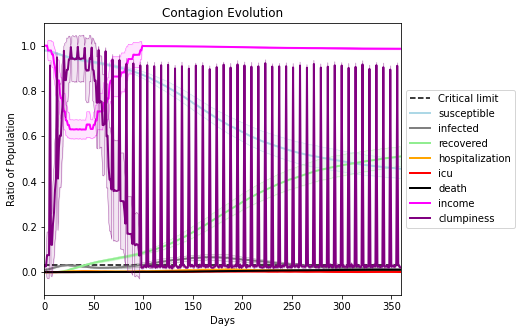

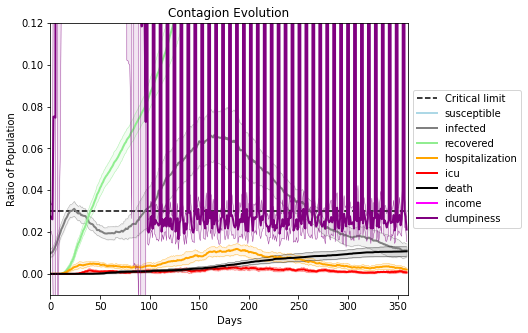

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3758, 9490, 7379, 8485, 1342, 2931, 6282, 125, 6372, 2242, 1713, 5634, 2379, 7688, 2707, 7563, 2604, 5295, 3990, 8415]
Average similarity between family members is 0.25409348128264364 at temperature -0.5
Average similarity between family and home is 0.9998441684745201 at temperature -1
Average similarity between students and their classroom is 0.16395475881523563 at temperature -0.5
Average classroom occupancy is 4.114285714285714 and number classrooms is 70
Average similarity between workers is 0.14473369052148152 at temperature -0.5
Average office occupancy is 3.187192118226601 and number offices is 203
Average friend similarity for adults: 0.3237773453442915 for kids: 0.20106358495215954
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.00592100045299071
avg restaurant similarity -0.2028375595975698
avg restaurant similarity 0.03258097058326664
avg restaurant similarity 0.40119863258802657
avg restaurant similarity 0.25016881197289353
avg restaurant similarity 0.16655916167540746
avg restaurant similarity 0.008976259927484801
avg restaurant similarity -0.06488135632996064
avg restaurant similarity 0.4904864681402507
avg restaurant similarity -0.14766401207426585
avg restaurant similarity 0.14945373760076047
avg restaurant similarity 0.3560507660930973
avg restaurant similarity 0.09249573759064461
avg restaurant similarity 0.35222758899659845
avg restaurant similarity -0.0036494101334493267
avg restaurant similarity 0.03852789697958044
avg restaurant similarity 0.31964624177508166
avg restaurant similarity -0.16836527544814256
avg restaurant similarity 0.2468702480669761
avg restaurant similarity 0.29651181134734006
avg restaurant similarity -0.05959772208404186
avg restaurant similarity -0.

avg restaurant similarity 0.4828446691630867
avg restaurant similarity 0.48027851222708084
avg restaurant similarity 0.15245697262821203
avg restaurant similarity -0.0901242223907958
avg restaurant similarity -0.0723979436415996
avg restaurant similarity 0.17603245336494813
avg restaurant similarity -0.04723450348972648
avg restaurant similarity 0.36694184520683804
avg restaurant similarity -0.25862052741111435
avg restaurant similarity -0.02339856138851959
avg restaurant similarity 0.033537153446575325
avg restaurant similarity -0.009762001334375298
avg restaurant similarity 0.2436558602321433
avg restaurant similarity 0.1748317413679972
avg restaurant similarity -0.05201881247819963
avg restaurant similarity 0.12166946991916704
avg restaurant similarity 0.279993657896642
avg restaurant similarity 0.10671626415853247
avg restaurant similarity 0.35222758899659845
avg restaurant similarity 0.0009892960669175346
avg restaurant similarity 0.14221419603383578
avg restaurant similarity -0.0

avg restaurant similarity 0.17935939715317042
avg restaurant similarity -0.011608437526639648
avg restaurant similarity 0.373421009353493
avg restaurant similarity 0.23114461046367857
avg restaurant similarity 0.039229279359623476
avg restaurant similarity 0.1334572138599833
avg restaurant similarity 0.29838316677221094
avg restaurant similarity 0.019634218404858565
avg restaurant similarity -0.02793281113201143
avg restaurant similarity 0.23655515756892412
avg restaurant similarity 0.06953202125004508
avg restaurant similarity -0.2216659169218268
avg restaurant similarity 0.2033189160285643
avg restaurant similarity 0.5656889314263516
avg restaurant similarity -0.017684752016570382
avg restaurant similarity 0.47014200710939513
avg restaurant similarity 0.260610168725098
avg restaurant similarity -0.19531767725547833
avg restaurant similarity 0.275961379495741
avg restaurant similarity 0.14289107033848722
avg restaurant similarity -0.06980088627987713
avg restaurant similarity -0.53606

avg restaurant similarity -0.03142221559878808
avg restaurant similarity 0.5042147313295298
avg restaurant similarity 0.023929690430151224
avg restaurant similarity 0.12763380939166086
avg restaurant similarity 0.200111735300564
avg restaurant similarity 0.21234150105227556
avg restaurant similarity 0.28895626558513154
avg restaurant similarity -0.1814106291817717
avg restaurant similarity -0.11773324106807047
avg restaurant similarity -0.10673212344222552
avg restaurant similarity -0.044018036074128436
avg restaurant similarity 0.7113342181747446
avg restaurant similarity 0.0762431993464325
avg restaurant similarity 0.08001831343553947
avg restaurant similarity 0.09562890217504275
avg restaurant similarity -0.04564753415839565
avg restaurant similarity -0.06286428509619829
avg restaurant similarity 0.18088195640926105
avg restaurant similarity 0.17228564592897105
avg restaurant similarity -0.012713303588869518
avg restaurant similarity 0.26080011547232895
avg restaurant similarity 0.1

avg restaurant similarity -0.029848869697010935
avg restaurant similarity 0.4609928144204453
avg restaurant similarity 0.2532376542987044
avg restaurant similarity -0.17801779497902315
avg restaurant similarity 0.029950112911014397
avg restaurant similarity 0.519304004987549
avg restaurant similarity 0.5505607405277861
avg restaurant similarity -0.01457247085865998
avg restaurant similarity 0.519304004987549
avg restaurant similarity -0.18217657829240563
avg restaurant similarity 0.040591731020589016
avg restaurant similarity -0.05321411382620442
avg restaurant similarity 0.0324006214542421
avg restaurant similarity 0.20968710889443232
avg restaurant similarity 0.11979429086903864
avg restaurant similarity -0.029774772727576428
avg restaurant similarity -0.09249608442036736
avg restaurant similarity 0.11411569056328101
avg restaurant similarity -0.003821228658207637
avg restaurant similarity 0.3818708385378514
avg restaurant similarity 0.025454898350789484
avg restaurant similarity 0.1

avg restaurant similarity -0.028561678014018467
avg restaurant similarity -0.013400457647204966
avg restaurant similarity -0.20381799865900346
avg restaurant similarity 0.1633707618626744
avg restaurant similarity 0.2087757664764384
avg restaurant similarity 0.28052037679961705
avg restaurant similarity -0.0223569437642413
avg restaurant similarity -0.21745562167041066
avg restaurant similarity 0.4611850379868036
avg restaurant similarity 0.024346348762468772
avg restaurant similarity 0.089360106562003
avg restaurant similarity -0.013400457647204966
avg restaurant similarity -0.1519337016475525
avg restaurant similarity 0.168060904319729
avg restaurant similarity -0.07205156508690733
avg restaurant similarity -0.07161551147231743
avg restaurant similarity -0.07593993920635209
avg restaurant similarity 0.34473809050240056
avg restaurant similarity 0.11598717009913466
avg restaurant similarity 0.031719890947656815
avg restaurant similarity 0.4611850379868036
avg restaurant similarity 0.1

avg restaurant similarity 0.022527931830853026
avg restaurant similarity 0.09719215937280232
avg restaurant similarity 0.066974337709739
avg restaurant similarity -0.14578288271597414
avg restaurant similarity -0.09880491408718221
avg restaurant similarity 0.47652401413326906
avg restaurant similarity -0.09309202810173026
avg restaurant similarity 0.1131670549496975
avg restaurant similarity 0.21629258791308614
avg restaurant similarity 0.14952074644999286
avg restaurant similarity 0.09525094552090567
avg restaurant similarity 0.1544103270993402
avg restaurant similarity 0.3741660796844105
avg restaurant similarity -0.003500901877425029
avg restaurant similarity 0.06444315485432697
avg restaurant similarity 0.32637171754827077
avg restaurant similarity 0.33260977387842167
avg restaurant similarity -0.2149668272499373
avg restaurant similarity -0.003500901877425029
avg restaurant similarity 0.25083747715019866
avg restaurant similarity -0.19746524156938094
avg restaurant similarity -0.0

avg restaurant similarity 0.06660957806519759
avg restaurant similarity -0.17489271743700696
avg restaurant similarity 0.41136282914730193
avg restaurant similarity 0.7306380892757331
avg restaurant similarity 0.2162230386653582
avg restaurant similarity 0.5027099217546384
avg restaurant similarity 0.4292991033950016
avg restaurant similarity 0.16683986216555646
avg restaurant similarity 0.12702147536791353
avg restaurant similarity 0.0019571362374888354
avg restaurant similarity 0.05723056394690504
avg restaurant similarity -0.031124442742647078
avg restaurant similarity 0.4519802755263912
avg restaurant similarity -0.007716185751714039
avg restaurant similarity -0.11237542262417761
avg restaurant similarity 0.2015676540760293
avg restaurant similarity 0.374879894124428
avg restaurant similarity 0.4472353776427012
avg restaurant similarity 0.03400865864185976
avg restaurant similarity -0.015142050360332907
avg restaurant similarity 0.28243320213722617
avg restaurant similarity 0.17380

avg restaurant similarity -0.17947200221018
avg restaurant similarity -0.09276911559717675
avg restaurant similarity -0.09206502483519721
avg restaurant similarity 0.5021338874826926
avg restaurant similarity 0.023991654639228553
avg restaurant similarity -0.056484899925361834
avg restaurant similarity 0.5772592790770512
avg restaurant similarity 0.021615440884034776
avg restaurant similarity 0.29309324460004815
avg restaurant similarity 0.031172070991830017
avg restaurant similarity -0.04397176711582878
avg restaurant similarity 0.1714497859587381
avg restaurant similarity 0.555617779408869
avg restaurant similarity 0.04840418192347555
avg restaurant similarity 0.2564384561121839
avg restaurant similarity 0.04915431834746695
avg restaurant similarity 0.06148298506015447
avg restaurant similarity -0.05791764303885508
avg restaurant similarity 0.48467554792655565
avg restaurant similarity 0.28528904420783247
avg restaurant similarity -0.016997106859327555
avg restaurant similarity 0.154

avg restaurant similarity -0.13111698992013085
avg restaurant similarity -0.09942670750002856
avg restaurant similarity 0.20827088590177317
avg restaurant similarity 0.20264375985620192
avg restaurant similarity 0.033489862479599744
avg restaurant similarity -0.01355946136117385
avg restaurant similarity 0.007943045111605311
avg restaurant similarity -0.017346230594938353
avg restaurant similarity 0.233612474793931
avg restaurant similarity 0.06460785431032363
avg restaurant similarity 0.3569869614960719
avg restaurant similarity 0.4135431226396858
avg restaurant similarity 0.21541715788405708
avg restaurant similarity -0.2564598360496809
avg restaurant similarity -0.2331240405181575
avg restaurant similarity 0.10953511002349549
avg restaurant similarity -0.2260483474390974
avg restaurant similarity -0.2391054147006625
avg restaurant similarity 0.3186774214811344
avg restaurant similarity 0.6117342229562884
avg restaurant similarity -0.03786628622632325
avg restaurant similarity -0.101

avg restaurant similarity 0.06050226530176662
avg restaurant similarity 0.29610178831388023
avg restaurant similarity 0.09416197676682143
avg restaurant similarity 0.438719902781079
avg restaurant similarity 0.6153679436678001
avg restaurant similarity 0.15873708385773955
avg restaurant similarity 0.5145662349502527
avg restaurant similarity 0.3610126519621559
avg restaurant similarity -0.10724677455347682
avg restaurant similarity 0.08279086939978184
avg restaurant similarity -0.20710280130730097
avg restaurant similarity 0.0862930693526579
avg restaurant similarity 0.40663701138208685
avg restaurant similarity 0.11009501784024209
avg restaurant similarity -0.4053041839683016
avg restaurant similarity 0.16693703447016098
avg restaurant similarity -0.03968100815356664
avg restaurant similarity 0.24020513225385673
avg restaurant similarity 0.021956070717341496
avg restaurant similarity 0.23644678268721334
avg restaurant similarity -0.07047430073458875
avg restaurant similarity -0.022961

avg restaurant similarity 0.23716076612081705
avg restaurant similarity -0.1649808277206713
avg restaurant similarity 0.31348297817471094
avg restaurant similarity 0.16113378877306295
avg restaurant similarity -0.003020797765912034
avg restaurant similarity 0.024592447993462024
avg restaurant similarity 0.11250436756245545
avg restaurant similarity -0.3567707559743284
avg restaurant similarity 0.1223397337066391
avg restaurant similarity -0.5295856927079452
avg restaurant similarity -0.04412191587270084
avg restaurant similarity 0.37671803824701644
avg restaurant similarity 0.29529552202024845
avg restaurant similarity 0.1523757923138911
avg restaurant similarity 0.2260064240500888
avg restaurant similarity 0.07115284003742336
avg restaurant similarity 0.4585521263841671
avg restaurant similarity 0.41059821732828344
avg restaurant similarity -0.006164956763173274
avg restaurant similarity 0.13766861717132203
avg restaurant similarity 0.1080319934616705
avg restaurant similarity -0.0647

avg restaurant similarity 0.1891919496103906
avg restaurant similarity 0.06085724188736975
avg restaurant similarity 0.1214087748388541
avg restaurant similarity 0.2455412545729239
avg restaurant similarity 0.25236581272721964
avg restaurant similarity -0.008978226109853826
avg restaurant similarity 0.09134655439356473
avg restaurant similarity -0.3393238304382243
avg restaurant similarity -0.26268791564470234
avg restaurant similarity -0.10634748693484605
avg restaurant similarity 0.19973536784344853
avg restaurant similarity 0.30965146588261727
avg restaurant similarity 0.19474218822190517
avg restaurant similarity 0.027901572560559224
avg restaurant similarity 0.1887690065573565
avg restaurant similarity 0.18653378634680645
avg restaurant similarity 0.3906224182854636
avg restaurant similarity 0.15015704685054065
avg restaurant similarity 0.04264226866674659
avg restaurant similarity 0.11564514719104149
avg restaurant similarity 0.12527411492407156
avg restaurant similarity -0.09772

avg restaurant similarity 0.25866811400049605
avg restaurant similarity -0.05519159837854942
avg restaurant similarity -0.020799095300152073
avg restaurant similarity 0.29290176653726824
avg restaurant similarity 0.18095165242191738
avg restaurant similarity 0.22030484689687707
avg restaurant similarity 0.6326859926674577
avg restaurant similarity -0.02227488674523055
avg restaurant similarity -0.09196648996493696
avg restaurant similarity 0.03227628811629135
avg restaurant similarity 0.3461867299202787
avg restaurant similarity 0.5596458945014526
avg restaurant similarity 0.15163638315068714
avg restaurant similarity 0.006457186524113735
avg restaurant similarity 0.07109772898606119
avg restaurant similarity -0.25195246482147826
avg restaurant similarity 0.5333238952010033
avg restaurant similarity 0.07692365023205994
avg restaurant similarity 0.345383111398718
avg restaurant similarity 0.1220428688447637
avg restaurant similarity 0.15326724962626045
avg restaurant similarity 0.352143

avg restaurant similarity -0.364933978301247
avg restaurant similarity 0.3954655543683733
avg restaurant similarity 0.030840943629547514
avg restaurant similarity 0.35668797761026816
avg restaurant similarity 0.15211730280924673
avg restaurant similarity -0.05717940808504613
avg restaurant similarity 0.058400695470536904
avg restaurant similarity -0.34283793808223684
avg restaurant similarity 0.047269670316388776
avg restaurant similarity -0.03561924080081233
avg restaurant similarity 0.10411929728554503
avg restaurant similarity -0.09657833899119178
avg restaurant similarity -0.08202372912020008
avg restaurant similarity -0.06758209226589601
avg restaurant similarity 0.09599866980523347
avg restaurant similarity 0.1979794240748184
avg restaurant similarity 0.45603033288264283
avg restaurant similarity 0.41587806079940615
avg restaurant similarity 0.04396534101766953
avg restaurant similarity 0.48674367348493075
avg restaurant similarity 0.056492904038277406
avg restaurant similarity 0

avg restaurant similarity -0.03288718710309044
avg restaurant similarity 0.033652952615733284
avg restaurant similarity -0.08114293583056506
avg restaurant similarity -0.24510306609531798
avg restaurant similarity 0.044685058803136654
avg restaurant similarity -0.03896722310916327
avg restaurant similarity -0.055230096559840305
avg restaurant similarity -0.30090509055185993
avg restaurant similarity 0.09412336145282746
avg restaurant similarity -0.01748101353832439
avg restaurant similarity -0.09468231523612324
avg restaurant similarity -0.2930971883173696
avg restaurant similarity 0.3463475243140005
avg restaurant similarity 0.04613213725800558
avg restaurant similarity 0.0592588933894391
avg restaurant similarity 0.5155372299155185
avg restaurant similarity 0.28946872085159575
avg restaurant similarity 0.05296940984812465
avg restaurant similarity -0.22591893325003598
avg restaurant similarity 0.18292902142771622
avg restaurant similarity -0.22011688611620292
avg restaurant similarit

avg restaurant similarity 0.13178197670708008
avg restaurant similarity -0.47361435992798595
avg restaurant similarity 0.025293555141410025
avg restaurant similarity 0.19924165677934086
avg restaurant similarity 0.3150026233773492
avg restaurant similarity -0.006956357399276872
avg restaurant similarity -0.34197012546104255
avg restaurant similarity 0.16383002320200724
avg restaurant similarity 0.19050947325573456
avg restaurant similarity 0.05139789147405627
avg restaurant similarity -0.40240709587539614
avg restaurant similarity -0.13385619125647796
avg restaurant similarity 0.09760593362437289
avg restaurant similarity -0.575489730054506
avg restaurant similarity -0.04646338184709972
avg restaurant similarity 0.431682677354781
avg restaurant similarity -0.051140204436132264
avg restaurant similarity -0.15344510370272385
avg restaurant similarity 0.2031445524754742
avg restaurant similarity -0.05266010568804717
avg restaurant similarity 0.07483186956459714
avg restaurant similarity 0

avg restaurant similarity -0.042765602767128444
avg restaurant similarity 0.1481663227101549
avg restaurant similarity 0.3103693934738191
avg restaurant similarity 0.018285664499617715
avg restaurant similarity 0.04496650392310196
avg restaurant similarity 0.11696307925354035
avg restaurant similarity 0.023996891209287465
avg restaurant similarity 0.24219327019220233
avg restaurant similarity 0.30846292768777095
avg restaurant similarity 0.008578483541914692
avg restaurant similarity -0.12392170400109996
avg restaurant similarity 0.06388265351446444
avg restaurant similarity -0.25755931860241466
avg restaurant similarity 0.11498760564476015
avg restaurant similarity 0.03090561955887543
avg restaurant similarity 0.02403463726579977
avg restaurant similarity -0.25939587388117225
avg restaurant similarity 0.013218202470950631
avg restaurant similarity -0.1475372952653647
avg restaurant similarity 0.6635865148050752
avg restaurant similarity -0.3701037113675837
avg restaurant similarity 0.

avg restaurant similarity 0.1103913605898794
avg restaurant similarity -0.030315313899131995
avg restaurant similarity -0.4741503421053326
avg restaurant similarity -0.09322139690588782
avg restaurant similarity 0.06668329589638532
avg restaurant similarity 0.08943391277674902
avg restaurant similarity 0.11106423747334895
avg restaurant similarity 0.1684764410054244
avg restaurant similarity 0.167608180120297
avg restaurant similarity -0.2375021752887636
avg restaurant similarity 0.00706571742547472
avg restaurant similarity 0.12516390066470712
avg restaurant similarity 0.08647579218468109
avg restaurant similarity -0.01336162632799059
avg restaurant similarity 0.45364145547363266
avg restaurant similarity -0.18282439843546816
Average similarity between family members is 0.2314542866521903 at temperature -0.5
Average similarity between family and home is 0.9998626494546692 at temperature -1
Average similarity between students and their classroom is 0.1639007707874878 at temperature -0.

avg restaurant similarity 0.1942209720204715
avg restaurant similarity 0.25223427430909146
avg restaurant similarity 0.2560167147267898
avg restaurant similarity 0.049406669636329975
avg restaurant similarity 0.11016364760838865
avg restaurant similarity 0.2870126383651838
avg restaurant similarity -0.0022374821180814373
avg restaurant similarity 0.35731717616451275
avg restaurant similarity 0.12645046689648767
avg restaurant similarity 0.1558104500823425
avg restaurant similarity 0.37578044775447145
avg restaurant similarity 0.350145213170021
avg restaurant similarity 0.52238287179378
avg restaurant similarity -0.16243658899388075
avg restaurant similarity 0.26047105038244606
avg restaurant similarity -0.07835402143568924
avg restaurant similarity -0.1027225919422052
avg restaurant similarity 0.446774406730749
avg restaurant similarity 0.46473617900272157
avg restaurant similarity 0.06612872443158682
avg restaurant similarity 0.15281276043236447
avg restaurant similarity 0.56696483068

avg restaurant similarity 0.1869836832231419
avg restaurant similarity 0.483909158358162
avg restaurant similarity 0.45765856640497904
avg restaurant similarity 0.11725997142184798
avg restaurant similarity 0.07164234025505951
avg restaurant similarity 0.27683197317124275
avg restaurant similarity 0.8062719219457755
avg restaurant similarity 0.2766590494391495
avg restaurant similarity 0.044265019132542424
avg restaurant similarity 0.21854255383920657
avg restaurant similarity -0.41882002999259127
avg restaurant similarity 0.03955106027192884
avg restaurant similarity 0.05821229771909013
avg restaurant similarity 0.1521781981014952
avg restaurant similarity -0.05966122855200451
avg restaurant similarity -0.0048765413048036665
avg restaurant similarity 0.7231652382151922
avg restaurant similarity -0.12579389579162265
avg restaurant similarity 0.2722447824652166
avg restaurant similarity 0.10877901237826895
avg restaurant similarity 0.40403161260935533
avg restaurant similarity 0.7561569

avg restaurant similarity 0.11708305973261354
avg restaurant similarity -0.08440900931481096
avg restaurant similarity 0.2702899528595723
avg restaurant similarity 0.3994832684311488
avg restaurant similarity -0.10597803287155895
avg restaurant similarity 0.07669054772707012
avg restaurant similarity 0.03434958485199379
avg restaurant similarity 0.2162303585264403
avg restaurant similarity -0.16372934748279877
avg restaurant similarity 0.2565880876448342
avg restaurant similarity 0.09346688925794117
avg restaurant similarity 0.03447966088063399
avg restaurant similarity -0.3780515562967155
avg restaurant similarity -0.059033978629471455
avg restaurant similarity 0.40858902368932265
avg restaurant similarity 0.06766335176064456
avg restaurant similarity 0.35126940034514087
avg restaurant similarity 0.016056269565820052
avg restaurant similarity -0.23347187425501398
avg restaurant similarity 0.49267136660927374
avg restaurant similarity 0.16785567656815728
avg restaurant similarity 0.027

Average similarity between workers is 0.16887034370295717 at temperature -0.5
Average office occupancy is 3.103960396039604 and number offices is 202
Average friend similarity for adults: 0.31669657808399204 for kids: 0.19200306178168533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.1423532667802705
avg restaurant similarity 0.2649835860709384
avg restaurant similarity 0.11366310904038894
avg restaurant similarity 0.07707577201944171
avg restaurant similarity -0.0674899270099716
avg restaurant similarity 0.4081928539892383
avg restaurant similarity -0.0989047932548412
avg restaurant similarity 0.603044042302141
avg restaurant similarity 0.1614970579231513
avg restaurant similarity -0.015739823653648767
avg restaurant similarity 0.28583122752894846
avg restaurant similarity -0.14039248236194637
avg restaurant similarity -0.07845906375487216
avg restaurant similarity -0.020796154832705506
avg restaurant similarity 0.5005722205080656
avg restaurant similarity -0.1856342246321808
avg restaurant similarity 0.5491136525834807
avg restaurant similarity 0.2821350781646834
avg restaurant similarity 0.24781166167609872
avg restaurant similarity 0.09213180761519617
avg restaurant similarity -0.3346415960369025
avg restaurant similarity -0.05203349

(<function dict.items>, <function dict.items>, <function dict.items>)

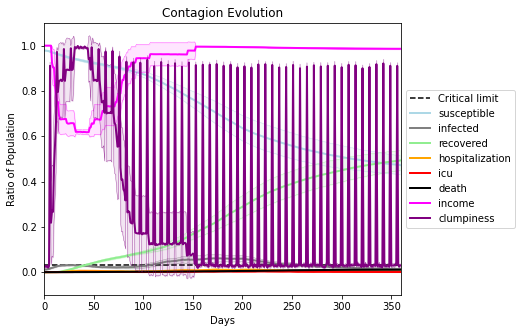

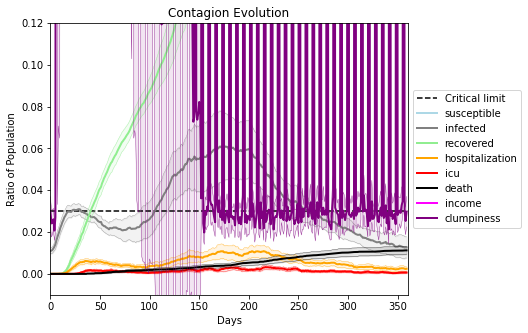

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5876, 245, 3056, 9803, 8416, 9356, 8168, 8418, 104, 7401, 623, 8440, 1651, 2103, 5567, 8038, 7883, 3504, 5453, 6797]
Average similarity between family members is 0.21827604806125184 at temperature -0.4
Average similarity between family and home is 0.999850013280173 at temperature -1
Average similarity between students and their classroom is 0.18400513371735588 at temperature -0.4
Average classroom occupancy is 3.971830985915493 and number classrooms is 71
Average similarity between workers is 0.1497207404459744 at temperature -0.4
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.2784008236122977 for kids: 0.20276876265251648
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity -0.45233669033391954
avg restaurant similarity 0.222889752881678
avg restaurant similarity -0.02260657873581004
avg restaurant similarity -0.30634445800843924
avg restaurant similarity 0.1390710199330681
avg restaurant similarity 0.030057064035134515
avg restaurant similarity 0.1290161912658
avg restaurant similarity 0.5613381791688429
avg restaurant similarity 0.20201326321671548
avg restaurant similarity -0.431633432850776
avg restaurant similarity 0.37962486848220756
avg restaurant similarity -0.10337643635685637
avg restaurant similarity 0.2160999385006061
avg restaurant similarity 0.36539175049304906
avg restaurant similarity 0.06067580753397588
avg restaurant similarity -0.06765044638188863
avg restaurant similarity 0.27833031655787677
avg restaurant similarity 0.05985398654519854
avg restaurant similarity 0.033323298566918354
avg restaurant similarity -0.4063803998053499
avg restaurant similarity 0.06067580753397588
avg restaurant similarity 0.138268960

Average similarity between family members is 0.2226079202772296 at temperature -0.4
Average similarity between family and home is 0.9998662580989166 at temperature -1
Average similarity between students and their classroom is 0.16445121806019852 at temperature -0.4
Average classroom occupancy is 4.2 and number classrooms is 70
Average similarity between workers is 0.14966808097517115 at temperature -0.4
Average office occupancy is 3.1690821256038646 and number offices is 207
Average friend similarity for adults: 0.2846211269978829 for kids: 0.19484804032368228
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district wi

avg restaurant similarity -0.14405494517355427
avg restaurant similarity 0.3992777063291779
avg restaurant similarity 0.33175006911701255
avg restaurant similarity 0.21084954960632385
avg restaurant similarity 0.26253769061419524
avg restaurant similarity -0.22759612842682853
avg restaurant similarity -0.2516888273669342
avg restaurant similarity 0.10776234311699959
avg restaurant similarity 0.11781441432080197
avg restaurant similarity 0.26854749237108977
avg restaurant similarity 0.2314496774389317
avg restaurant similarity 0.3422323605861318
avg restaurant similarity -0.07350111501929574
avg restaurant similarity 0.039259940220198165
avg restaurant similarity 0.04172830885618011
avg restaurant similarity 0.15545577054802784
avg restaurant similarity 0.028358334649882758
avg restaurant similarity 0.3648698519314324
avg restaurant similarity 0.11321096683731513
avg restaurant similarity 0.06762038318595104
avg restaurant similarity -0.03724568101402965
avg restaurant similarity 0.1522

avg restaurant similarity 0.18433595428715152
avg restaurant similarity 0.24247544466671708
avg restaurant similarity -0.04977632300769683
avg restaurant similarity 0.2395438191247392
avg restaurant similarity 0.10546638189124191
avg restaurant similarity 0.29352707816052526
avg restaurant similarity -0.26621553298007916
avg restaurant similarity 0.18136985802495317
avg restaurant similarity 0.032838657211755114
avg restaurant similarity 0.09346445576989026
avg restaurant similarity 0.12151746001800752
avg restaurant similarity 0.1488976421072918
avg restaurant similarity 0.22716190442691953
avg restaurant similarity 0.03357251536420959
avg restaurant similarity 0.12109192082517128
avg restaurant similarity 0.16393285030136062
avg restaurant similarity -0.3008535309368942
avg restaurant similarity 0.12291687836185104
avg restaurant similarity -0.06797943279453028
avg restaurant similarity -0.020153765918863725
avg restaurant similarity 0.23668597928194457
avg restaurant similarity -0.1

avg restaurant similarity 0.4234138890298989
avg restaurant similarity 0.04723536820917618
avg restaurant similarity -0.031864805387331524
avg restaurant similarity 0.2152069287429086
avg restaurant similarity -0.2101567616124946
avg restaurant similarity 0.13527450832978877
avg restaurant similarity -0.4683302909441046
avg restaurant similarity 0.31659584988019374
avg restaurant similarity 0.08527473553486273
avg restaurant similarity 0.0038953237021998894
avg restaurant similarity 0.42801356627479015
avg restaurant similarity -0.02125346827852819
avg restaurant similarity 0.24868270851428145
avg restaurant similarity 0.11614716663081709
avg restaurant similarity -0.21960874536259634
avg restaurant similarity -0.43935222102156973
avg restaurant similarity 0.3674789406238105
avg restaurant similarity 0.27837403477577244
avg restaurant similarity 0.3708614550231256
avg restaurant similarity 0.37324704142130016
avg restaurant similarity 0.31497020084511546
avg restaurant similarity 0.226

avg restaurant similarity 0.18173806238154738
avg restaurant similarity 0.12279652885742906
avg restaurant similarity 0.2920013796234613
avg restaurant similarity -0.21501463713621577
avg restaurant similarity -0.21832185678068233
avg restaurant similarity -0.02302281165851608
avg restaurant similarity -0.2734127599378668
avg restaurant similarity 0.30112902441022027
avg restaurant similarity 0.23456648960099574
avg restaurant similarity 0.16477469457268057
avg restaurant similarity -0.12321750054519681
avg restaurant similarity -0.04431816178447184
avg restaurant similarity -0.12401116337447715
avg restaurant similarity 0.005900444618427175
avg restaurant similarity 0.40227637721136
avg restaurant similarity -0.09972012731550424
avg restaurant similarity 0.03328676337640327
avg restaurant similarity -0.11044904261429825
avg restaurant similarity -0.32844766841085876
avg restaurant similarity 0.5302085448499065
avg restaurant similarity 0.4672514940445335
avg restaurant similarity 0.35

avg restaurant similarity 0.18956621735805274
avg restaurant similarity -0.3476065348186572
avg restaurant similarity -0.28782647955010127
avg restaurant similarity -0.27696536000113614
avg restaurant similarity 0.4051381188811917
avg restaurant similarity -0.014953758527957772
avg restaurant similarity 0.3545234422729921
avg restaurant similarity -0.10271023248986655
avg restaurant similarity 0.6365729074303947
avg restaurant similarity 0.0034910264283032197
avg restaurant similarity -0.1379017176944021
avg restaurant similarity -0.06556556674935532
avg restaurant similarity -0.28392681352567806
avg restaurant similarity -0.029823134297266574
avg restaurant similarity -0.029070226652520154
avg restaurant similarity 0.009036784564022385
avg restaurant similarity 0.24918781514521102
avg restaurant similarity -0.18588737788983112
avg restaurant similarity -0.1054844407314647
avg restaurant similarity 0.14088451287979584
avg restaurant similarity -0.0615737833106556
avg restaurant similar

avg restaurant similarity -0.025440142573669396
avg restaurant similarity 0.16332004364174568
avg restaurant similarity 0.0940558983092626
Average similarity between family members is 0.23045530583612409 at temperature -0.4
Average similarity between family and home is 0.9998528795474563 at temperature -1
Average similarity between students and their classroom is 0.20035252412210058 at temperature -0.4
Average classroom occupancy is 4.242857142857143 and number classrooms is 70
Average similarity between workers is 0.1627661007871316 at temperature -0.4
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.28167182796346757 for kids: 0.20426912637041195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with ca

avg restaurant similarity 0.15655081342494703
avg restaurant similarity 0.5307509239092425
avg restaurant similarity -0.02566557886792875
avg restaurant similarity 0.44648592242991314
avg restaurant similarity 0.03976399588673416
avg restaurant similarity 0.3421252499182831
avg restaurant similarity 0.06485818987548045
avg restaurant similarity 0.19912541342136428
avg restaurant similarity -0.04334657004643591
avg restaurant similarity 0.3227319419732264
avg restaurant similarity 0.27306457124944894
avg restaurant similarity 0.02209158396205463
avg restaurant similarity -0.23299049607908742
avg restaurant similarity -0.015848529214974247
avg restaurant similarity 0.10113296343626776
avg restaurant similarity 0.6355550900725417
avg restaurant similarity 0.47194963242562543
avg restaurant similarity 0.18332765772820933
avg restaurant similarity 0.10306916609751832
avg restaurant similarity 0.3113565948023762
avg restaurant similarity 0.12326800223388981
avg restaurant similarity -0.08053

avg restaurant similarity 0.22725085615580828
avg restaurant similarity 0.4171940242608097
avg restaurant similarity -0.12380518115404368
avg restaurant similarity 0.02860697130977205
avg restaurant similarity 0.2942351071913376
avg restaurant similarity 0.12688144295905285
avg restaurant similarity -0.008380285561504807
avg restaurant similarity 0.23424596717293744
avg restaurant similarity 0.2675291168177838
avg restaurant similarity -0.010680756247386104
avg restaurant similarity 0.08658912766684079
avg restaurant similarity 0.19526920351473975
avg restaurant similarity 0.028641754343503398
avg restaurant similarity 0.418229304444269
avg restaurant similarity -0.20888521935563686
avg restaurant similarity 0.1395263274320574
avg restaurant similarity 0.046596510959312804
avg restaurant similarity 0.35887598599024
avg restaurant similarity 0.11147693007207063
avg restaurant similarity 0.21492186835619403
avg restaurant similarity 0.1647324273693148
avg restaurant similarity 0.07357451

avg restaurant similarity 0.05488518463492743
avg restaurant similarity -0.045587436552699104
avg restaurant similarity -0.25481818142932516
avg restaurant similarity 0.3483510806649447
avg restaurant similarity 0.1409205144537401
avg restaurant similarity 0.17865219027978443
avg restaurant similarity -0.13130999623618725
avg restaurant similarity -0.04551720933516195
avg restaurant similarity 0.05003399278934044
avg restaurant similarity 0.3749345950515137
avg restaurant similarity -0.3649991869436195
avg restaurant similarity 0.4841990818616711
avg restaurant similarity 0.040632625496495454
avg restaurant similarity -0.07466971072275604
avg restaurant similarity -0.19291004956367885
avg restaurant similarity 0.2964862253821614
avg restaurant similarity -0.03839337313388101
avg restaurant similarity -0.12746447289560564
avg restaurant similarity 0.6964070555413594
avg restaurant similarity 0.14359190241572353
avg restaurant similarity -0.04771732330067832
avg restaurant similarity -0.

avg restaurant similarity -0.02836661177665629
avg restaurant similarity -0.03710725064915734
avg restaurant similarity -0.049784828548771344
avg restaurant similarity 0.07017096602571088
avg restaurant similarity 0.02806738021550731
avg restaurant similarity -0.0185922151537637
avg restaurant similarity 0.29450963900811683
avg restaurant similarity 0.4628782085360129
avg restaurant similarity 0.16314609803490304
avg restaurant similarity 0.10239201081339215
avg restaurant similarity -0.10826796529827254
avg restaurant similarity -0.04231551420645807
avg restaurant similarity 0.2013046181985377
avg restaurant similarity 0.017176989362504887
avg restaurant similarity 0.13666018181258716
avg restaurant similarity -0.08141204073917273
avg restaurant similarity -0.21887644240502
avg restaurant similarity 0.3416162855802113
avg restaurant similarity 0.06861269393842433
avg restaurant similarity -0.13843183975574275
avg restaurant similarity 0.2813203559992369
avg restaurant similarity 0.178

avg restaurant similarity 0.16513068409397968
avg restaurant similarity -0.1581302125894315
avg restaurant similarity 0.14681468335856443
avg restaurant similarity 0.26065701656755674
avg restaurant similarity 0.005903590650900854
avg restaurant similarity 0.1503622414420464
avg restaurant similarity 0.1707051283843295
avg restaurant similarity 0.2303460989004631
avg restaurant similarity -0.15193036495779133
avg restaurant similarity 0.26065701656755674
avg restaurant similarity 0.1465260045106907
avg restaurant similarity 0.13036499327342116
avg restaurant similarity -0.16272258627249747
avg restaurant similarity 0.09909952660194038
avg restaurant similarity 0.12725517436101969
avg restaurant similarity 0.2659917850548796
avg restaurant similarity 0.2929855403792221
avg restaurant similarity 0.13401538608312924
avg restaurant similarity 0.6824098013431417
avg restaurant similarity 0.4788410893312063
avg restaurant similarity 0.48932122688560215
avg restaurant similarity -0.1049263946

avg restaurant similarity 0.24301318467967095
avg restaurant similarity 0.2944937481915606
avg restaurant similarity -0.33262398963182327
avg restaurant similarity 0.22849079895159194
avg restaurant similarity 0.19701490637321997
avg restaurant similarity -0.0679743174241213
avg restaurant similarity 0.5991740608250266
avg restaurant similarity 0.058611034681875805
avg restaurant similarity 0.142926971979311
avg restaurant similarity 0.27843406402819626
avg restaurant similarity 0.03865046074380678
avg restaurant similarity 0.3018014957788943
avg restaurant similarity 0.37091433251294387
avg restaurant similarity 0.07806744975928005
avg restaurant similarity -0.09623296245720578
avg restaurant similarity -0.33262398963182327
avg restaurant similarity 0.16715654016761114
avg restaurant similarity 0.13546921882968002
avg restaurant similarity 0.38707845414263736
avg restaurant similarity 0.2561266937604006
avg restaurant similarity -0.2250913877718774
avg restaurant similarity 0.23552502

avg restaurant similarity -0.05482185484948743
avg restaurant similarity 0.1704852115995075
avg restaurant similarity -0.005718750400308226
avg restaurant similarity 0.028784603751957155
avg restaurant similarity -0.062169074648214376
avg restaurant similarity -0.01810514242091756
avg restaurant similarity -0.09415477786039478
avg restaurant similarity 0.1901149465082551
avg restaurant similarity 0.3806322525172461
avg restaurant similarity 0.012033374251602613
avg restaurant similarity -0.17259337551025533
avg restaurant similarity -0.08737835243348203
avg restaurant similarity 0.12264211577439202
avg restaurant similarity -0.009802817292593293
avg restaurant similarity -0.20673179128621488
avg restaurant similarity 0.40843265735978346
avg restaurant similarity -0.3511729841355358
avg restaurant similarity 0.0012664420682019957
avg restaurant similarity -0.2809164078167252
avg restaurant similarity 0.8728340308961563
avg restaurant similarity -0.2370826862360056
avg restaurant similar

avg restaurant similarity 0.2169684002759165
avg restaurant similarity -0.09098907847052612
avg restaurant similarity -0.20746767429304416
avg restaurant similarity 0.22938547916638255
avg restaurant similarity -0.04844180386987243
avg restaurant similarity -0.138834100416123
avg restaurant similarity 0.12248551249439972
avg restaurant similarity -0.13006393542167238
avg restaurant similarity -0.28411161074182917
avg restaurant similarity 0.22659135744086897
avg restaurant similarity -0.08637523336212147
avg restaurant similarity -0.06966277314267916
avg restaurant similarity -0.28411161074182917
avg restaurant similarity -0.3681420905516038
avg restaurant similarity -0.1508406894332994
avg restaurant similarity 0.05181659212835234
avg restaurant similarity 0.5236596534406575
avg restaurant similarity 0.42973142012536647
avg restaurant similarity 0.10093128144939587
avg restaurant similarity -0.14488990321429246
avg restaurant similarity 0.33300729078244506
avg restaurant similarity -0

avg restaurant similarity 0.3207661583086668
avg restaurant similarity 0.22478150910022565
avg restaurant similarity 0.11043013054743755
avg restaurant similarity 0.1450817371753836
avg restaurant similarity -0.10677841989897072
avg restaurant similarity -0.39423036117559257
avg restaurant similarity 0.3192378848518722
avg restaurant similarity -0.07686474972638499
avg restaurant similarity -0.12706579111150904
avg restaurant similarity -0.23538178027844048
avg restaurant similarity 0.3953686461754841
avg restaurant similarity 0.03671502287524703
avg restaurant similarity -0.21818950429830905
avg restaurant similarity 0.08409791629361302
avg restaurant similarity -0.13803971696819228
avg restaurant similarity -0.06646102129729616
avg restaurant similarity 0.1706807321261883
avg restaurant similarity -0.030195096399407026
avg restaurant similarity -0.07390019690574576
avg restaurant similarity 0.37418168939561713
avg restaurant similarity 0.2015190734830553
avg restaurant similarity 0.1

avg restaurant similarity 0.2266510842023961
avg restaurant similarity -0.313976112735901
avg restaurant similarity -0.06058281134069597
avg restaurant similarity -0.055995852531497414
avg restaurant similarity 0.2704484305948641
avg restaurant similarity -0.14200670761556697
avg restaurant similarity -0.09171871555159752
avg restaurant similarity 0.15190238975668696
avg restaurant similarity 0.10378371130743
avg restaurant similarity -0.1662254194248648
avg restaurant similarity -0.13786027590895272
avg restaurant similarity 0.24452619026280462
avg restaurant similarity -0.271550498272723
avg restaurant similarity 0.13087020113679057
avg restaurant similarity -0.313976112735901
avg restaurant similarity -0.16071919362045622
avg restaurant similarity 0.4824277644468905
avg restaurant similarity 0.09918289926158641
avg restaurant similarity -0.32236423311097584
avg restaurant similarity 0.11689810215564532
avg restaurant similarity -0.3707169734441213
avg restaurant similarity -0.250333

avg restaurant similarity 0.06972941309537861
avg restaurant similarity 0.15778084159838662
avg restaurant similarity 0.3588792391747856
avg restaurant similarity 0.18264348022558438
avg restaurant similarity -0.011901252287071708
avg restaurant similarity 0.08819074031252258
avg restaurant similarity 0.18264348022558438
avg restaurant similarity -0.1335989047078845
avg restaurant similarity 0.1879243482463578
avg restaurant similarity -0.0999667442385947
avg restaurant similarity -0.004067923855678723
avg restaurant similarity 0.24560076501561887
avg restaurant similarity 0.2557891990287762
avg restaurant similarity 0.21475444825727819
avg restaurant similarity 0.08509841215232555
avg restaurant similarity 0.10086290596846596
avg restaurant similarity 0.13397702160607045
avg restaurant similarity 0.5777740747009408
avg restaurant similarity 0.516862367169495
avg restaurant similarity -0.16542633505396603
avg restaurant similarity 0.2061735023775485
avg restaurant similarity 0.40720319

avg restaurant similarity 0.07090947794942347
avg restaurant similarity 0.1064822489255913
avg restaurant similarity 0.1773589947987541
avg restaurant similarity 0.3116426926627962
avg restaurant similarity 0.24236533200847576
avg restaurant similarity 0.1517541152160049
avg restaurant similarity 0.2442281992227562
avg restaurant similarity -0.4495295474745246
avg restaurant similarity -0.00210228711758792
avg restaurant similarity 0.4107121692515153
avg restaurant similarity 0.2449478309911046
avg restaurant similarity 0.2716096201353258
avg restaurant similarity -0.15338731688186805
avg restaurant similarity 0.28565625521889104
avg restaurant similarity -0.09239193566490217
avg restaurant similarity 0.2449478309911046
avg restaurant similarity -0.01156869864364997
avg restaurant similarity -0.2489549852900631
avg restaurant similarity 0.048719546028688755
avg restaurant similarity 0.28565625521889104
avg restaurant similarity -0.033933937083924816
avg restaurant similarity 0.59354392

avg restaurant similarity -0.09829587862233374
avg restaurant similarity 0.07767888509845931
avg restaurant similarity -0.005827633065488169
avg restaurant similarity 0.3374290537556588
avg restaurant similarity -0.20712355075487573
avg restaurant similarity 0.08893571572796638
avg restaurant similarity 0.10077147785637294
avg restaurant similarity 0.07277410715978089
avg restaurant similarity -0.04443323345278507
avg restaurant similarity 0.01274257997760754
avg restaurant similarity 0.07451851574679907
avg restaurant similarity -0.08743295539206526
avg restaurant similarity -0.206574273333116
avg restaurant similarity -0.15778965534429112
avg restaurant similarity -0.14841173598190743
avg restaurant similarity 0.027621387864207314
avg restaurant similarity -0.06424477102193998
avg restaurant similarity -0.224358470691691
avg restaurant similarity -0.10936750235028159
avg restaurant similarity 0.5430854981140895
avg restaurant similarity -0.033954390300417275
avg restaurant similarity

avg restaurant similarity 0.013137803477936647
avg restaurant similarity 0.04923844180609188
avg restaurant similarity 0.2047647253055144
avg restaurant similarity 0.08466296663387401
avg restaurant similarity -0.10328180706978854
avg restaurant similarity -0.06986717222332126
avg restaurant similarity 0.09240483520024884
avg restaurant similarity -0.3927053578707723
avg restaurant similarity 0.12362364894987175
avg restaurant similarity -0.08766348125265683
avg restaurant similarity -0.04015964625742238
avg restaurant similarity 0.23602441961070236
avg restaurant similarity 0.2457614308107422
avg restaurant similarity 0.0734551820816666
avg restaurant similarity 0.14356790754112045
avg restaurant similarity -0.28412696037487833
avg restaurant similarity 0.15697377191542172
avg restaurant similarity -0.11383852384308554
avg restaurant similarity -0.13540961324250467
avg restaurant similarity -0.28613584446217566
avg restaurant similarity -0.09560735500738234
avg restaurant similarity 0

avg restaurant similarity 0.32464422592273195
avg restaurant similarity 0.017776243353227073
avg restaurant similarity -0.28412696037487833
avg restaurant similarity 0.10281231723064571
avg restaurant similarity 0.18750318064592342
avg restaurant similarity 0.03549595934944066
avg restaurant similarity -0.09995796126954207
avg restaurant similarity 0.16329281605811952
using average of time series:
stats on susceptible:
data: [0.6941777777777779, 0.6885361111111111, 0.6513444444444444, 0.7125416666666666, 0.6304472222222223, 0.6817182817182817, 0.7915805555555555, 0.6619388888888889, 0.6946248196248196, 0.7332333333333332, 0.6809027777777777, 0.7091027777777779, 0.7131618381618381, 0.7045593295593295, 0.6892750000000001, 0.6670021068973165, 0.6736833333333333, 0.6602194444444445, 0.7222971472971472, 0.7403124653124653]
min:
0.6304472222222223
max:
0.7915805555555555
std:
0.035057196224308765
mean:
0.6950329660952266
median:
0.6917263888888889
95% confidence interval for the mean:
(0.678

(<function dict.items>, <function dict.items>, <function dict.items>)

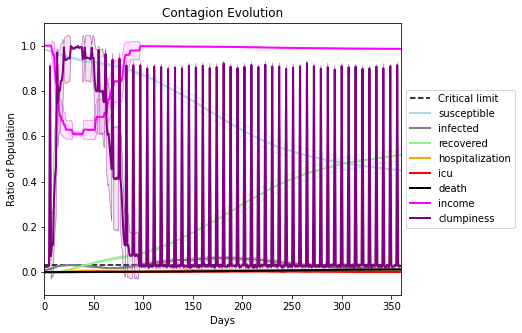

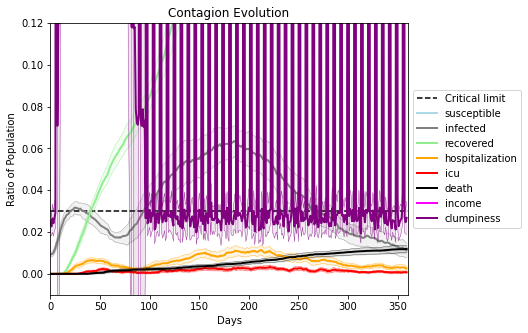

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3111, 4400, 5115, 318, 1022, 9319, 6295, 6809, 7595, 1514, 5356, 7393, 7894, 3642, 1904, 725, 7733, 4595, 5327, 8755]
Average similarity between family members is 0.19179197245842697 at temperature -0.3
Average similarity between family and home is 0.9998466312275497 at temperature -1
Average similarity between students and their classroom is 0.14833809494501543 at temperature -0.3
Average classroom occupancy is 4.5285714285714285 and number classrooms is 70
Average similarity between workers is 0.13894972804075925 at temperature -0.3
Average office occupancy is 3.1534653465346536 and number offices is 202
Average friend similarity for adults: 0.23554036903509304 for kids: 0.19549944572869835
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.0892488669476166
avg restaurant similarity 0.3634908115854881
avg restaurant similarity -0.0922749242489106
avg restaurant similarity -0.01471865169422911
avg restaurant similarity 0.21709491778929585
avg restaurant similarity -0.0922749242489106
avg restaurant similarity -0.1911710369297241
avg restaurant similarity -0.14262323240003358
avg restaurant similarity 0.11037582735730318
avg restaurant similarity 0.1933510858967723
avg restaurant similarity 0.07275047583572095
avg restaurant similarity -0.23150253124518289
avg restaurant similarity 0.38391077722381556
avg restaurant similarity -0.03880485263069694
avg restaurant similarity 0.034364786822586674
avg restaurant similarity -0.2888647796598484
avg restaurant similarity 0.12327332980689795
avg restaurant similarity 0.30983330312730706
avg restaurant similarity -0.0911072719850427
avg restaurant similarity 0.06433279894986813
avg restaurant similarity 0.047233388519632075
avg restaurant similarity 0.202

avg restaurant similarity 0.05974108846608848
avg restaurant similarity 0.021736656980372988
avg restaurant similarity 0.06244159257605127
avg restaurant similarity 0.16206156460216267
avg restaurant similarity 0.050621008218574744
avg restaurant similarity 0.19347830208357472
avg restaurant similarity -0.06228254852775403
avg restaurant similarity -0.1933578345111581
avg restaurant similarity 0.2925541242400848
avg restaurant similarity -0.01236092548711277
avg restaurant similarity 0.11335304420669437
avg restaurant similarity 0.16932115850161444
avg restaurant similarity -0.19717039398155908
avg restaurant similarity 0.051005691701192235
avg restaurant similarity 0.05739262229590768
avg restaurant similarity -0.38532093884837487
avg restaurant similarity 0.44853413323757757
avg restaurant similarity -0.11128842746044068
avg restaurant similarity 0.16206156460216267
avg restaurant similarity -0.18521722030960974
avg restaurant similarity -0.09165480800316925
avg restaurant similarity

avg restaurant similarity 0.20730890194483861
avg restaurant similarity -0.009083735989051564
avg restaurant similarity 0.6875381354837871
avg restaurant similarity 0.2085592370370305
avg restaurant similarity 0.16041274397895183
avg restaurant similarity -0.1421523995577174
avg restaurant similarity -0.1963523352373237
avg restaurant similarity 0.2117159662744147
avg restaurant similarity 0.2411688075506432
avg restaurant similarity 0.2175348055599429
avg restaurant similarity -0.1502426692045658
avg restaurant similarity 0.6875381354837871
avg restaurant similarity -0.20487177425730027
avg restaurant similarity -0.22529248404387753
avg restaurant similarity 0.024169613955682956
avg restaurant similarity 0.20978678372499657
avg restaurant similarity -0.05798273560391451
avg restaurant similarity 0.10126085063569734
avg restaurant similarity 0.2066487417843441
avg restaurant similarity 0.1347404952901663
avg restaurant similarity -0.41425258308849044
avg restaurant similarity -0.132723

avg restaurant similarity 0.05748759947643046
avg restaurant similarity 0.014011838482933962
avg restaurant similarity -0.04874968723542669
avg restaurant similarity -0.20320853395266236
avg restaurant similarity 0.062178291633200586
avg restaurant similarity 0.4484302563705698
avg restaurant similarity 0.006168647842979234
avg restaurant similarity -0.33853987413218867
avg restaurant similarity 0.2481980833103795
avg restaurant similarity 0.015182322384380567
avg restaurant similarity 0.0386190529433203
avg restaurant similarity 0.06959585763952589
avg restaurant similarity -0.05046651701946883
avg restaurant similarity 0.13911837847109412
avg restaurant similarity 0.22050190191699665
avg restaurant similarity -0.31318188410321957
avg restaurant similarity -0.08002787097307625
avg restaurant similarity 0.2279011398526255
avg restaurant similarity -0.0021626603312846215
avg restaurant similarity 0.04985244885739785
avg restaurant similarity 0.046755088051896
avg restaurant similarity 0

avg restaurant similarity 0.19583858357312015
avg restaurant similarity 0.42496612321254645
avg restaurant similarity -0.2363344725429735
avg restaurant similarity 0.16480806830350186
avg restaurant similarity 0.07881247867988252
avg restaurant similarity 0.14749314451664539
avg restaurant similarity 0.07194665922918683
avg restaurant similarity 0.04154226144037169
avg restaurant similarity 0.16620745343612373
avg restaurant similarity -0.28964146814848646
avg restaurant similarity 0.3815000615474788
avg restaurant similarity 0.045729671349805455
avg restaurant similarity -0.3077312652364929
avg restaurant similarity 0.022133444231286725
avg restaurant similarity 0.17106518082685515
avg restaurant similarity -0.1324402729539713
avg restaurant similarity 0.286017767457558
avg restaurant similarity -0.1354633635507313
avg restaurant similarity -0.037823021462062345
avg restaurant similarity 0.03624043112803785
avg restaurant similarity 0.03624043112803785
avg restaurant similarity 0.2698

avg restaurant similarity -0.10886238769450077
avg restaurant similarity -0.20481740849252555
avg restaurant similarity 0.06373234215011396
avg restaurant similarity 0.3883476004474126
avg restaurant similarity -0.2885832958682802
avg restaurant similarity -0.053728849121374433
avg restaurant similarity 0.5229631406587674
avg restaurant similarity 0.42651918735458877
avg restaurant similarity -0.13146955217887263
avg restaurant similarity 0.25051943959719464
avg restaurant similarity 0.19933817734057785
avg restaurant similarity 0.1460107108139604
avg restaurant similarity -0.011504973420766298
avg restaurant similarity 0.19807131920651164
avg restaurant similarity 0.21442959045643678
avg restaurant similarity 0.25369562327165485
avg restaurant similarity -0.31012765715467155
avg restaurant similarity -0.022353456321428156
avg restaurant similarity 0.11956723644017286
avg restaurant similarity 0.3530457260415596
avg restaurant similarity 0.12040634391017829
avg restaurant similarity -0

avg restaurant similarity 0.10227745697847151
avg restaurant similarity -0.10274085406571043
avg restaurant similarity 0.16120786185907993
avg restaurant similarity 0.055060992893661204
avg restaurant similarity -0.05441565288044879
avg restaurant similarity 0.00329972999630194
avg restaurant similarity -0.2582573452591129
avg restaurant similarity -0.10857365235851259
avg restaurant similarity -0.0709100218661491
avg restaurant similarity -0.08658895702354803
avg restaurant similarity 0.1550516381926574
avg restaurant similarity 0.2346900134485844
avg restaurant similarity 0.36179232197467154
avg restaurant similarity 0.3915051644072348
avg restaurant similarity 0.20041394950153513
avg restaurant similarity -0.1327218941166689
avg restaurant similarity 0.3828173248993185
avg restaurant similarity 0.17429319070462737
avg restaurant similarity 0.5207761236162988
avg restaurant similarity 0.37818976687550254
avg restaurant similarity -0.17798130447788502
avg restaurant similarity -0.4143

avg restaurant similarity -0.10429235946827632
avg restaurant similarity 0.07558798163485754
avg restaurant similarity -0.0827839866157974
avg restaurant similarity 0.0020755111950181773
avg restaurant similarity 0.05007515842716946
avg restaurant similarity 0.23753888535497508
avg restaurant similarity -0.0040667617882145235
avg restaurant similarity 0.19098848019531453
avg restaurant similarity 0.01097132496294965
avg restaurant similarity 0.167748774407119
avg restaurant similarity -0.011604584535277768
avg restaurant similarity -0.1765408545684639
avg restaurant similarity 0.153497436364388
avg restaurant similarity 0.08007615997690046
avg restaurant similarity 0.15379899808122255
avg restaurant similarity 0.04737249358386553
avg restaurant similarity 0.05007515842716946
avg restaurant similarity 0.008269378905228733
avg restaurant similarity 0.21642403061271318
avg restaurant similarity 0.1659059081112138
avg restaurant similarity 0.08450576449628298
avg restaurant similarity -0.0

avg restaurant similarity 0.21945656146378867
avg restaurant similarity 0.11915984963732366
avg restaurant similarity 0.08907886711946468
avg restaurant similarity 0.2482745270347209
avg restaurant similarity 0.1741595585560223
avg restaurant similarity -0.12193104101108601
avg restaurant similarity -0.23613731642663122
avg restaurant similarity 0.5411124668132744
avg restaurant similarity -0.2968719503820515
avg restaurant similarity 0.47091823778145553
avg restaurant similarity -0.3188935109157051
avg restaurant similarity 0.16085840903500478
avg restaurant similarity 0.0097226413275288
avg restaurant similarity 0.00011627037504423603
avg restaurant similarity 0.08879311437612777
avg restaurant similarity -0.03425155197779993
avg restaurant similarity -0.1715708514671997
avg restaurant similarity 0.09814498565679021
avg restaurant similarity 0.299949927809469
avg restaurant similarity 0.24513442739924665
avg restaurant similarity 0.3432343379232434
avg restaurant similarity 0.1384575

Average similarity between workers is 0.1551929690520704 at temperature -0.3
Average office occupancy is 3.1379310344827585 and number offices is 203
Average friend similarity for adults: 0.23494794080186623 for kids: 0.19506065380304966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.12715128136981446
avg restaurant similarity -0.023540405193755175
avg restaurant similarity -0.08604173445554229
avg restaurant similarity 0.09684712881011527
avg restaurant similarity 0.25499253718983783
avg restaurant similarity -0.12741647516502924
avg restaurant similarity -0.2841642204382964
avg restaurant similarity -0.12979087957401877
avg restaurant similarity 0.023584229321270245
avg restaurant similarity -0.06857155432947513
avg restaurant similarity 0.20167867382705246
avg restaurant similarity 0.05962253520819155
avg restaurant similarity 0.26694108767133273
avg restaurant similarity 0.6522135720625696
avg restaurant similarity 0.22509812771765914
avg restaurant similarity 0.39553579387189985
avg restaurant similarity 0.1984311797061006
avg restaurant similarity -0.07349570957007023
avg restaurant similarity 0.023287946227148526
avg restaurant similarity -0.011608931866185647
avg restaurant similarity 0.28883761551903653
avg restaurant similarity

avg restaurant similarity 0.205043959817322
avg restaurant similarity -0.3039483020111674
avg restaurant similarity 0.30742165162104973
avg restaurant similarity 0.12962511940478555
avg restaurant similarity 0.20697214232818717
avg restaurant similarity 0.28647915672630453
avg restaurant similarity 0.019134547721470115
avg restaurant similarity -0.06153996207034662
avg restaurant similarity -0.20904396505839268
avg restaurant similarity 0.08431686926385017
avg restaurant similarity 0.34157533748869373
avg restaurant similarity 0.06807964875820402
avg restaurant similarity -0.02969056064148759
avg restaurant similarity 0.38110935953455716
avg restaurant similarity 0.44502766629617735
avg restaurant similarity -0.12938399997900724
avg restaurant similarity 0.2406829184596149
avg restaurant similarity 0.32531070631571934
avg restaurant similarity 0.08618886631249473
avg restaurant similarity 0.019330773835984805
avg restaurant similarity 0.3145236521802084
avg restaurant similarity 0.4953

Average friend similarity for adults: 0.24515270224737307 for kids: 0.20797731016814586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.13678485666752255
avg restaurant similarity 0.37087573535688445
avg restaurant similarity 0.16395986930197137
avg restaurant similarity 0.19144262103157106
avg restaurant similarity 0.05666664297631766
avg restaurant similarity -0.0279829453329519
avg restaurant similarity -0.02009559526620502
avg restaurant similarity 0.31515090868859463
avg restaurant similarity -0.22612650967167058
avg restaurant similarity 0.5541198060671184
avg restaurant similarity 0.2324061079241064
avg restaurant similarity -0.019845986043420395
avg restaurant similarity 0.326965158106434
avg restaurant similarity -0.22008140534381934
avg restaurant similarity -0.1669376616547052
avg restaurant similarity 0.18272172556111607
avg restaurant similarity 0.07083481696294867
avg restaurant similarity 0.0057383342625502804
avg restaurant similarity 0.21638100256307527
avg restaurant similarity -0.12904690690546586
avg restaurant similarity 0.12796382220835453
avg restaurant similarity 0.19

avg restaurant similarity 0.18197221441910014
avg restaurant similarity 0.1552329118618514
avg restaurant similarity 0.21881669027498304
avg restaurant similarity 0.3039632322595377
avg restaurant similarity 0.08171236262928408
avg restaurant similarity 0.16579211506621877
avg restaurant similarity -0.30005665957966837
avg restaurant similarity -0.08729787820268388
avg restaurant similarity 0.05012742393735526
avg restaurant similarity 0.022474266174175556
avg restaurant similarity -0.014841400266245572
avg restaurant similarity 0.04078644258417764
avg restaurant similarity 0.03770928781144129
avg restaurant similarity -0.08601105997510042
avg restaurant similarity 0.13425769850234898
avg restaurant similarity 0.07462367326544819
avg restaurant similarity 0.23817291230501036
avg restaurant similarity 0.17041843305394125
avg restaurant similarity -0.1886539457222128
avg restaurant similarity -0.011630262595013614
avg restaurant similarity 0.09397353609931608
avg restaurant similarity -0

avg restaurant similarity 0.10894407991888465
avg restaurant similarity 0.1832784567065896
avg restaurant similarity 0.10358485091615635
avg restaurant similarity 0.07994606459634507
avg restaurant similarity 0.316868022019272
avg restaurant similarity -0.01822867707213374
avg restaurant similarity -0.17472862860262375
avg restaurant similarity 0.07812151569783206
avg restaurant similarity 0.07994606459634507
avg restaurant similarity 0.02618728336076881
avg restaurant similarity -0.17510208869749794
avg restaurant similarity 0.03606021852871177
avg restaurant similarity 0.1575237287375395
avg restaurant similarity 0.018032330768887717
avg restaurant similarity 0.16124560703386065
avg restaurant similarity 0.03218124906756543
avg restaurant similarity -0.006303064052408552
avg restaurant similarity 0.049497931969038955
avg restaurant similarity -0.3028057885669787
avg restaurant similarity 0.18277504700688194
avg restaurant similarity 0.056439396162623896
avg restaurant similarity 0.10

avg restaurant similarity 0.042021441151486615
avg restaurant similarity -0.05231310628627696
avg restaurant similarity 0.17563477761908017
avg restaurant similarity -0.0889350885839655
avg restaurant similarity 0.25753159768049066
avg restaurant similarity 0.10979489834313533
avg restaurant similarity 0.005945579719757239
avg restaurant similarity 0.21288252530036642
avg restaurant similarity 0.10648274399233992
avg restaurant similarity -0.30253784869440126
avg restaurant similarity 0.31990423774001703
avg restaurant similarity 0.36480658083311457
avg restaurant similarity 0.049854647310739277
avg restaurant similarity -0.19371154501855117
avg restaurant similarity 0.12950268573274132
avg restaurant similarity 0.29646056419060623
avg restaurant similarity 0.3947568522829278
avg restaurant similarity 0.31990423774001703
avg restaurant similarity 0.15456283076647725
avg restaurant similarity 0.435316899588953
avg restaurant similarity 0.34070684769874904
avg restaurant similarity 0.007

avg restaurant similarity 0.19574837731461645
avg restaurant similarity 0.19929659154938023
avg restaurant similarity -0.10839968958451973
avg restaurant similarity 0.15456283076647725
avg restaurant similarity 0.2657629707681257
avg restaurant similarity 0.5231310223963307
avg restaurant similarity -0.10519812774912063
avg restaurant similarity -0.05164495673775138
avg restaurant similarity 0.6873776122943283
avg restaurant similarity -0.05102611937039232
avg restaurant similarity 0.08762202012171519
avg restaurant similarity -0.23410738559806488
avg restaurant similarity 0.19574837731461645
avg restaurant similarity -0.11304293262770272
avg restaurant similarity 0.042869530859258494
avg restaurant similarity 0.1061228327984106
avg restaurant similarity 0.09615749061366405
avg restaurant similarity 0.1508008202757722
avg restaurant similarity 0.1061228327984106
avg restaurant similarity 0.4829078013782395
Average similarity between family members is 0.211808248419084 at temperature -0

avg restaurant similarity 0.03797754918812894
avg restaurant similarity 0.3990836986233922
avg restaurant similarity -0.10599689496036935
avg restaurant similarity 0.20298142488891316
avg restaurant similarity 0.26321510028467854
avg restaurant similarity -0.022096644785426868
avg restaurant similarity -0.10125950538572892
avg restaurant similarity 0.12641122854700068
avg restaurant similarity 0.2657467420734131
avg restaurant similarity 0.25132012402400467
avg restaurant similarity 0.3267566450367496
avg restaurant similarity -0.06326869837576164
avg restaurant similarity -0.4941577519278863
avg restaurant similarity -0.026400022089247167
avg restaurant similarity -0.04677853232784823
avg restaurant similarity 0.2152328595006162
avg restaurant similarity 0.24946078874945507
avg restaurant similarity 0.0646723483908836
avg restaurant similarity 0.5926343026664601
avg restaurant similarity 0.23446911249824445
avg restaurant similarity -0.22945662489098043
avg restaurant similarity 0.170

avg restaurant similarity -0.20236689461545335
avg restaurant similarity 0.1865967958828579
avg restaurant similarity -0.04920659749573545
avg restaurant similarity -0.17336662104527933
avg restaurant similarity -0.2052836720593224
avg restaurant similarity 0.18176008089089934
avg restaurant similarity -0.30360213459705676
avg restaurant similarity 0.28971531546544427
avg restaurant similarity 0.34516906305674
avg restaurant similarity 0.3895503145074542
avg restaurant similarity 0.11907966133835425
avg restaurant similarity 0.4681999135876491
avg restaurant similarity 0.19770904000103914
avg restaurant similarity -0.041608523717872894
avg restaurant similarity 0.28514263878301543
avg restaurant similarity -0.06810001141743441
avg restaurant similarity 0.00853120877291122
avg restaurant similarity 0.05256252456320843
avg restaurant similarity 0.09769868097275468
avg restaurant similarity -0.04399819355488484
avg restaurant similarity 0.21359980574478862
avg restaurant similarity 0.0485

avg restaurant similarity 0.04065400442630705
avg restaurant similarity 0.07233270413878674
avg restaurant similarity 0.10360653425089329
avg restaurant similarity -0.13302916196542114
avg restaurant similarity 0.40597894403386264
avg restaurant similarity 0.07845401918439712
avg restaurant similarity 0.021850812118334353
avg restaurant similarity 0.23357161927904313
avg restaurant similarity 0.09405394911938447
avg restaurant similarity 0.15362281653515025
avg restaurant similarity 0.045228582588255
avg restaurant similarity 0.16161975609799983
avg restaurant similarity 0.19251740371677506
avg restaurant similarity 0.09216263633031418
avg restaurant similarity -0.19845772023339928
avg restaurant similarity -0.03749928496421173
avg restaurant similarity -0.0018973615099845131
avg restaurant similarity -0.12758034611528085
avg restaurant similarity 0.07718171992573562
avg restaurant similarity -0.1896172453446981
avg restaurant similarity 0.2503322844412494
avg restaurant similarity 0.0

avg restaurant similarity 0.11223539507629461
avg restaurant similarity 0.15250658476105192
avg restaurant similarity 0.46406908131353775
avg restaurant similarity -0.2591702976762424
avg restaurant similarity -0.017255554783535243
avg restaurant similarity 0.315847046473121
avg restaurant similarity 0.3392721256468574
avg restaurant similarity 0.2938790526217412
avg restaurant similarity -0.0013208638397528838
avg restaurant similarity 0.2505719184996734
avg restaurant similarity 0.5336914568015984
avg restaurant similarity 0.0807765920651215
avg restaurant similarity -0.2328192765845672
avg restaurant similarity 0.03482946331453711
avg restaurant similarity -0.3012016370741506
avg restaurant similarity -0.15308094727514038
avg restaurant similarity 0.06209283258656122
avg restaurant similarity -0.003361276370454802
avg restaurant similarity -0.4616341797208774
avg restaurant similarity 0.4072593404280149
avg restaurant similarity -0.3032515497102989
avg restaurant similarity 0.421550

avg restaurant similarity -0.02893640726120618
avg restaurant similarity 0.04835589355604428
avg restaurant similarity 0.3997456384530347
avg restaurant similarity 0.48439685632839236
avg restaurant similarity 0.3531072603301283
avg restaurant similarity 0.09330609107120175
avg restaurant similarity -0.1935769194139761
avg restaurant similarity -0.12985331097900413
avg restaurant similarity -0.08623570189180718
avg restaurant similarity 0.26682974400820275
avg restaurant similarity 0.053681662722572424
avg restaurant similarity 0.08297804921119176
avg restaurant similarity 0.593154987869838
avg restaurant similarity 0.11547540932066712
avg restaurant similarity 0.22527574522834412
avg restaurant similarity 0.02454556070998337
avg restaurant similarity 0.033985303910797675
avg restaurant similarity 0.3337796296526433
avg restaurant similarity 0.17039822734449228
avg restaurant similarity 0.38945826242638876
avg restaurant similarity 0.03583805023217292
avg restaurant similarity -0.00367

avg restaurant similarity 0.1452984400167259
avg restaurant similarity 0.08542676553102607
avg restaurant similarity 0.14805732769836777
avg restaurant similarity -0.037410655199819606
avg restaurant similarity -0.20738108979367753
avg restaurant similarity -0.06545695339353691
avg restaurant similarity -0.05506290360601729
avg restaurant similarity -0.12746601581333253
avg restaurant similarity -0.18487141200765628
avg restaurant similarity 0.1291853238072012
avg restaurant similarity -0.17860294429501972
avg restaurant similarity -0.13613334690082096
avg restaurant similarity 0.28889241007302746
avg restaurant similarity -0.2144447759040386
avg restaurant similarity -0.3094789590580743
avg restaurant similarity -0.056412329988025076
avg restaurant similarity 0.04461121674411092
avg restaurant similarity 0.19240400966608256
avg restaurant similarity -0.23913911960320805
avg restaurant similarity -0.1788923723813675
avg restaurant similarity 0.05414956023198416
avg restaurant similarit

(<function dict.items>, <function dict.items>, <function dict.items>)

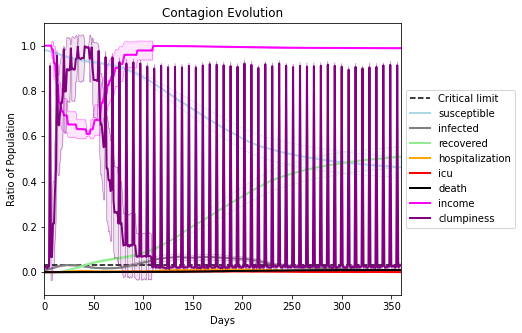

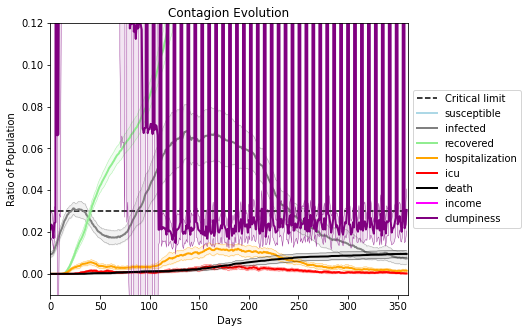

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1700, 7997, 2857, 9915, 292, 1579, 2366, 5665, 3137, 2832, 1300, 3328, 2443, 9236, 2815, 8174, 6235, 96, 2955, 5316]
Average similarity between family members is 0.16782726441463278 at temperature -0.2
Average similarity between family and home is 0.999853864394007 at temperature -1
Average similarity between students and their classroom is 0.1929797421378183 at temperature -0.2
Average classroom occupancy is 4.231884057971015 and number classrooms is 69
Average similarity between workers is 0.1560714242048709 at temperature -0.2
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.22091179118212925 for kids: 0.21195808269092276
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.24554993017695925
avg restaurant similarity 0.07665867188039098
avg restaurant similarity 0.09929986736112684
avg restaurant similarity -0.3825660650691553
avg restaurant similarity 0.17405020414119315
avg restaurant similarity -0.012193220598430504
avg restaurant similarity -0.15679781281432842
avg restaurant similarity -0.23855376924369975
avg restaurant similarity -0.16803780190548356
avg restaurant similarity 0.4896385836808691
avg restaurant similarity 0.04636095678875644
avg restaurant similarity -0.07462890333033645
avg restaurant similarity 0.32991990731608095
avg restaurant similarity 0.06134376529412548
avg restaurant similarity 0.05324758046314353
avg restaurant similarity 0.08807527873662613
avg restaurant similarity -0.048434284432239016
avg restaurant similarity -0.06827806845779369
avg restaurant similarity -0.39044952313167314
avg restaurant similarity 0.5209985603354984
avg restaurant similarity -0.3386330644235031
avg restaurant similarity 

avg restaurant similarity -0.0009050975912965222
avg restaurant similarity 0.2538391128105773
avg restaurant similarity 0.32069697293183885
avg restaurant similarity 0.06877680340968355
avg restaurant similarity 0.2289803621989779
avg restaurant similarity 0.16945731305295875
avg restaurant similarity 0.17871389806561688
avg restaurant similarity 0.23213870717607948
avg restaurant similarity -0.12714068383647842
avg restaurant similarity 0.2915633771734528
avg restaurant similarity 0.5062754542326313
avg restaurant similarity -0.29244701541767215
avg restaurant similarity 0.11034239118885554
avg restaurant similarity -0.09264525142467589
avg restaurant similarity -0.030463015189195974
avg restaurant similarity 0.051632266322538346
avg restaurant similarity -0.1518066331306172
avg restaurant similarity 0.1324067205270381
avg restaurant similarity 0.4531958708283538
avg restaurant similarity 0.11627133231994415
avg restaurant similarity 0.09780645909126537
avg restaurant similarity -0.04

avg restaurant similarity 0.020333918938989438
avg restaurant similarity -0.1178379221285115
avg restaurant similarity -0.3036457359554
avg restaurant similarity 0.15031542005065185
avg restaurant similarity -0.19034979368139995
avg restaurant similarity 0.02549024014904236
avg restaurant similarity 0.062339503745371255
avg restaurant similarity 0.020016686555929596
avg restaurant similarity 0.21787432252643124
avg restaurant similarity -0.14127630735940716
avg restaurant similarity -0.0776964771004098
avg restaurant similarity 0.03509028427064073
avg restaurant similarity 0.1042879167339132
avg restaurant similarity 0.2047776192503822
avg restaurant similarity 0.36932810256169435
avg restaurant similarity -0.3446237746091989
avg restaurant similarity -0.05121560463745661
avg restaurant similarity 0.2353082293406582
avg restaurant similarity -0.49909424342853725
avg restaurant similarity 0.0713201295917719
avg restaurant similarity -0.1323253317785374
avg restaurant similarity -0.09720

avg restaurant similarity 0.11884229922016289
avg restaurant similarity 0.6334744756530406
avg restaurant similarity 0.06501093848089237
avg restaurant similarity 0.06029662676363134
avg restaurant similarity 0.16543570266640878
avg restaurant similarity 0.5517002845897998
avg restaurant similarity -0.21936970529985436
avg restaurant similarity -0.08193541204729779
avg restaurant similarity 0.4152753205752501
avg restaurant similarity 0.31927792860173143
avg restaurant similarity 0.45356268747387346
avg restaurant similarity 0.3021643783401486
avg restaurant similarity -0.09881454970129204
avg restaurant similarity 0.10653995812442679
avg restaurant similarity -0.37498011180052665
avg restaurant similarity 0.33132337078748353
avg restaurant similarity 0.11027396647399272
avg restaurant similarity -0.16122772522759715
avg restaurant similarity 0.021611373508812908
avg restaurant similarity 0.2626139157235744
avg restaurant similarity 0.23240808053902223
avg restaurant similarity 0.20107

avg restaurant similarity 0.12438698974550261
avg restaurant similarity 0.0835264532540794
avg restaurant similarity 0.022415439739113266
avg restaurant similarity 0.040531296526074546
avg restaurant similarity -0.15697170504160834
avg restaurant similarity -0.006458031167436165
avg restaurant similarity 0.10052074257316172
avg restaurant similarity 0.12310906507225762
avg restaurant similarity -0.11149792309440473
avg restaurant similarity 0.2609996993603854
avg restaurant similarity 0.0545493131339337
avg restaurant similarity 0.30961610910968596
avg restaurant similarity -0.10570125207875528
avg restaurant similarity 0.12351008202365481
avg restaurant similarity 0.3273332463391782
avg restaurant similarity -0.22891402336981265
avg restaurant similarity -0.21795700673486187
avg restaurant similarity -0.042100030868449406
avg restaurant similarity 0.21586230084571287
avg restaurant similarity -0.029243745573997292
avg restaurant similarity 0.623306446363496
avg restaurant similarity 0

Average similarity between workers is 0.13171150668551795 at temperature -0.2
Average office occupancy is 3.482233502538071 and number offices is 197
Average friend similarity for adults: 0.20988480891629996 for kids: 0.18611350599893783
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.3113958471779241
avg restaurant similarity 0.12481964727811307
avg restaurant similarity 0.2472556331689067
avg restaurant similarity 0.12729566182007368
avg restaurant similarity -0.04158902651487356
avg restaurant similarity -0.08662497895216455
avg restaurant similarity -0.10989747190265761
avg restaurant similarity -0.08972697936369521
avg restaurant similarity -0.24308703637281728
avg restaurant similarity -0.11697646551745673
avg restaurant similarity 0.011683578077395134
avg restaurant similarity 0.026059231760663264
avg restaurant similarity 0.06947370790695806
avg restaurant similarity -0.0014095776410683047
avg restaurant similarity 0.17817807011086945
avg restaurant similarity 0.0648560408431435
avg restaurant similarity 0.3875311529435578
avg restaurant similarity 0.08396224620534504
avg restaurant similarity 0.1425964171349885
avg restaurant similarity 0.36001369441615577
avg restaurant similarity 0.359974177789866
avg restaurant similarity -0.0

avg restaurant similarity 0.1163413710814616
avg restaurant similarity 0.2803204139281365
avg restaurant similarity 0.09151285711409143
avg restaurant similarity -0.34902262636918824
avg restaurant similarity -0.3019434108854645
avg restaurant similarity 0.4573191045155145
avg restaurant similarity -0.09553316643423936
avg restaurant similarity 0.16690278550739346
avg restaurant similarity 0.2138003998221179
avg restaurant similarity -0.08890792380177683
avg restaurant similarity 0.16541342536186093
avg restaurant similarity 0.2005856973255756
avg restaurant similarity 0.09252950007419397
Average similarity between family members is 0.198317148693141 at temperature -0.2
Average similarity between family and home is 0.9998605964376677 at temperature -1
Average similarity between students and their classroom is 0.16338804685688782 at temperature -0.2
Average classroom occupancy is 3.8309859154929575 and number classrooms is 71
Average similarity between workers is 0.17441257455780976 at 

avg restaurant similarity 0.005217483603514465
avg restaurant similarity -0.4140637438112287
avg restaurant similarity 0.14289815491202987
avg restaurant similarity 0.030282953441299
avg restaurant similarity 0.3882060346184449
avg restaurant similarity -0.10481372015439092
avg restaurant similarity 0.5152206441209852
avg restaurant similarity -0.07872392608357008
avg restaurant similarity 0.44890570931586343
avg restaurant similarity -0.03705995558418405
avg restaurant similarity 0.362102256937816
avg restaurant similarity 0.3003354586735646
avg restaurant similarity 0.4561939924901258
avg restaurant similarity 0.20902482489908158
avg restaurant similarity -0.10481372015439092
avg restaurant similarity 0.06871081515100005
avg restaurant similarity -0.02416800797451084
avg restaurant similarity -0.3823774780611907
avg restaurant similarity 0.058100721483724985
avg restaurant similarity -0.15247523504191574
avg restaurant similarity 0.033859779147406344
avg restaurant similarity -0.0963

avg restaurant similarity 0.4500496449257916
avg restaurant similarity -0.029004571382345922
avg restaurant similarity -0.15619134379969343
avg restaurant similarity 0.10563429734411664
avg restaurant similarity -0.04922765175693299
avg restaurant similarity -0.1523920188864164
avg restaurant similarity -0.475358250351961
Average similarity between family members is 0.18326213727672225 at temperature -0.2
Average similarity between family and home is 0.9998555966663003 at temperature -1
Average similarity between students and their classroom is 0.17096568690316583 at temperature -0.2
Average classroom occupancy is 3.8450704225352115 and number classrooms is 71
Average similarity between workers is 0.15092160970202861 at temperature -0.2
Average office occupancy is 3.2892156862745097 and number offices is 204
Average friend similarity for adults: 0.20837283961689734 for kids: 0.19507960536118057
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.3782669483632898
avg restaurant similarity 0.20142937853987172
avg restaurant similarity 0.12629364582487995
avg restaurant similarity -0.13146670854280093
avg restaurant similarity 0.41907142072416165
avg restaurant similarity 0.033150331135134506
avg restaurant similarity 0.6860554089143733
avg restaurant similarity -0.36390836676135563
avg restaurant similarity 0.4036628428099187
avg restaurant similarity -0.06931295187313469
avg restaurant similarity -0.01855880739025295
avg restaurant similarity 0.19066806792676352
avg restaurant similarity 0.06774177729268274
avg restaurant similarity 0.04759550845830951
avg restaurant similarity 0.06774177729268274
avg restaurant similarity 0.15145794883067962
avg restaurant similarity -0.09454288749361768
avg restaurant similarity 0.23952049699850986
avg restaurant similarity -0.021016623316109997
avg restaurant similarity 0.11772623786092022
avg restaurant similarity 0.11672490056160459
avg restaurant similarity 0.0

avg restaurant similarity 0.06224034452983551
avg restaurant similarity 0.13055883539114657
avg restaurant similarity -0.14544542000038335
avg restaurant similarity -0.3257293591166789
avg restaurant similarity 0.19524654817482634
avg restaurant similarity 0.2418330590473274
avg restaurant similarity -0.13878851371965534
avg restaurant similarity 0.037605381166382186
avg restaurant similarity 0.09967996014560059
avg restaurant similarity -0.056025028421199254
avg restaurant similarity 0.025640395449994427
avg restaurant similarity 0.1987043202901683
avg restaurant similarity 0.32800514962732197
avg restaurant similarity 0.14675591080477077
avg restaurant similarity 0.2452187577765012
avg restaurant similarity 0.03209926467843763
avg restaurant similarity 0.09967996014560059
avg restaurant similarity -0.020221138537568163
avg restaurant similarity -0.15156957263114051
avg restaurant similarity -0.032250511492720305
avg restaurant similarity 0.03660385993801743
avg restaurant similarity 

avg restaurant similarity 0.03666538445456401
avg restaurant similarity 0.02467479764689547
avg restaurant similarity 0.6705606114220689
avg restaurant similarity -0.03872463619028502
avg restaurant similarity 0.05656142200149617
avg restaurant similarity 0.005530752132765791
avg restaurant similarity -0.11432525881678453
avg restaurant similarity -0.06055635169755395
avg restaurant similarity 0.028447972743700034
avg restaurant similarity 0.1879729209463877
avg restaurant similarity 0.01648715537490861
avg restaurant similarity -0.011178796088558499
avg restaurant similarity 0.17076618624083661
avg restaurant similarity 0.1757070037883459
avg restaurant similarity 0.12310304694035726
avg restaurant similarity 0.1466631657497701
avg restaurant similarity 0.040002361007716515
avg restaurant similarity 0.05969216068049308
avg restaurant similarity 0.2691244655191834
avg restaurant similarity -0.1492468772980339
avg restaurant similarity 0.5884131275768414
avg restaurant similarity -0.047

avg restaurant similarity 0.033574843340282455
avg restaurant similarity 0.11484253240834852
avg restaurant similarity 0.1596889438855944
avg restaurant similarity 0.20164906790141418
avg restaurant similarity 0.5693475372480413
avg restaurant similarity 0.04992765051234241
avg restaurant similarity 0.32220433811321153
avg restaurant similarity -0.011544590527372459
avg restaurant similarity 0.06938350954825984
avg restaurant similarity 0.046853340938866714
avg restaurant similarity 0.46174137059267956
avg restaurant similarity 0.0011410702067669934
avg restaurant similarity 0.3403020776673259
avg restaurant similarity 0.41737368474823633
avg restaurant similarity -0.023964931234359374
avg restaurant similarity -0.16781822691728623
avg restaurant similarity 0.06938350954825984
avg restaurant similarity -0.049759606873578346
avg restaurant similarity 0.21964089715201496
avg restaurant similarity 0.15586498213834893
avg restaurant similarity 0.12098958684443528
avg restaurant similarity 

avg restaurant similarity 0.019384022864846483
avg restaurant similarity 0.04257254617811832
avg restaurant similarity -0.40649657838556863
avg restaurant similarity 0.261319790418653
avg restaurant similarity 0.01067960276854598
avg restaurant similarity 0.18127838352329564
avg restaurant similarity 0.30713075445185006
avg restaurant similarity 0.22842927609307712
avg restaurant similarity 0.05481307021255761
avg restaurant similarity 0.25510103798240585
avg restaurant similarity 0.31784657482018785
avg restaurant similarity 0.30839261915076405
avg restaurant similarity 0.051841417920032246
avg restaurant similarity -0.03258970797835278
avg restaurant similarity 0.12921974288537846
avg restaurant similarity 0.08952844536119056
avg restaurant similarity 0.21691687676457122
avg restaurant similarity 0.06513063022969218
avg restaurant similarity 0.012094484787142229
avg restaurant similarity -0.04770201159110984
avg restaurant similarity 0.015689922538746723
avg restaurant similarity 0.3

avg restaurant similarity 0.05612723021856009
avg restaurant similarity 0.14193525174301155
avg restaurant similarity -0.02298065021257377
avg restaurant similarity 0.16637802631887322
avg restaurant similarity 0.09807987854794925
avg restaurant similarity 0.24748386257039617
avg restaurant similarity -0.23272143432436337
Average similarity between family members is 0.1831880395325339 at temperature -0.2
Average similarity between family and home is 0.999856015563245 at temperature -1
Average similarity between students and their classroom is 0.18839303789965012 at temperature -0.2
Average classroom occupancy is 4.228571428571429 and number classrooms is 70
Average similarity between workers is 0.18286148466050867 at temperature -0.2
Average office occupancy is 3.279187817258883 and number offices is 197
Average friend similarity for adults: 0.2176183588804049 for kids: 0.2062194955440388
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity -0.26290623343060604
avg restaurant similarity -0.032936932853075494
avg restaurant similarity 0.050098095376892554
avg restaurant similarity -0.229764734946976
avg restaurant similarity -0.020750991526651375
avg restaurant similarity 0.061160873756407046
avg restaurant similarity 0.03287783978732371
avg restaurant similarity 0.32380839220232804
avg restaurant similarity 0.061160873756407046
avg restaurant similarity 0.07070965112661462
avg restaurant similarity 0.1926815551202894
avg restaurant similarity 0.1347652991301318
avg restaurant similarity -0.36051917446890147
avg restaurant similarity -0.29604773191423606
avg restaurant similarity 0.4564594885214487
avg restaurant similarity 0.012722825643313191
avg restaurant similarity 0.49722418447201255
avg restaurant similarity -0.19145265366055425
avg restaurant similarity -0.021087633511991513
avg restaurant similarity 0.3104526615166052
avg restaurant similarity -0.10265501833669287
avg restaurant similarit

avg restaurant similarity 0.2965596679853304
avg restaurant similarity -0.28217411878613624
avg restaurant similarity 0.24183997485462022
avg restaurant similarity 0.36486806217972495
avg restaurant similarity -0.23180064743657058
avg restaurant similarity -0.06013823954384375
avg restaurant similarity 0.13229914010538527
avg restaurant similarity 0.41194531018902636
avg restaurant similarity 0.02973955941390179
avg restaurant similarity 0.5213525598010844
avg restaurant similarity 0.14095361171558252
avg restaurant similarity -0.24860299600617608
avg restaurant similarity 0.22490834332846904
avg restaurant similarity 0.0718926056989442
avg restaurant similarity -0.09344067352270671
avg restaurant similarity 0.18450045747346888
avg restaurant similarity 0.08173128663996802
avg restaurant similarity 0.23111948571952098
avg restaurant similarity 0.2004460533876424
avg restaurant similarity -0.004941030378911748
avg restaurant similarity 0.01702029771671288
avg restaurant similarity 0.222

avg restaurant similarity -0.2754947858566088
avg restaurant similarity -0.02651380896069183
avg restaurant similarity -0.07934819595827976
avg restaurant similarity 0.42336296982608806
avg restaurant similarity -0.030916701240437806
avg restaurant similarity -0.2681378051849576
avg restaurant similarity -0.10531254691597278
avg restaurant similarity 0.12183258450703129
avg restaurant similarity -0.15247180270817012
avg restaurant similarity -0.05016985348627033
avg restaurant similarity -0.3322487551041071
avg restaurant similarity 0.11853083338317562
avg restaurant similarity 0.03747558118992686
avg restaurant similarity 0.09825064388050048
avg restaurant similarity -0.1329709604355808
avg restaurant similarity -0.13578643648802405
avg restaurant similarity 0.026316193726499584
avg restaurant similarity -0.01119508018866373
avg restaurant similarity -0.31737240506818976
avg restaurant similarity 0.36548705781408847
avg restaurant similarity 0.35804404016419183
avg restaurant similari

avg restaurant similarity 0.26006055086870594
avg restaurant similarity 0.06918323129980206
avg restaurant similarity 0.428295875362684
avg restaurant similarity 0.26006055086870594
avg restaurant similarity 0.3853576190718612
avg restaurant similarity -0.09283870210027986
avg restaurant similarity 0.09131662888714279
avg restaurant similarity -0.01303403484786042
avg restaurant similarity 0.07749737565079562
avg restaurant similarity 0.054611213823714935
avg restaurant similarity -0.2403876061328039
avg restaurant similarity 0.061914290710949685
avg restaurant similarity -0.06178111835635712
avg restaurant similarity 0.30758982326490253
avg restaurant similarity -0.07651688845102163
avg restaurant similarity 0.3780833397437095
Average similarity between family members is 0.17020098417721558 at temperature -0.2
Average similarity between family and home is 0.9998695974073757 at temperature -1
Average similarity between students and their classroom is 0.13858086327460753 at temperature 

avg restaurant similarity 0.09938941800089666
avg restaurant similarity -0.07853755266962884
avg restaurant similarity -0.3517592302443599
avg restaurant similarity 0.459084275882486
avg restaurant similarity 0.25996720072586804
avg restaurant similarity 0.383722795617498
avg restaurant similarity -0.1965770858308159
avg restaurant similarity 0.05355361187653942
avg restaurant similarity -0.30395520446778257
avg restaurant similarity 0.24254113724821114
avg restaurant similarity -0.3320376040417852
avg restaurant similarity -0.15184666065364935
avg restaurant similarity 0.05102448574360176
avg restaurant similarity -0.24225943580120268
avg restaurant similarity -0.26041439120818477
avg restaurant similarity 0.04982817422302846
avg restaurant similarity 0.4497177368063732
avg restaurant similarity 0.40794585334169686
avg restaurant similarity -0.0761158517937354
avg restaurant similarity 0.12482159822507159
avg restaurant similarity 0.1359099548935723
avg restaurant similarity 0.0973638

Average similarity between students and their classroom is 0.1888927672297576 at temperature -0.2
Average classroom occupancy is 4.152777777777778 and number classrooms is 72
Average similarity between workers is 0.14898801650892185 at temperature -0.2
Average office occupancy is 3.2462311557788945 and number offices is 199
Average friend similarity for adults: 0.20717627229911503 for kids: 0.19400416626339315
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in 

avg restaurant similarity 0.09505133544759799
avg restaurant similarity 0.1432649923416408
avg restaurant similarity 0.10003863654841362
avg restaurant similarity 0.1696628484851501
avg restaurant similarity 0.16718801079995085
avg restaurant similarity 0.3605464156037745
avg restaurant similarity 0.5088718226014366
avg restaurant similarity 0.11786937939711901
avg restaurant similarity 0.32637994695145384
avg restaurant similarity 0.2913263859738672
avg restaurant similarity 0.06831876929918322
avg restaurant similarity 0.17235868588554243
avg restaurant similarity 0.06875044535145369
avg restaurant similarity 0.5395496274172455
avg restaurant similarity 0.5246246096387979
avg restaurant similarity 0.2807656550678962
avg restaurant similarity 0.048500821212253666
avg restaurant similarity -0.20641808868416625
avg restaurant similarity -0.09851647724446215
avg restaurant similarity -0.16830447638352283
avg restaurant similarity 0.15474154093650927
avg restaurant similarity -0.058050851

avg restaurant similarity 0.2878815354098418
avg restaurant similarity -0.011764648500480646
avg restaurant similarity -0.0816520460589288
avg restaurant similarity 0.04893497883340481
avg restaurant similarity -0.12076219371062495
avg restaurant similarity 0.14248865203733357
avg restaurant similarity 0.3335693985066617
avg restaurant similarity 0.024290451507052585
avg restaurant similarity -0.12532054233561962
avg restaurant similarity -0.09028502191826189
avg restaurant similarity -0.07401060199824555
avg restaurant similarity 0.08182500706657661
avg restaurant similarity 0.5342631167671198
avg restaurant similarity 0.21494900967101427
avg restaurant similarity -0.0035461270161555314
avg restaurant similarity 0.15971928838077082
avg restaurant similarity 0.11068490574540868
avg restaurant similarity -0.2067168693713911
avg restaurant similarity 0.29491633544462503
avg restaurant similarity 0.2542278765338786
avg restaurant similarity 0.31414037945422013
avg restaurant similarity -0

avg restaurant similarity 0.18087050636608554
avg restaurant similarity 0.3780248658858181
avg restaurant similarity 0.026883742724631995
avg restaurant similarity 0.12996721072225512
avg restaurant similarity 0.16546696817781276
avg restaurant similarity -0.0651458221580554
avg restaurant similarity 0.012570629383112562
avg restaurant similarity 0.18072396637469174
avg restaurant similarity -0.2286140580085386
avg restaurant similarity 0.01916598528430096
avg restaurant similarity 0.26080216529703354
avg restaurant similarity -0.35568491369369293
avg restaurant similarity 0.32885586544094403
avg restaurant similarity -0.0044046753177622855
avg restaurant similarity 0.11593054399075885
avg restaurant similarity -0.6041114423111955
avg restaurant similarity 0.11308598435738737
avg restaurant similarity -0.07905054527903115
avg restaurant similarity -0.056747426199307685
avg restaurant similarity 0.004048811895351494
avg restaurant similarity -0.24031479914681478
avg restaurant similarit

avg restaurant similarity 0.1975253256454398
avg restaurant similarity 0.2273842143907065
avg restaurant similarity -0.008536171305400894
avg restaurant similarity 0.8057232429396679
avg restaurant similarity 0.09752300296866773
avg restaurant similarity 0.4432231611933861
avg restaurant similarity -0.027047752351172072
avg restaurant similarity 0.3960972000751977
avg restaurant similarity 0.5456219534281874
avg restaurant similarity 0.5593982951410896
avg restaurant similarity 0.5456219534281874
avg restaurant similarity 0.26849309527739657
avg restaurant similarity 0.08071613940768113
avg restaurant similarity 0.5456219534281874
avg restaurant similarity 0.14894409049256524
avg restaurant similarity 0.09752300296866773
avg restaurant similarity 0.08776998324291242
avg restaurant similarity -0.08738059696348997
avg restaurant similarity -0.05103408138260519
avg restaurant similarity 0.12627945686137176
avg restaurant similarity 0.23361913231844628
avg restaurant similarity 0.545621953

(<function dict.items>, <function dict.items>, <function dict.items>)

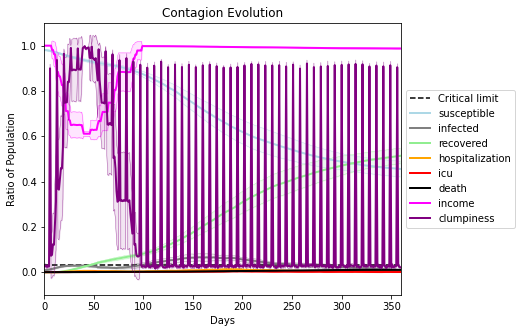

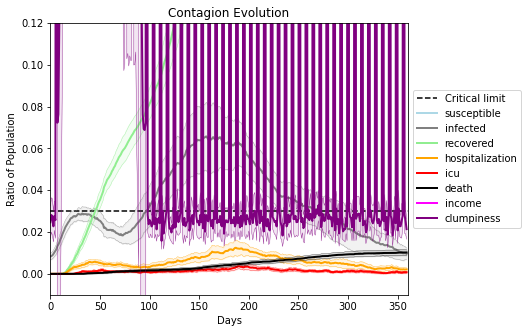

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3632, 7203, 300, 5123, 1315, 7648, 3919, 8591, 3864, 8024, 2129, 2096, 6575, 3673, 5813, 5756, 6803, 7420, 2245, 5881]
Average similarity between family members is 0.17931074747933912 at temperature -0.1
Average similarity between family and home is 0.9998620248347408 at temperature -1
Average similarity between students and their classroom is 0.14515633799755356 at temperature -0.1
Average classroom occupancy is 4.47887323943662 and number classrooms is 71
Average similarity between workers is 0.1550634352070356 at temperature -0.1
Average office occupancy is 3.0935960591133007 and number offices is 203
Average friend similarity for adults: 0.20967749172788125 for kids: 0.210613991865549
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity -0.06565732115006669
avg restaurant similarity 0.4042443388134989
avg restaurant similarity 0.055732875782372224
avg restaurant similarity 0.44172965508698747
avg restaurant similarity 0.3138226774669701
avg restaurant similarity -0.07462405203897535
avg restaurant similarity -0.3285660248129968
avg restaurant similarity 0.20673951247047387
avg restaurant similarity -0.11057507484336275
avg restaurant similarity -0.1441528217109206
avg restaurant similarity 0.24060582822267831
avg restaurant similarity 0.09841957519414563
avg restaurant similarity 0.1815408142399817
avg restaurant similarity 0.0943138643476279
avg restaurant similarity 0.23839738489204332
avg restaurant similarity 0.10613477986853509
avg restaurant similarity -0.1759523707295964
avg restaurant similarity 0.36834072480108293
avg restaurant similarity 0.3404209208950004
avg restaurant similarity -0.08172864320865958
avg restaurant similarity 0.036967330321887856
avg restaurant similarity 0.20115

avg restaurant similarity -0.07283755835733617
avg restaurant similarity 0.07225807414402
Average similarity between family members is 0.14556214566773995 at temperature -0.1
Average similarity between family and home is 0.9998567398001328 at temperature -1
Average similarity between students and their classroom is 0.13943425829217532 at temperature -0.1
Average classroom occupancy is 4.472222222222222 and number classrooms is 72
Average similarity between workers is 0.1460730753583551 at temperature -0.1
Average office occupancy is 3.1725888324873095 and number offices is 197
Average friend similarity for adults: 0.20948637664242917 for kids: 0.20134868544585777
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.07813536021126569
avg restaurant similarity 0.2841218612837665
avg restaurant similarity -0.08239734052493522
avg restaurant similarity -0.015084728693972566
avg restaurant similarity 0.024457785766894433
avg restaurant similarity -0.09164970632186846
avg restaurant similarity -0.06048196773940573
avg restaurant similarity -0.294720395850853
avg restaurant similarity 0.128475768197735
avg restaurant similarity 0.2255798776141712
avg restaurant similarity 0.2191653059335049
avg restaurant similarity 0.627278678922385
avg restaurant similarity -0.11069639787006029
avg restaurant similarity -0.28765677275858326
avg restaurant similarity 0.5670633118068965
avg restaurant similarity 0.0002219312976443899
avg restaurant similarity 0.0406988776771547
avg restaurant similarity -0.10677811005387741
avg restaurant similarity 0.06860432808633748
avg restaurant similarity 0.429582280131119
avg restaurant similarity 0.15692935191436566
avg restaurant similarity -0.108056

avg restaurant similarity 0.08714907528095951
avg restaurant similarity 0.23671243849366858
avg restaurant similarity -0.06571306413412982
avg restaurant similarity 0.08845997554638056
avg restaurant similarity 0.2493289265673685
avg restaurant similarity -0.007774538913007607
avg restaurant similarity 0.3460883180730347
avg restaurant similarity -0.31086799320038905
avg restaurant similarity -0.26199195455819996
avg restaurant similarity -0.2162379647572133
avg restaurant similarity 0.02278625152176493
avg restaurant similarity 0.241655478364047
avg restaurant similarity -0.12277742796839829
avg restaurant similarity 0.14955985577013323
avg restaurant similarity 0.17329534903065502
avg restaurant similarity 0.12090001016632618
avg restaurant similarity -0.020463445057795297
avg restaurant similarity 0.02278625152176493
avg restaurant similarity 0.2968385356163712
avg restaurant similarity 0.060288288692048754
avg restaurant similarity 0.5027820697714909
avg restaurant similarity 0.048

Average friend similarity for adults: 0.2100414540643386 for kids: 0.2018813830715988
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity -0.28726202688150526
avg restaurant similarity -0.18377559674149568
avg restaurant similarity -0.15475917926618943
avg restaurant similarity 0.005750863707902433
avg restaurant similarity 0.2615281362751557
avg restaurant similarity 0.1323290701816036
avg restaurant similarity -0.39367019162456457
avg restaurant similarity -0.20178862719325305
avg restaurant similarity 0.329261777849419
avg restaurant similarity 0.1835986386831547
avg restaurant similarity -0.004355453334764281
avg restaurant similarity 0.4203148698819017
avg restaurant similarity 0.13193259488892162
avg restaurant similarity -0.4191353846834084
avg restaurant similarity -0.13435720316448263
avg restaurant similarity 0.4485475988564046
avg restaurant similarity 0.40477770434376675
avg restaurant similarity 0.48916031426507833
avg restaurant similarity 0.7231671199887746
avg restaurant similarity 0.09073413294598805
avg restaurant similarity 0.21465074235992648
avg restaurant similarity 0.05508

avg restaurant similarity 0.3755030885232521
avg restaurant similarity -0.1428024319720506
avg restaurant similarity 0.23737382251948547
avg restaurant similarity -0.06740258781695674
avg restaurant similarity 0.014494861126458154
avg restaurant similarity 0.11497349361395304
avg restaurant similarity -0.06671327011233993
avg restaurant similarity -0.008792478569399288
avg restaurant similarity 0.14191070470201927
avg restaurant similarity 0.01926613490140229
avg restaurant similarity -0.35438072304758006
avg restaurant similarity 0.01926613490140229
avg restaurant similarity 0.12318236277783276
avg restaurant similarity 0.039510843119043945
avg restaurant similarity 0.10984742826810778
avg restaurant similarity -0.007006955485613552
avg restaurant similarity 0.2645692052799231
avg restaurant similarity 0.25375052446983837
avg restaurant similarity -0.29884510443453083
avg restaurant similarity 0.17643372571398236
avg restaurant similarity 0.30930972548936403
avg restaurant similarity 

avg restaurant similarity -0.32580856221502374
avg restaurant similarity -0.1157809477206097
avg restaurant similarity 0.2258399576946357
avg restaurant similarity -0.012504489150385531
avg restaurant similarity 0.02426734817052742
avg restaurant similarity 0.09362261098988531
avg restaurant similarity 0.33109346952536933
avg restaurant similarity 0.12610535733904854
avg restaurant similarity -0.04309950982514248
avg restaurant similarity 0.2757646904791441
avg restaurant similarity -0.3560209879768036
avg restaurant similarity -0.3747957681665508
avg restaurant similarity 0.31091620586443813
avg restaurant similarity 0.06295565221281509
avg restaurant similarity 0.12610535733904854
avg restaurant similarity -0.29983712394138784
avg restaurant similarity 0.14260380637131043
avg restaurant similarity 0.010488951311839134
avg restaurant similarity -0.14155080225576197
avg restaurant similarity 0.20644854404735688
avg restaurant similarity 0.3465997528731452
avg restaurant similarity 0.31

avg restaurant similarity -0.16341268831377764
avg restaurant similarity 0.21754618657829264
avg restaurant similarity -0.25741383848027694
avg restaurant similarity -0.060121399586623075
avg restaurant similarity -0.15447486314285216
avg restaurant similarity 0.2594171968029159
avg restaurant similarity 0.3090571829460128
avg restaurant similarity 0.044465482587813764
avg restaurant similarity -0.07868089079046865
avg restaurant similarity -0.209369197088351
avg restaurant similarity 0.283917814748178
avg restaurant similarity 0.09734729428299449
avg restaurant similarity 0.1581336656025198
avg restaurant similarity -0.04912499584632579
avg restaurant similarity -0.4063549017903151
avg restaurant similarity 0.13194790687065575
avg restaurant similarity 0.08641626808319726
avg restaurant similarity -0.14303593578306054
avg restaurant similarity 0.039873268182268606
avg restaurant similarity -0.04787206793840586
avg restaurant similarity 0.039873268182268606
avg restaurant similarity -0

avg restaurant similarity -0.03340096948078819
avg restaurant similarity -0.04572164219910009
avg restaurant similarity 0.00562201500376644
avg restaurant similarity 0.2722000292445035
avg restaurant similarity 0.22945607143369162
avg restaurant similarity 0.13868995810699913
avg restaurant similarity 0.5380543696892524
avg restaurant similarity 0.17873302071639502
avg restaurant similarity 0.3738064909952097
avg restaurant similarity 0.06591542849799731
avg restaurant similarity 0.475458619726719
avg restaurant similarity -0.001588050294828336
avg restaurant similarity -0.03934151728819204
avg restaurant similarity -0.024344663999720767
avg restaurant similarity 0.2130006470718468
avg restaurant similarity 0.09692395422388361
avg restaurant similarity -0.05424862649794172
avg restaurant similarity 0.13455748303192588
avg restaurant similarity -0.27762241658961956
avg restaurant similarity -0.41284333676194596
avg restaurant similarity 0.030699171339519604
avg restaurant similarity 0.1

avg restaurant similarity 0.1920990710839633
avg restaurant similarity 0.17430289824413833
avg restaurant similarity 0.4113902977912329
avg restaurant similarity 0.4741387808958182
avg restaurant similarity 0.0630745706149019
Average similarity between family members is 0.16692486571650514 at temperature -0.1
Average similarity between family and home is 0.9998558814529858 at temperature -1
Average similarity between students and their classroom is 0.167526790339432 at temperature -0.1
Average classroom occupancy is 3.9027777777777777 and number classrooms is 72
Average similarity between workers is 0.15476449608770124 at temperature -0.1
Average office occupancy is 3.378787878787879 and number offices is 198
Average friend similarity for adults: 0.20878361936406098 for kids: 0.19997129602467054
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated 

avg restaurant similarity 0.21540113574563655
avg restaurant similarity 0.12703724900336563
avg restaurant similarity -0.06870913884917745
avg restaurant similarity 0.031604187269085524
avg restaurant similarity -0.10524973360829958
avg restaurant similarity -0.08860515054169213
avg restaurant similarity 0.15598506197506748
avg restaurant similarity 0.003965723642847904
avg restaurant similarity 0.2099512857163888
avg restaurant similarity -0.16316355273458852
avg restaurant similarity 0.24112880434764228
avg restaurant similarity 0.20822932347219564
avg restaurant similarity 0.1686088479740015
avg restaurant similarity -0.3295977276540364
avg restaurant similarity 0.19836725143479395
avg restaurant similarity 0.031604187269085524
avg restaurant similarity 0.038296635665702836
avg restaurant similarity 0.3415550381324754
avg restaurant similarity 0.1053134232941381
avg restaurant similarity 0.15323493051091755
avg restaurant similarity -0.11392706849444789
avg restaurant similarity 0.3

avg restaurant similarity 0.5233929649345623
avg restaurant similarity 0.5748092674766592
avg restaurant similarity 0.11584229960677886
avg restaurant similarity -0.0013656203251594737
avg restaurant similarity 0.4235612727321877
avg restaurant similarity 0.26564654471441895
avg restaurant similarity 0.20421927193152414
avg restaurant similarity -0.08135927334245803
avg restaurant similarity 0.11088299267594387
avg restaurant similarity -0.10514472023639701
avg restaurant similarity -0.047670216696167236
avg restaurant similarity 0.25238344200641194
avg restaurant similarity 0.15009909455735596
avg restaurant similarity 0.5519300157804422
avg restaurant similarity 0.22983169180558097
avg restaurant similarity 0.24367461845069524
avg restaurant similarity -0.05590508661181514
avg restaurant similarity -0.14534896441694778
avg restaurant similarity 0.21066615101333164
avg restaurant similarity 0.10377766172893507
avg restaurant similarity 0.15361504578124405
avg restaurant similarity 0.2

Average friend similarity for adults: 0.20500339088797354 for kids: 0.19914578444368886
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.1514197374094949
avg restaurant similarity 0.08187625394390315
avg restaurant similarity 0.24117406046597864
avg restaurant similarity 0.40505971288724485
avg restaurant similarity -0.010576541680380039
avg restaurant similarity 0.1350209836949314
avg restaurant similarity -0.08951367787815102
avg restaurant similarity 0.012920313029169645
avg restaurant similarity 0.036498128630861756
avg restaurant similarity 0.22197137432846714
avg restaurant similarity 0.013952079572845243
avg restaurant similarity -0.13623676934839268
avg restaurant similarity 0.2330383346284826
avg restaurant similarity 0.5605278816501985
avg restaurant similarity -0.03951356469803375
avg restaurant similarity 0.2760261772775163
avg restaurant similarity -0.09176372611286103
avg restaurant similarity 0.10165573597574522
avg restaurant similarity -0.18703235818007266
avg restaurant similarity -0.09872206359509456
avg restaurant similarity 0.12316715429819902
avg restaurant similarity -0

avg restaurant similarity -0.11373830556935202
avg restaurant similarity 0.22938533451438553
avg restaurant similarity 0.22710841172389756
avg restaurant similarity 0.09962122658732764
avg restaurant similarity 0.444505051503241
avg restaurant similarity -0.10035916708240677
avg restaurant similarity 0.0888530624950894
avg restaurant similarity -0.023527943991623834
avg restaurant similarity 0.27464346299315867
avg restaurant similarity 0.46788520422892743
avg restaurant similarity 0.23281926333300373
avg restaurant similarity 0.444505051503241
avg restaurant similarity -0.3171569297657718
avg restaurant similarity 0.19776209167585995
avg restaurant similarity -0.22602135839007156
avg restaurant similarity -0.1258240885431103
avg restaurant similarity 0.28299417545680905
avg restaurant similarity 0.3077817274267947
avg restaurant similarity -0.1694655996223557
avg restaurant similarity 0.46788520422892743
avg restaurant similarity 0.36167622797921645
avg restaurant similarity 0.5638505

avg restaurant similarity 0.09409857730939335
avg restaurant similarity 0.5450667142509308
avg restaurant similarity 0.07957145348315339
avg restaurant similarity -0.10642343324660224
avg restaurant similarity -0.2720737967353746
avg restaurant similarity 0.6093620636365983
avg restaurant similarity 0.2673532281266071
avg restaurant similarity -0.07235477588509914
avg restaurant similarity 0.07957145348315339
avg restaurant similarity 0.3653592221060623
avg restaurant similarity 0.37578323702540684
avg restaurant similarity 0.09903413709747362
avg restaurant similarity 0.36992334840345464
avg restaurant similarity 0.08989887708792166
avg restaurant similarity 0.3706489803511016
avg restaurant similarity 0.21463647480375317
avg restaurant similarity -0.10925863990668686
avg restaurant similarity 0.10046420437541172
avg restaurant similarity 0.11857670079368356
avg restaurant similarity 0.31784514548688314
avg restaurant similarity 0.046618213296424287
avg restaurant similarity 0.0372472

avg restaurant similarity -0.06785630241352257
avg restaurant similarity 0.1047912009162763
avg restaurant similarity 0.18620885457444733
avg restaurant similarity 0.49750124897871834
avg restaurant similarity -0.0778118364964435
avg restaurant similarity -0.2390190436226435
avg restaurant similarity 0.18958603301086002
avg restaurant similarity -0.12805842225268943
avg restaurant similarity 0.0185002216716348
avg restaurant similarity 0.007574491253076611
avg restaurant similarity -0.2105979029209224
avg restaurant similarity 0.09688046716763386
avg restaurant similarity -0.23480528907785295
avg restaurant similarity 0.48267818822354924
avg restaurant similarity 0.2294193761672514
avg restaurant similarity 0.49750124897871834
avg restaurant similarity -0.18975381026292187
avg restaurant similarity 0.10684150675921526
avg restaurant similarity -0.07784980433926451
avg restaurant similarity 0.0606729934549194
avg restaurant similarity -0.2056522105303597
avg restaurant similarity 0.1235

avg restaurant similarity 0.1248411021400263
avg restaurant similarity 0.027846160722187
avg restaurant similarity 0.25823232301551774
avg restaurant similarity -0.3574329425233714
avg restaurant similarity -0.1080517772636377
avg restaurant similarity 0.10554255546750962
avg restaurant similarity -0.1214452058407687
avg restaurant similarity 0.17204857873024998
avg restaurant similarity -0.28263390609711825
avg restaurant similarity -0.046883160247193786
avg restaurant similarity 0.18620610102266982
avg restaurant similarity 0.15808114169009627
avg restaurant similarity -0.17834659279809362
avg restaurant similarity 0.20101171277943744
avg restaurant similarity -0.15174515270727482
avg restaurant similarity 0.30970754687631746
avg restaurant similarity -0.10020137850699057
avg restaurant similarity 0.3197858209214046
avg restaurant similarity -0.3497398127126472
avg restaurant similarity -0.22128258485765373
avg restaurant similarity 0.008669975839865673
avg restaurant similarity 0.32

Average similarity between workers is 0.14658311253163736 at temperature -0.1
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.20730452963424637 for kids: 0.19650314634924337
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.039587580211211365
avg restaurant similarity 0.08782421437723648
avg restaurant similarity 0.1587802827501335
avg restaurant similarity 0.029757829466270508
avg restaurant similarity 0.4467386718036401
avg restaurant similarity 0.14818620694668672
avg restaurant similarity 0.5022752822625722
avg restaurant similarity 0.12152108584340274
avg restaurant similarity 0.3769504075455514
avg restaurant similarity -0.2265512804819157
avg restaurant similarity 0.36619078040133834
avg restaurant similarity 0.20920581091563767
avg restaurant similarity 0.21918345659580568
avg restaurant similarity 0.22733474122488384
avg restaurant similarity 0.16999309809444121
avg restaurant similarity 0.2169251127540781
avg restaurant similarity 0.3588549089487548
avg restaurant similarity -8.14258313983629e-05
avg restaurant similarity 0.14744771421351352
avg restaurant similarity 0.051815933214915365
avg restaurant similarity 0.20853874562817584
avg restaurant similarity 0.0576003

avg restaurant similarity 0.525278910650949
avg restaurant similarity 0.5120210469621858
avg restaurant similarity 0.1223175227932712
avg restaurant similarity -0.04334598901895401
avg restaurant similarity -0.051256873078476484
avg restaurant similarity 0.21530898999297782
avg restaurant similarity 0.3773830748531841
avg restaurant similarity 0.3769504075455514
Average similarity between family members is 0.15406293179317998 at temperature -0.1
Average similarity between family and home is 0.9998703309296243 at temperature -1
Average similarity between students and their classroom is 0.14028170006970442 at temperature -0.1
Average classroom occupancy is 3.8857142857142857 and number classrooms is 70
Average similarity between workers is 0.147356363819478 at temperature -0.1
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.20202677977313405 for kids: 0.1917494785536357
home_districts
[
Home (0,0) district with 1 Buildings


avg restaurant similarity -0.00671966167802624
avg restaurant similarity -0.13583098239748784
avg restaurant similarity 0.43812194745381894
avg restaurant similarity 0.25625149856229285
avg restaurant similarity 0.36923035742224564
avg restaurant similarity -0.282625216164209
avg restaurant similarity -0.11112405832595994
avg restaurant similarity 0.32721513812649333
avg restaurant similarity -0.1735733383600752
avg restaurant similarity 0.06702375242318452
avg restaurant similarity 0.07238087092088176
avg restaurant similarity 0.26992214519356456
avg restaurant similarity 0.03312598805772716
avg restaurant similarity 0.2714023753217839
avg restaurant similarity 0.05179622686283953
avg restaurant similarity -0.14697563085926435
avg restaurant similarity 0.20207810068345794
avg restaurant similarity -0.21595324008395758
avg restaurant similarity 0.10985533119371774
avg restaurant similarity 0.1724915900577772
avg restaurant similarity -0.06878993742413765
avg restaurant similarity 0.152

Average similarity between workers is 0.14918485773720036 at temperature -0.1
Average office occupancy is 3.264705882352941 and number offices is 204
Average friend similarity for adults: 0.2043815158223068 for kids: 0.19728032043393542
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 1

avg restaurant similarity 0.5506590254354673
avg restaurant similarity 0.08684076112867511
avg restaurant similarity -0.28841832494259173
avg restaurant similarity 0.20659457128240524
avg restaurant similarity -0.139710592400353
avg restaurant similarity 0.20701927331035053
avg restaurant similarity 0.23816983763855237
avg restaurant similarity 0.6768239589438088
avg restaurant similarity 0.23212934916329808
avg restaurant similarity 0.3847555948338663
avg restaurant similarity 0.15709048809842285
avg restaurant similarity 0.49514640158983136
avg restaurant similarity -0.030907423286897592
avg restaurant similarity 0.39906741871933477
avg restaurant similarity 0.2722624427946634
avg restaurant similarity -0.026327069982697723
avg restaurant similarity -0.044952488735158024
avg restaurant similarity 0.008579494280808944
avg restaurant similarity 0.008881592645444344
avg restaurant similarity 0.19849486338399452
avg restaurant similarity 0.06204087735785338
avg restaurant similarity 0.36

avg restaurant similarity 0.19091204515731258
avg restaurant similarity 0.1481836823245433
avg restaurant similarity 0.1502603459384214
avg restaurant similarity -0.18990503677262294
avg restaurant similarity -0.1032786229038917
avg restaurant similarity 0.023028430808330946
avg restaurant similarity 0.19828647103734615
avg restaurant similarity 0.16117879179468908
avg restaurant similarity -0.07028557455854931
avg restaurant similarity 0.14274218733165683
avg restaurant similarity 0.023028430808330946
avg restaurant similarity -0.43976065149834953
avg restaurant similarity -0.18906104350233588
avg restaurant similarity 0.01869252250982628
avg restaurant similarity 0.08822052397920875
avg restaurant similarity -0.29682639021875834
avg restaurant similarity -0.06288065719210104
avg restaurant similarity 0.06699961899963656
avg restaurant similarity 0.26137893051387373
avg restaurant similarity -0.08783158556698872
avg restaurant similarity -0.034210765297781415
avg restaurant similarity

avg restaurant similarity 0.1366866274206268
avg restaurant similarity 0.15298775136836196
avg restaurant similarity 0.033778410283693244
avg restaurant similarity 0.3013000941460813
avg restaurant similarity -0.059966086326018526
avg restaurant similarity -0.11909344535182001
avg restaurant similarity 0.11686923604836259
avg restaurant similarity -0.04280554103415886
avg restaurant similarity 0.24574373782965467
avg restaurant similarity 0.08757185451267349
avg restaurant similarity 0.08157241752351269
avg restaurant similarity 0.24453618067155541
avg restaurant similarity -0.16017251329163468
avg restaurant similarity 0.027817159512164836
avg restaurant similarity 0.26826849733093977
avg restaurant similarity -0.14050633671477164
avg restaurant similarity 0.22624458635597544
avg restaurant similarity -0.00785168392302732
avg restaurant similarity 0.25253758852229413
avg restaurant similarity 0.2722702076236514
avg restaurant similarity 0.20997143399061685
avg restaurant similarity -0

avg restaurant similarity 0.03030078462352477
avg restaurant similarity 0.09544707908945257
avg restaurant similarity 0.20611397896767428
avg restaurant similarity 0.08186215357145472
avg restaurant similarity -0.24113170229131595
avg restaurant similarity -0.0020627329898449897
avg restaurant similarity -0.29903475128269674
avg restaurant similarity 0.1809100653774723
avg restaurant similarity 0.15791059273151808
avg restaurant similarity -0.2968092821122397
avg restaurant similarity 0.1338552037951902
avg restaurant similarity 0.46693400155594633
using average of time series:
stats on susceptible:
data: [0.652438888888889, 0.6641861111111111, 0.6689972222222222, 0.6770972222222222, 0.5814444444444444, 0.6239916666666667, 0.7339722222222222, 0.6423972222222223, 0.6147944444444443, 0.7065444444444444, 0.8106249999999999, 0.7193361111111112, 0.7310555555555556, 0.6801, 0.5971805555555556, 0.7401361111111111, 0.7589083333333333, 0.7599611111111112, 0.7390277777777778, 0.8020972222222222]

(<function dict.items>, <function dict.items>, <function dict.items>)

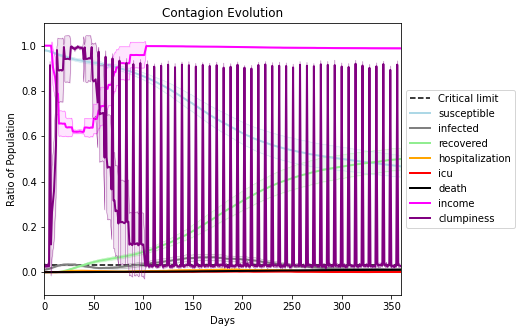

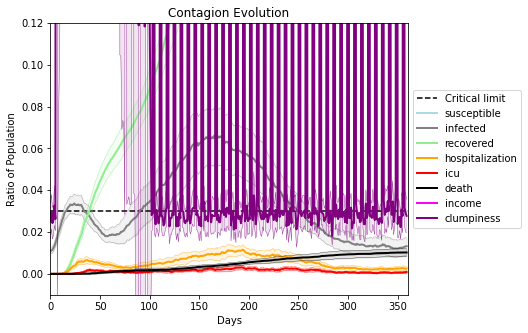

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2239, 893, 3839, 9208, 7892, 4075, 9715, 9196, 4292, 3218, 7655, 2362, 9655, 4635, 5176, 6322, 3397, 3683, 3196, 7360]
Average similarity between family members is 0.17626011678311554 at temperature 0
Average similarity between family and home is 0.9998435323450171 at temperature -1
Average similarity between students and their classroom is 0.17041137893184533 at temperature 0
Average classroom occupancy is 4 and number classrooms is 71
Average similarity between workers is 0.15565139065158654 at temperature 0
Average office occupancy is 3.3299492385786804 and number offices is 197
Average friend similarity for adults: 0.2094123469681307 for kids: 0.19047586304290734
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20

avg restaurant similarity 0.15612496261258776
avg restaurant similarity 0.37986258573721915
avg restaurant similarity -0.07984479401920967
avg restaurant similarity 0.06081184458781043
avg restaurant similarity 0.13064073126139028
avg restaurant similarity 0.06331199458561226
avg restaurant similarity 0.11708913062153553
avg restaurant similarity -0.09308005644246856
avg restaurant similarity -0.09669997038176675
avg restaurant similarity 0.3194529343887655
avg restaurant similarity 0.4446059709699021
avg restaurant similarity 0.22402009229148406
avg restaurant similarity 0.2686964942125903
avg restaurant similarity 0.2163256825886905
avg restaurant similarity 0.05997390219372478
avg restaurant similarity 0.20533582903727468
avg restaurant similarity 0.0729894739501508
avg restaurant similarity 0.6218563220314458
avg restaurant similarity -0.07795368944617732
avg restaurant similarity 0.018476224654039912
avg restaurant similarity 0.21622258621380444
avg restaurant similarity -0.400630

avg restaurant similarity 0.17835012300053874
avg restaurant similarity 0.23959205472456344
avg restaurant similarity 0.29184244674849774
avg restaurant similarity 0.25005958449229704
avg restaurant similarity 0.2459546289644736
avg restaurant similarity 0.11573287146473833
avg restaurant similarity 0.004596437394202955
avg restaurant similarity -0.1571325111328777
avg restaurant similarity -0.1732294536002139
avg restaurant similarity 0.23059272301302774
avg restaurant similarity 0.15725955310849707
avg restaurant similarity 0.25744524668587443
avg restaurant similarity 0.2557692378740072
avg restaurant similarity 0.25040966704378914
avg restaurant similarity 0.31647415630170006
avg restaurant similarity 0.2988793666789726
avg restaurant similarity 0.158065024564496
avg restaurant similarity 0.2264517989597767
avg restaurant similarity 0.16049083370586048
avg restaurant similarity -0.07994866922620669
avg restaurant similarity -0.058145266644878395
avg restaurant similarity -0.0196106

avg restaurant similarity -0.039540289644142
avg restaurant similarity 0.07849685109208362
avg restaurant similarity -0.0680359262914523
avg restaurant similarity 0.07013203542533665
avg restaurant similarity 0.007434822239612601
avg restaurant similarity -0.2475751123049328
avg restaurant similarity -0.013262242504865858
avg restaurant similarity 0.1564848737913665
avg restaurant similarity 0.1481256240935313
avg restaurant similarity 0.26310514957740255
avg restaurant similarity 0.4158829447464985
avg restaurant similarity 0.25546844759111326
avg restaurant similarity 0.07642871976624592
avg restaurant similarity -0.17301864043132092
avg restaurant similarity -0.012135165345137422
avg restaurant similarity -0.028730851843234692
avg restaurant similarity -0.3315054072052752
avg restaurant similarity -0.05899055028103835
avg restaurant similarity 0.1364208852569634
avg restaurant similarity 0.01966326587457118
avg restaurant similarity -0.20755531231950394
avg restaurant similarity 0.1

Average friend similarity for adults: 0.21317323252693923 for kids: 0.20125129082619436
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity -0.06082804545547437
avg restaurant similarity -0.054645874536288025
avg restaurant similarity -0.05271419867303821
avg restaurant similarity 0.22905700908665072
avg restaurant similarity 0.30007446642674385
avg restaurant similarity 0.6370305217942547
avg restaurant similarity -0.23141354663136898
avg restaurant similarity 0.2939115188860781
avg restaurant similarity -0.14891344785704852
avg restaurant similarity -0.014426026916089768
avg restaurant similarity 0.09622772839273375
avg restaurant similarity 0.5300937753554193
avg restaurant similarity -0.25572027932845137
avg restaurant similarity 0.2248207097066281
avg restaurant similarity 0.18284991350289034
avg restaurant similarity 0.059260550614687
avg restaurant similarity 0.2915443310275444
avg restaurant similarity 0.12572609710308807
avg restaurant similarity 0.2515995911844444
avg restaurant similarity 0.07347948961748992
avg restaurant similarity 0.28165726633569926
avg restaurant similarity -0.3145

avg restaurant similarity 0.15336686216852732
avg restaurant similarity 0.09008739396854312
avg restaurant similarity -0.33023022676077096
avg restaurant similarity 0.0018669032247452394
avg restaurant similarity -0.11438138125117524
avg restaurant similarity -0.0336052765335875
avg restaurant similarity -0.015203885585523658
avg restaurant similarity -0.2380198496216816
avg restaurant similarity 0.4543499064245675
avg restaurant similarity 0.08463816943374991
avg restaurant similarity -0.029432672412185445
avg restaurant similarity 0.32609103884465035
avg restaurant similarity 0.28125207941855096
avg restaurant similarity -0.17923719699550233
avg restaurant similarity -0.023225952608928513
avg restaurant similarity 0.3255905388997685
avg restaurant similarity 0.0075561774055836195
avg restaurant similarity 0.21947425887083805
avg restaurant similarity 0.17313024411113048
avg restaurant similarity -0.19612511273675112
avg restaurant similarity 0.15158427558138018
avg restaurant similar

avg restaurant similarity -0.014764248652159653
avg restaurant similarity 0.0990771492023704
avg restaurant similarity 0.42790322752021026
avg restaurant similarity 0.007540049535143409
avg restaurant similarity -0.22212831930941487
avg restaurant similarity -0.10358932804871414
avg restaurant similarity 0.2202293909168701
avg restaurant similarity 0.09991657498132557
avg restaurant similarity 0.15031549583830262
avg restaurant similarity 0.05723636432230475
avg restaurant similarity 0.15192302927088933
avg restaurant similarity 0.47519762095982987
avg restaurant similarity -0.08143901972446174
avg restaurant similarity -0.1524378939947213
avg restaurant similarity 0.30992595193561323
avg restaurant similarity 0.614551219785618
avg restaurant similarity 0.009202121011960593
avg restaurant similarity 0.19093702523041162
avg restaurant similarity 0.27362538107625456
avg restaurant similarity 0.18694193836447173
avg restaurant similarity 0.1527101752685743
avg restaurant similarity 0.2164

avg restaurant similarity -0.017767338550043088
avg restaurant similarity 0.07907029864600494
avg restaurant similarity -0.18189872847417204
avg restaurant similarity 0.22048419756300291
avg restaurant similarity -0.17036180604994633
avg restaurant similarity 0.33320696667292204
avg restaurant similarity 0.2013988201849151
avg restaurant similarity 0.1981065943433563
avg restaurant similarity 0.09533752819129386
avg restaurant similarity 0.17569297219625443
avg restaurant similarity 0.304893146819668
avg restaurant similarity 0.4287928930670159
avg restaurant similarity 0.1000683559057715
avg restaurant similarity 0.4732616482992574
avg restaurant similarity -0.6611781983153178
avg restaurant similarity 0.2046190887907678
avg restaurant similarity 0.2594072339577802
avg restaurant similarity 0.17550847637895947
avg restaurant similarity 0.2666180763517196
avg restaurant similarity -0.09996322123363283
avg restaurant similarity 0.33419457325078944
avg restaurant similarity 0.03899857217

avg restaurant similarity 0.19151530530594965
avg restaurant similarity -0.02365058383606779
avg restaurant similarity -0.10585226217974039
avg restaurant similarity 0.2943382604395802
avg restaurant similarity -0.09197970305835962
avg restaurant similarity 0.1888519062154547
avg restaurant similarity -0.30685136648057687
avg restaurant similarity 0.10255289233097428
avg restaurant similarity -0.05834209081886092
avg restaurant similarity 0.10962391973937842
avg restaurant similarity 0.39520808879942965
avg restaurant similarity 0.3886980963621111
avg restaurant similarity 0.10255289233097428
avg restaurant similarity 0.3913723722896964
avg restaurant similarity 0.20797105945589336
avg restaurant similarity -0.30685136648057687
avg restaurant similarity 0.23629867344256122
avg restaurant similarity 0.3702598912490636
avg restaurant similarity -0.3679619564748118
avg restaurant similarity -0.17217744923901768
avg restaurant similarity 0.2956248824678559
avg restaurant similarity 0.07515

avg restaurant similarity 0.14584468199830397
avg restaurant similarity 0.14136643187785722
avg restaurant similarity 0.25808781940356834
avg restaurant similarity -0.22493645848311594
avg restaurant similarity 0.14584267660614675
avg restaurant similarity 0.1318368110526311
avg restaurant similarity 0.23241567652526
avg restaurant similarity 0.01871554253375548
avg restaurant similarity 0.3266330385391056
avg restaurant similarity 0.2290848825440744
avg restaurant similarity 0.11770480187629735
avg restaurant similarity -0.27162521733314965
avg restaurant similarity 0.20930004441682126
avg restaurant similarity 0.05072489586307445
avg restaurant similarity -0.11967678461692473
avg restaurant similarity -0.07176052224397106
avg restaurant similarity 0.21647428177010503
avg restaurant similarity 0.03347081486098973
avg restaurant similarity -0.29912133260403917
avg restaurant similarity 0.15993878995217042
avg restaurant similarity 0.35637060633801776
avg restaurant similarity -0.043727

avg restaurant similarity 0.1232816927113019
avg restaurant similarity 0.05801930758438962
avg restaurant similarity -0.07825007874343659
avg restaurant similarity 0.1318368110526311
Average similarity between family members is 0.14871834728072356 at temperature 0
Average similarity between family and home is 0.9998551134619328 at temperature -1
Average similarity between students and their classroom is 0.14881366474727759 at temperature 0
Average classroom occupancy is 3.942857142857143 and number classrooms is 70
Average similarity between workers is 0.1620563102904054 at temperature 0
Average office occupancy is 3.233009708737864 and number offices is 206
Average friend similarity for adults: 0.20494990415802064 for kids: 0.18762096244825752
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.23861115028236618
avg restaurant similarity -0.23365755401027044
avg restaurant similarity -0.14614213010299548
avg restaurant similarity 0.10890668631082193
avg restaurant similarity 0.24735274860978537
avg restaurant similarity 0.37858545346735767
avg restaurant similarity 0.19447225490150544
avg restaurant similarity 0.1173852631004475
avg restaurant similarity 0.28689951023732874
avg restaurant similarity 0.010260463700762099
avg restaurant similarity -0.45311004622159046
avg restaurant similarity -0.11975793189551685
avg restaurant similarity 0.566272003165304
avg restaurant similarity -0.02342675807320314
avg restaurant similarity -0.051986058133400584
avg restaurant similarity 0.24620458061790337
avg restaurant similarity -0.18650269030006736
avg restaurant similarity 0.29606235359593974
avg restaurant similarity -0.11747893630498257
avg restaurant similarity 0.1488953688516481
avg restaurant similarity 0.055404467690393804
avg restaurant similarity 0

Average similarity between family and home is 0.9998554161864902 at temperature -1
Average similarity between students and their classroom is 0.14340419238091842 at temperature 0
Average classroom occupancy is 3.971830985915493 and number classrooms is 71
Average similarity between workers is 0.15777805640930118 at temperature 0
Average office occupancy is 3.207920792079208 and number offices is 202
Average friend similarity for adults: 0.19774963454737288 for kids: 0.19402979935610185
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity -0.028410295659449986
avg restaurant similarity -0.2589521684316465
avg restaurant similarity 0.3174358783688675
avg restaurant similarity -0.04869018410342367
avg restaurant similarity -0.0714121641844541
avg restaurant similarity -0.14899040621989443
avg restaurant similarity 0.28581109499210045
avg restaurant similarity -0.07896532946534188
avg restaurant similarity 0.20434592594281892
avg restaurant similarity 0.15112619138994876
avg restaurant similarity 0.07821966736514707
avg restaurant similarity -0.07637739450068895
avg restaurant similarity 0.317805845148236
avg restaurant similarity 0.2926749543158602
avg restaurant similarity 0.056189296457787224
avg restaurant similarity -0.17496559737270112
avg restaurant similarity 0.28581109499210045
avg restaurant similarity 0.2648654233171886
avg restaurant similarity 0.2055763002671903
avg restaurant similarity -0.07918344550532712
avg restaurant similarity 0.11212771687094797
avg restaurant similarity 0.048

avg restaurant similarity 0.2545129319442052
avg restaurant similarity 0.5279496655816242
avg restaurant similarity -0.14930255315683502
avg restaurant similarity 0.33442178904456216
avg restaurant similarity 0.6263878586773981
avg restaurant similarity -0.14930255315683502
avg restaurant similarity -0.16539420752169093
avg restaurant similarity -0.1843941359156376
avg restaurant similarity 0.5666791121776948
avg restaurant similarity -0.15654473597368518
avg restaurant similarity 0.11000505673945116
avg restaurant similarity 0.13270739269433654
avg restaurant similarity 0.2553106345458314
avg restaurant similarity -0.08441451637496418
avg restaurant similarity 0.2701464091046878
avg restaurant similarity -0.3690549700225507
avg restaurant similarity 0.546893070639503
avg restaurant similarity 0.4218858561919049
avg restaurant similarity 0.5653877886144768
avg restaurant similarity 0.04775937987024335
avg restaurant similarity 0.09034037399624938
avg restaurant similarity -0.2546802508

avg restaurant similarity -0.16108143100987352
avg restaurant similarity -0.06235306397153103
avg restaurant similarity -0.1624057986087717
avg restaurant similarity 0.23403032899372966
avg restaurant similarity 0.02087823669295187
avg restaurant similarity -0.5291560565069695
avg restaurant similarity -0.39616464049851224
avg restaurant similarity 0.19203582941025593
avg restaurant similarity 0.020270311211632877
avg restaurant similarity 0.2764566696625316
avg restaurant similarity -0.007442616814631112
avg restaurant similarity -0.15526777223704707
avg restaurant similarity 0.22808456506197583
avg restaurant similarity -0.3812371838241675
avg restaurant similarity 0.1798219878543843
avg restaurant similarity -0.006516728333697977
avg restaurant similarity -0.029928018683728505
avg restaurant similarity -0.06252815316638627
avg restaurant similarity 0.26614466633801903
avg restaurant similarity -0.13655384380787658
avg restaurant similarity -0.02379055094983416
avg restaurant similar

avg restaurant similarity 0.16717239106101542
avg restaurant similarity -0.3046767348896955
avg restaurant similarity 0.16247039406636
avg restaurant similarity -0.16550514440294334
avg restaurant similarity 0.1752211359785985
avg restaurant similarity -0.019393990067794714
avg restaurant similarity 0.18792235082018174
avg restaurant similarity 0.18314678217367475
avg restaurant similarity -0.1685248827849693
avg restaurant similarity -0.023485573711234886
avg restaurant similarity 0.20099696477282944
avg restaurant similarity 0.49604011264104864
avg restaurant similarity -0.2841569445474907
avg restaurant similarity -0.07768110156929664
avg restaurant similarity -0.030699409175372182
avg restaurant similarity -0.12417778112321733
avg restaurant similarity 0.025124782615733067
avg restaurant similarity 0.06776600178364597
avg restaurant similarity -0.010133224845275901
avg restaurant similarity 0.09660914836519525
avg restaurant similarity 0.21590154900175335
avg restaurant similarity 

avg restaurant similarity -0.22111914530298826
avg restaurant similarity 0.2136256236241497
avg restaurant similarity 0.43333581099483975
avg restaurant similarity -0.06902388808111838
avg restaurant similarity 0.11500304427340684
avg restaurant similarity 0.11155266763384422
avg restaurant similarity 0.03815911812020537
avg restaurant similarity 0.25564888654756035
avg restaurant similarity -0.08248176775038342
avg restaurant similarity 0.22244686320234042
avg restaurant similarity 0.14462365246332176
avg restaurant similarity 0.226138734286473
avg restaurant similarity -0.04836890006414231
avg restaurant similarity -0.08809466592115185
avg restaurant similarity -0.07789198240983103
avg restaurant similarity 0.11988140630769935
avg restaurant similarity 0.020976685681933782
avg restaurant similarity -0.05622711406047379
avg restaurant similarity 0.2429073734247624
avg restaurant similarity 0.4812210973613379
avg restaurant similarity -0.2027573458736686
avg restaurant similarity 0.092

avg restaurant similarity 0.06422763548511555
avg restaurant similarity -0.13729126442262662
avg restaurant similarity -0.2211950613075073
avg restaurant similarity -0.07984434838607611
avg restaurant similarity 0.3639906288977357
avg restaurant similarity 0.1798309792382512
avg restaurant similarity 0.16513137909466544
avg restaurant similarity -0.17479760506825928
avg restaurant similarity 0.012175864852266424
avg restaurant similarity 0.23060017217675166
avg restaurant similarity -0.09178908001957745
avg restaurant similarity 0.059295669105591337
avg restaurant similarity 0.2064931488512631
avg restaurant similarity 0.03439213481838281
avg restaurant similarity 0.18114601082304593
avg restaurant similarity 0.27420497561477003
avg restaurant similarity 0.2177567202087504
avg restaurant similarity -0.009586398248799909
avg restaurant similarity 0.06978499484192204
avg restaurant similarity 0.29637585960478335
avg restaurant similarity -0.340873600340611
avg restaurant similarity 0.288

avg restaurant similarity 0.3934255328873181
avg restaurant similarity 0.2277424287301623
avg restaurant similarity 0.11605330770680457
avg restaurant similarity -0.025444376949206676
avg restaurant similarity 0.3998645160120664
avg restaurant similarity -0.0837293054987993
avg restaurant similarity -0.10496151407306091
avg restaurant similarity 0.05869529441123043
avg restaurant similarity -0.061102928581618914
avg restaurant similarity -0.4197781014318987
avg restaurant similarity 0.027504270213435357
avg restaurant similarity -0.10454910847463508
avg restaurant similarity 0.11779825880056471
avg restaurant similarity 0.04474419375995484
avg restaurant similarity 0.745708106415266
avg restaurant similarity 0.07189411805527995
avg restaurant similarity 0.15984357890505477
avg restaurant similarity 0.11913071285547666
avg restaurant similarity -0.21865480926190767
avg restaurant similarity 0.05393244580258455
avg restaurant similarity 0.29353118956929214
avg restaurant similarity -0.01

avg restaurant similarity -0.1741938501236575
avg restaurant similarity 0.1838023431691101
avg restaurant similarity -0.13722149990894483
avg restaurant similarity -0.10498865329828141
avg restaurant similarity 0.03128495699706087
avg restaurant similarity -0.23591739326830802
avg restaurant similarity -0.013380760542921843
avg restaurant similarity 0.21362192857951723
avg restaurant similarity 0.06595281205818974
avg restaurant similarity 0.18323764807735038
avg restaurant similarity 0.13441679496252923
avg restaurant similarity 0.15879942238215922
avg restaurant similarity 0.10999506203781512
avg restaurant similarity -0.1367986972975899
avg restaurant similarity 0.3004806125042357
avg restaurant similarity 0.33425222401134114
avg restaurant similarity -0.25253758716946356
avg restaurant similarity 0.4052364826458631
avg restaurant similarity -0.13272364576171836
avg restaurant similarity 0.06440993638422597
avg restaurant similarity -0.057220952230695114
avg restaurant similarity 0.

avg restaurant similarity 0.29258908949360657
avg restaurant similarity 0.0066741322298369266
avg restaurant similarity 0.025602290905301566
avg restaurant similarity -0.058219400819468914
avg restaurant similarity 0.11216638371130562
avg restaurant similarity 0.08708163043071358
avg restaurant similarity 0.546890204090287
avg restaurant similarity -0.05328117284412674
avg restaurant similarity -0.3872279575527029
avg restaurant similarity 0.07169629282918819
avg restaurant similarity 0.03514021712586042
avg restaurant similarity 0.024537302889445847
avg restaurant similarity 0.28859072151105813
avg restaurant similarity 0.02109570638421941
avg restaurant similarity 0.11766142935431079
avg restaurant similarity 0.12524477558024955
avg restaurant similarity 0.26368457070766305
avg restaurant similarity -0.05399728875590201
avg restaurant similarity 0.060153092273854125
Average similarity between family members is 0.15752053725825424 at temperature 0
Average similarity between family and

avg restaurant similarity -0.015623016550068747
avg restaurant similarity 0.049519238734489435
avg restaurant similarity -0.021585966309025772
avg restaurant similarity 0.15749935873393664
avg restaurant similarity 0.48066888776647193
avg restaurant similarity -0.20926294620098948
avg restaurant similarity 0.09325615629473105
avg restaurant similarity -0.06399267414280708
avg restaurant similarity 0.283304666610491
avg restaurant similarity 0.01949383236554883
avg restaurant similarity -0.033549851165675354
avg restaurant similarity 0.507498805680536
avg restaurant similarity 0.000160398673170253
avg restaurant similarity -0.021540429507505995
avg restaurant similarity -0.057833627272520324
avg restaurant similarity 0.20473761381115507
avg restaurant similarity -0.013673406728712423
avg restaurant similarity 0.07497166531198762
avg restaurant similarity 0.047283590860562955
avg restaurant similarity -0.26222608383381774
avg restaurant similarity 0.1615187847476436
avg restaurant simila

avg restaurant similarity 0.22746427353027446
avg restaurant similarity -0.0077182541544881245
avg restaurant similarity -0.004311352542705996
avg restaurant similarity 0.14801398580172404
avg restaurant similarity 0.08812591855215496
avg restaurant similarity -0.03884423147722191
avg restaurant similarity -0.03884423147722191
avg restaurant similarity -0.09851746621243022
avg restaurant similarity 0.17460728491268357
avg restaurant similarity -0.10148374611713092
avg restaurant similarity 0.08496274299968379
avg restaurant similarity -0.2635496708434362
avg restaurant similarity 0.21657320260977908
avg restaurant similarity -0.09092760078314441
avg restaurant similarity -0.15119695116032905
avg restaurant similarity -0.14729047369750728
avg restaurant similarity 0.1497039505524426
avg restaurant similarity 0.16222966509063863
avg restaurant similarity 0.22528722834569176
avg restaurant similarity 0.08944723026293591
avg restaurant similarity 0.2121479257032954
avg restaurant similarit

(<function dict.items>, <function dict.items>, <function dict.items>)

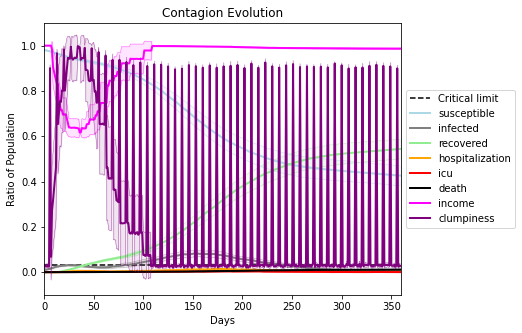

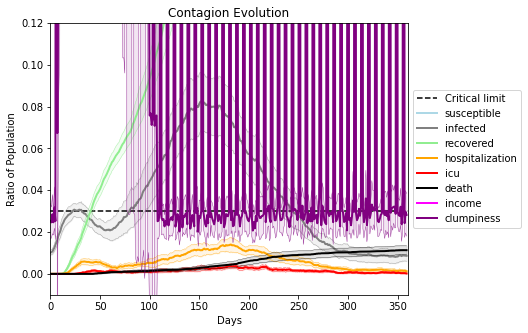

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7555, 7329, 1386, 2785, 2670, 7346, 9568, 1286, 1748, 9082, 404, 435, 4640, 7391, 519, 3338, 5975, 5254, 6578, 7545]
Average similarity between family members is 0.10711201752076911 at temperature 0.33
Average similarity between family and home is 0.9998576136564388 at temperature -1
Average similarity between students and their classroom is 0.14866736228455774 at temperature 0.33
Average classroom occupancy is 4.098591549295775 and number classrooms is 71
Average similarity between workers is 0.09352317154948396 at temperature 0.33
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.1676229122680504 for kids: 0.16806046802716681
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.17532937586543662
avg restaurant similarity 0.03131322153014221
avg restaurant similarity -0.20180079159351366
avg restaurant similarity 0.46906844919608504
avg restaurant similarity -0.0624168354983017
avg restaurant similarity 0.019838254790667587
avg restaurant similarity 0.2627988070700176
avg restaurant similarity -0.20180079159351366
avg restaurant similarity -0.16006278475442293
avg restaurant similarity 0.03131322153014221
avg restaurant similarity 0.04868869597969858
avg restaurant similarity 0.07314045046122228
avg restaurant similarity 0.11741839246417649
avg restaurant similarity -0.2529586246798447
avg restaurant similarity 0.06060855565671826
avg restaurant similarity -0.036304544643604386
avg restaurant similarity -0.1898772998932513
avg restaurant similarity -0.20180079159351366
avg restaurant similarity 0.10642891983707785
avg restaurant similarity 0.5259207152198639
avg restaurant similarity 0.04249395843986389
avg restaurant similarity 0.2

avg restaurant similarity 0.06307633403314707
avg restaurant similarity 0.2111082903515178
avg restaurant similarity -0.1752355136841715
avg restaurant similarity -0.2529550366327276
avg restaurant similarity 0.5185037451092073
avg restaurant similarity 0.3565995549355175
avg restaurant similarity -0.10046990490950282
avg restaurant similarity -0.09604035864843463
avg restaurant similarity -0.27486648545891823
avg restaurant similarity -0.018388311934464927
avg restaurant similarity -0.0850781276638847
avg restaurant similarity -0.38341449713424225
avg restaurant similarity 0.17436598806045306
avg restaurant similarity -0.07518278218719261
avg restaurant similarity -0.11747527988564835
avg restaurant similarity 0.5378901692023421
avg restaurant similarity -0.010138820586355943
avg restaurant similarity 0.4514365375747178
avg restaurant similarity 0.02908383055244589
avg restaurant similarity 0.01286909418040794
avg restaurant similarity 0.9107544516706507
avg restaurant similarity 0.31

avg restaurant similarity -0.11699207230453151
avg restaurant similarity -0.13656080628221484
avg restaurant similarity 0.18469594280777135
avg restaurant similarity 0.37543526039191516
avg restaurant similarity -0.03956072455874837
avg restaurant similarity 0.2832546323858162
avg restaurant similarity -0.23695550465198456
avg restaurant similarity -0.21344688871409734
avg restaurant similarity 0.21839364553481455
avg restaurant similarity -0.08818242199518155
avg restaurant similarity 0.3601858461830928
avg restaurant similarity 0.3567688411679023
avg restaurant similarity -0.24143916267795026
avg restaurant similarity 0.32538779340683227
avg restaurant similarity 0.3115273179783124
avg restaurant similarity 0.15348593096312566
avg restaurant similarity 0.20468881331629285
avg restaurant similarity 0.07751965321856506
avg restaurant similarity 0.1585739316113558
avg restaurant similarity 0.1585739316113558
avg restaurant similarity -0.011559796171586634
avg restaurant similarity -0.08

avg restaurant similarity 0.07637608568705126
avg restaurant similarity 0.022920573523342234
avg restaurant similarity 0.18679760963065983
avg restaurant similarity -0.11501861010952127
avg restaurant similarity 0.18141862348672202
avg restaurant similarity -0.022911607287955937
avg restaurant similarity -0.07944121042301036
avg restaurant similarity 0.18422456499061063
avg restaurant similarity -0.3459604763693827
avg restaurant similarity -0.13439681603715928
avg restaurant similarity 0.04040403573992157
avg restaurant similarity 0.26210725686069947
avg restaurant similarity -0.046847593476678454
avg restaurant similarity 0.003165343858451436
avg restaurant similarity -0.078733858223693
avg restaurant similarity -0.21111779574080966
avg restaurant similarity 0.30491723322667647
avg restaurant similarity -0.10536881210625884
avg restaurant similarity -0.15949500422897972
avg restaurant similarity -0.4792825181712199
avg restaurant similarity -0.11089564452230627
avg restaurant similar

avg restaurant similarity 0.0005607508357020249
avg restaurant similarity -0.08401187190893752
avg restaurant similarity -0.05856145084837446
avg restaurant similarity 0.09438319707913806
avg restaurant similarity 0.20385074802591793
avg restaurant similarity 0.013698961678766108
avg restaurant similarity 0.27676839917968465
avg restaurant similarity 0.43102673394727864
avg restaurant similarity -0.41457309034191514
avg restaurant similarity -0.044938669454520325
avg restaurant similarity 0.25991842970510615
avg restaurant similarity 0.004765719741629482
avg restaurant similarity 0.1490328905180885
avg restaurant similarity 0.5809770926676509
avg restaurant similarity 0.08683849606282604
avg restaurant similarity -0.0689696487513986
avg restaurant similarity -0.20320258158842078
avg restaurant similarity 0.34894903790749454
avg restaurant similarity 0.03622325666314813
avg restaurant similarity -0.03987400499598191
avg restaurant similarity -0.21271513563086605
avg restaurant similarit

avg restaurant similarity -0.15659754992660654
avg restaurant similarity -0.14834745239522648
avg restaurant similarity 0.18488261939045086
avg restaurant similarity 0.070291410866512
avg restaurant similarity 0.23533832495661727
avg restaurant similarity -0.18224700704380842
avg restaurant similarity 0.0010014151604385985
avg restaurant similarity -0.1693166474839356
avg restaurant similarity -0.11839058124706107
avg restaurant similarity -0.5414117331170024
avg restaurant similarity -0.12203134344347107
avg restaurant similarity -0.30155273541486166
avg restaurant similarity 0.5922863375443449
avg restaurant similarity -0.1362563897491965
avg restaurant similarity 0.14089833265031498
avg restaurant similarity -0.23516291544825751
avg restaurant similarity -0.22887446876057946
avg restaurant similarity -0.07578838328577303
avg restaurant similarity -0.00142935729504641
avg restaurant similarity 0.3822964396837585
avg restaurant similarity -0.21294481946514987
avg restaurant similarity

Average similarity between workers is 0.10160959055855304 at temperature 0.33
Average office occupancy is 3.283582089552239 and number offices is 201
Average friend similarity for adults: 0.17333425110747205 for kids: 0.1522179035546445
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity -0.09614765713932659
avg restaurant similarity 0.295788304739706
avg restaurant similarity -0.19449603453285916
avg restaurant similarity 0.18606391735469277
avg restaurant similarity 0.614867971865019
avg restaurant similarity 0.3907395729760787
avg restaurant similarity -0.3231560946277054
avg restaurant similarity -0.08698824637010014
avg restaurant similarity -0.09276703370854184
avg restaurant similarity 0.08759595847095016
avg restaurant similarity 0.02224971556435887
avg restaurant similarity -0.2527391720216256
avg restaurant similarity 0.12540044703302766
avg restaurant similarity -0.2209389629402822
avg restaurant similarity 0.00029509212483369573
avg restaurant similarity 0.015384823202905906
avg restaurant similarity 0.2103863336717804
avg restaurant similarity -0.11835529166115079
avg restaurant similarity 0.7713090607794841
avg restaurant similarity 0.12453672784013013
avg restaurant similarity -0.43317420117654293
avg restaurant similarity -0.41

avg restaurant similarity -0.05908313170473421
avg restaurant similarity -0.1575657971364631
avg restaurant similarity 0.15861103627394724
avg restaurant similarity 0.12118247895267721
avg restaurant similarity 0.012222094812169432
avg restaurant similarity 0.12290423427562944
avg restaurant similarity -0.15237510721784758
avg restaurant similarity 0.07885759507167753
avg restaurant similarity -0.04734534585636858
avg restaurant similarity 0.06698331711157764
avg restaurant similarity 0.0006467388198254757
avg restaurant similarity 0.22924814841139085
avg restaurant similarity 0.1597692066202921
avg restaurant similarity -0.06352912089386366
avg restaurant similarity 0.32323559165635846
avg restaurant similarity -0.2076226149478056
avg restaurant similarity 0.0023712946386917483
avg restaurant similarity 0.6889159750023076
avg restaurant similarity -0.15237510721784758
avg restaurant similarity 0.046881021286035336
avg restaurant similarity 0.24790366515150794
avg restaurant similarity

avg restaurant similarity 0.028461274493443316
avg restaurant similarity -0.03892655244076115
avg restaurant similarity 0.3179805491921097
avg restaurant similarity 0.12099961789352934
avg restaurant similarity 0.1601939838331388
avg restaurant similarity -0.18897818627503854
avg restaurant similarity -0.05986091845600172
avg restaurant similarity -0.12093616864900186
avg restaurant similarity 0.00486706302143098
avg restaurant similarity 0.028982603338152335
avg restaurant similarity 0.35414420076459774
avg restaurant similarity -0.08585246750417948
avg restaurant similarity 0.30063488947742467
avg restaurant similarity -0.1571569488983422
avg restaurant similarity 0.1323487883556029
avg restaurant similarity -0.10706930448499653
avg restaurant similarity 0.12835872521927358
avg restaurant similarity 0.07643865697325905
avg restaurant similarity 0.4894051896904832
avg restaurant similarity 0.2358434466149188
avg restaurant similarity 0.217369981758408
avg restaurant similarity -0.0301

avg restaurant similarity -0.001458989734442162
avg restaurant similarity 0.18727522128868343
avg restaurant similarity 0.14855760250425115
avg restaurant similarity 0.047483891278630265
avg restaurant similarity -0.06516788734185922
avg restaurant similarity 0.21322040596852498
avg restaurant similarity 0.20211201166437595
avg restaurant similarity 0.09117974947381853
avg restaurant similarity -0.2338072887931022
avg restaurant similarity 0.3124137390271305
avg restaurant similarity -0.010079761416080212
avg restaurant similarity 0.31169567349303906
avg restaurant similarity -0.23175010533049648
avg restaurant similarity 0.2253058737567733
avg restaurant similarity -0.08001374900493768
avg restaurant similarity 0.21608003949369523
avg restaurant similarity 0.053970626849695155
avg restaurant similarity 0.47881140872842476
avg restaurant similarity 0.04814324138967269
avg restaurant similarity 0.0089928975464027
avg restaurant similarity 0.2058747319752166
avg restaurant similarity 0.0

Average similarity between students and their classroom is 0.10792496558550177 at temperature 0.33
Average classroom occupancy is 3.9295774647887325 and number classrooms is 71
Average similarity between workers is 0.10513141976227683 at temperature 0.33
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 0.16355884400822263 for kids: 0.16466149088205986
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocate

avg restaurant similarity 0.2599884138608502
avg restaurant similarity 0.1607429799022709
avg restaurant similarity -0.024366853436399345
avg restaurant similarity 0.10697194946826849
avg restaurant similarity -0.27706040262652143
avg restaurant similarity 0.33821799635165506
avg restaurant similarity -0.0911350690550877
avg restaurant similarity 0.0819191942057233
avg restaurant similarity -0.017322704841435388
avg restaurant similarity 0.029783674180400233
avg restaurant similarity 0.22762712780512362
avg restaurant similarity 0.0329407967102486
avg restaurant similarity -0.157602764836846
avg restaurant similarity -0.05201890819027776
avg restaurant similarity -0.3726017905656827
avg restaurant similarity -0.1613878196012894
avg restaurant similarity 0.21684950602766578
avg restaurant similarity -0.12936490137891118
avg restaurant similarity 0.10158585054449576
avg restaurant similarity -0.08566355256962321
avg restaurant similarity 0.07067940888259268
avg restaurant similarity 0.18

avg restaurant similarity 0.1726056138548846
avg restaurant similarity -0.01814718305933931
avg restaurant similarity 0.013961416458734395
avg restaurant similarity -0.34267394349136493
avg restaurant similarity 0.11119326510532519
avg restaurant similarity 0.05305290119588401
avg restaurant similarity -0.08171476222251028
avg restaurant similarity -0.16377239994562254
avg restaurant similarity -0.16637646819862492
avg restaurant similarity 0.1275711571474326
avg restaurant similarity 0.24144703742181853
avg restaurant similarity 0.3969407807491979
avg restaurant similarity 0.38014119569692073
avg restaurant similarity -0.0016160489335703687
avg restaurant similarity -0.11435682526231072
avg restaurant similarity -0.0419662222737099
avg restaurant similarity 0.18679919881037443
avg restaurant similarity 0.17610505424413928
avg restaurant similarity -0.037668212404681614
avg restaurant similarity 0.22853582575119416
avg restaurant similarity -0.16611216583859476
avg restaurant similarit

avg restaurant similarity -0.13808506979544
avg restaurant similarity 0.010820469217474787
avg restaurant similarity 0.1576758672435562
avg restaurant similarity 0.05940831610860123
avg restaurant similarity 0.20813753546342909
avg restaurant similarity 0.21725966874339123
avg restaurant similarity 0.28182425831983304
avg restaurant similarity 0.49248591854110574
avg restaurant similarity -0.2679093346801555
avg restaurant similarity 0.15297232123013346
avg restaurant similarity 0.13985182111458833
avg restaurant similarity 0.16030525599157708
avg restaurant similarity 0.42734736690183966
avg restaurant similarity -0.19514293078193912
avg restaurant similarity 0.18390577090353094
avg restaurant similarity 0.26775053080862654
avg restaurant similarity 0.14134550432120355
avg restaurant similarity 0.5286622650875523
avg restaurant similarity 0.106810696015003
avg restaurant similarity -0.11331786038867953
avg restaurant similarity -0.058600365487398505
avg restaurant similarity 0.0473280

avg restaurant similarity 0.1898668116880441
avg restaurant similarity -0.27441532381135847
avg restaurant similarity 0.6211121025864123
avg restaurant similarity 0.29755014571527455
avg restaurant similarity -0.11054051702585088
avg restaurant similarity 0.09231698598505943
avg restaurant similarity -0.08056326557375164
avg restaurant similarity 0.0018567727044868643
avg restaurant similarity -0.06173576847148927
avg restaurant similarity -0.08869678614550693
avg restaurant similarity 0.22215873976674455
avg restaurant similarity 0.6866976038132868
avg restaurant similarity -0.07688846501598164
avg restaurant similarity 0.29235789152190184
avg restaurant similarity 0.18012647037631752
avg restaurant similarity 0.12217566388507789
avg restaurant similarity -0.17075053391862732
avg restaurant similarity 0.11540231955335256
avg restaurant similarity 0.11968764694210846
avg restaurant similarity -0.06732159295059033
avg restaurant similarity 0.44941557098759405
avg restaurant similarity -

avg restaurant similarity 0.07390990336112747
avg restaurant similarity 0.2352870621486182
avg restaurant similarity -0.2610112815680532
avg restaurant similarity 0.040740821145259586
avg restaurant similarity 0.03867165148713318
avg restaurant similarity 0.14140082456946879
avg restaurant similarity 0.41759197442640394
avg restaurant similarity 0.18492930499257468
avg restaurant similarity 0.2569383357784857
avg restaurant similarity 0.20947076267632425
avg restaurant similarity -0.22496669823112808
avg restaurant similarity 0.13246502487413842
avg restaurant similarity 0.4643162957421988
avg restaurant similarity 0.09322206986754027
avg restaurant similarity -0.1539169241857976
avg restaurant similarity -0.03247257264917542
avg restaurant similarity 0.05861404953105606
avg restaurant similarity 0.09603214151232456
avg restaurant similarity 0.23886243547010033
avg restaurant similarity 0.07450913704265881
avg restaurant similarity 0.04607318239990564
avg restaurant similarity 0.383341

avg restaurant similarity 0.2856012396278461
avg restaurant similarity -0.07000229864891552
avg restaurant similarity 0.08507507289118735
avg restaurant similarity 0.1785311510966385
avg restaurant similarity 0.07744907333563641
avg restaurant similarity -0.42495834944940847
avg restaurant similarity 0.11621619234037216
avg restaurant similarity 0.15392054734119212
avg restaurant similarity -0.15302851435308432
avg restaurant similarity -0.38791736591868764
avg restaurant similarity -0.11359685099988802
avg restaurant similarity 0.18447610411187826
avg restaurant similarity -0.15302851435308432
avg restaurant similarity -0.12329920493080562
avg restaurant similarity -0.11286709456609338
avg restaurant similarity 0.5182644786082291
avg restaurant similarity 0.18096133665816355
avg restaurant similarity 0.06363911137733447
avg restaurant similarity 0.4183833421640621
avg restaurant similarity 0.15625826081146954
avg restaurant similarity 0.4949294764802924
avg restaurant similarity -0.15

avg restaurant similarity -0.09298155805281731
avg restaurant similarity 0.21456337519839797
avg restaurant similarity -0.12801363788154413
avg restaurant similarity 0.0922597324509414
avg restaurant similarity 0.15045935648970168
avg restaurant similarity 0.017873669780623574
avg restaurant similarity 0.09475481619524548
avg restaurant similarity 0.09475481619524548
avg restaurant similarity 0.24682268060034773
avg restaurant similarity -0.16054356653290247
avg restaurant similarity -0.09716181753206089
avg restaurant similarity -0.23921521204843632
avg restaurant similarity 0.3277179042076367
avg restaurant similarity 0.13823295905146277
avg restaurant similarity 0.16511062029385198
avg restaurant similarity -0.049577007088972246
avg restaurant similarity 0.12687514025475854
avg restaurant similarity 0.05915108492702155
avg restaurant similarity 0.07675022092967604
avg restaurant similarity -0.031983925811539714
avg restaurant similarity 0.12162830960731333
avg restaurant similarity 

Average similarity between family and home is 0.9998524055134386 at temperature -1
Average similarity between students and their classroom is 0.08649394765351255 at temperature 0.33
Average classroom occupancy is 4.222222222222222 and number classrooms is 72
Average similarity between workers is 0.10344967593477468 at temperature 0.33
Average office occupancy is 3.2346938775510203 and number offices is 196
Average friend similarity for adults: 0.15550891338299633 for kids: 0.16171037689088533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity -0.3970930597524057
avg restaurant similarity 0.14960018675691422
avg restaurant similarity 0.32974278015495134
avg restaurant similarity 0.21832541696370855
avg restaurant similarity -0.3970930597524057
avg restaurant similarity 0.14905613974855983
avg restaurant similarity 0.19618628958860426
avg restaurant similarity -0.2135990298950404
avg restaurant similarity 0.23017325068727978
avg restaurant similarity -0.09897655850955603
avg restaurant similarity -0.3970930597524057
avg restaurant similarity -0.2813805716109379
avg restaurant similarity -0.3747921333089932
avg restaurant similarity 0.39214782138259396
avg restaurant similarity -0.23531722267629798
avg restaurant similarity 0.06720445944967883
avg restaurant similarity -0.30692797445627695
avg restaurant similarity 0.22004467037112363
avg restaurant similarity 0.1952851536212228
avg restaurant similarity -0.17832943936560763
avg restaurant similarity 0.13860357279081928
avg restaurant similarity -0.07

avg restaurant similarity -0.105848771086511
avg restaurant similarity 0.5082637268996237
avg restaurant similarity -0.019978072278075742
avg restaurant similarity 0.09921088990852293
avg restaurant similarity 0.021995773703170116
avg restaurant similarity 0.23351937956990584
avg restaurant similarity -0.24539794643952392
avg restaurant similarity 0.07309790252578525
avg restaurant similarity 0.6717961208754639
avg restaurant similarity -0.2888331982709208
avg restaurant similarity 0.35129500028266847
avg restaurant similarity 0.3959992174396161
avg restaurant similarity 0.0020334434953376396
avg restaurant similarity 0.028065878415811152
avg restaurant similarity 0.48604107678923775
avg restaurant similarity 0.16124006693612172
avg restaurant similarity -0.19908951055629753
avg restaurant similarity 0.18386325339504028
avg restaurant similarity 0.410693414938913
avg restaurant similarity -0.19908951055629753
avg restaurant similarity 0.1061777718090456
avg restaurant similarity 0.1160

avg restaurant similarity -0.08054933580827088
avg restaurant similarity 0.06038394957777757
avg restaurant similarity 0.16721185052830115
avg restaurant similarity 0.3177600239894162
avg restaurant similarity 0.11289376585039941
avg restaurant similarity -0.03545466910154122
avg restaurant similarity 0.16695878305424913
avg restaurant similarity -0.2874024031000459
avg restaurant similarity 0.11770036710591833
avg restaurant similarity -0.030299163385518246
avg restaurant similarity -0.2903659235637749
avg restaurant similarity -0.1626215767424052
avg restaurant similarity 0.1839753579880171
avg restaurant similarity -0.0623962611067381
avg restaurant similarity -0.21836950969474248
avg restaurant similarity 0.2745333674823019
avg restaurant similarity 0.015587838238354024
avg restaurant similarity -0.042613966548004076
avg restaurant similarity 0.2242956671383088
avg restaurant similarity 0.10208310131321555
avg restaurant similarity 0.07324879545295526
avg restaurant similarity 0.03

(<function dict.items>, <function dict.items>, <function dict.items>)

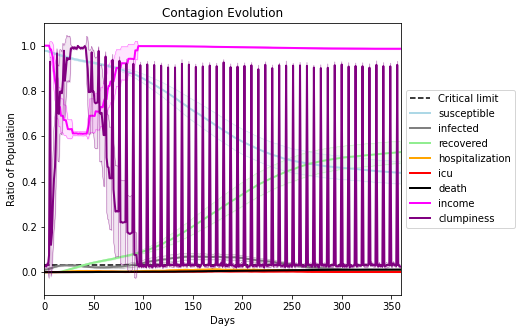

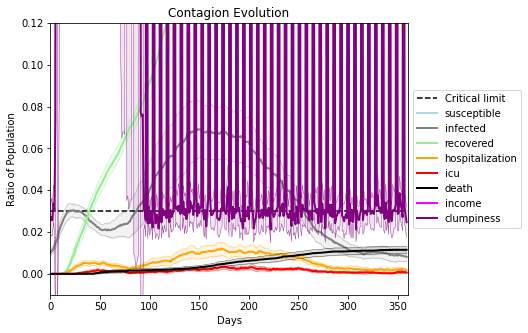

In [45]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5588, 30, 9125, 1643, 2981, 3435, 4191, 9281, 5184, 6577, 5838, 4325, 5418, 8714, 1426, 2740, 1104, 5127, 4945, 3590]
Average similarity between family members is 0.052940782951594385 at temperature 0.66
Average similarity between family and home is 0.9998522555442334 at temperature -1
Average similarity between students and their classroom is 0.04248098526975149 at temperature 0.66
Average classroom occupancy is 4.428571428571429 and number classrooms is 70
Average similarity between workers is 0.049366467825140266 at temperature 0.66
Average office occupancy is 3.2060301507537687 and number offices is 199
Average friend similarity for adults: 0.12620292415395717 for kids: 0.11386534588963046
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.3809002175101665
avg restaurant similarity 0.008062630545472599
avg restaurant similarity 0.24708629103227095
avg restaurant similarity -0.12110253007546101
avg restaurant similarity 0.5385970708315011
avg restaurant similarity 0.13634770294238271
avg restaurant similarity 0.2865200476601553
avg restaurant similarity 0.05394475908916348
avg restaurant similarity 0.44860703450030925
avg restaurant similarity 0.03280648709970514
avg restaurant similarity -0.3060687848896463
avg restaurant similarity 0.37789793007067524
avg restaurant similarity -0.5081527394640251
avg restaurant similarity 0.40476843917078975
avg restaurant similarity -0.12110253007546101
avg restaurant similarity 0.2277530016571751
avg restaurant similarity 0.237212613978754
avg restaurant similarity 0.06703789425397223
avg restaurant similarity 0.19406091409778436
avg restaurant similarity 0.011437412268634622
avg restaurant similarity 0.10431014745469874
avg restaurant similarity -0.2563491

avg restaurant similarity 0.10904016542540065
avg restaurant similarity -0.3505346086024528
avg restaurant similarity -0.26381310432985305
avg restaurant similarity 0.2853606994496392
avg restaurant similarity 0.1305406836954306
avg restaurant similarity -0.08900100916182593
avg restaurant similarity -0.13657507092046
avg restaurant similarity 0.22432969043305703
avg restaurant similarity 0.02047117954141245
avg restaurant similarity -0.08035918589351461
avg restaurant similarity 0.0575449029012574
avg restaurant similarity -0.4964248709178629
avg restaurant similarity -0.4489734656847587
avg restaurant similarity -0.2279981628744875
avg restaurant similarity -0.6012775950528252
avg restaurant similarity 0.042847683882044324
avg restaurant similarity -0.061188176673548006
avg restaurant similarity -0.4504459841393676
avg restaurant similarity 0.25394452157874375
avg restaurant similarity -0.06906307508406133
avg restaurant similarity -0.1755273664799369
avg restaurant similarity -0.093

avg restaurant similarity -0.01113056443207086
avg restaurant similarity 0.04548527248677817
avg restaurant similarity 0.07494011059788862
avg restaurant similarity 0.2630376257347237
avg restaurant similarity -0.02268051700182344
avg restaurant similarity -0.044947665509312645
avg restaurant similarity -0.2043791334058792
avg restaurant similarity -0.008564895505382142
avg restaurant similarity 0.1515520138399185
avg restaurant similarity -0.1619828785894506
avg restaurant similarity -0.21857001151117483
avg restaurant similarity -0.28482145652541724
avg restaurant similarity -0.005101898616505933
avg restaurant similarity -0.08604609042242475
avg restaurant similarity 0.19574093208366877
avg restaurant similarity 0.04652707237821927
avg restaurant similarity -0.10485892696873719
avg restaurant similarity 0.30818564972072987
avg restaurant similarity 0.040622646553873376
avg restaurant similarity -0.2643657207619771
avg restaurant similarity 0.22934414147879478
avg restaurant similari

Average similarity between workers is 0.08132190140546708 at temperature 0.66
Average office occupancy is 3.334975369458128 and number offices is 203
Average friend similarity for adults: 0.12694063054052443 for kids: 0.1109854524237713
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.10649013913300277
avg restaurant similarity -0.43404556572493647
avg restaurant similarity -0.12040299117220399
avg restaurant similarity -0.14576413290621026
avg restaurant similarity 0.11906910333504257
avg restaurant similarity 0.2612125503469083
avg restaurant similarity -0.12935647772743633
avg restaurant similarity 0.44073289012286165
avg restaurant similarity -0.08670320662517378
avg restaurant similarity 0.02515592142290804
avg restaurant similarity 0.19361732862267145
avg restaurant similarity -0.44141705026898187
avg restaurant similarity -0.03586590485011673
avg restaurant similarity 0.38540041215818965
avg restaurant similarity 0.2918330314719312
avg restaurant similarity 0.23932525649986308
avg restaurant similarity 0.3626748242966733
avg restaurant similarity 0.24448420825360523
avg restaurant similarity -0.06016612201239537
avg restaurant similarity 0.05470698405489674
avg restaurant similarity 0.5397176578794579
avg restaurant similarity -0.1

avg restaurant similarity -0.04690641697332517
avg restaurant similarity -0.037921771284724605
avg restaurant similarity 0.09478808754948784
avg restaurant similarity 0.09489731041921064
avg restaurant similarity -0.16944422731776676
avg restaurant similarity 0.33731132203976677
avg restaurant similarity 0.31728466755071
avg restaurant similarity 0.2447512837910225
avg restaurant similarity -0.17837814446261507
avg restaurant similarity -0.014060640325894658
avg restaurant similarity -0.013662785119689519
avg restaurant similarity 0.09186998333473599
avg restaurant similarity 0.26771968513163297
avg restaurant similarity -0.09232251434550122
avg restaurant similarity -0.014938845586605798
avg restaurant similarity 0.15727113374864038
avg restaurant similarity -0.039252605612149605
avg restaurant similarity -0.057222106530738705
avg restaurant similarity -0.10810701256533581
avg restaurant similarity -0.441498487891729
avg restaurant similarity 0.06620157522001432
avg restaurant similar

avg restaurant similarity 0.2945709874684317
Average similarity between family members is 0.03906296077297697 at temperature 0.66
Average similarity between family and home is 0.9998529994291172 at temperature -1
Average similarity between students and their classroom is 0.06453909286160164 at temperature 0.66
Average classroom occupancy is 4.23943661971831 and number classrooms is 71
Average similarity between workers is 0.07423644660295357 at temperature 0.66
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.11859489919498066 for kids: 0.11759609249361727
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.003419606358374322
avg restaurant similarity -0.09109027820028057
avg restaurant similarity 0.05796262248107635
avg restaurant similarity 0.1961729259274552
avg restaurant similarity -0.4448941661837584
avg restaurant similarity 0.11720302677521169
avg restaurant similarity 0.09276010244996746
avg restaurant similarity 0.410686160154202
avg restaurant similarity -0.10299314243113791
avg restaurant similarity 0.5236435935676058
avg restaurant similarity 0.01008192290913722
avg restaurant similarity -0.008248652439972741
avg restaurant similarity -0.056429751350110725
avg restaurant similarity 0.12365490692511463
avg restaurant similarity 0.16880901503847517
avg restaurant similarity 0.24821395099622706
avg restaurant similarity -0.013900971354344625
avg restaurant similarity 0.2657830496811584
avg restaurant similarity 0.0869242077046406
avg restaurant similarity 0.1705522385716312
avg restaurant similarity 0.10707943790354944
avg restaurant similarity 0.5422

avg restaurant similarity 0.193768913642842
avg restaurant similarity 0.013308879182006801
avg restaurant similarity -0.15411305808842662
avg restaurant similarity -0.09843272211883763
avg restaurant similarity 0.014607119896892727
avg restaurant similarity 0.017126805752275077
avg restaurant similarity 0.17383999495180213
avg restaurant similarity -0.082658393265902
avg restaurant similarity 0.3967150561846422
avg restaurant similarity -0.047019630174367916
avg restaurant similarity -0.058942620382127886
avg restaurant similarity 0.19790755673474042
avg restaurant similarity 0.2214624804467053
avg restaurant similarity 0.12291881051701167
avg restaurant similarity 0.29913210506172067
avg restaurant similarity 0.11024857863439823
avg restaurant similarity 0.09107984630473588
avg restaurant similarity -0.0423693523899303
avg restaurant similarity 0.3021156340682288
avg restaurant similarity -0.16199403547816246
avg restaurant similarity 0.32416538844235987
avg restaurant similarity -0.0

avg restaurant similarity 0.06523937514931702
avg restaurant similarity 0.3168375991155415
avg restaurant similarity 0.2617307369484291
avg restaurant similarity -0.07965001551210332
avg restaurant similarity 0.08473568603411506
avg restaurant similarity 0.09997395998585386
avg restaurant similarity 0.1894324353547676
avg restaurant similarity 0.5455505863222905
avg restaurant similarity -0.10115852932455978
avg restaurant similarity 0.29403331699807944
avg restaurant similarity 0.045831434174587155
avg restaurant similarity -0.2296163238136861
avg restaurant similarity -0.16743314100355178
avg restaurant similarity -0.09653681280680793
avg restaurant similarity -0.21143451303373492
avg restaurant similarity 0.007130096638480035
avg restaurant similarity -0.08140039178513957
avg restaurant similarity -0.008799297680003648
avg restaurant similarity -0.037665741875767565
avg restaurant similarity 0.08081070759206567
avg restaurant similarity -0.21687622283421043
avg restaurant similarity

avg restaurant similarity 0.055420749534490096
avg restaurant similarity 0.16921733149988225
avg restaurant similarity -0.09237290590299074
avg restaurant similarity -0.061471148695191026
avg restaurant similarity -0.11128849188832597
avg restaurant similarity -0.0005793087459902476
avg restaurant similarity -0.06895324308167328
avg restaurant similarity 0.11428909579870546
avg restaurant similarity -0.12740179303733726
avg restaurant similarity 0.20206588313023893
avg restaurant similarity 0.02553651631316078
avg restaurant similarity -0.020734947611651323
avg restaurant similarity -0.12740179303733726
avg restaurant similarity -0.18858316750429152
avg restaurant similarity 0.1729081411379916
avg restaurant similarity -0.04273573707864886
avg restaurant similarity 0.19823804527357694
avg restaurant similarity 0.05829666866217757
avg restaurant similarity 0.02083087163662807
avg restaurant similarity -0.0765018541748576
avg restaurant similarity 0.02083087163662807
avg restaurant simil

avg restaurant similarity 0.21115919706088745
avg restaurant similarity -0.39329904687201706
avg restaurant similarity -0.0511022050560211
avg restaurant similarity 0.21288556844113038
avg restaurant similarity -0.0889552961286505
avg restaurant similarity 0.07309391701024168
avg restaurant similarity -0.11892525118477325
avg restaurant similarity -0.10403767876103755
avg restaurant similarity 0.33928312679931666
avg restaurant similarity -0.11513729298494707
avg restaurant similarity -0.13183491698746613
avg restaurant similarity 0.27149641114624506
avg restaurant similarity 0.15805479227444924
avg restaurant similarity 0.22676706536903266
avg restaurant similarity 0.31964327900956496
avg restaurant similarity -0.11137656820527614
avg restaurant similarity 0.08566788167604562
avg restaurant similarity 0.24956853111095495
avg restaurant similarity -0.07798690365228363
avg restaurant similarity 0.2904665774531608
avg restaurant similarity -0.11862323219032657
avg restaurant similarity -

avg restaurant similarity -0.40781303537122626
avg restaurant similarity 0.20846535154604606
avg restaurant similarity 0.19452439459582493
avg restaurant similarity -0.2055122753902379
avg restaurant similarity -0.2998756231657129
avg restaurant similarity 0.28283259861488086
avg restaurant similarity -0.12836915945212013
avg restaurant similarity 0.04788629197187258
avg restaurant similarity -0.3321877061736997
avg restaurant similarity 0.22011981586340193
avg restaurant similarity 0.06067054171115518
avg restaurant similarity -0.12477476627970983
avg restaurant similarity -0.15100122494561397
avg restaurant similarity -0.06953805456279324
avg restaurant similarity 0.0033129007035285207
avg restaurant similarity 0.09086902622785671
avg restaurant similarity 0.19678290419517452
avg restaurant similarity -0.17170856741946527
avg restaurant similarity -0.0800315625414096
avg restaurant similarity 0.05047474671122096
avg restaurant similarity -0.125734819152352
avg restaurant similarity 0

avg restaurant similarity -0.00531949584809048
avg restaurant similarity 0.6408185196759799
avg restaurant similarity -0.144790730229988
avg restaurant similarity 0.14582835930464433
avg restaurant similarity -0.4820771947411512
avg restaurant similarity -0.3020747627563319
avg restaurant similarity -0.01613912602624675
avg restaurant similarity 0.12696505868427338
avg restaurant similarity -0.19312434342875254
avg restaurant similarity 0.21373217724821433
avg restaurant similarity -0.10658910563100307
avg restaurant similarity -0.15221712011767974
avg restaurant similarity 0.4281750020175237
avg restaurant similarity -0.10658910563100307
avg restaurant similarity -0.1333301441873538
avg restaurant similarity -0.26972266556614055
avg restaurant similarity -0.021031599788307875
avg restaurant similarity 0.20780759401070625
avg restaurant similarity 0.047428535667200795
avg restaurant similarity 0.36950607366839944
avg restaurant similarity -0.20727209129962548
avg restaurant similarity 

avg restaurant similarity -0.383616339792685
avg restaurant similarity 0.16075759419142333
avg restaurant similarity 0.059639613420670784
avg restaurant similarity 0.01685085669653183
avg restaurant similarity 0.012142902264324101
avg restaurant similarity -0.04361176947381148
avg restaurant similarity 0.708229987035315
avg restaurant similarity 0.13022028569427152
avg restaurant similarity -0.12697995599791972
avg restaurant similarity 0.2951413292428494
avg restaurant similarity -0.10393090237110925
avg restaurant similarity -0.12354778698283962
avg restaurant similarity 0.3313441888889581
avg restaurant similarity 0.2614482486072637
avg restaurant similarity -0.022220658330165427
avg restaurant similarity 0.214162913156684
avg restaurant similarity 0.16026327621329056
avg restaurant similarity -0.3155714200048868
avg restaurant similarity -0.02118668836833417
avg restaurant similarity 0.12645989797501167
avg restaurant similarity 0.3849634613471559
avg restaurant similarity 0.180704

avg restaurant similarity 0.035840586127960664
avg restaurant similarity 0.14021567664923837
avg restaurant similarity 0.054245874603737386
avg restaurant similarity -0.004259228747648482
avg restaurant similarity 0.050290608405996556
avg restaurant similarity 0.3285260753204586
avg restaurant similarity -0.01331760917985207
avg restaurant similarity 0.16189833485336175
avg restaurant similarity 0.10974502852701358
avg restaurant similarity 0.11867584366545261
avg restaurant similarity 0.2581386562819165
avg restaurant similarity 0.11834044428702917
avg restaurant similarity 0.2573860481380672
avg restaurant similarity -0.06973749727630468
avg restaurant similarity -0.25537724616389856
avg restaurant similarity 0.2816046936258183
avg restaurant similarity -0.1972501202881943
avg restaurant similarity -0.2337625563697656
avg restaurant similarity 0.15805484410717732
avg restaurant similarity 0.3010522057594378
avg restaurant similarity -0.08659083622963862
avg restaurant similarity -0.3

avg restaurant similarity -0.3456404153004748
avg restaurant similarity -0.21039148329533197
avg restaurant similarity -0.07162390620218549
avg restaurant similarity 0.032847942974874283
avg restaurant similarity 0.30463450111679935
avg restaurant similarity -0.24210503113014395
avg restaurant similarity 0.1679204381098458
avg restaurant similarity 0.002209722797740732
avg restaurant similarity -0.1681536061632853
avg restaurant similarity 0.10633808048868926
avg restaurant similarity 0.4516010818734431
avg restaurant similarity 0.23809827447272497
avg restaurant similarity 0.059888947342648
avg restaurant similarity 0.05311101830291637
avg restaurant similarity -0.004160267369142222
avg restaurant similarity -0.16034908641625492
avg restaurant similarity -0.20149064536971273
avg restaurant similarity 0.06700168057605041
avg restaurant similarity 0.13061451860280163
avg restaurant similarity -0.08020396155609034
avg restaurant similarity 0.483350642115564
avg restaurant similarity -0.2

avg restaurant similarity 0.07882994614805731
avg restaurant similarity 0.011001137227803437
avg restaurant similarity -0.03243205977200029
avg restaurant similarity -0.06554527736373807
avg restaurant similarity -0.1404826157775429
avg restaurant similarity -0.07629107626333076
avg restaurant similarity -0.24713839333827742
avg restaurant similarity 0.3802906181455413
avg restaurant similarity -0.2214899854552037
avg restaurant similarity -0.33122429025828504
avg restaurant similarity -0.012951495515775985
avg restaurant similarity -0.22147772663657905
avg restaurant similarity 0.14630935665936973
avg restaurant similarity 0.5497690204212412
avg restaurant similarity -0.4409211514076505
avg restaurant similarity 0.1851498483110453
avg restaurant similarity -0.002535913797779024
avg restaurant similarity -0.21601475866705683
avg restaurant similarity 0.1324289037484505
avg restaurant similarity 0.030167134825243802
avg restaurant similarity 0.23296346177161342
avg restaurant similarity

avg restaurant similarity 0.26905153841589957
avg restaurant similarity 0.21449585127445475
avg restaurant similarity -0.06656278605869845
avg restaurant similarity 0.11752603061899382
avg restaurant similarity 0.17770374735030348
avg restaurant similarity 0.08178331657079146
avg restaurant similarity -0.12800509515665237
avg restaurant similarity 0.11339638742714797
avg restaurant similarity -0.10058248267889222
avg restaurant similarity 0.013255334396611036
avg restaurant similarity 0.07575774597845164
avg restaurant similarity -0.09723566181469098
avg restaurant similarity 0.24044189633949684
avg restaurant similarity 0.19487894442753673
avg restaurant similarity 0.8464430535529581
avg restaurant similarity -0.037579266724613654
avg restaurant similarity -0.058991638326238716
avg restaurant similarity -0.15144291614904
avg restaurant similarity 0.13659521418955572
avg restaurant similarity -0.08552747801212869
avg restaurant similarity 0.11808317963468093
avg restaurant similarity -

Average similarity between workers is 0.05966405417175634 at temperature 0.66
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.11909715342158222 for kids: 0.13083585042851575
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of

avg restaurant similarity 0.1998765665943604
avg restaurant similarity 0.27057534718714193
avg restaurant similarity 0.3489055068115104
avg restaurant similarity -0.344053086895817
avg restaurant similarity 0.12067859923279006
avg restaurant similarity -0.2533961389845802
avg restaurant similarity 0.2976198107550765
avg restaurant similarity -0.24823319619532136
avg restaurant similarity -0.4437097551531886
avg restaurant similarity 0.006055066475225704
avg restaurant similarity 0.006055066475225704
avg restaurant similarity 0.11203213558178829
avg restaurant similarity 0.21118573586979988
avg restaurant similarity -0.12349249518600376
avg restaurant similarity 0.2756636055436303
avg restaurant similarity 0.04232115136762542
avg restaurant similarity -0.08609156999285342
avg restaurant similarity 0.2589872644424
avg restaurant similarity -0.22801572789192018
avg restaurant similarity 0.006055066475225704
avg restaurant similarity 0.1719066557039181
avg restaurant similarity 0.184487807

avg restaurant similarity -0.07786992168007567
avg restaurant similarity -0.08274014559126597
avg restaurant similarity -0.07742458255307375
avg restaurant similarity 0.13820317803313026
avg restaurant similarity -0.18044634425935574
avg restaurant similarity -0.12366548555421972
avg restaurant similarity -0.13145747306382397
avg restaurant similarity -0.12647832166848366
avg restaurant similarity -0.33034988402769155
avg restaurant similarity -0.08143463757148042
avg restaurant similarity 0.03483171954454872
avg restaurant similarity 0.15022216706166652
avg restaurant similarity -0.09873588008025891
avg restaurant similarity -0.6541146754350404
avg restaurant similarity 0.4653593539505258
avg restaurant similarity -0.08143463757148042
avg restaurant similarity -0.01988226458166724
avg restaurant similarity 0.4360512965775992
avg restaurant similarity 0.010596770494410362
avg restaurant similarity -0.2297754356148142
avg restaurant similarity 0.2845190612537878
avg restaurant similarit

Average similarity between family and home is 0.9998553673823178 at temperature -1
Average similarity between students and their classroom is 0.08854839549086199 at temperature 0.66
Average classroom occupancy is 3.875 and number classrooms is 72
Average similarity between workers is 0.07225634571005682 at temperature 0.66
Average office occupancy is 3.3300492610837438 and number offices is 203
Average friend similarity for adults: 0.12195078566543159 for kids: 0.12122133830712971
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 all

avg restaurant similarity -0.061026641292678534
avg restaurant similarity 0.07631155164186872
avg restaurant similarity -0.06607484813259716
avg restaurant similarity 0.12043802336754023
avg restaurant similarity -0.08037654630603344
avg restaurant similarity -0.08943759081540203
avg restaurant similarity 0.4057327618524896
avg restaurant similarity -0.14258489038288136
avg restaurant similarity 0.002164417827725751
avg restaurant similarity -0.12836160478152434
avg restaurant similarity -0.10327351070742279
avg restaurant similarity -0.061483669421652204
avg restaurant similarity -0.09984576452449007
avg restaurant similarity -0.39384118316776223
avg restaurant similarity 0.12723758440978455
avg restaurant similarity 0.10155175041936802
avg restaurant similarity 0.3912920010598878
avg restaurant similarity 0.004077433956933264
avg restaurant similarity 0.009496698368872486
avg restaurant similarity 0.5742216968845957
avg restaurant similarity 0.007355366097776111
avg restaurant simila

avg restaurant similarity 0.10092317811876847
avg restaurant similarity -0.41491292650222583
avg restaurant similarity -0.04388582980139406
avg restaurant similarity -0.32081419708455994
avg restaurant similarity 0.06403812587675063
avg restaurant similarity 0.0468293863746472
avg restaurant similarity 0.3159013423807137
avg restaurant similarity -0.030046691549438148
avg restaurant similarity 0.189348214563025
avg restaurant similarity 0.0010233187991845192
avg restaurant similarity -0.04997877545465862
using average of time series:
stats on susceptible:
data: [0.6426601176601177, 0.7736555555555554, 0.7876222222222222, 0.7209111111111112, 0.6432916666666667, 0.753838888888889, 0.7957944444444445, 0.7330111111111112, 0.7206527777777778, 0.8217222222222222, 0.7224333333333334, 0.6859, 0.6414472222222222, 0.668689132359451, 0.6280055555555555, 0.6607916666666667, 0.6532694444444445, 0.6792498336660012, 0.6722083472083472, 0.7646416666666667]
min:
0.6280055555555555
max:
0.82172222222222

(<function dict.items>, <function dict.items>, <function dict.items>)

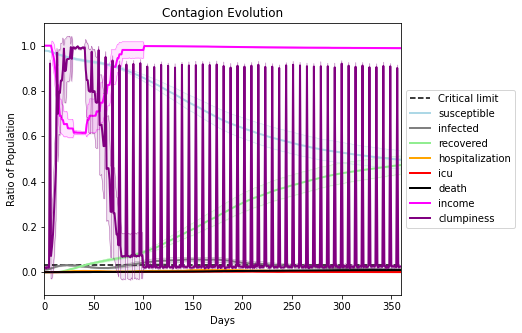

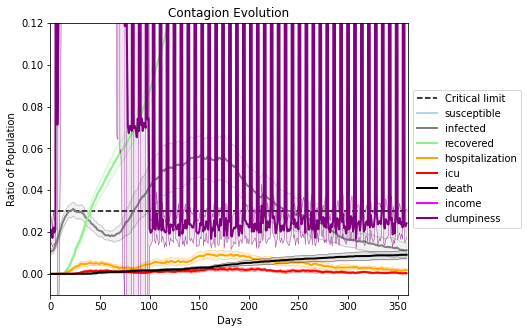

In [46]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8241, 2476, 7371, 733, 7565, 1298, 5467, 2308, 9518, 8871, 5851, 3059, 2962, 8252, 6845, 837, 6789, 9219, 5387, 9820]
Average similarity between family members is -0.034387841351430457 at temperature 1
Average similarity between family and home is 0.9998564645703936 at temperature -1
Average similarity between students and their classroom is -0.004951205168516054 at temperature 1
Average classroom occupancy is 4.180555555555555 and number classrooms is 72
Average similarity between workers is 0.01613182926448512 at temperature 1
Average office occupancy is 3.1921182266009853 and number offices is 203
Average friend similarity for adults: 0.0815717478908337 for kids: 0.06001142099546005
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.2587920535422181
avg restaurant similarity -0.12133725061603812
avg restaurant similarity -0.3721720548986454
avg restaurant similarity -0.10101519263147321
avg restaurant similarity 0.20846460780334342
avg restaurant similarity 0.010160839111783851
avg restaurant similarity 0.22350349247205675
avg restaurant similarity -0.010456646812573522
avg restaurant similarity -0.3187806228404546
avg restaurant similarity 0.011937423689207274
avg restaurant similarity 0.05992697708514062
avg restaurant similarity -0.3721720548986454
avg restaurant similarity 0.00012779520405904743
avg restaurant similarity -0.09580415332532889
avg restaurant similarity 0.011937423689207274
avg restaurant similarity -0.4896340362503501
avg restaurant similarity -0.11120491547274414
avg restaurant similarity 0.06752712675118493
avg restaurant similarity 0.09266201398639248
avg restaurant similarity 0.1660290739533613
avg restaurant similarity 0.006771203434266557
avg restaurant similari

avg restaurant similarity -0.09091474678860884
avg restaurant similarity 0.018359724025979962
avg restaurant similarity 0.01163683786186374
avg restaurant similarity -0.04716477154965164
avg restaurant similarity -0.01704562649553206
avg restaurant similarity 0.03688817682638393
avg restaurant similarity 0.040407262479584316
avg restaurant similarity -0.008246070163119318
avg restaurant similarity 0.20104711208157194
avg restaurant similarity 0.08694084422730139
avg restaurant similarity -0.14882350456695853
avg restaurant similarity -0.06326959010790018
avg restaurant similarity 0.12943524268245502
avg restaurant similarity 0.04990090458640839
avg restaurant similarity -0.1804280359405992
avg restaurant similarity 0.3170657608562593
avg restaurant similarity 0.0694140573966382
avg restaurant similarity 0.13387123762037142
avg restaurant similarity -0.06366527348687695
avg restaurant similarity -0.09546782327766784
avg restaurant similarity -0.016290776930305464
avg restaurant similari

avg restaurant similarity -0.04257854811109288
avg restaurant similarity 0.1161005678556278
avg restaurant similarity 0.4477824114467426
avg restaurant similarity -0.2670663740236649
avg restaurant similarity -0.2622829010776957
avg restaurant similarity 0.05489530040159179
avg restaurant similarity -0.1764809921649717
avg restaurant similarity 0.1600292285276851
avg restaurant similarity 0.12374871160996467
avg restaurant similarity 0.034461702904905925
avg restaurant similarity -0.042636572408141005
avg restaurant similarity 0.26156307663974926
avg restaurant similarity -0.2622829010776957
avg restaurant similarity 0.12909193753429615
avg restaurant similarity -0.03644847414326535
avg restaurant similarity -0.13789814221851124
avg restaurant similarity -0.13619531681287214
avg restaurant similarity 0.08150891345548303
avg restaurant similarity -0.3022021829449258
avg restaurant similarity -0.023906475385165514
avg restaurant similarity -0.15388488857081212
avg restaurant similarity 0

avg restaurant similarity 0.14044137993174677
avg restaurant similarity 0.019614415000241026
avg restaurant similarity -0.013713551564015367
avg restaurant similarity 0.05920733786536321
avg restaurant similarity -0.12121951312552508
avg restaurant similarity 0.4375071501120687
avg restaurant similarity -0.2659052272625195
avg restaurant similarity 0.0953880228919492
avg restaurant similarity 0.17480526111860037
avg restaurant similarity 0.3086073262415206
avg restaurant similarity 0.03287549590022576
avg restaurant similarity 0.00013528631199466457
avg restaurant similarity 0.017250326978712788
avg restaurant similarity 0.17776011792532037
avg restaurant similarity -0.08241986424395048
avg restaurant similarity -0.40711867599819807
avg restaurant similarity 0.12709470902806463
avg restaurant similarity -0.1679979992853096
avg restaurant similarity -0.1012230914222394
avg restaurant similarity 0.10965818768737565
avg restaurant similarity 0.29076657683789214
avg restaurant similarity 0

avg restaurant similarity 0.4268223798356424
avg restaurant similarity 0.07567520175694717
avg restaurant similarity 0.3684867623871287
avg restaurant similarity 0.7425024429903531
avg restaurant similarity 0.09872594963071198
avg restaurant similarity -0.058516490022908825
avg restaurant similarity -0.19148763427030713
avg restaurant similarity -0.054024208803486164
avg restaurant similarity 0.14484471050454215
avg restaurant similarity 0.4748109980049361
avg restaurant similarity 0.07259343017454978
avg restaurant similarity 0.06915415241457513
avg restaurant similarity -0.27099463699072446
avg restaurant similarity -0.2269525055166665
avg restaurant similarity -0.16667845492335456
avg restaurant similarity -0.18441238351994965
avg restaurant similarity -0.54063596327885
avg restaurant similarity 0.0027785705632975
avg restaurant similarity -0.11471397976968417
avg restaurant similarity 0.11746645649430494
avg restaurant similarity 0.1155612464034304
avg restaurant similarity 0.03937

avg restaurant similarity -0.060022880004462854
avg restaurant similarity 0.1710639128699353
avg restaurant similarity -0.013167591501571364
avg restaurant similarity 0.4658877011240663
avg restaurant similarity 0.10113350919361311
avg restaurant similarity -0.38824249063927585
avg restaurant similarity 0.22597898880112036
avg restaurant similarity -0.1598327315686643
avg restaurant similarity -0.3310134020704501
avg restaurant similarity 0.19585149103854882
avg restaurant similarity -0.03234015479467747
avg restaurant similarity 0.2756650040549098
avg restaurant similarity 0.06061313374802875
avg restaurant similarity 0.2937313712210257
avg restaurant similarity 0.2011633450896869
avg restaurant similarity -0.15269202225346729
avg restaurant similarity 0.4204938664926737
avg restaurant similarity 0.24251177846538854
avg restaurant similarity 0.2294629318326908
avg restaurant similarity 0.034897966306799894
avg restaurant similarity -0.1362666303559025
avg restaurant similarity -0.0143

avg restaurant similarity -0.06280541954827415
avg restaurant similarity 0.15433982211842034
avg restaurant similarity -0.19668698250703964
avg restaurant similarity 0.0032069310873745482
avg restaurant similarity 0.08949217474552476
avg restaurant similarity 0.3074551699371965
avg restaurant similarity 0.003454526399985003
avg restaurant similarity 0.3381397285355281
avg restaurant similarity -0.25581536933910337
avg restaurant similarity -0.0033067921630872757
avg restaurant similarity -0.27962294033009216
avg restaurant similarity 0.11977884081848696
avg restaurant similarity -0.30485224501478
avg restaurant similarity 0.06435027307672231
avg restaurant similarity -0.0539057168262668
avg restaurant similarity 0.08887594532563083
avg restaurant similarity 0.2405019466985139
avg restaurant similarity 0.241021083444729
avg restaurant similarity 0.0973674680166768
avg restaurant similarity -0.1605025662857426
avg restaurant similarity -0.008835054155657801
avg restaurant similarity 0.16

avg restaurant similarity -0.0026642381922921538
avg restaurant similarity 0.03565317584250137
avg restaurant similarity -0.441016763116716
avg restaurant similarity -0.055407773392105425
avg restaurant similarity 0.331658788497096
avg restaurant similarity 0.08860498103782999
Average similarity between family members is 0.007949675547658755 at temperature 1
Average similarity between family and home is 0.9998528166197136 at temperature -1
Average similarity between students and their classroom is 0.0014857759887745203 at temperature 1
Average classroom occupancy is 4.070422535211268 and number classrooms is 71
Average similarity between workers is -0.0009969131434299531 at temperature 1
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.07995942328464452 for kids: 0.08097985859688134
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 9 allocated units with a total of 28

avg restaurant similarity 0.20866238072108376
avg restaurant similarity -0.08610611732598786
avg restaurant similarity -0.026462877989039485
avg restaurant similarity -0.0042411336033603975
avg restaurant similarity 0.27586981871484695
avg restaurant similarity 0.17420674046731707
avg restaurant similarity 0.42755621549979145
avg restaurant similarity 0.47207806749536924
avg restaurant similarity 0.07952832653833501
avg restaurant similarity 0.07221329053571482
avg restaurant similarity 0.26839261714020884
avg restaurant similarity 0.08449961105919715
avg restaurant similarity 0.09089460105013428
avg restaurant similarity 0.1710811935107668
avg restaurant similarity 0.05657821763247268
avg restaurant similarity -0.19874827933341532
avg restaurant similarity -0.14178641567335265
avg restaurant similarity -0.2152073803626945
avg restaurant similarity 0.061889395807896624
avg restaurant similarity -0.10501712421784118
avg restaurant similarity 0.0008440240341168748
avg restaurant similari

avg restaurant similarity -0.11614433410152572
avg restaurant similarity 0.14518928754491278
avg restaurant similarity 0.04033271058341491
avg restaurant similarity 0.21298765723871138
avg restaurant similarity 0.0823013669682333
avg restaurant similarity 0.11081282079373271
avg restaurant similarity -0.14067558253531115
avg restaurant similarity -0.14195660358649717
avg restaurant similarity 0.05984151590060788
avg restaurant similarity 0.058322973399515685
avg restaurant similarity 0.14518928754491278
avg restaurant similarity -0.061561789672378874
avg restaurant similarity 0.003589052347631072
avg restaurant similarity 0.01263951322602161
avg restaurant similarity -0.007431095414011872
avg restaurant similarity 0.058322973399515685
avg restaurant similarity 0.1817756327274356
avg restaurant similarity -0.2738371683812207
avg restaurant similarity -0.31789304389831896
avg restaurant similarity 0.14666733273963672
avg restaurant similarity -0.184298545197236
avg restaurant similarity 

avg restaurant similarity 0.16436420364774135
avg restaurant similarity -0.2678186898138054
avg restaurant similarity 0.22488409108623697
avg restaurant similarity 0.20630495123705128
avg restaurant similarity 0.2504381325967479
avg restaurant similarity -0.21703947679770857
avg restaurant similarity 0.07563884699430914
avg restaurant similarity -0.0394502607099151
avg restaurant similarity -0.07219116041850797
avg restaurant similarity 0.1642088824297987
avg restaurant similarity -0.04479356069896345
avg restaurant similarity -0.11228267746324011
avg restaurant similarity 0.07068197693742553
avg restaurant similarity -0.1563796559848547
avg restaurant similarity -0.24410661677248968
avg restaurant similarity 0.37771817533782304
avg restaurant similarity 0.10494927099329686
avg restaurant similarity 0.7049273444488136
avg restaurant similarity -0.2044802545740425
avg restaurant similarity -0.21799134894348482
avg restaurant similarity -0.08300652695307548
avg restaurant similarity -0.1

avg restaurant similarity -0.17311228596169703
avg restaurant similarity 0.14937614404398783
avg restaurant similarity 0.000752529804338084
avg restaurant similarity -0.12446886782798164
avg restaurant similarity -0.21019254426468773
avg restaurant similarity -0.3934883593768881
avg restaurant similarity 0.021038312789538285
avg restaurant similarity 0.33251108968883386
avg restaurant similarity 0.3001228051543384
avg restaurant similarity 0.01151017304474354
avg restaurant similarity -0.016575964487900857
avg restaurant similarity -0.009212018482613292
avg restaurant similarity -0.01663391033875296
avg restaurant similarity 0.1939222441409616
avg restaurant similarity -0.2501558244566732
avg restaurant similarity 0.31246727637981503
avg restaurant similarity -0.18663181595489334
avg restaurant similarity -0.3288685383849071
avg restaurant similarity 0.17998603072259858
avg restaurant similarity 0.2764287457597339
avg restaurant similarity -0.2830357830095942
avg restaurant similarity 

avg restaurant similarity -0.07050431132040937
avg restaurant similarity -0.03305768281724865
avg restaurant similarity 0.6327169036093806
avg restaurant similarity 0.5109959641093685
avg restaurant similarity -0.02687736705976478
avg restaurant similarity 0.238601306127571
avg restaurant similarity 0.16427540055616677
avg restaurant similarity -0.18597372320727346
avg restaurant similarity 0.005610933038398158
avg restaurant similarity -0.07958428213284627
avg restaurant similarity 0.4390029421788688
avg restaurant similarity 0.255276375807967
avg restaurant similarity 0.32871711757306177
avg restaurant similarity -0.00653612380660501
avg restaurant similarity 0.6283899389104115
avg restaurant similarity 0.4220472480975805
avg restaurant similarity 0.19533192106969222
avg restaurant similarity 0.3011020876813237
avg restaurant similarity -0.06993817387627255
avg restaurant similarity -0.313498947486495
avg restaurant similarity 0.352174134234352
avg restaurant similarity 0.01174211590

avg restaurant similarity -0.04457021024402033
avg restaurant similarity 0.02558529206796814
avg restaurant similarity 0.12345473325429852
avg restaurant similarity 0.3245318752826184
avg restaurant similarity -0.014213219345635936
avg restaurant similarity 0.12687552239406727
avg restaurant similarity 0.2689947718705541
avg restaurant similarity 0.3894580042980754
avg restaurant similarity 0.141290171323013
avg restaurant similarity -0.07459358876228116
avg restaurant similarity -0.274758860606775
avg restaurant similarity -0.021821705137569036
avg restaurant similarity -0.4063488475012541
avg restaurant similarity -0.25562767803935055
avg restaurant similarity 0.03156126513960071
avg restaurant similarity -0.2962348906201535
avg restaurant similarity 0.031056222241375175
avg restaurant similarity 0.00159573184428395
avg restaurant similarity -0.26105049225897675
avg restaurant similarity 0.2295183211725094
avg restaurant similarity 0.020728068248090814
avg restaurant similarity 0.139

avg restaurant similarity 0.28841317099568015
avg restaurant similarity 0.16451451324910327
avg restaurant similarity 0.11501958379088481
avg restaurant similarity 0.17177995290092593
avg restaurant similarity 0.11379985197946656
avg restaurant similarity 0.36431155149616967
avg restaurant similarity 0.09072026687158588
avg restaurant similarity 0.12873461320232468
avg restaurant similarity 0.04592195342047326
avg restaurant similarity 0.02782686544100163
avg restaurant similarity -0.050015153111708725
avg restaurant similarity 0.10820057617177309
avg restaurant similarity 0.21410463289572607
Average similarity between family members is -0.003931828477957798 at temperature 1
Average similarity between family and home is 0.9998524702866622 at temperature -1
Average similarity between students and their classroom is 0.05037631670352274 at temperature 1
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is -0.007005733539945612 

avg restaurant similarity 0.09304534297145522
avg restaurant similarity -0.139606290878157
avg restaurant similarity 0.10690280374809487
avg restaurant similarity -0.02269768256421302
avg restaurant similarity -0.036343832981224476
avg restaurant similarity 0.6479888249199128
avg restaurant similarity 0.07159605385280732
avg restaurant similarity -0.2107694914211549
avg restaurant similarity 0.1604081348740418
avg restaurant similarity -0.1221229549664332
avg restaurant similarity 0.10085629184082319
avg restaurant similarity -0.08330968419154856
avg restaurant similarity -0.12503049063095498
avg restaurant similarity 0.19299755996494306
avg restaurant similarity -0.017409423546827077
avg restaurant similarity 0.11070203476199558
avg restaurant similarity -0.07815107509345598
avg restaurant similarity -0.206309312450783
avg restaurant similarity 0.2300185931586004
avg restaurant similarity -0.11617474929611601
avg restaurant similarity 0.13785021553596105
avg restaurant similarity -0.1

avg restaurant similarity 0.272443226520629
avg restaurant similarity -0.049778715520820235
avg restaurant similarity 0.08659171744731534
avg restaurant similarity 0.3098735988769004
avg restaurant similarity 0.03639690042420938
avg restaurant similarity 0.041425796376845674
avg restaurant similarity 0.28442177085503084
avg restaurant similarity -0.16259539746204893
avg restaurant similarity -0.14379486595982696
avg restaurant similarity 0.3126859181455994
avg restaurant similarity 0.12142299862998931
avg restaurant similarity 0.4876045857387841
avg restaurant similarity 0.40356412457699703
avg restaurant similarity -0.06755006109730981
avg restaurant similarity 0.378404229935035
avg restaurant similarity -0.17003408768839584
avg restaurant similarity -0.03800876520112287
avg restaurant similarity 0.22339847279263148
avg restaurant similarity 0.14941108911635825
avg restaurant similarity -0.0055475837679830504
avg restaurant similarity 0.047560026068970945
avg restaurant similarity -0.

Average similarity between workers is -0.006864586454160457 at temperature 1
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.1029957638307774 for kids: 0.08649338564201103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity -0.39301079834753916
avg restaurant similarity -0.055736059777026045
avg restaurant similarity -0.2044816240939526
avg restaurant similarity -0.2360280207578847
avg restaurant similarity 0.21094930361634467
avg restaurant similarity -0.1599333915417837
avg restaurant similarity -0.04399778481418293
avg restaurant similarity 0.08078121754077353
avg restaurant similarity -0.13813413116727136
avg restaurant similarity 0.2224033631117717
avg restaurant similarity 0.21198307733112437
avg restaurant similarity -0.05838323509756317
avg restaurant similarity -0.30191323297493167
avg restaurant similarity -0.19900996279560057
avg restaurant similarity -0.030301280772755543
avg restaurant similarity -0.30191323297493167
avg restaurant similarity 0.5206159073883077
avg restaurant similarity 0.08863476349536685
avg restaurant similarity 0.44244024010478145
avg restaurant similarity 0.03966097345294335
avg restaurant similarity -0.19900996279560057
avg restaurant similarit

avg restaurant similarity -0.08324159726597748
avg restaurant similarity -0.4102145608280186
avg restaurant similarity -0.157776311639418
avg restaurant similarity 0.4369331726611919
avg restaurant similarity 0.12670772838252528
avg restaurant similarity 0.2306531282158636
avg restaurant similarity -0.0922122748440292
avg restaurant similarity 0.15829565410119492
avg restaurant similarity -0.02133670910212009
avg restaurant similarity -0.2613251856551996
avg restaurant similarity 0.2175258427675714
avg restaurant similarity 0.03740040178606907
avg restaurant similarity -0.030653658274241352
avg restaurant similarity -0.153855211547068
avg restaurant similarity -0.024302745279697762
avg restaurant similarity -0.14878185832290247
avg restaurant similarity -0.017206012874096878
avg restaurant similarity -0.15968224595480326
avg restaurant similarity -0.11673177228133957
avg restaurant similarity -0.07389383689411075
avg restaurant similarity 0.008683012248331956
avg restaurant similarity 

avg restaurant similarity 0.08504681513832599
avg restaurant similarity -0.14347493966430686
avg restaurant similarity 0.36088223780272144
avg restaurant similarity 0.059052665008093946
avg restaurant similarity -0.01647363908663199
avg restaurant similarity 0.45824068605855983
avg restaurant similarity -0.15983167841648094
avg restaurant similarity 0.3087847803297464
avg restaurant similarity -0.02087627516362445
avg restaurant similarity -0.00990449027303894
avg restaurant similarity -0.0605090890981497
avg restaurant similarity 0.10096585533623287
avg restaurant similarity 0.17993367147824238
avg restaurant similarity -0.14532496435549053
avg restaurant similarity 0.23111736429109442
avg restaurant similarity -0.16506052796242293
avg restaurant similarity -0.03836109189732655
Average similarity between family members is -0.018071578959712817 at temperature 1
Average similarity between family and home is 0.9998574478376755 at temperature -1
Average similarity between students and the

avg restaurant similarity -0.07650570931238104
avg restaurant similarity -0.35381149249628274
avg restaurant similarity -0.27088329698323216
avg restaurant similarity -0.2656559346900184
avg restaurant similarity -0.3983271482030164
avg restaurant similarity -0.041593216864457674
avg restaurant similarity -0.1682161482137017
avg restaurant similarity -0.37723359637583936
avg restaurant similarity 0.14864649274444175
avg restaurant similarity -0.12450472945665626
avg restaurant similarity -0.251366282491291
avg restaurant similarity -0.09576071897639718
avg restaurant similarity -0.20332982161889318
avg restaurant similarity 0.370235764079218
avg restaurant similarity -0.27088329698323216
avg restaurant similarity -0.10836832501827129
avg restaurant similarity -0.3204946316624804
avg restaurant similarity -0.33033544134104537
avg restaurant similarity -0.08201875132236494
avg restaurant similarity 0.016094260329524268
avg restaurant similarity -0.06695322024997696
avg restaurant similar

Average friend similarity for adults: 0.07818043517249869 for kids: 0.0767228802174498
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.06927269871473328
avg restaurant similarity -0.07729967320363
avg restaurant similarity 0.3102072225413583
avg restaurant similarity -0.3212254956312627
avg restaurant similarity 0.08351957278710566
avg restaurant similarity -0.11757029789235998
avg restaurant similarity 0.12211613017258853
avg restaurant similarity 0.18983477930451517
avg restaurant similarity 0.09312117627196088
avg restaurant similarity 0.022402274924326726
avg restaurant similarity -0.25342729981510537
avg restaurant similarity -0.07544410166960785
avg restaurant similarity -0.2820427624123275
avg restaurant similarity -0.05343467867109117
avg restaurant similarity 0.36050106483150696
avg restaurant similarity -0.04914639521770278
avg restaurant similarity -0.3134623772260141
avg restaurant similarity 0.06006199737411581
avg restaurant similarity -0.04590467847825799
avg restaurant similarity -0.12758394769525905
avg restaurant similarity -0.2769824239488516
avg restaurant similarity -0.

avg restaurant similarity -0.041483281863260495
avg restaurant similarity -0.10344470152037769
avg restaurant similarity 0.07613318170897262
avg restaurant similarity 0.1046748198634587
avg restaurant similarity 0.039040013871437414
avg restaurant similarity 0.15769045483632846
avg restaurant similarity 0.08248939846670059
avg restaurant similarity 0.008047762027486869
avg restaurant similarity -0.14214733555162457
avg restaurant similarity -0.10392542398555456
avg restaurant similarity -0.15134396398292838
avg restaurant similarity -0.03492454738537032
avg restaurant similarity 0.015842247360053796
avg restaurant similarity 0.05883846672283456
avg restaurant similarity 0.21791231409888628
avg restaurant similarity -0.5580619052137148
avg restaurant similarity 0.18276877856309817
avg restaurant similarity -0.06507563144224751
avg restaurant similarity 0.21310442117799877
avg restaurant similarity 0.048938869725913034
avg restaurant similarity -0.019903942520062334
avg restaurant simila

(<function dict.items>, <function dict.items>, <function dict.items>)

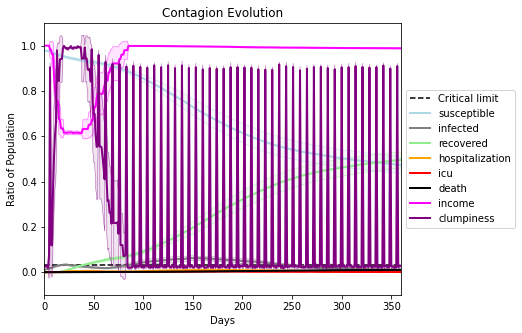

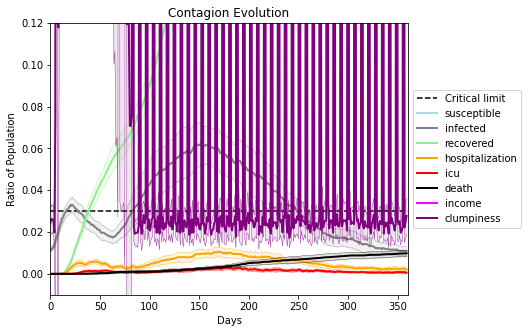

In [47]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)